# Описание

## Задачи
_Испольуется три задачи:_
- DM -- двухальтернативный выбор
- Romo -- сравнение двух сигнало через задержку
- CtxDM -- DM с контекстом
Вход состоит из одного контекстного входа, одного стимула, 6 входов, кодирующих задачи. Выход как и раньше состоит из трех частей: контекстный выход, выходы принятия решения.

## Сеть
 Сеть состоит из lif AdEx нейронов

# Импорт всех необходимых библиотек

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
from cgtasknet.instruments.instrument_accuracy_network import CorrectAnswerNetwork
from cgtasknet.tasks.reduce import (
    CtxDMTaskParameters,
    DMTaskParameters,
    DMTaskRandomModParameters,
    GoDlTaskParameters,
    GoDlTaskRandomModParameters,
    GoRtTaskParameters,
    GoRtTaskRandomModParameters,
    GoTaskParameters,
    GoTaskRandomModParameters,
    MultyReduceTasks,
    RomoTaskParameters,
    RomoTaskRandomModParameters,
)
from tqdm import tqdm

# Определяем устройство

In [2]:
device = torch.device("cuda:2" if torch.cuda.is_available() else "cpu")
print(f"{device}")

cuda:2


# Функция построения входов и выходов

In [3]:
import os


def plot_results(inputs, target_outputs, outputs):
    if isinstance(inputs, torch.Tensor) and isinstance(target_outputs, torch.Tensor):
        inputs, t_outputs = (
            inputs.detach().cpu().numpy(),
            target_outputs.detach().cpu().numpy(),
        )
    for bath in range(min(batch_size, 20)):
        fig = plt.figure(figsize=(15, 3))
        ax1 = fig.add_subplot(141)
        plt.title("Inputs")
        plt.xlabel("$time, ms$")
        plt.ylabel("$Magnitude$")
        for i in range(3):
            plt.plot(inputs[:, bath, i].T, label=rf"$in_{i + 1}$")
        plt.legend()
        plt.tight_layout()

        ax2 = fig.add_subplot(142)
        plt.title("Task code (context)")
        plt.xticks(np.arange(1, len(tasks) + 1), sorted(tasks), rotation=90)
        plt.yticks([])
        for i in range(3, inputs.shape[-1]):
            plt.plot([i - 2] * 2, [0, inputs[0, bath, i]])
        plt.tight_layout()

        ax3 = fig.add_subplot(143)
        plt.title("Target output")
        plt.xlabel("$time, ms$")
        for i in range(t_outputs.shape[-1]):
            plt.plot(t_outputs[:, bath, i], label=rf"$out_{i + 1}$")
        plt.legend()
        plt.tight_layout()

        ax4 = fig.add_subplot(144)
        plt.title("Real output")
        plt.xlabel("$time, ms$")
        for i in range(outputs.shape[-1]):
            plt.plot(
                outputs.detach().cpu().numpy()[:, bath, i], label=rf"$out_{i + 1}$"
            )
        plt.legend()
        plt.tight_layout()
        if not os.path.exists("figures"):
            os.mkdir("figures")
        plt.savefig(f"figures{os.sep}network_outputs_{name}_batch_{bath}.pdf")
        plt.show()
        plt.close()

# Определяем датасет
Датасет будет состоять из трех типов задач:
- DM задача;
- Romo задача;
- CtxDM задача.
_Параметры для последней задачи аналогичны DM задаче_
***
## Параметры датасета:

In [4]:
batch_size = 32
number_of_epochs = 3000
number_of_tasks = 2

go_task_list_values = np.linspace(0, 1, 8)

romo_parameters = RomoTaskRandomModParameters(
    romo=RomoTaskParameters(
        delay=0.2,
        positive_shift_delay_time=1.5,
        trial_time=0.2,
        positive_shift_trial_time=0.4,
        answer_time=0.25,
    ),
)
dm_parameters = DMTaskRandomModParameters(
    dm=DMTaskParameters(trial_time=0.3, positive_shift_trial_time=1.5, answer_time=0.25)
)
ctx_parameters = CtxDMTaskParameters(dm=dm_parameters.dm)
go_parameters = GoTaskRandomModParameters(
    go=GoTaskParameters(
        trial_time=0.3,
        positive_shift_trial_time=1.5,
        value=go_task_list_values,
        answer_time=0.25,
    )
)
gort_parameters = GoRtTaskRandomModParameters(
    go_rt=GoRtTaskParameters(
        trial_time=0.3,
        positive_shift_trial_time=1.5,
        answer_time=1.5,
        value=go_task_list_values,
    )
)
godl_parameters = GoDlTaskRandomModParameters(
    go_dl=GoDlTaskParameters(
        go=GoTaskParameters(
            trial_time=0.2,
            positive_shift_trial_time=0.4,
            answer_time=0.25,
            value=go_task_list_values,
        ),
        delay=0.2,
        positive_shift_delay_time=1.5,
    )
)

## Датасет

In [5]:
sigma = 0.5
tasks = [
    "RomoTask1",
    "RomoTask2",
    "DMTask1",
    "DMTask2",
    "CtxDMTask1",
    "CtxDMTask2",
    "GoTask1",
    "GoTask2",
    "GoRtTask1",
    "GoRtTask2",
    "GoDlTask1",
    "GoDlTask2",
]
task_dict = {
    tasks[0]: romo_parameters,
    tasks[1]: romo_parameters,
    tasks[2]: dm_parameters,
    tasks[3]: dm_parameters,
    tasks[4]: ctx_parameters,
    tasks[5]: ctx_parameters,
    tasks[6]: go_parameters,
    tasks[7]: go_parameters,
    tasks[8]: gort_parameters,
    tasks[9]: gort_parameters,
    tasks[10]: godl_parameters,
    tasks[11]: godl_parameters,
}
Task = MultyReduceTasks(
    tasks=task_dict,
    batch_size=batch_size,
    delay_between=0,
    enable_fixation_delay=True,
    mode="random",
)

print("Task parameters:")
for key in task_dict:
    print(f"{key}:\n{task_dict[key]}\n")

print(f"inputs/outputs: {Task.feature_and_act_size[0]}/{Task.feature_and_act_size[1]}")

Task parameters:
RomoTask1:
RomoTaskRandomModParameters(romo=RomoTaskParameters(dt=0.001, trial_time=0.2, answer_time=0.25, value=(None, None), delay=0.2, negative_shift_trial_time=0, positive_shift_trial_time=0.4, negative_shift_delay_time=0, positive_shift_delay_time=1.5), n_mods=2)

RomoTask2:
RomoTaskRandomModParameters(romo=RomoTaskParameters(dt=0.001, trial_time=0.2, answer_time=0.25, value=(None, None), delay=0.2, negative_shift_trial_time=0, positive_shift_trial_time=0.4, negative_shift_delay_time=0, positive_shift_delay_time=1.5), n_mods=2)

DMTask1:
DMTaskRandomModParameters(dm=DMTaskParameters(dt=0.001, trial_time=0.3, answer_time=0.25, value=None, negative_shift_trial_time=0, positive_shift_trial_time=1.5), n_mods=2)

DMTask2:
DMTaskRandomModParameters(dm=DMTaskParameters(dt=0.001, trial_time=0.3, answer_time=0.25, value=None, negative_shift_trial_time=0, positive_shift_trial_time=1.5), n_mods=2)

CtxDMTask1:
CtxDMTaskParameters(dm=DMTaskParameters(dt=0.001, trial_time=0.3,

In [6]:
sorted_tasks = sorted(tasks)
re_word = "Go"
choices_tasks = []
values_tasks = []
for i in range(len(sorted_tasks)):
    if re_word in sorted_tasks[i]:
        values_tasks.append(i)
    else:
        choices_tasks.append(i)
can = CorrectAnswerNetwork(choices_tasks, values_tasks, 0.15)

# Инициализация сети и выгрузка на device

In [7]:
from cgtasknet.net import SNNlifadex
from norse.torch import LIFAdExParameters

feature_size, output_size = Task.feature_and_act_size
hidden_size = 600

neuron_parameters = LIFAdExParameters(
    v_th=torch.as_tensor(0.45),
    tau_ada_inv=torch.as_tensor(1 / 2.0),
    alpha=100,
    method="super",
    # rho_reset = torch.as_tensor(5)
)
model = SNNlifadex(
    feature_size,
    hidden_size,
    output_size,
    neuron_parameters=neuron_parameters,
    tau_filter_inv=20,
    save_states=True,
    return_spiking=True
    
).to(device)
for name, param in model.named_parameters():
    if name == 'alif.recurrent_weights':
        initial_parameters = torch.clone(param.detach().cpu())


inputs, _ = Task.dataset(1)
inputs *= 0
additionalCurrent = 0.1 * torch.randn((1, hidden_size)).to(device) + 1.4
inputs = torch.from_numpy(inputs[-1000:]).type(torch.float).to(device)
outputs, states = model(inputs, additional_current = additionalCurrent)
outputs = outputs.detach().cpu()
plt.plot(outputs[:, 0, 0])
plt.show()
plt.close()

mean_fr = torch.zeros((hidden_size))

for i in range(len(states)):
    mean_fr += torch.mean(states[i].z.detach().cpu(), axis=0)
mean_fr /= len(states)
plt.plot(mean_fr == 0, '.')

mean_fr = torch.zeros((hidden_size))

for i in range(len(states)):
    mean_fr += torch.mean(states[i].z.detach().cpu(), axis=0)
mean_fr /= len(states)
plt.plot(mean_fr, '.')

# Критерий и функция ошибки

In [8]:
learning_rate = 5e-3
reg_freq = 1e4 #1e3 for square #for 600 1e5
class RMSELoss(nn.Module):
    def __init__(self):
        super().__init__()
        self.mse = nn.MSELoss()

    def forward(self, yhat, y):
        return torch.sqrt(self.mse(yhat, y))


class MaskedMSELoss(torch.nn.Module):
    def __init__(self):
        super(MaskedMSELoss, self).__init__()

    def forward(self, input, target, mask):
        diff2 = (torch.flatten(input) - torch.flatten(target)) ** 2.0 * torch.flatten(
            mask
        )
        result = torch.sum(diff2) / torch.sum(mask)
        return result

class MaskedAndFrRegMSELoss(torch.nn.Module):
    def __init__(self):
        super(MaskedAndFrRegMSELoss, self).__init__()
        
    def forward(self, input, target, mask, state):
        diff2 = (torch.flatten(input) - torch.flatten(target)) ** 2.0 * torch.flatten(
        mask)
        result = torch.sum(diff2) / torch.sum(mask)
        s = []
        for i in range(len(state)):
            s.append(state[i])
        s = torch.stack(s)
        fr_neurons_mean = torch.mean(torch.mean(s, axis=0), axis=0)
        coefs = ((fr_neurons_mean > .03)).detach()
        fr_neurons_mean *= coefs
        fr_neurons_mean = torch.mean(fr_neurons_mean)
        result += fr_neurons_mean  * reg_freq
        return result

criterion = MaskedAndFrRegMSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

## Генерация всех эпох
> Если память не позволяет, то необходимо генерировать каждую эпоху в основном цикле обучения

In [9]:
if False:
    list_inputs = []
    list_t_outputs = []
    for i in tqdm(range(number_of_epochs)):
        temp_input, temp_t_output = Task.dataset()
        temp_input.astype(dtype=np.float16)
        temp_t_output.astype(dtype=np.float16)
        temp_input[:, :, :] += np.random.normal(0, sigma, size=temp_input.shape)
        list_inputs.append(temp_input)
        list_t_outputs.append(temp_t_output)

# JIT numba generator (test)
TODO: Необходимо добавить в cgtasknet и вызывать оттуда

In [10]:
#from numba import njit, prange


#@njit(cache=True, parallel=True)
def every_bath_generator(
        start_sigma: float,
        stop_sigma: float,
        times: int = 1,
        batches: int = 1,
        actions: int = 1,
):
    data = np.zeros((times, batches, actions))
    for i in range(batches):
        data[:, i, :] = np.random.normal(
            0, np.random.uniform(start_sigma, stop_sigma), size=(times, actions)
        )
    return data

In [11]:
torch.cuda.empty_cache()


In [12]:
from norse.torch import LIFAdExState
Task_test = MultyReduceTasks(
    tasks=task_dict,
    batch_size=batch_size,
    delay_between=0,
    enable_fixation_delay=True,
    mode="random",
    task_number=6
)
def check_mean_fr(task = Task):
    init_state = LIFAdExState(
            torch.zeros(batch_size, hidden_size).to(device),
            torch.rand(batch_size, hidden_size).to(device),
            torch.zeros(batch_size, hidden_size).to(device),
            torch.zeros(batch_size, hidden_size).to(device),
        )
    inputs, target_outputs = task.dataset(1)

    inputs = torch.from_numpy(inputs).type(torch.float).to(device)
    target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
    result = model(inputs, init_state,)
    #del inputs, init_state
    torch.cuda.empty_cache()
    states = result[-1]
    spikes = []
    for state in states:
        spikes.append(state.detach().cpu())

    last_fix = torch.where(inputs[:, :, 0] == 1)[0][-1].item()
    #s = torch.stack(spikes)[:last_fix, ...]
    s = torch.stack(spikes)[:, ...]
    freq_sequence_new = torch.sort(
        torch.mean(torch.mean(s, axis=0), axis=0), dim=0
    ).values
    for i in range(len(freq_sequence_new)):
        plt.plot([i + 1] * 2, [0, freq_sequence_new[i] * 1e3], c="b")
    plt.show()
    plt.close()
    index=0
    plt.plot(target_outputs[:, index, 0].detach().cpu(), c='r')
    plt.plot(target_outputs[:, index, 1].detach().cpu(), c='b')
    plt.plot(target_outputs[:, index, 2].detach().cpu(), c='g')

    plt.plot(result[0][:, index, 0].detach().cpu(), c='r', alpha=.6
            )
    plt.plot(result[0][:, index, 1].detach().cpu(), c='b', alpha=.6
            )
    plt.plot(result[0][:, index, 2].detach().cpu(), c='g', alpha=.6
        )
    plt.show()
    plt.close()
#check_mean_fr()

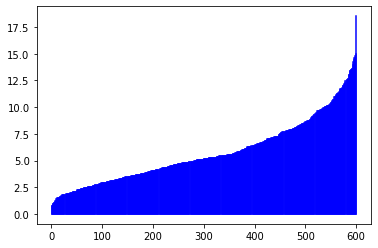

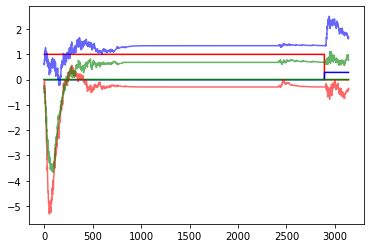

In [13]:
test = MultyReduceTasks(
    tasks=task_dict,
    batch_size=batch_size,
    delay_between=0,
    enable_fixation_delay=True,
    mode="random",
    task_number=1
)
check_mean_fr(Task)

# Основной цикл обучения

  0%|▏                                                                                                                                                              | 4/3000 [01:23<17:10:05, 20.63s/it]

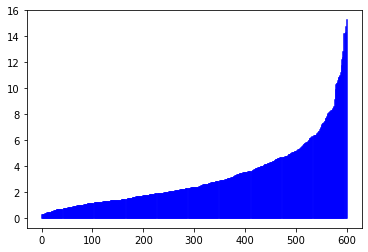

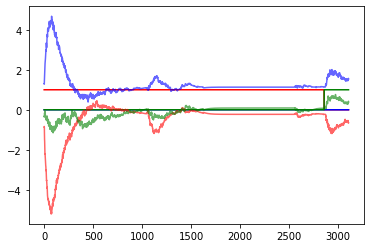

  0%|▍                                                                                                                                                              | 9/3000 [03:13<17:28:42, 21.04s/it]

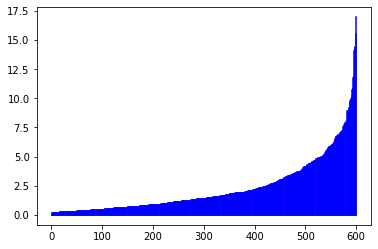

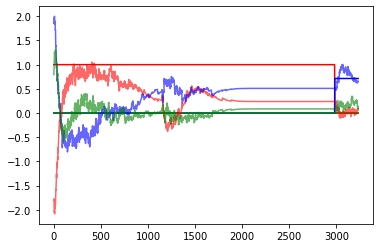

  0%|▋                                                                                                                                                             | 14/3000 [04:55<16:22:08, 19.73s/it]

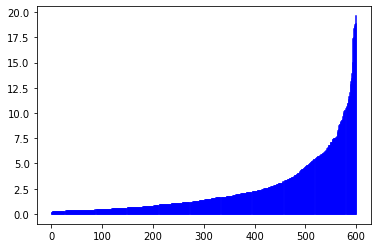

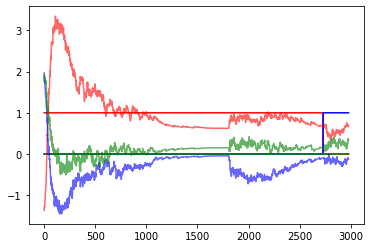

  1%|█                                                                                                                                                             | 19/3000 [06:42<16:57:56, 20.49s/it]

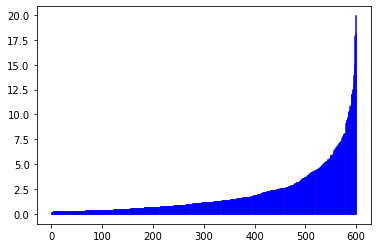

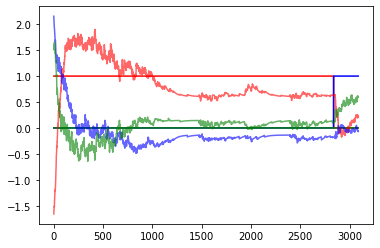

  1%|█▎                                                                                                                                                            | 24/3000 [08:27<16:37:48, 20.12s/it]

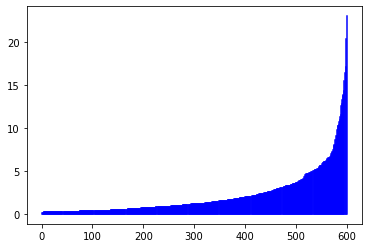

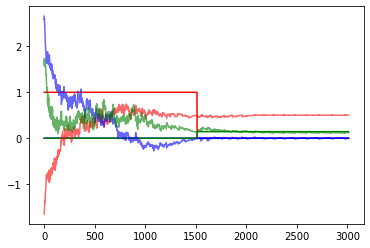

  1%|█▌                                                                                                                                                            | 29/3000 [10:09<15:51:22, 19.21s/it]

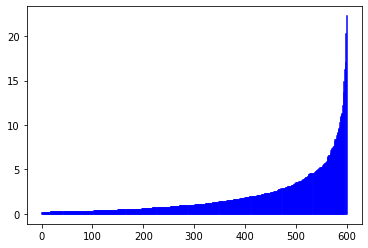

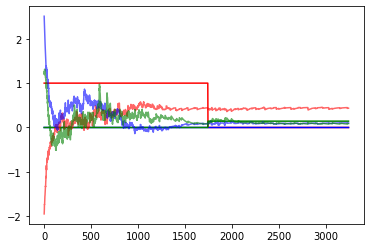

  1%|█▊                                                                                                                                                            | 34/3000 [11:55<16:48:10, 20.39s/it]

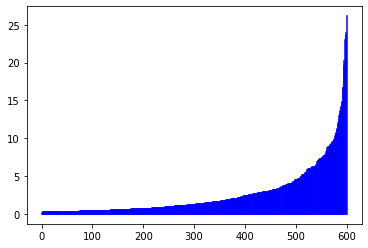

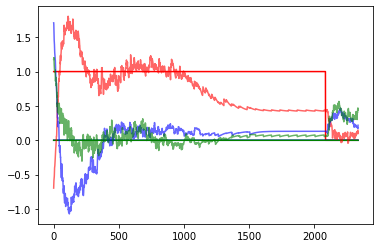

  1%|██                                                                                                                                                            | 39/3000 [13:41<16:43:27, 20.33s/it]

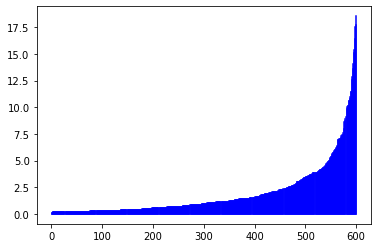

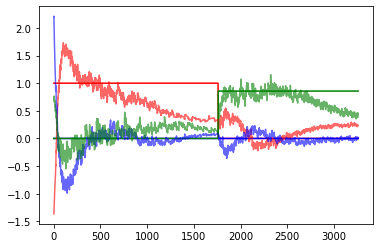

  1%|██▎                                                                                                                                                           | 44/3000 [15:25<16:41:03, 20.32s/it]

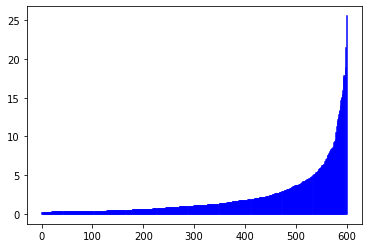

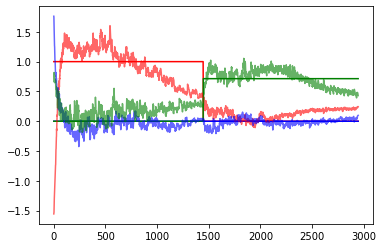

  2%|██▌                                                                                                                                                           | 49/3000 [17:10<16:20:21, 19.93s/it]

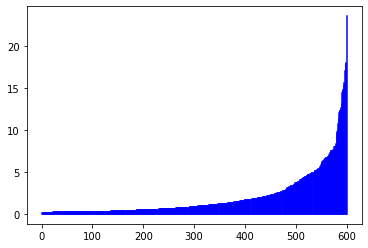

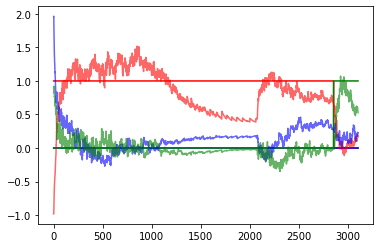

  2%|██▊                                                                                                                                                           | 54/3000 [19:47<19:48:15, 24.20s/it]

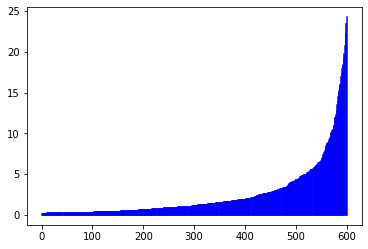

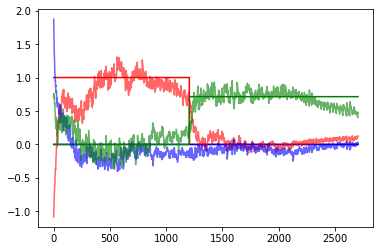

  2%|███                                                                                                                                                           | 59/3000 [21:33<17:22:44, 21.27s/it]

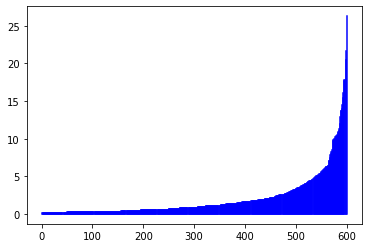

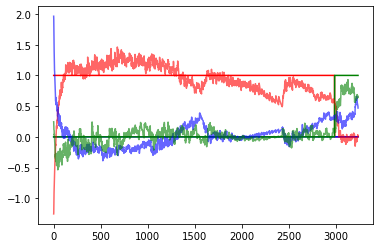

  2%|███▎                                                                                                                                                          | 64/3000 [23:22<17:15:19, 21.16s/it]

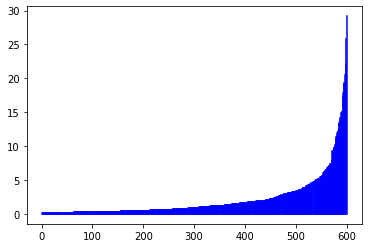

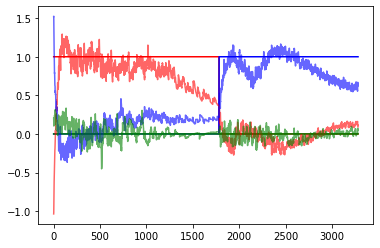

  2%|███▋                                                                                                                                                          | 69/3000 [25:08<16:49:23, 20.66s/it]

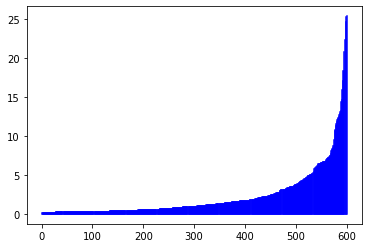

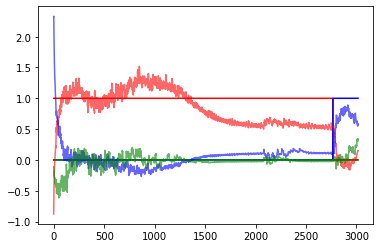

  2%|███▉                                                                                                                                                          | 74/3000 [26:53<16:27:10, 20.24s/it]

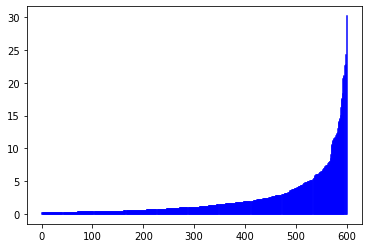

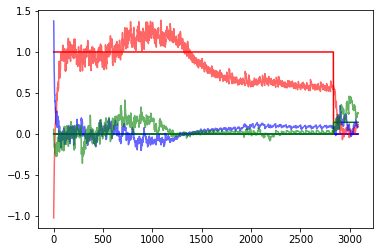

  3%|████▏                                                                                                                                                         | 79/3000 [28:34<16:24:36, 20.22s/it]

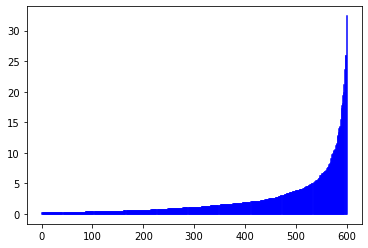

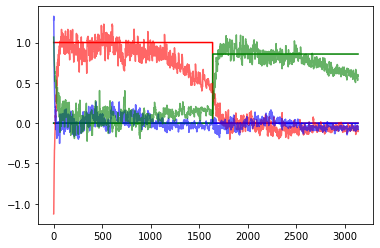

  3%|████▍                                                                                                                                                         | 84/3000 [30:22<16:25:24, 20.28s/it]

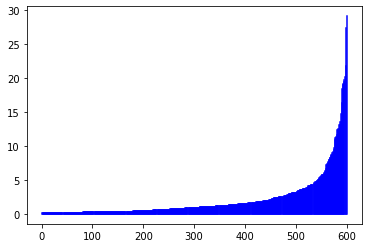

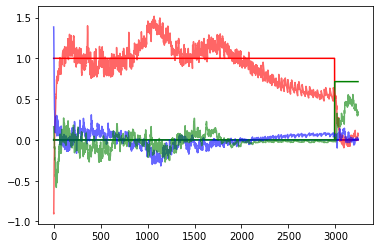

  3%|████▋                                                                                                                                                         | 89/3000 [32:13<17:13:40, 21.31s/it]

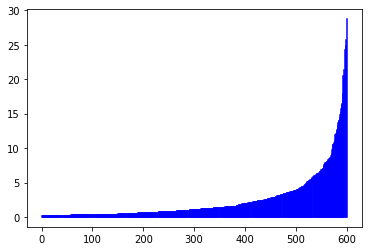

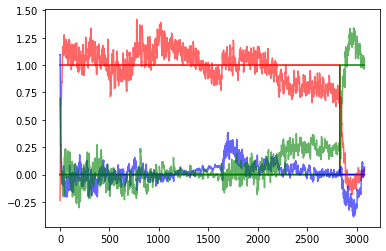

  3%|████▉                                                                                                                                                         | 94/3000 [34:01<16:43:29, 20.72s/it]

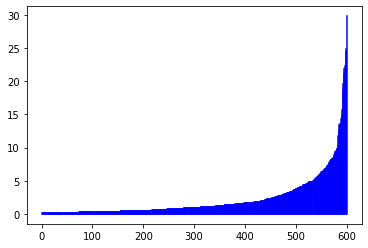

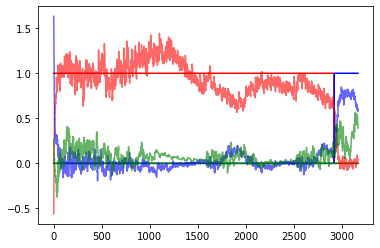

  3%|█████▏                                                                                                                                                        | 99/3000 [35:47<16:37:51, 20.64s/it]

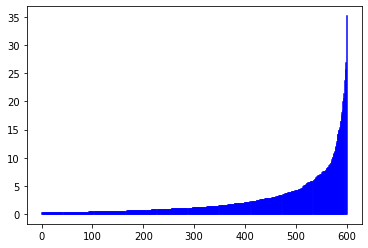

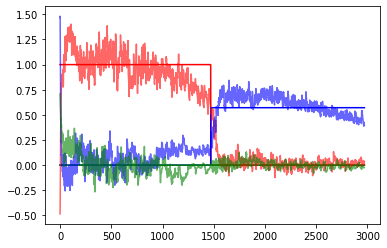

  3%|█████▍                                                                                                                                                       | 104/3000 [38:23<19:29:58, 24.24s/it]

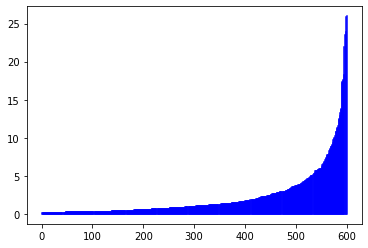

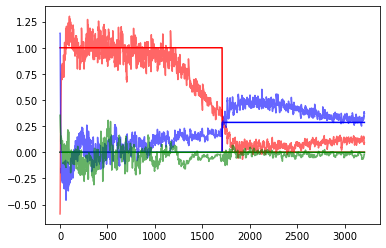

  4%|█████▋                                                                                                                                                       | 109/3000 [40:11<17:16:44, 21.52s/it]

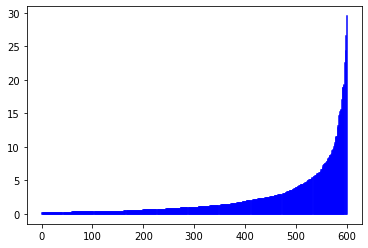

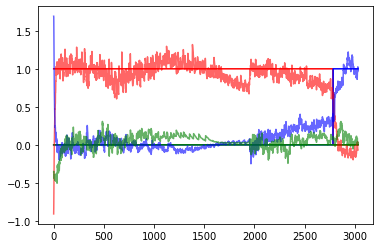

  4%|█████▉                                                                                                                                                       | 114/3000 [41:56<16:20:42, 20.39s/it]

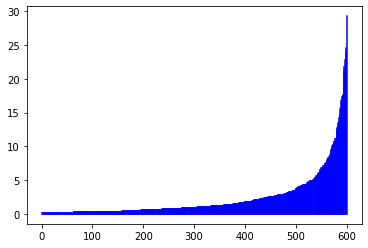

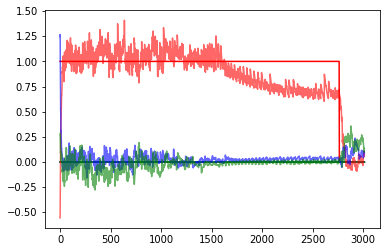

  4%|██████▏                                                                                                                                                      | 119/3000 [43:45<16:43:13, 20.89s/it]

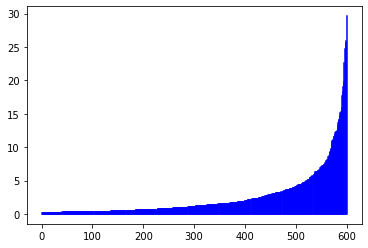

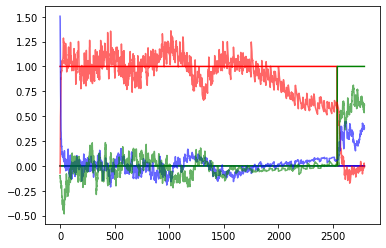

  4%|██████▍                                                                                                                                                      | 124/3000 [45:32<16:33:24, 20.72s/it]

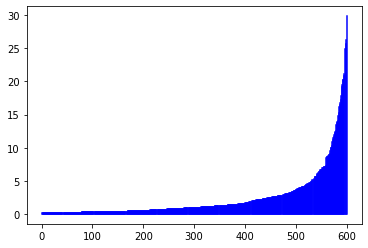

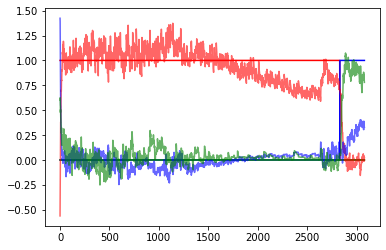

  4%|██████▊                                                                                                                                                      | 129/3000 [47:15<16:09:59, 20.27s/it]

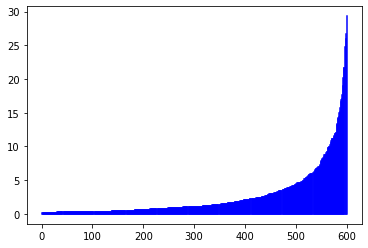

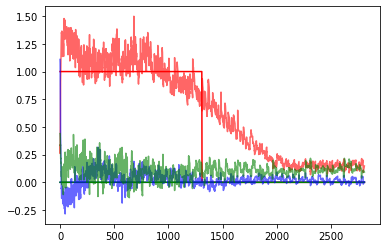

  4%|███████                                                                                                                                                      | 134/3000 [49:00<16:10:40, 20.32s/it]

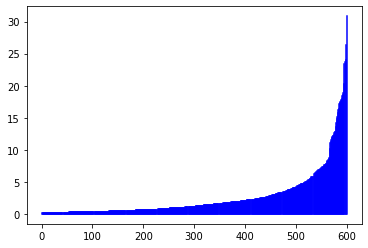

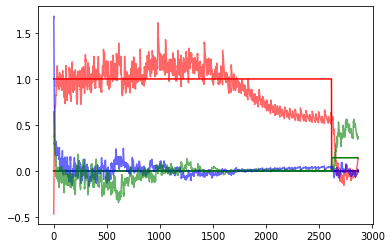

  5%|███████▎                                                                                                                                                     | 139/3000 [50:47<16:18:46, 20.53s/it]

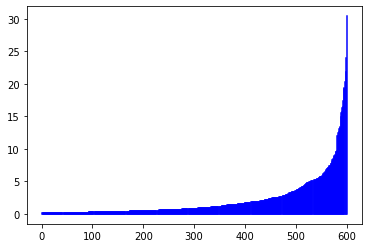

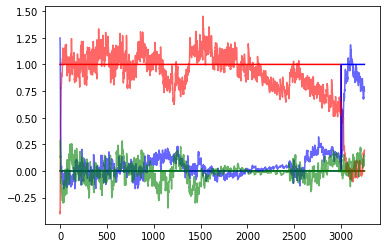

  5%|███████▌                                                                                                                                                     | 144/3000 [52:33<16:13:23, 20.45s/it]

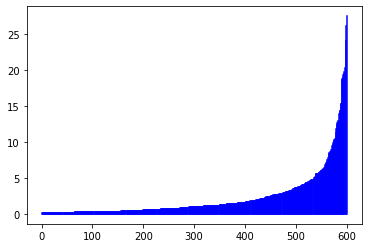

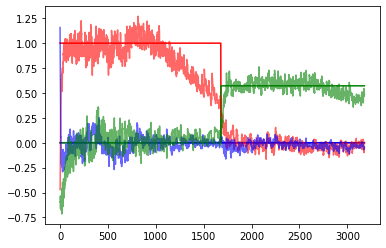

  5%|███████▊                                                                                                                                                     | 149/3000 [54:19<16:09:43, 20.41s/it]

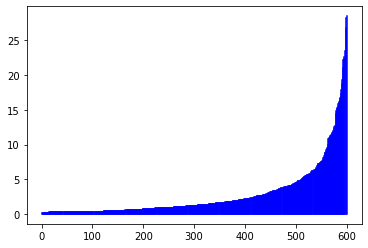

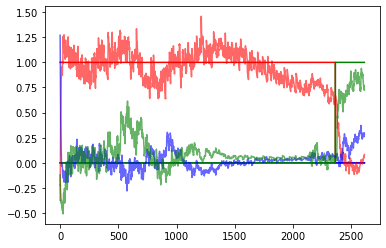

  5%|████████                                                                                                                                                     | 154/3000 [56:50<18:41:01, 23.63s/it]

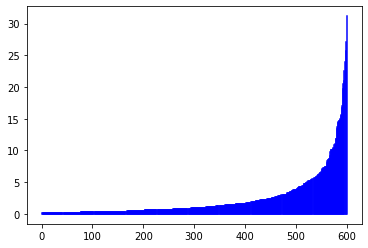

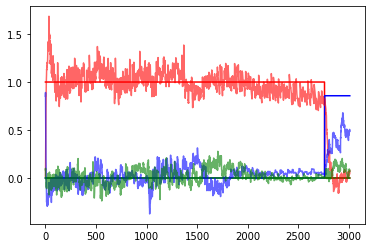

  5%|████████▎                                                                                                                                                    | 159/3000 [58:32<16:06:33, 20.41s/it]

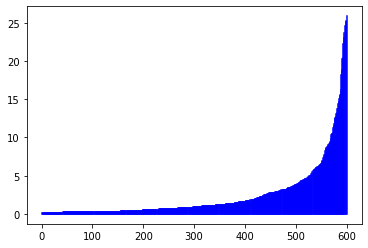

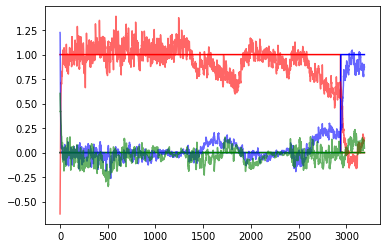

  5%|████████▍                                                                                                                                                  | 164/3000 [1:00:16<15:39:21, 19.87s/it]

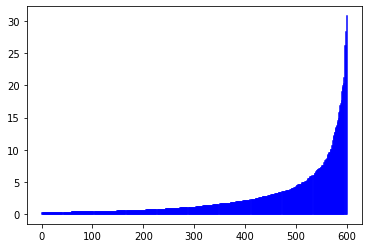

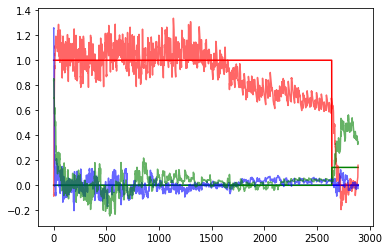

  6%|████████▋                                                                                                                                                  | 169/3000 [1:01:58<15:39:57, 19.92s/it]

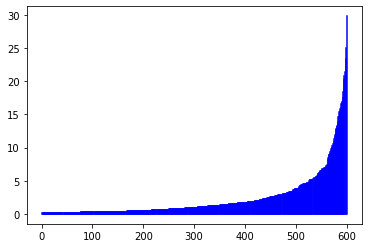

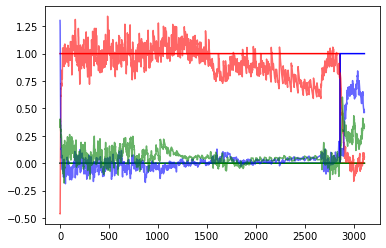

  6%|████████▉                                                                                                                                                  | 174/3000 [1:03:43<15:53:22, 20.24s/it]

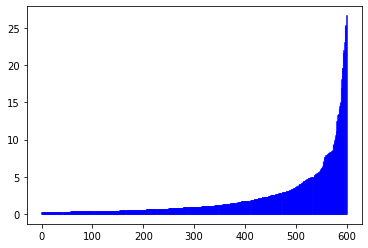

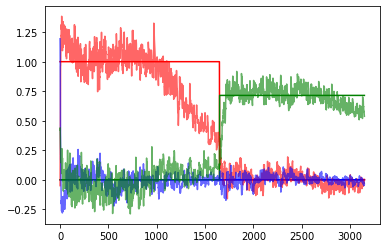

  6%|█████████▏                                                                                                                                                 | 179/3000 [1:05:21<14:48:08, 18.89s/it]

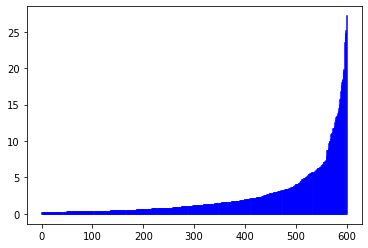

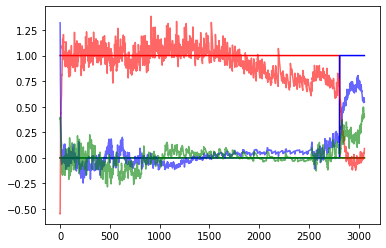

  6%|█████████▌                                                                                                                                                 | 184/3000 [1:07:05<15:28:43, 19.79s/it]

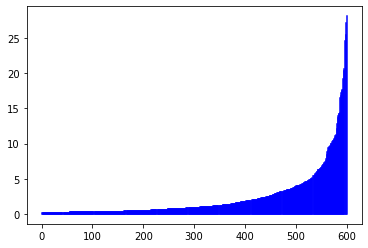

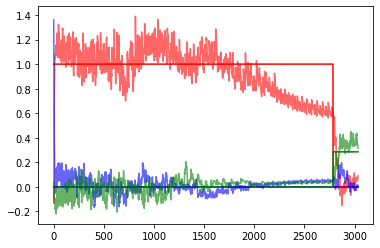

  6%|█████████▊                                                                                                                                                 | 189/3000 [1:08:52<16:08:30, 20.67s/it]

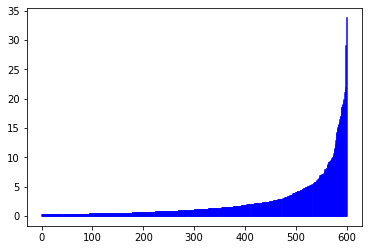

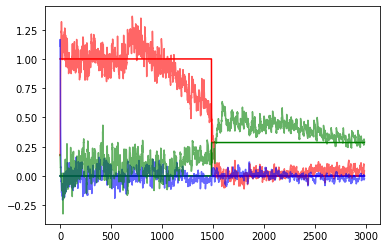

  6%|██████████                                                                                                                                                 | 194/3000 [1:10:36<15:45:41, 20.22s/it]

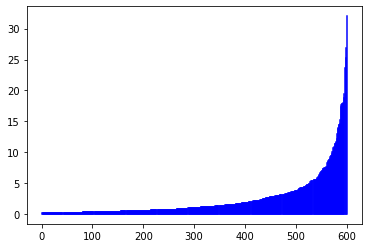

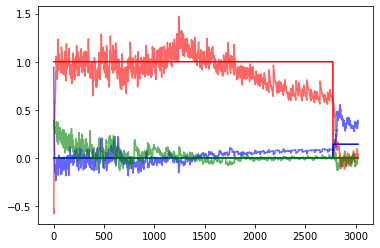

  7%|██████████▎                                                                                                                                                | 199/3000 [1:12:17<15:21:21, 19.74s/it]

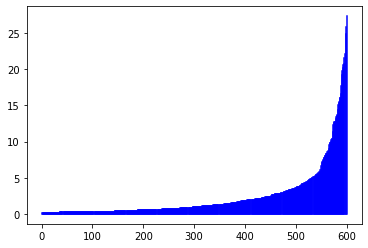

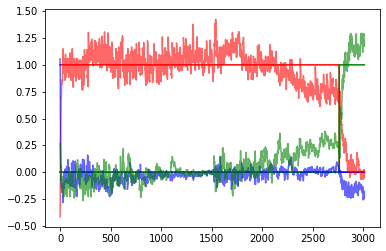

  7%|██████████▌                                                                                                                                                | 204/3000 [1:14:51<18:22:44, 23.66s/it]

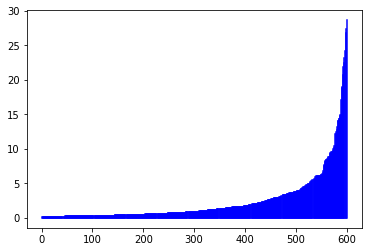

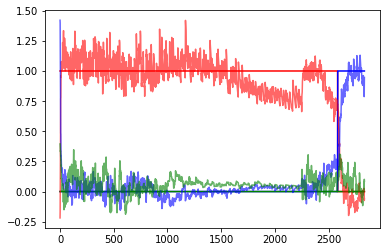

  7%|██████████▊                                                                                                                                                | 209/3000 [1:16:40<16:43:20, 21.57s/it]

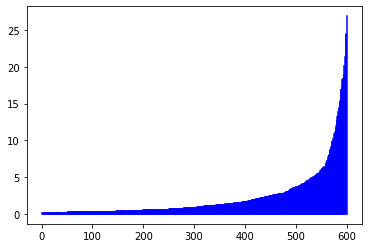

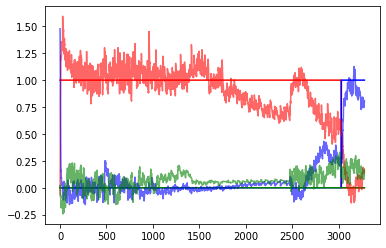

  7%|███████████                                                                                                                                                | 214/3000 [1:18:22<15:31:21, 20.06s/it]

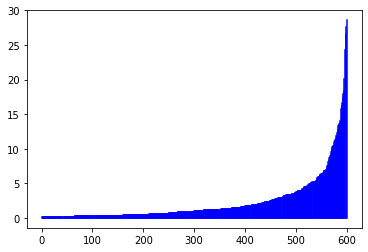

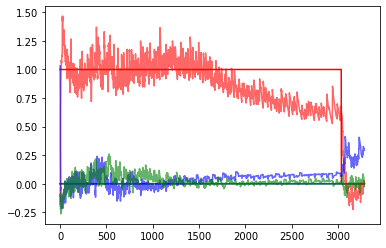

  7%|███████████▎                                                                                                                                               | 219/3000 [1:20:07<15:31:08, 20.09s/it]

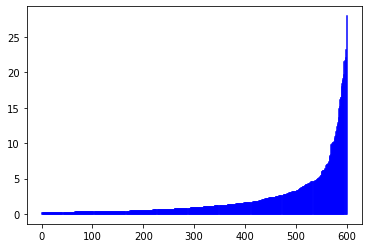

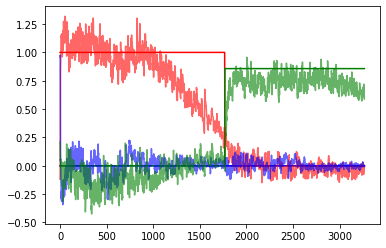

  7%|███████████▌                                                                                                                                               | 224/3000 [1:21:56<16:09:51, 20.96s/it]

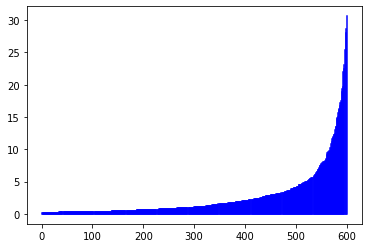

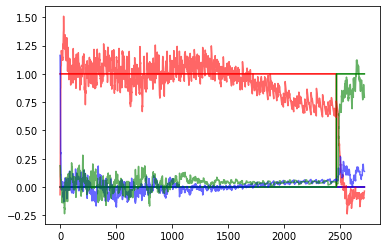

  8%|███████████▊                                                                                                                                               | 229/3000 [1:23:39<15:36:26, 20.28s/it]

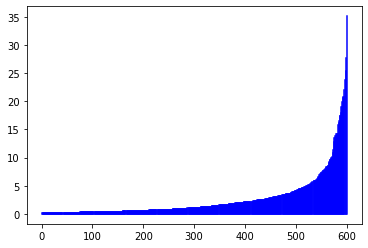

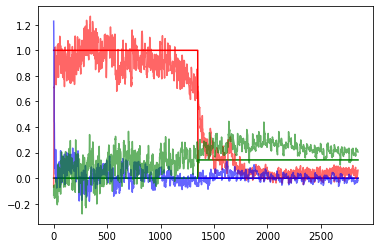

  8%|████████████                                                                                                                                               | 234/3000 [1:25:23<15:35:05, 20.28s/it]

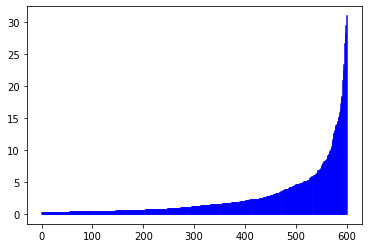

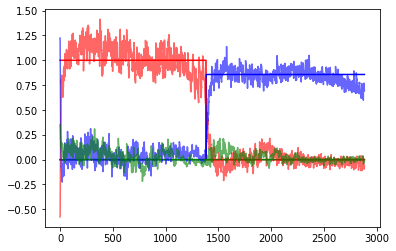

  8%|████████████▎                                                                                                                                              | 239/3000 [1:27:09<15:32:39, 20.27s/it]

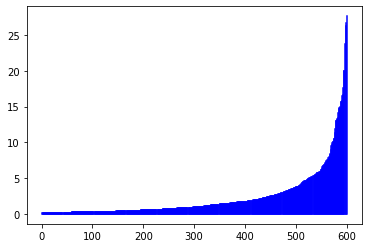

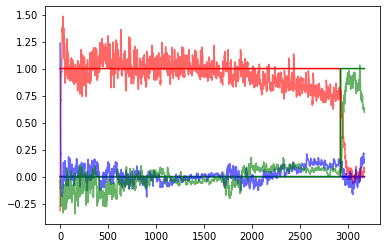

  8%|████████████▌                                                                                                                                              | 244/3000 [1:28:54<15:24:09, 20.12s/it]

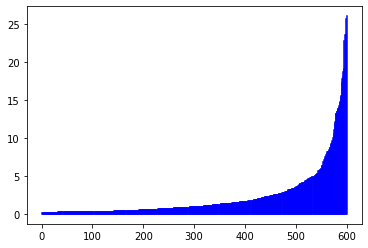

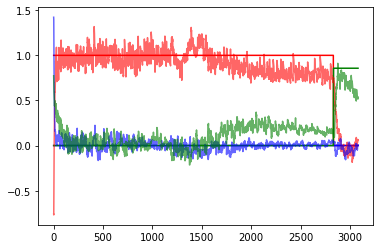

  8%|████████████▊                                                                                                                                              | 249/3000 [1:30:40<15:28:54, 20.26s/it]

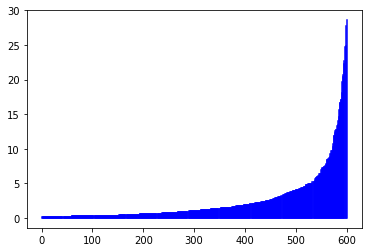

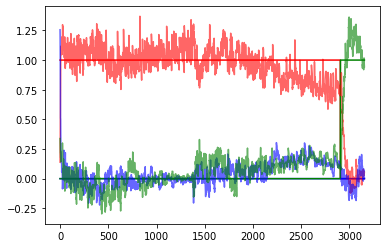

  8%|█████████████                                                                                                                                              | 254/3000 [1:33:16<18:08:57, 23.79s/it]

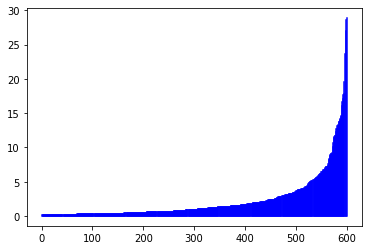

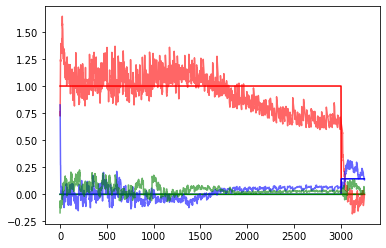

  9%|█████████████▍                                                                                                                                             | 259/3000 [1:35:04<16:16:57, 21.39s/it]

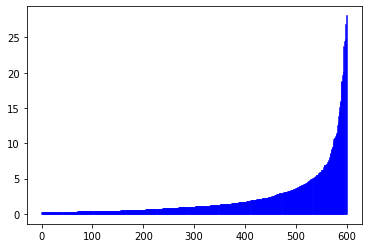

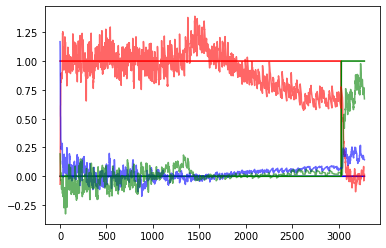

  9%|█████████████▋                                                                                                                                             | 264/3000 [1:36:48<15:21:05, 20.20s/it]

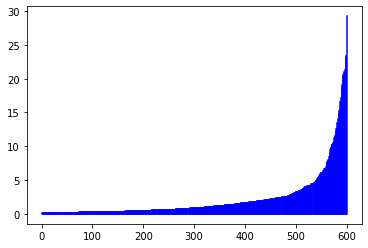

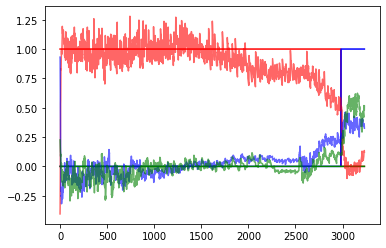

  9%|█████████████▉                                                                                                                                             | 269/3000 [1:38:36<15:31:45, 20.47s/it]

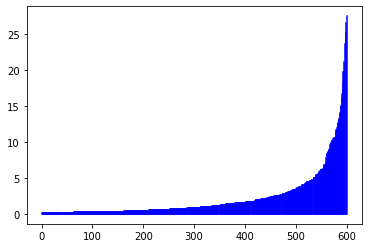

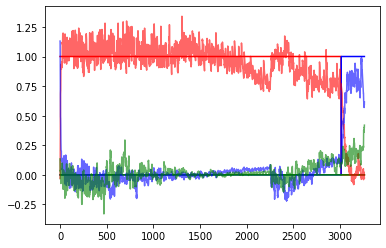

  9%|██████████████▏                                                                                                                                            | 274/3000 [1:40:22<15:24:56, 20.36s/it]

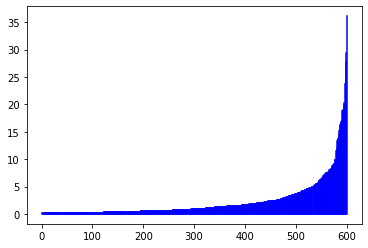

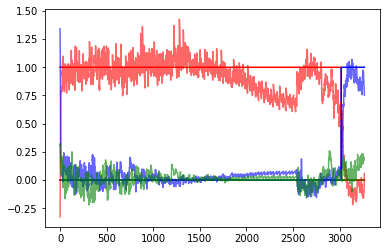

  9%|██████████████▍                                                                                                                                            | 279/3000 [1:42:07<15:22:08, 20.33s/it]

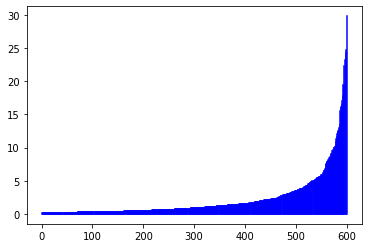

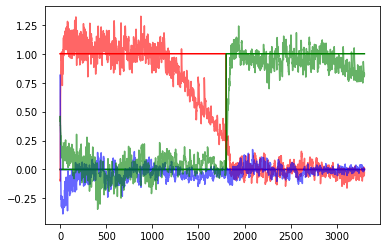

  9%|██████████████▋                                                                                                                                            | 284/3000 [1:43:47<14:35:29, 19.34s/it]

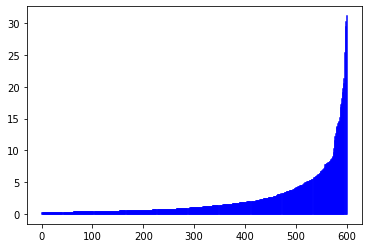

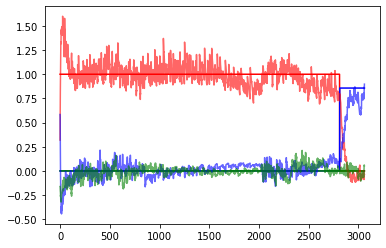

 10%|██████████████▉                                                                                                                                            | 289/3000 [1:45:31<15:10:30, 20.15s/it]

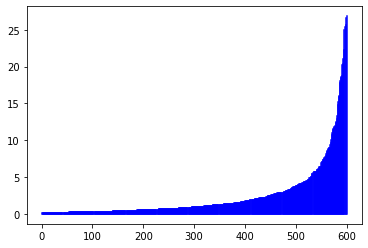

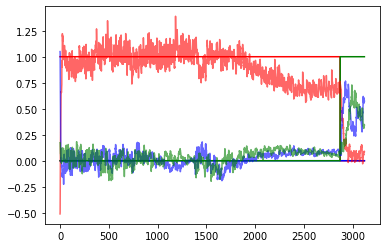

 10%|███████████████▏                                                                                                                                           | 294/3000 [1:47:14<15:00:40, 19.97s/it]

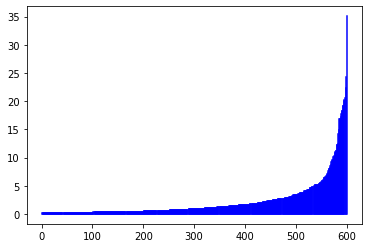

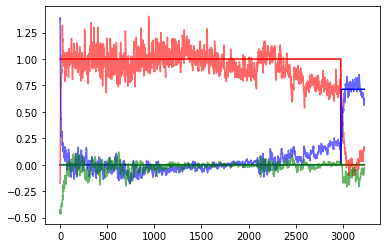

 10%|███████████████▍                                                                                                                                           | 299/3000 [1:48:59<15:11:09, 20.24s/it]

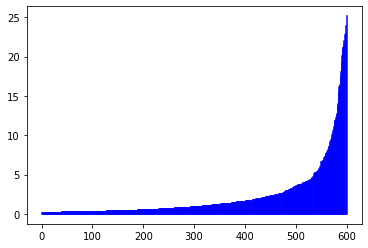

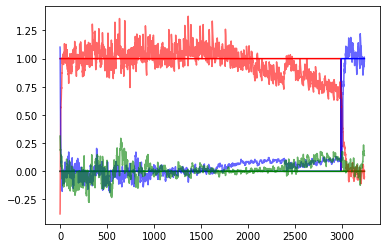

 10%|███████████████▋                                                                                                                                           | 304/3000 [1:51:33<17:56:59, 23.97s/it]

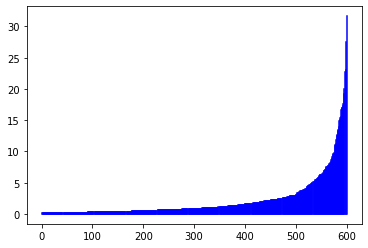

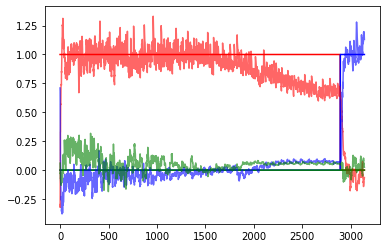

 10%|███████████████▉                                                                                                                                           | 309/3000 [1:53:16<15:26:54, 20.67s/it]

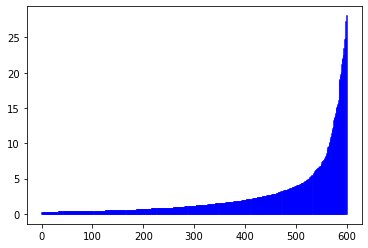

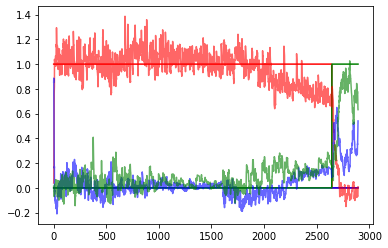

 10%|████████████████▏                                                                                                                                          | 314/3000 [1:55:00<15:04:14, 20.20s/it]

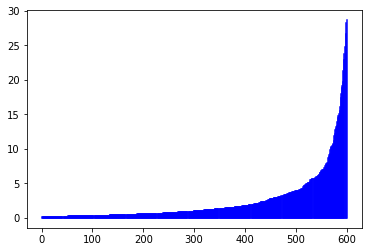

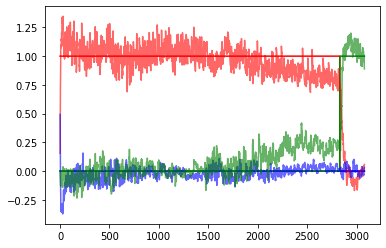

 11%|████████████████▍                                                                                                                                          | 319/3000 [1:56:43<14:57:42, 20.09s/it]

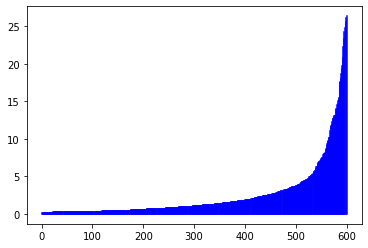

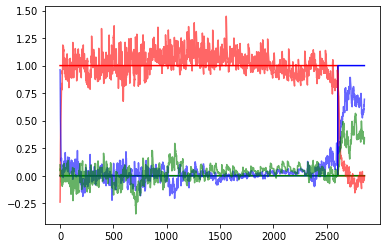

 11%|████████████████▋                                                                                                                                          | 324/3000 [1:58:27<14:38:23, 19.69s/it]

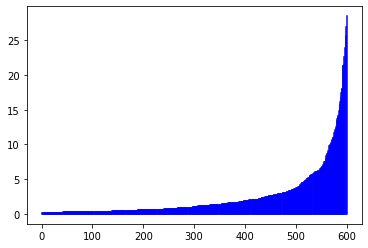

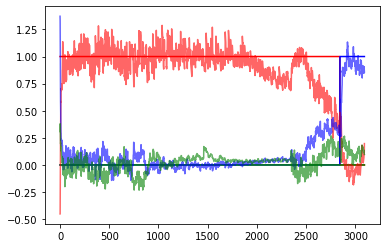

 11%|████████████████▉                                                                                                                                          | 329/3000 [2:00:09<14:21:53, 19.36s/it]

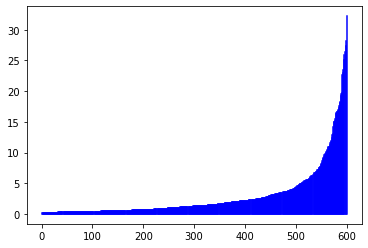

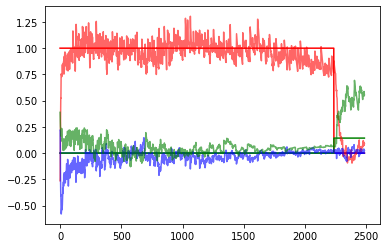

 11%|█████████████████▎                                                                                                                                         | 334/3000 [2:01:51<14:21:38, 19.39s/it]

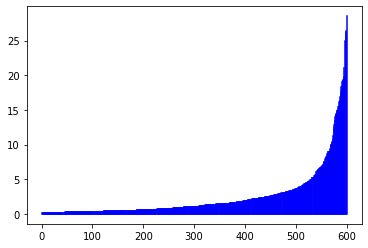

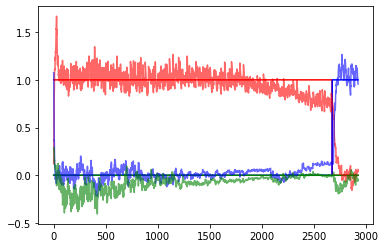

 11%|█████████████████▌                                                                                                                                         | 339/3000 [2:03:35<14:44:31, 19.94s/it]

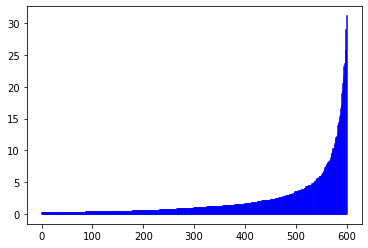

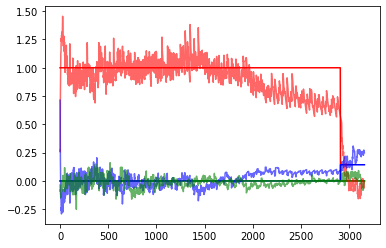

 11%|█████████████████▊                                                                                                                                         | 344/3000 [2:05:20<14:52:43, 20.17s/it]

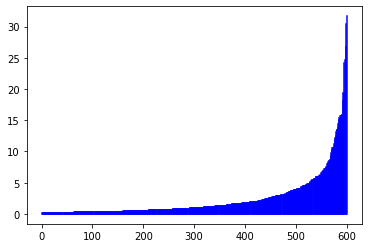

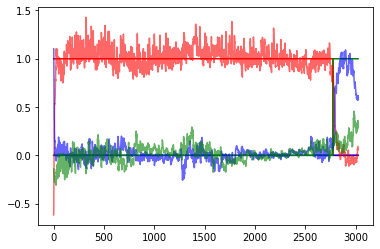

 12%|██████████████████                                                                                                                                         | 349/3000 [2:07:07<15:19:50, 20.82s/it]

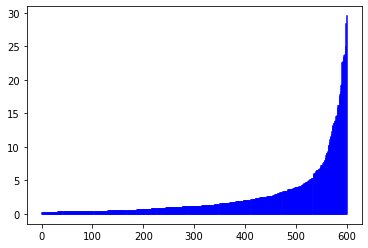

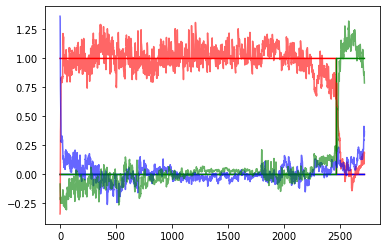

 12%|██████████████████▎                                                                                                                                        | 354/3000 [2:09:35<16:52:54, 22.97s/it]

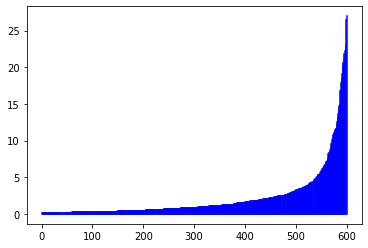

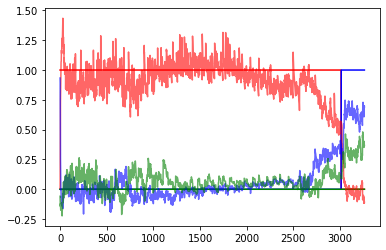

 12%|██████████████████▌                                                                                                                                        | 359/3000 [2:11:22<15:27:55, 21.08s/it]

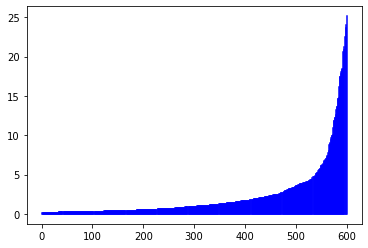

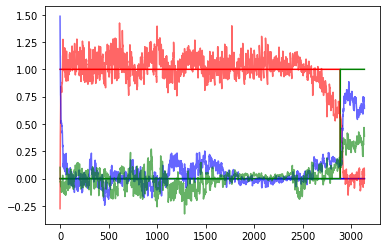

 12%|██████████████████▊                                                                                                                                        | 364/3000 [2:13:04<14:43:22, 20.11s/it]

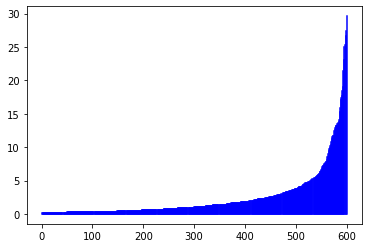

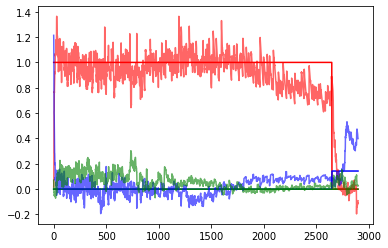

 12%|███████████████████                                                                                                                                        | 369/3000 [2:14:45<14:07:00, 19.32s/it]

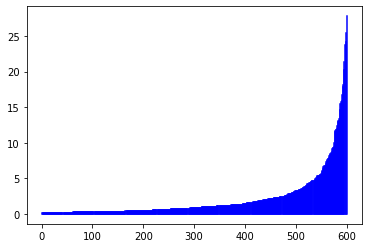

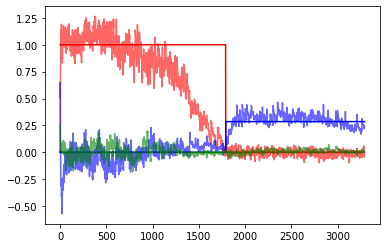

 12%|███████████████████▎                                                                                                                                       | 374/3000 [2:16:28<14:20:09, 19.65s/it]

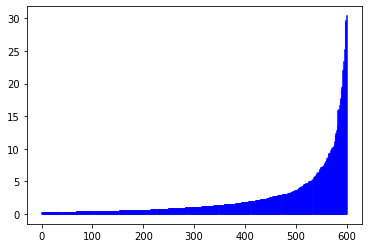

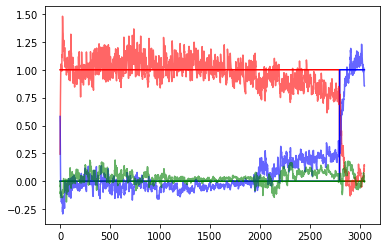

 13%|███████████████████▌                                                                                                                                       | 379/3000 [2:18:14<14:57:38, 20.55s/it]

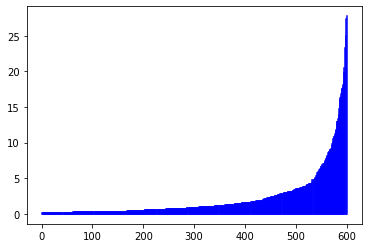

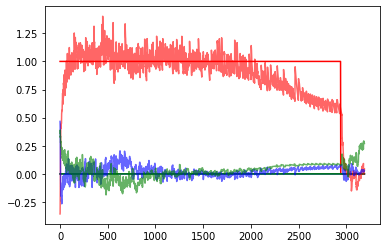

 13%|███████████████████▊                                                                                                                                       | 384/3000 [2:20:01<14:54:29, 20.52s/it]

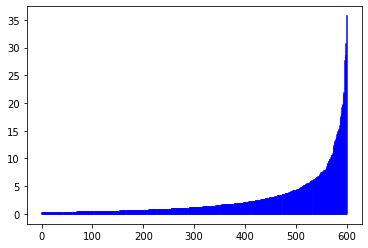

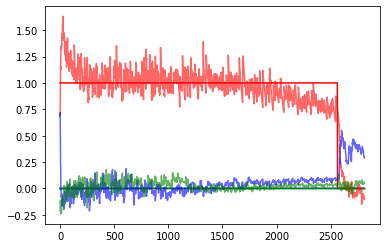

 13%|████████████████████                                                                                                                                       | 389/3000 [2:21:47<14:37:29, 20.16s/it]

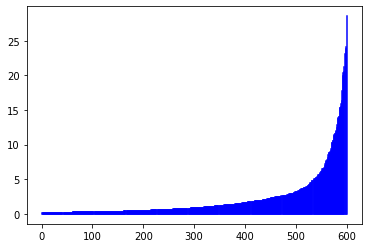

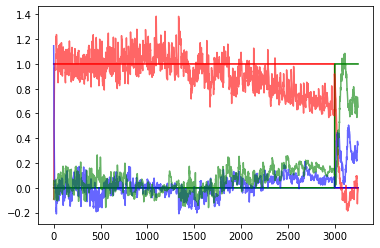

 13%|████████████████████▎                                                                                                                                      | 394/3000 [2:23:27<14:12:38, 19.63s/it]

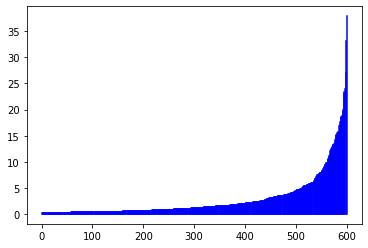

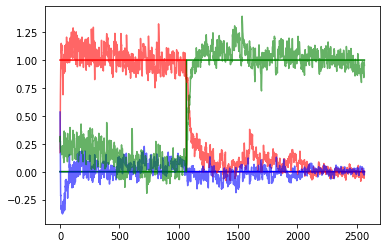

 13%|████████████████████▌                                                                                                                                      | 399/3000 [2:25:11<14:35:39, 20.20s/it]

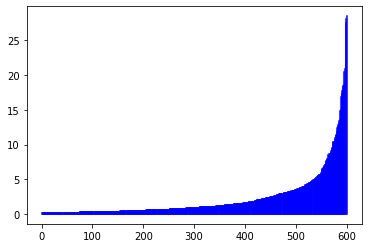

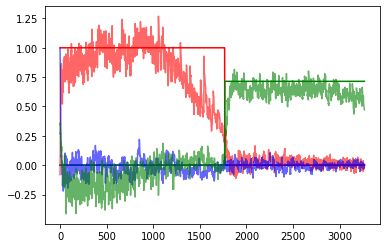

 13%|████████████████████▊                                                                                                                                      | 404/3000 [2:27:46<17:07:01, 23.74s/it]

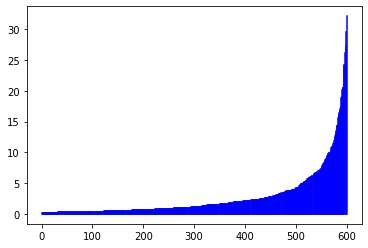

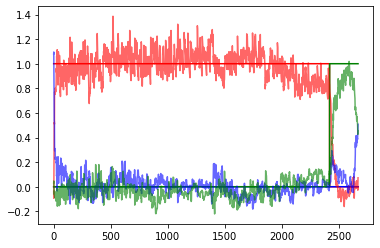

 14%|█████████████████████▏                                                                                                                                     | 409/3000 [2:29:34<15:23:42, 21.39s/it]

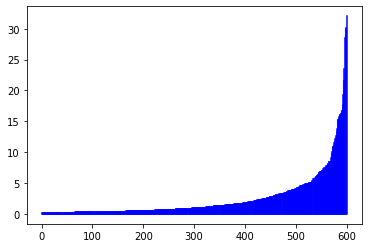

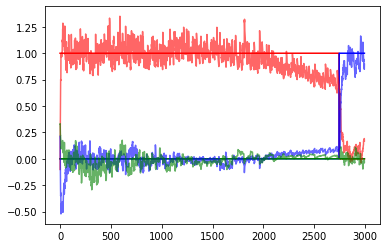

 14%|█████████████████████▍                                                                                                                                     | 414/3000 [2:31:20<14:55:57, 20.79s/it]

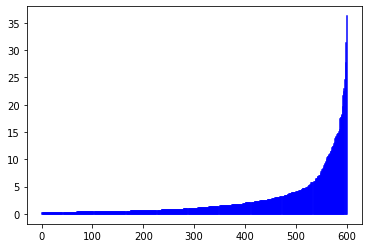

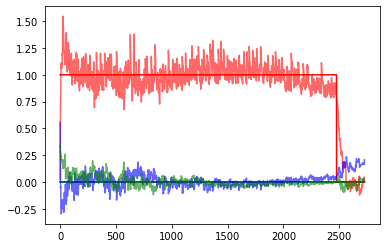

 14%|█████████████████████▋                                                                                                                                     | 419/3000 [2:33:06<14:40:21, 20.47s/it]

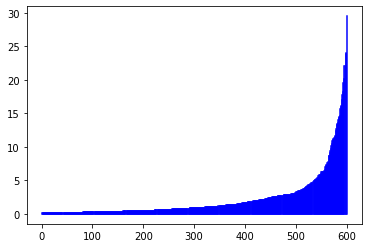

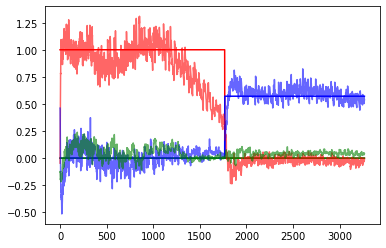

 14%|█████████████████████▉                                                                                                                                     | 424/3000 [2:34:49<13:59:25, 19.55s/it]

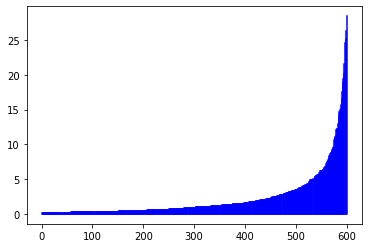

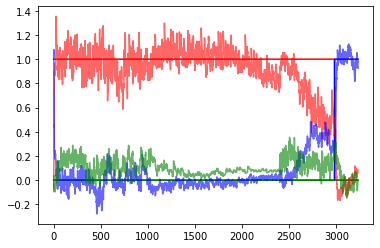

 14%|██████████████████████▏                                                                                                                                    | 429/3000 [2:36:34<14:18:15, 20.03s/it]

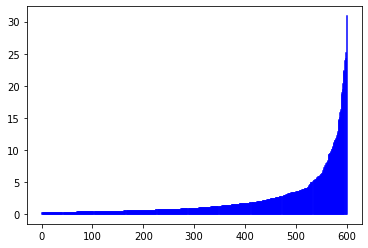

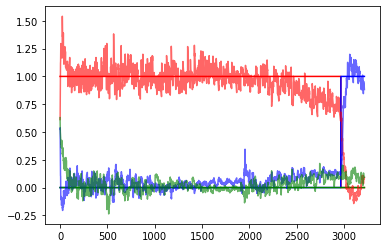

 14%|██████████████████████▍                                                                                                                                    | 434/3000 [2:38:21<14:35:26, 20.47s/it]

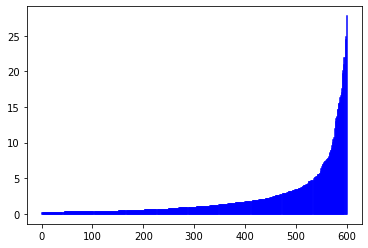

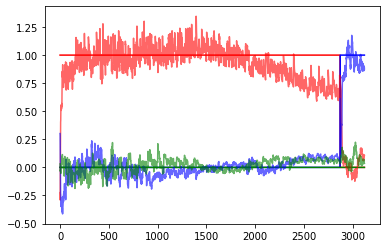

 15%|██████████████████████▋                                                                                                                                    | 439/3000 [2:40:06<14:24:37, 20.26s/it]

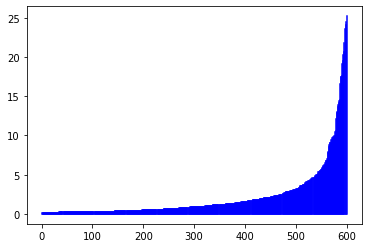

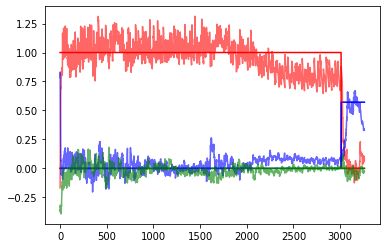

 15%|██████████████████████▉                                                                                                                                    | 444/3000 [2:41:52<14:20:43, 20.20s/it]

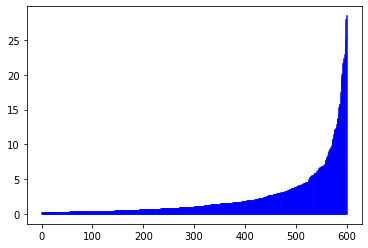

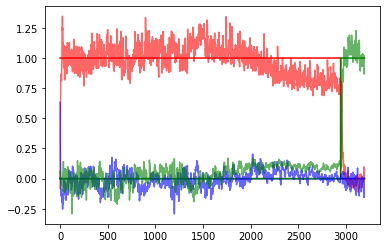

 15%|███████████████████████▏                                                                                                                                   | 449/3000 [2:43:33<14:01:56, 19.80s/it]

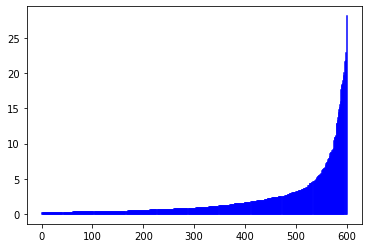

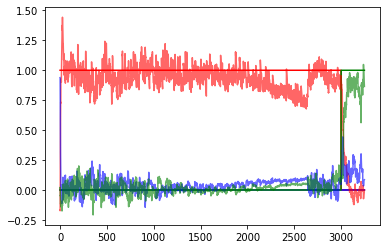

 15%|███████████████████████▍                                                                                                                                   | 454/3000 [2:46:05<16:17:58, 23.05s/it]

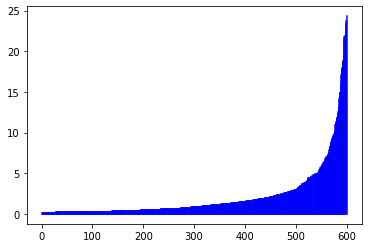

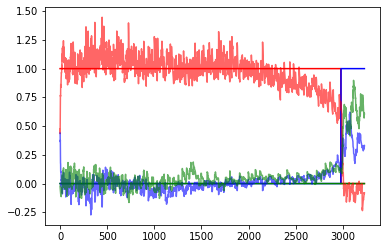

 15%|███████████████████████▋                                                                                                                                   | 459/3000 [2:47:51<14:55:08, 21.14s/it]

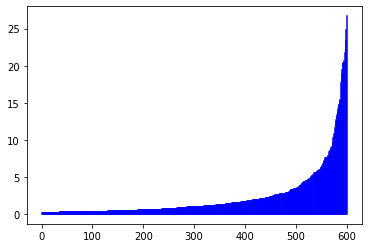

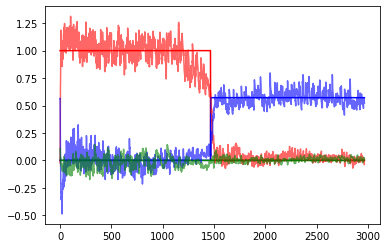

 15%|███████████████████████▉                                                                                                                                   | 464/3000 [2:49:34<13:59:59, 19.87s/it]

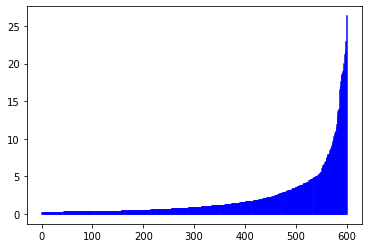

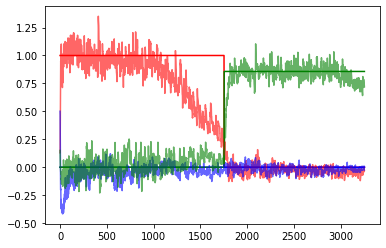

 16%|████████████████████████▏                                                                                                                                  | 469/3000 [2:51:16<13:47:31, 19.62s/it]

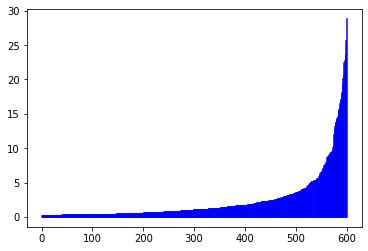

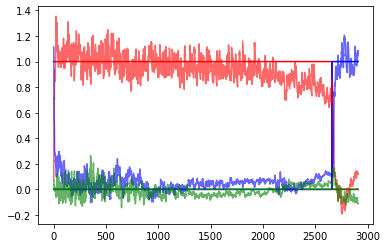

 16%|████████████████████████▍                                                                                                                                  | 474/3000 [2:52:58<13:59:17, 19.94s/it]

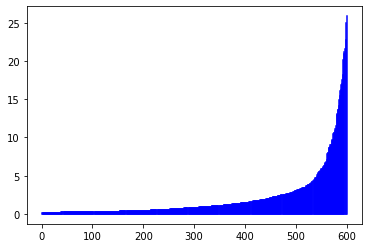

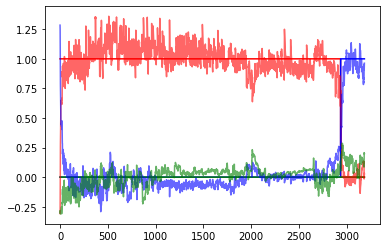

 16%|████████████████████████▋                                                                                                                                  | 479/3000 [2:54:41<13:55:24, 19.88s/it]

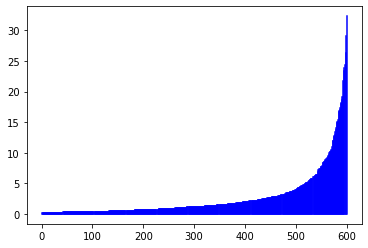

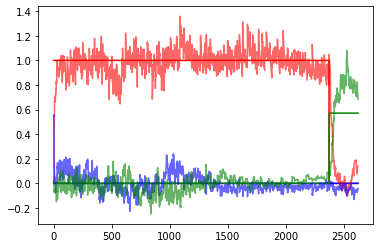

 16%|█████████████████████████                                                                                                                                  | 484/3000 [2:56:23<13:44:21, 19.66s/it]

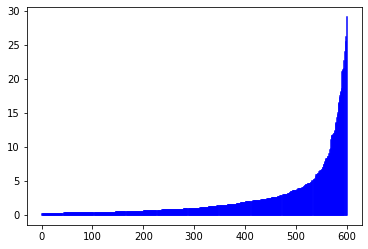

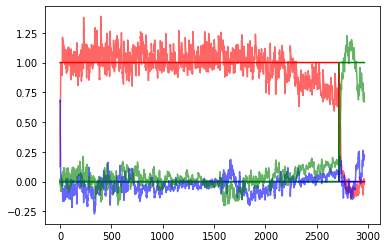

 16%|█████████████████████████▎                                                                                                                                 | 489/3000 [2:58:05<13:31:36, 19.39s/it]

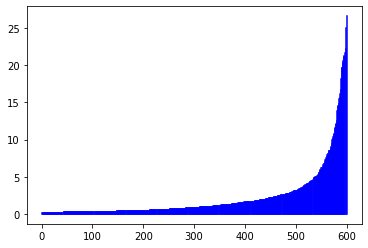

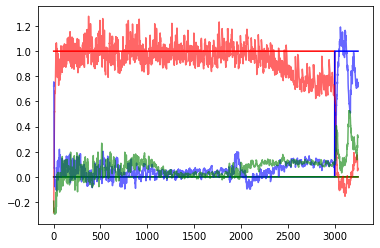

 16%|█████████████████████████▌                                                                                                                                 | 494/3000 [2:59:51<14:16:39, 20.51s/it]

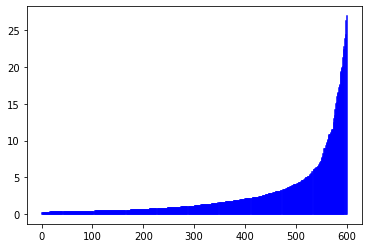

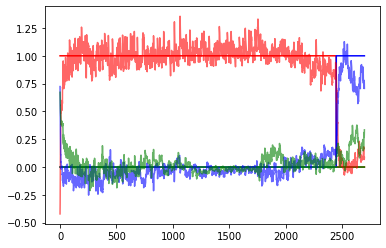

 17%|█████████████████████████▊                                                                                                                                 | 499/3000 [3:01:34<13:49:57, 19.91s/it]

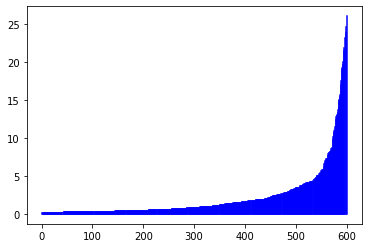

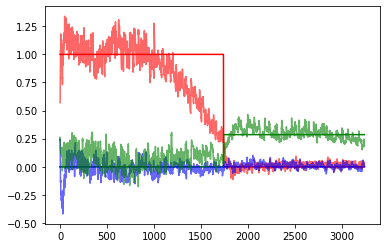

 17%|██████████████████████████                                                                                                                                 | 504/3000 [3:04:07<16:25:03, 23.68s/it]

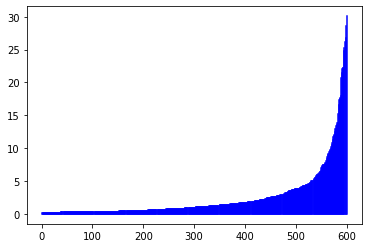

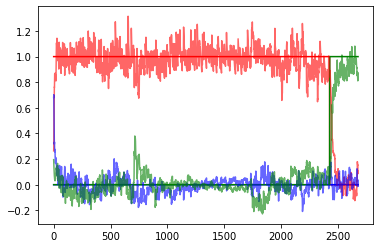

 17%|██████████████████████████▎                                                                                                                                | 509/3000 [3:05:51<14:23:59, 20.81s/it]

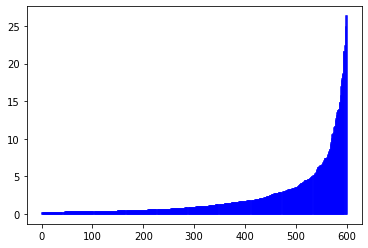

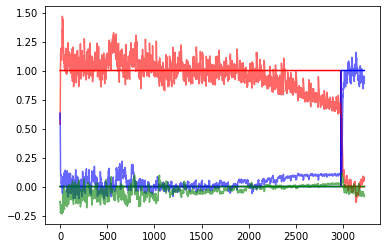

 17%|██████████████████████████▌                                                                                                                                | 514/3000 [3:07:35<13:50:22, 20.04s/it]

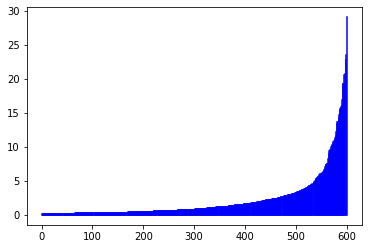

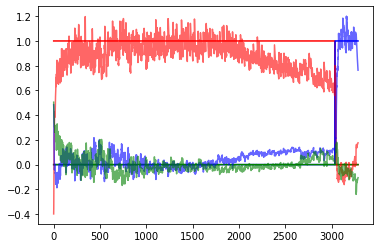

 17%|██████████████████████████▊                                                                                                                                | 519/3000 [3:09:18<13:40:17, 19.84s/it]

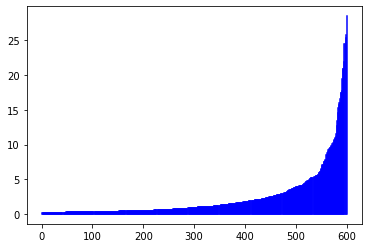

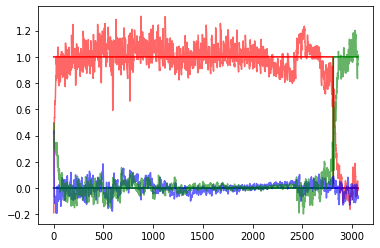

 17%|███████████████████████████                                                                                                                                | 524/3000 [3:11:02<13:39:14, 19.85s/it]

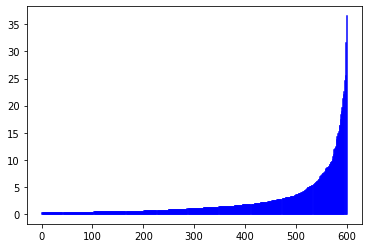

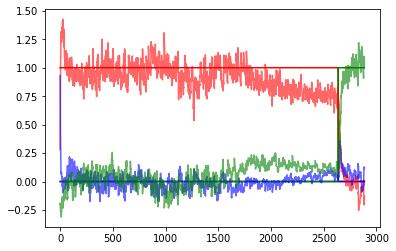

 18%|███████████████████████████▎                                                                                                                               | 529/3000 [3:12:46<13:46:08, 20.06s/it]

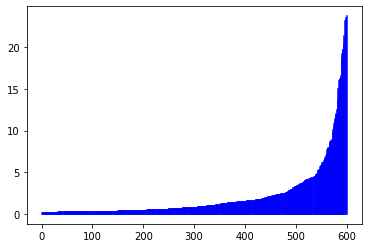

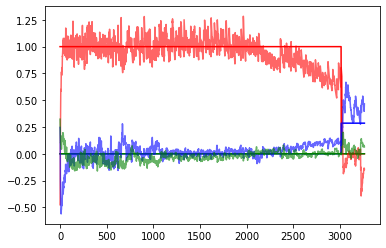

 18%|███████████████████████████▌                                                                                                                               | 534/3000 [3:14:32<13:59:39, 20.43s/it]

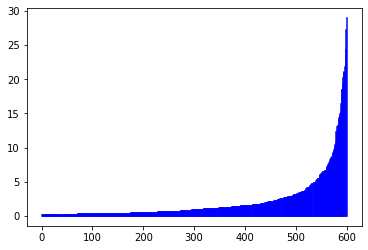

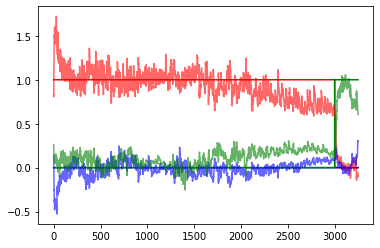

 18%|███████████████████████████▊                                                                                                                               | 539/3000 [3:16:18<14:00:31, 20.49s/it]

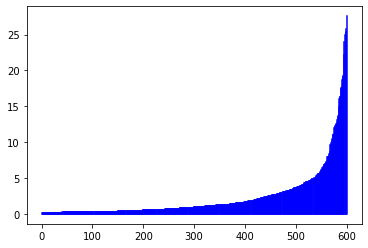

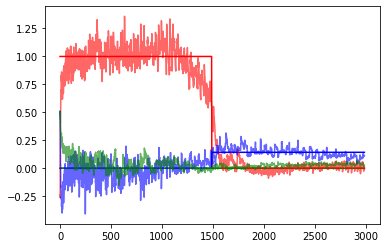

 18%|████████████████████████████                                                                                                                               | 544/3000 [3:18:03<14:02:50, 20.59s/it]

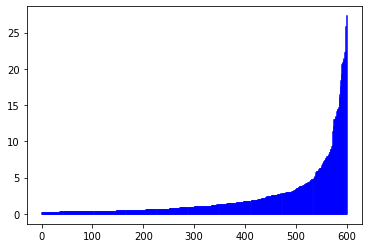

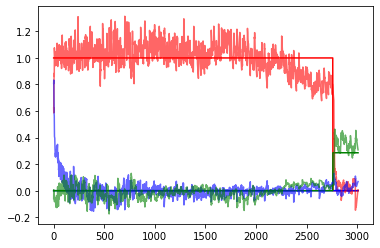

 18%|████████████████████████████▎                                                                                                                              | 549/3000 [3:19:52<14:08:05, 20.76s/it]

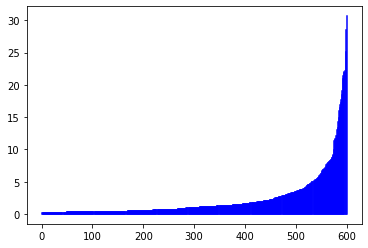

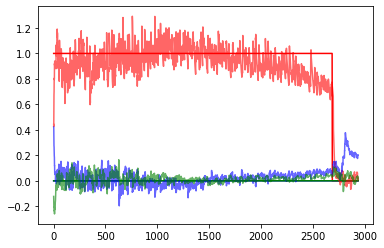

 18%|████████████████████████████▌                                                                                                                              | 554/3000 [3:22:22<16:10:28, 23.81s/it]

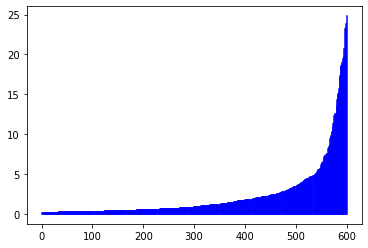

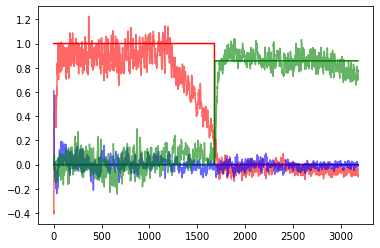

 19%|████████████████████████████▉                                                                                                                              | 559/3000 [3:24:02<13:42:57, 20.23s/it]

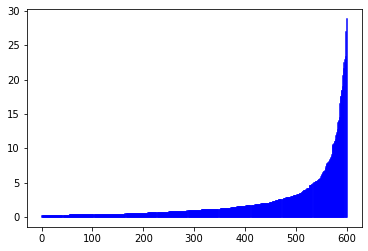

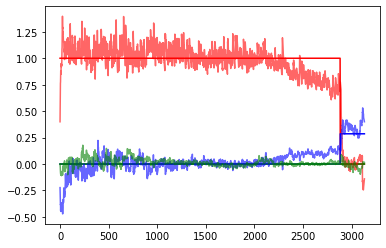

 19%|█████████████████████████████▏                                                                                                                             | 564/3000 [3:25:45<13:36:02, 20.10s/it]

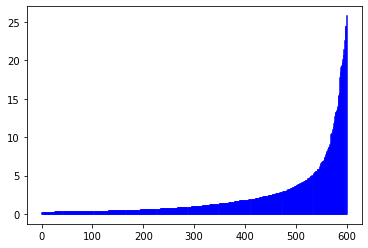

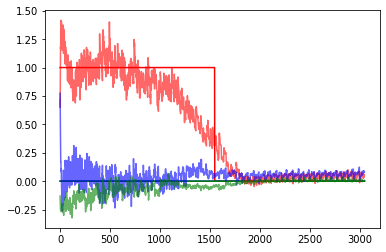

 19%|█████████████████████████████▍                                                                                                                             | 569/3000 [3:27:30<13:40:59, 20.26s/it]

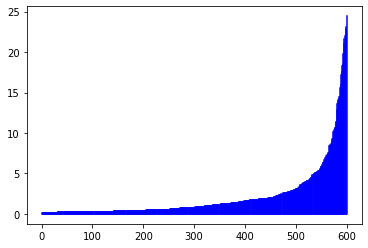

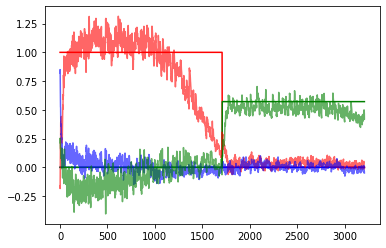

 19%|█████████████████████████████▋                                                                                                                             | 574/3000 [3:29:18<13:56:36, 20.69s/it]

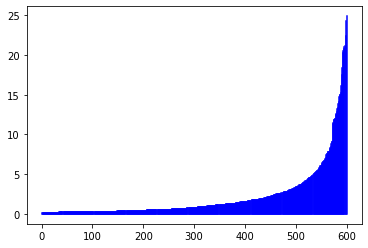

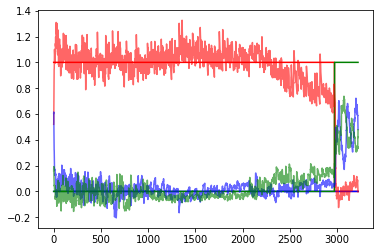

 19%|█████████████████████████████▉                                                                                                                             | 579/3000 [3:31:06<13:53:40, 20.66s/it]

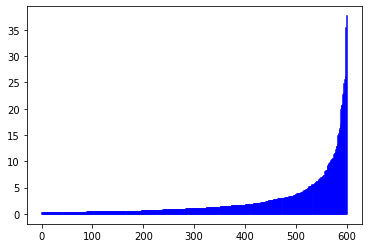

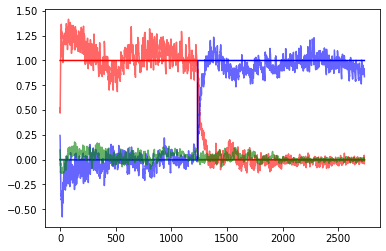

 19%|██████████████████████████████▏                                                                                                                            | 584/3000 [3:32:48<13:06:39, 19.54s/it]

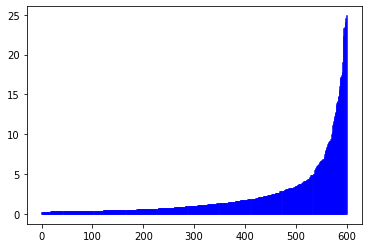

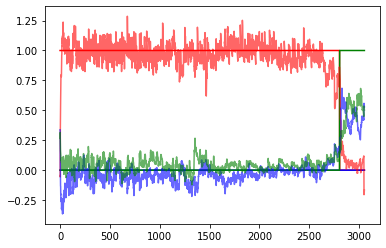

 20%|██████████████████████████████▍                                                                                                                            | 589/3000 [3:34:31<13:02:51, 19.48s/it]

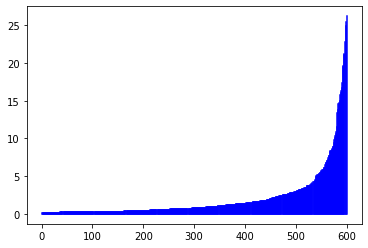

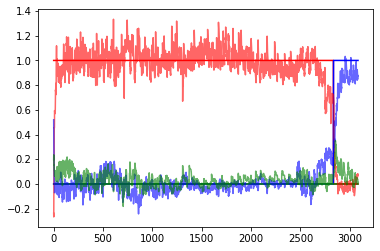

 20%|██████████████████████████████▋                                                                                                                            | 594/3000 [3:36:17<13:29:03, 20.18s/it]

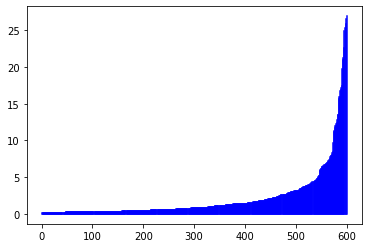

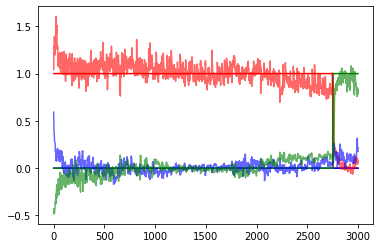

 20%|██████████████████████████████▉                                                                                                                            | 599/3000 [3:37:57<13:01:05, 19.52s/it]

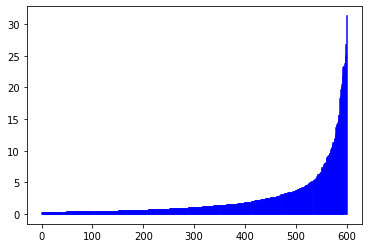

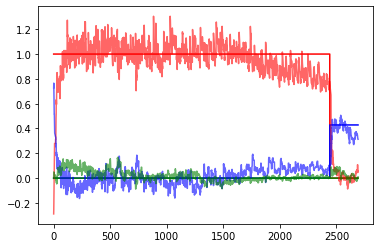

 20%|███████████████████████████████▏                                                                                                                           | 604/3000 [3:40:31<15:47:00, 23.71s/it]

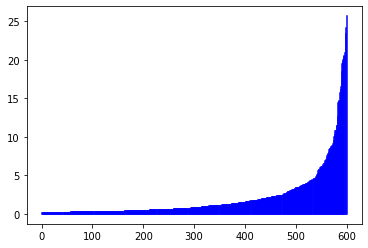

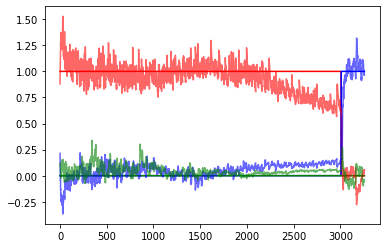

 20%|███████████████████████████████▍                                                                                                                           | 609/3000 [3:42:17<13:55:30, 20.97s/it]

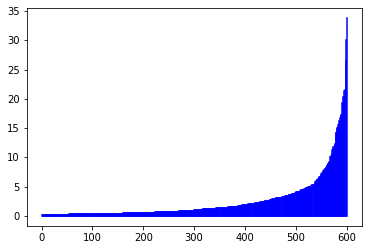

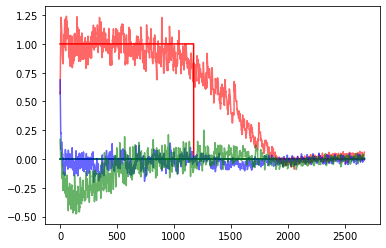

 20%|███████████████████████████████▋                                                                                                                           | 614/3000 [3:43:59<13:14:37, 19.98s/it]

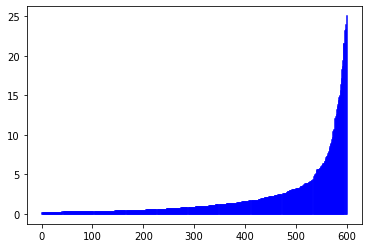

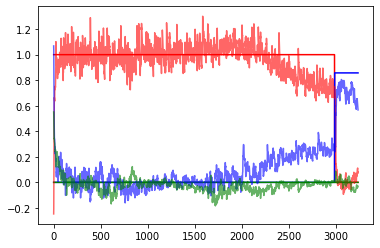

 21%|███████████████████████████████▉                                                                                                                           | 619/3000 [3:45:44<13:21:41, 20.20s/it]

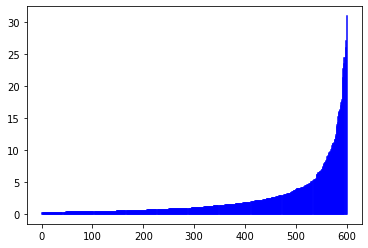

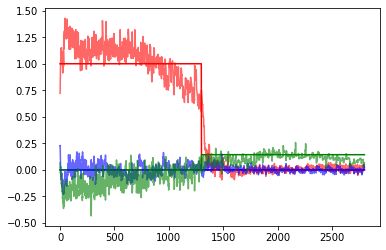

 21%|████████████████████████████████▏                                                                                                                          | 624/3000 [3:47:29<13:11:32, 19.99s/it]

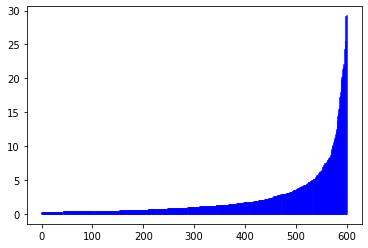

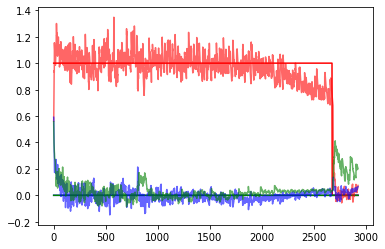

 21%|████████████████████████████████▍                                                                                                                          | 629/3000 [3:49:14<13:25:55, 20.39s/it]

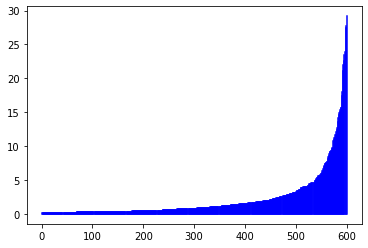

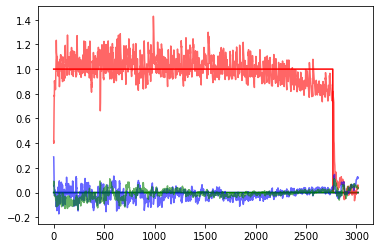

 21%|████████████████████████████████▊                                                                                                                          | 634/3000 [3:50:58<13:28:33, 20.50s/it]

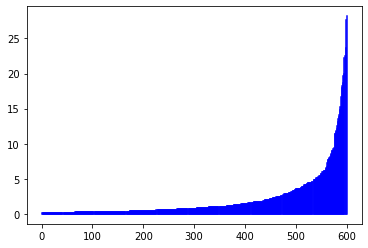

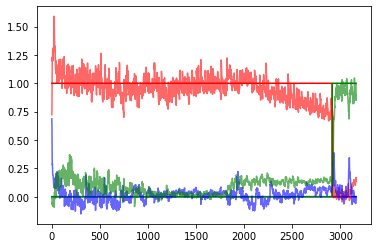

 21%|█████████████████████████████████                                                                                                                          | 639/3000 [3:52:43<13:08:45, 20.04s/it]

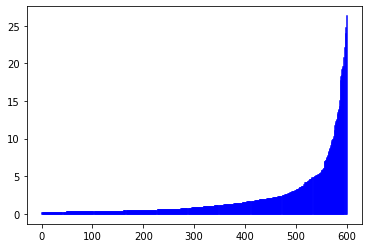

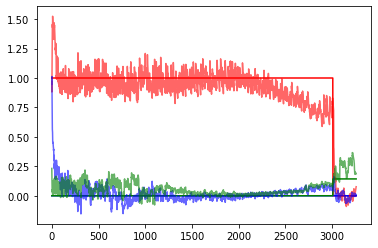

 21%|█████████████████████████████████▎                                                                                                                         | 644/3000 [3:54:28<13:25:39, 20.52s/it]

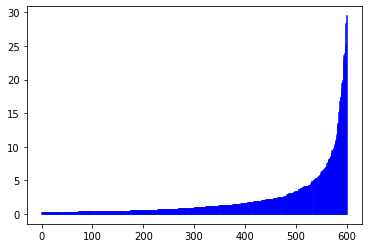

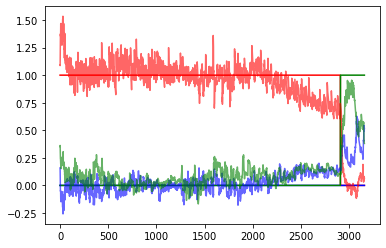

 22%|█████████████████████████████████▌                                                                                                                         | 649/3000 [3:56:12<12:59:31, 19.89s/it]

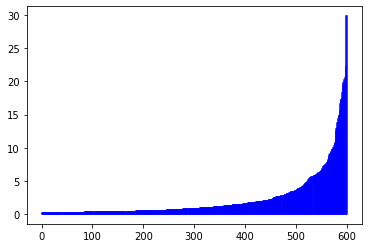

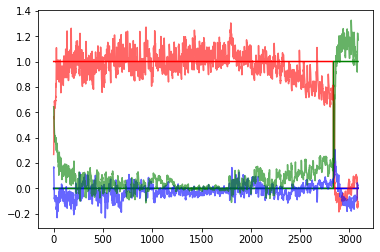

 22%|█████████████████████████████████▊                                                                                                                         | 654/3000 [3:58:44<15:32:06, 23.84s/it]

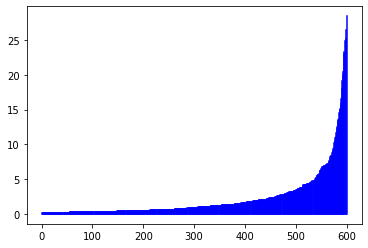

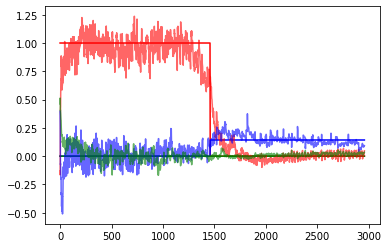

 22%|██████████████████████████████████                                                                                                                         | 659/3000 [4:00:26<13:24:05, 20.61s/it]

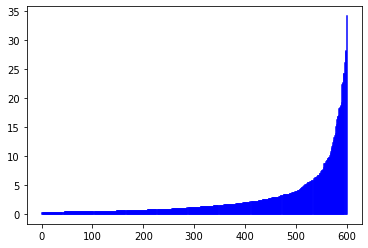

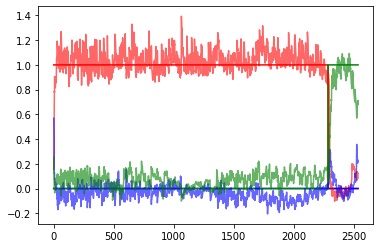

 22%|██████████████████████████████████▎                                                                                                                        | 664/3000 [4:02:12<13:20:31, 20.56s/it]

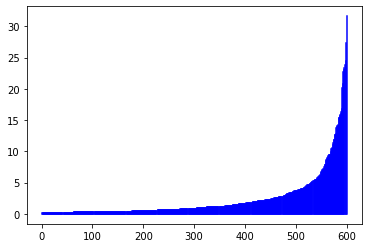

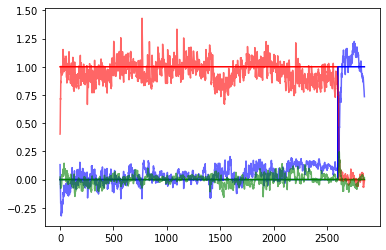

 22%|██████████████████████████████████▌                                                                                                                        | 669/3000 [4:03:58<12:55:34, 19.96s/it]

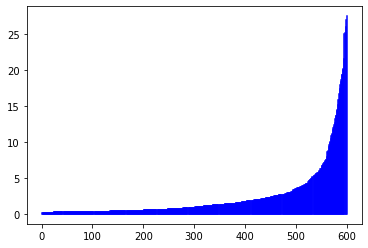

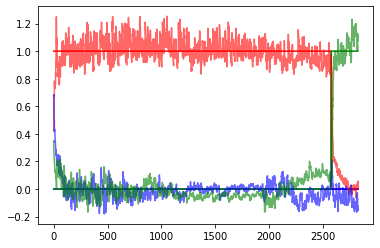

 22%|██████████████████████████████████▊                                                                                                                        | 674/3000 [4:05:44<13:13:16, 20.46s/it]

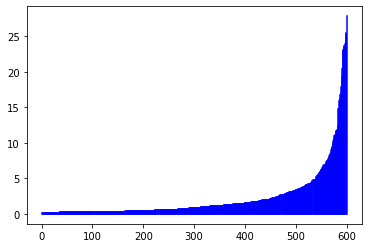

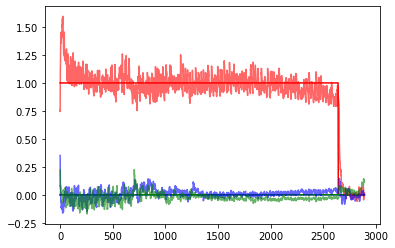

 23%|███████████████████████████████████                                                                                                                        | 679/3000 [4:07:24<12:40:41, 19.66s/it]

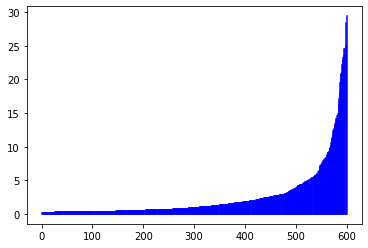

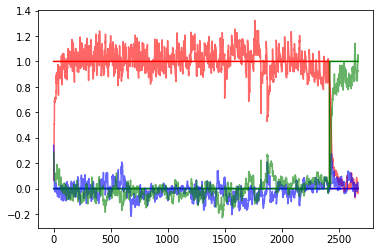

 23%|███████████████████████████████████▎                                                                                                                       | 684/3000 [4:09:06<12:36:19, 19.59s/it]

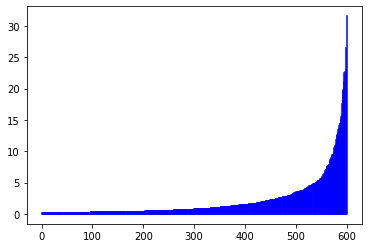

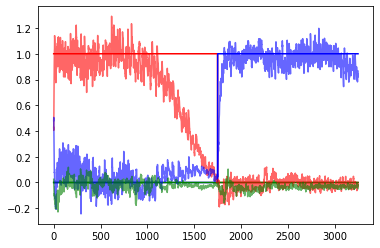

 23%|███████████████████████████████████▌                                                                                                                       | 689/3000 [4:10:50<12:49:17, 19.97s/it]

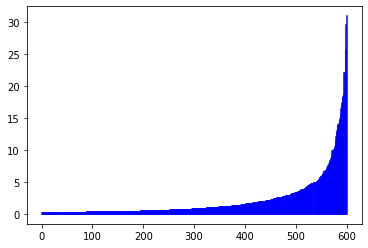

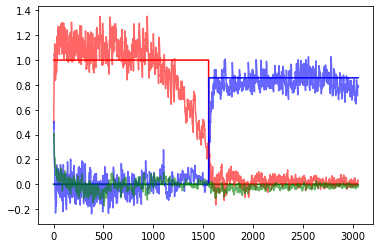

 23%|███████████████████████████████████▊                                                                                                                       | 694/3000 [4:12:35<12:56:23, 20.20s/it]

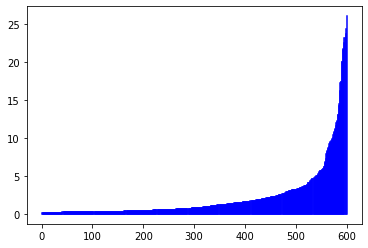

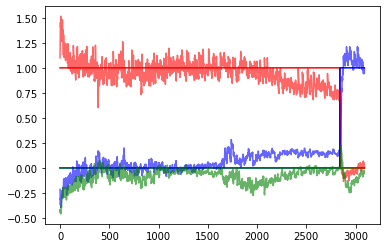

 23%|████████████████████████████████████                                                                                                                       | 699/3000 [4:14:22<13:06:52, 20.52s/it]

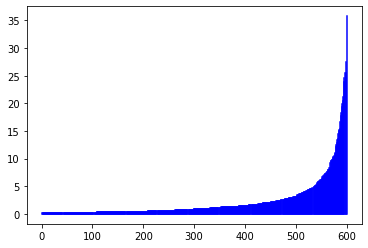

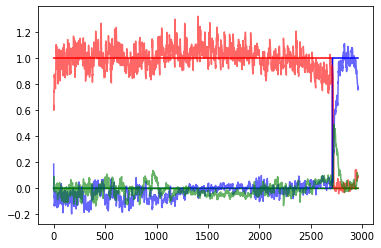

 23%|████████████████████████████████████▎                                                                                                                      | 704/3000 [4:16:55<15:05:52, 23.67s/it]

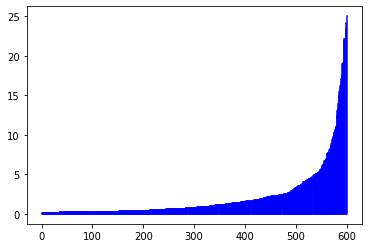

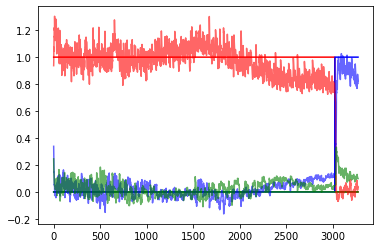

 24%|████████████████████████████████████▋                                                                                                                      | 709/3000 [4:18:42<13:17:02, 20.87s/it]

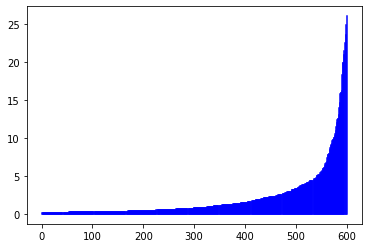

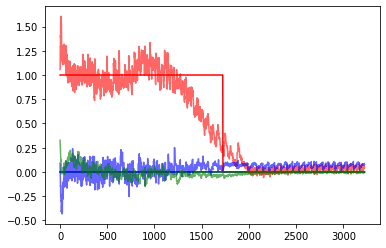

 24%|████████████████████████████████████▉                                                                                                                      | 714/3000 [4:20:31<13:18:05, 20.95s/it]

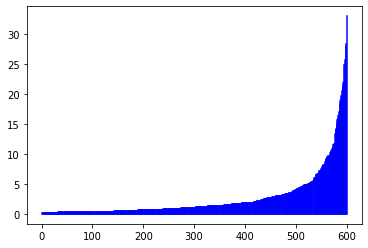

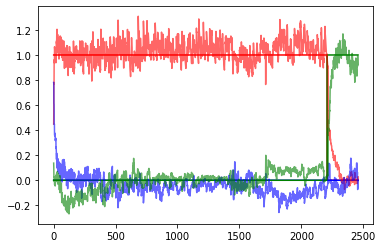

 24%|█████████████████████████████████████▏                                                                                                                     | 719/3000 [4:22:16<13:00:28, 20.53s/it]

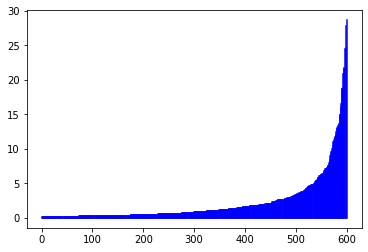

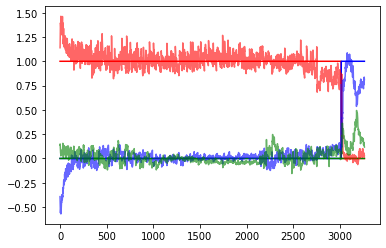

 24%|█████████████████████████████████████▍                                                                                                                     | 724/3000 [4:24:04<13:17:43, 21.03s/it]

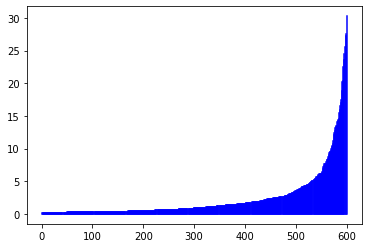

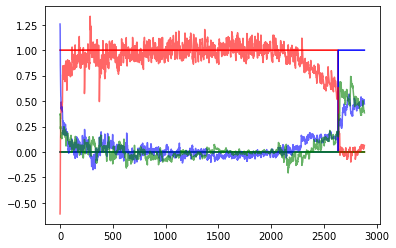

 24%|█████████████████████████████████████▋                                                                                                                     | 729/3000 [4:25:47<12:31:34, 19.86s/it]

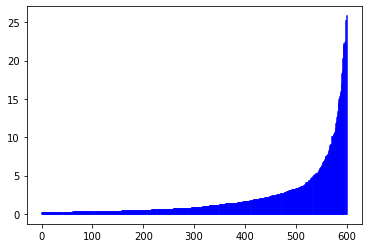

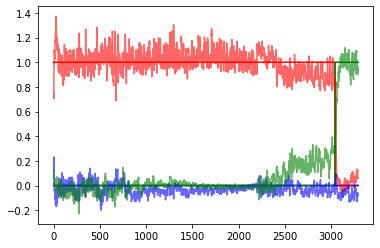

 24%|█████████████████████████████████████▉                                                                                                                     | 734/3000 [4:27:32<12:32:57, 19.94s/it]

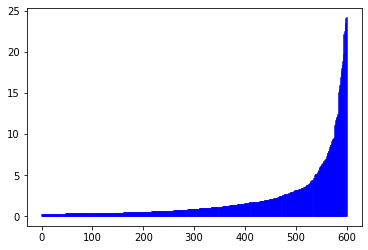

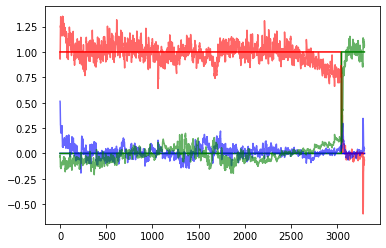

 25%|██████████████████████████████████████▏                                                                                                                    | 739/3000 [4:29:20<13:08:00, 20.91s/it]

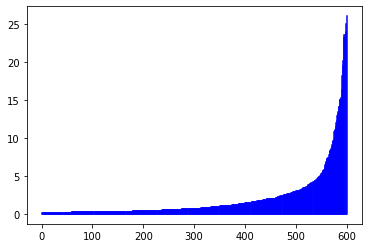

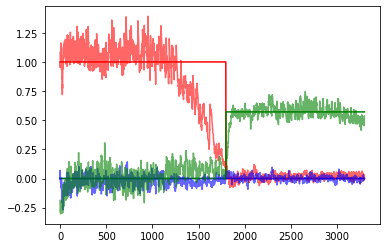

 25%|██████████████████████████████████████▍                                                                                                                    | 744/3000 [4:31:05<12:40:28, 20.23s/it]

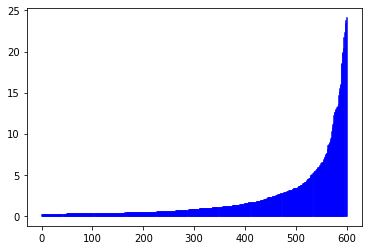

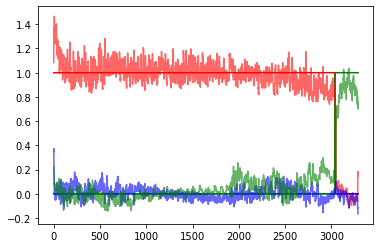

 25%|██████████████████████████████████████▋                                                                                                                    | 749/3000 [4:32:55<13:07:40, 21.00s/it]

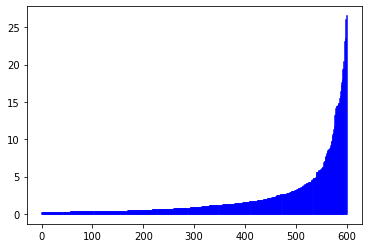

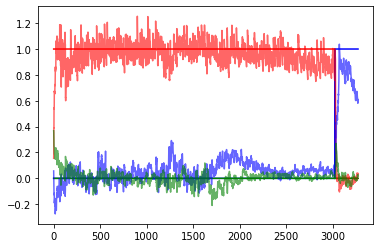

 25%|██████████████████████████████████████▉                                                                                                                    | 754/3000 [4:35:32<15:04:33, 24.16s/it]

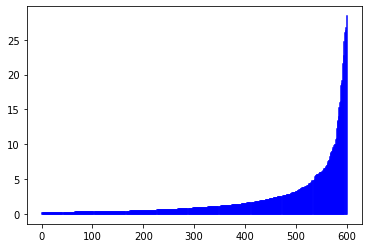

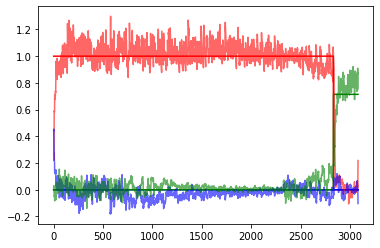

 25%|███████████████████████████████████████▏                                                                                                                   | 759/3000 [4:37:19<13:24:06, 21.53s/it]

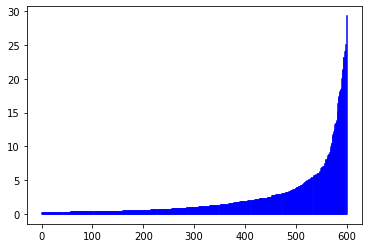

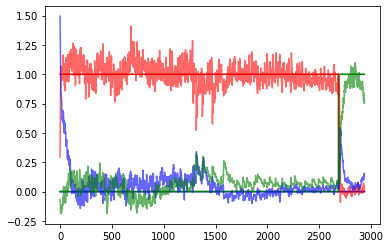

 25%|███████████████████████████████████████▍                                                                                                                   | 764/3000 [4:39:05<12:50:02, 20.66s/it]

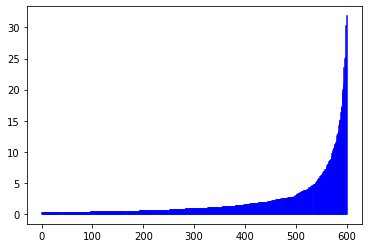

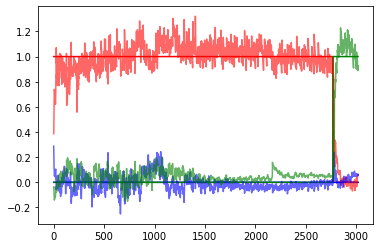

 26%|███████████████████████████████████████▋                                                                                                                   | 769/3000 [4:40:50<12:35:41, 20.32s/it]

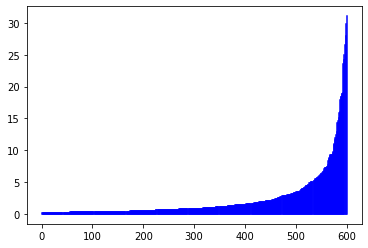

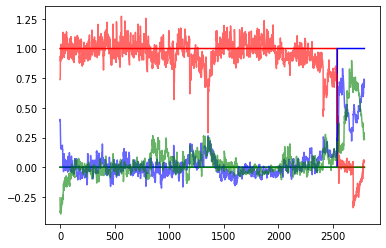

 26%|███████████████████████████████████████▉                                                                                                                   | 774/3000 [4:42:33<12:13:56, 19.78s/it]

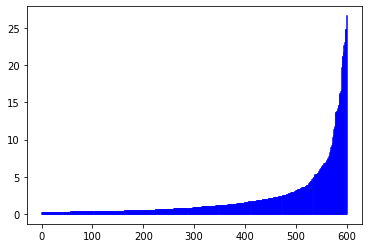

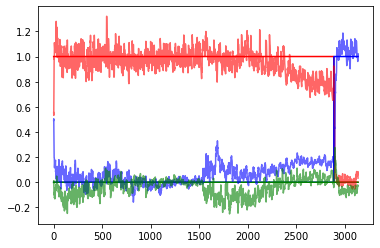

 26%|████████████████████████████████████████▏                                                                                                                  | 779/3000 [4:44:18<12:21:57, 20.04s/it]

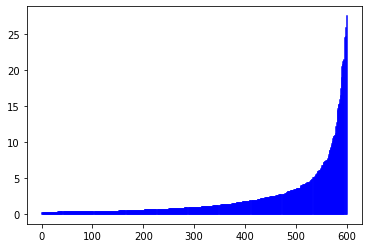

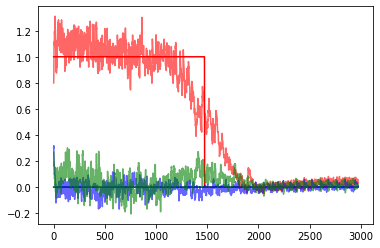

 26%|████████████████████████████████████████▌                                                                                                                  | 784/3000 [4:46:03<12:19:55, 20.03s/it]

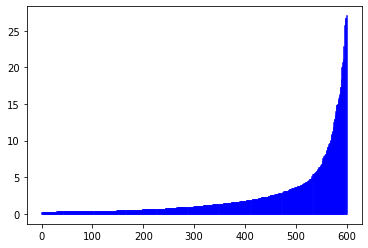

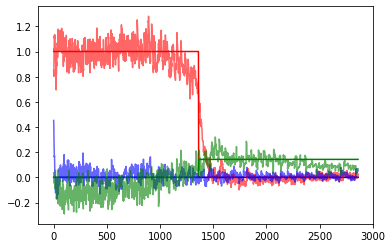

 26%|████████████████████████████████████████▊                                                                                                                  | 789/3000 [4:47:49<12:41:31, 20.67s/it]

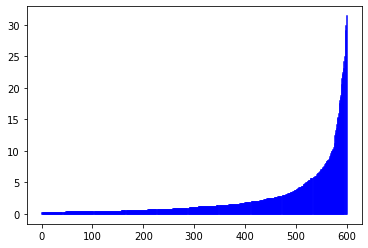

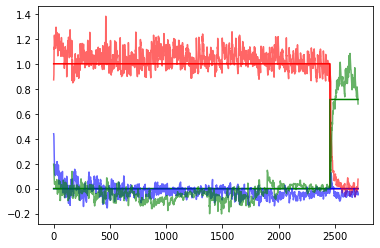

 26%|█████████████████████████████████████████                                                                                                                  | 794/3000 [4:49:36<12:32:47, 20.47s/it]

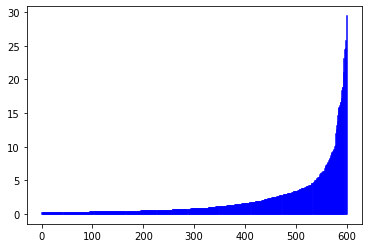

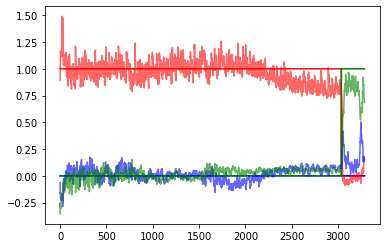

 27%|█████████████████████████████████████████▎                                                                                                                 | 799/3000 [4:51:20<12:12:43, 19.97s/it]

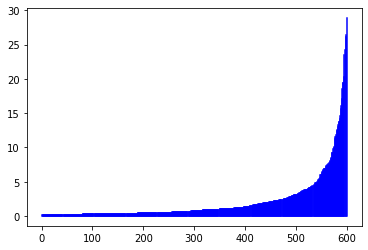

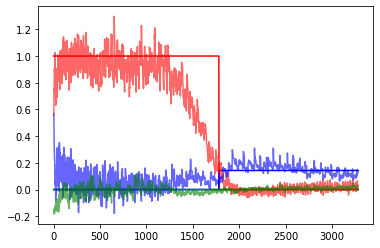

 27%|█████████████████████████████████████████▌                                                                                                                 | 804/3000 [4:53:51<14:08:32, 23.18s/it]

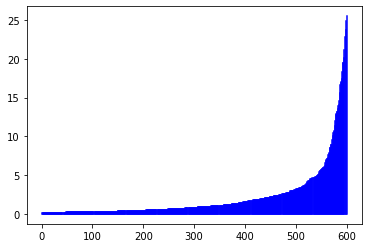

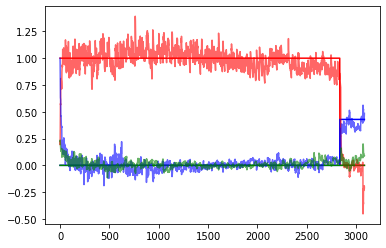

 27%|█████████████████████████████████████████▊                                                                                                                 | 809/3000 [4:55:33<12:22:41, 20.34s/it]

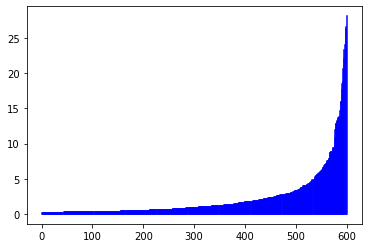

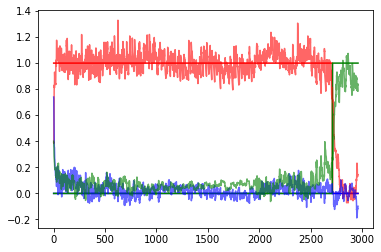

 27%|██████████████████████████████████████████                                                                                                                 | 814/3000 [4:57:16<12:14:57, 20.17s/it]

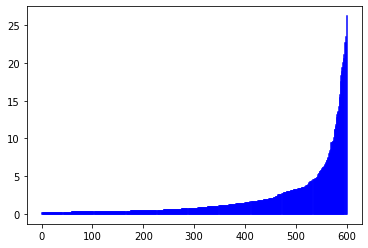

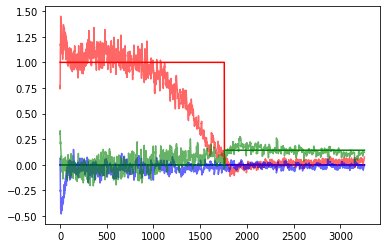

 27%|██████████████████████████████████████████▎                                                                                                                | 819/3000 [4:59:05<12:44:58, 21.04s/it]

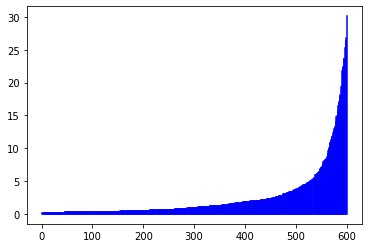

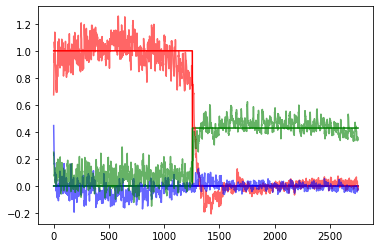

 27%|██████████████████████████████████████████▌                                                                                                                | 824/3000 [5:00:49<12:18:58, 20.38s/it]

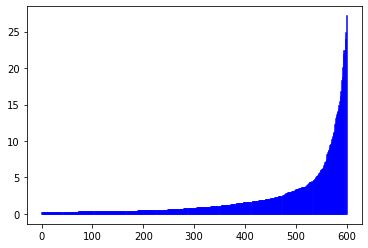

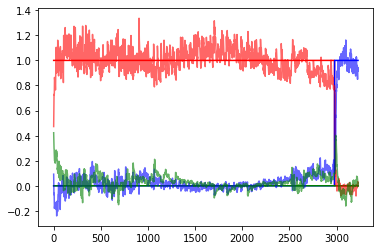

 28%|██████████████████████████████████████████▊                                                                                                                | 829/3000 [5:02:38<12:33:27, 20.82s/it]

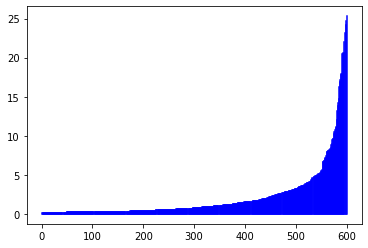

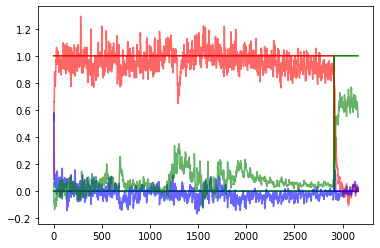

 28%|███████████████████████████████████████████                                                                                                                | 834/3000 [5:04:24<12:14:48, 20.36s/it]

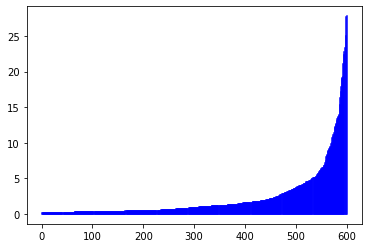

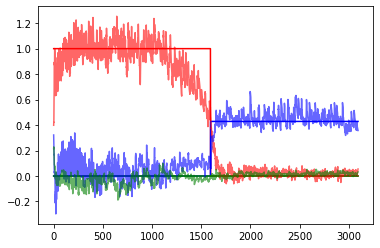

 28%|███████████████████████████████████████████▎                                                                                                               | 839/3000 [5:06:08<12:03:11, 20.08s/it]

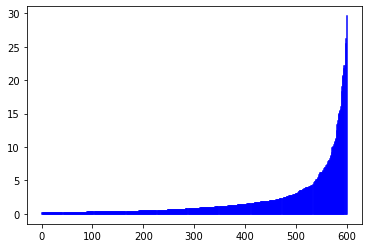

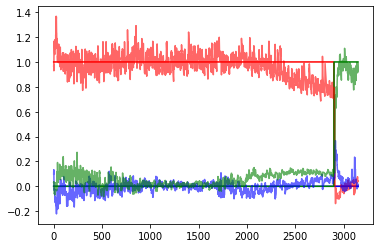

 28%|███████████████████████████████████████████▌                                                                                                               | 844/3000 [5:07:53<12:06:52, 20.23s/it]

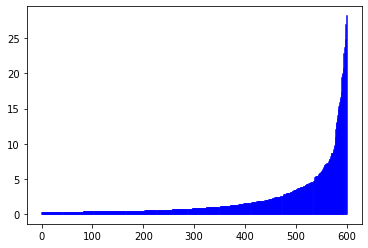

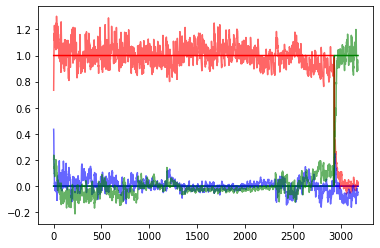

 28%|███████████████████████████████████████████▊                                                                                                               | 849/3000 [5:09:33<11:31:46, 19.30s/it]

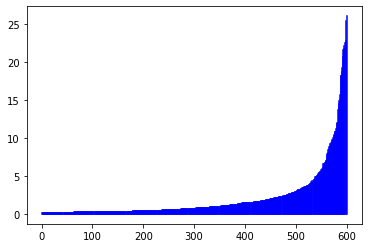

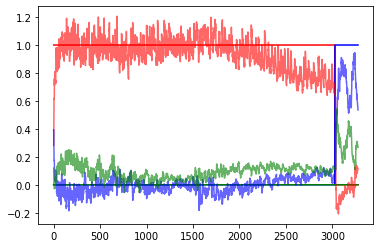

 28%|████████████████████████████████████████████                                                                                                               | 854/3000 [5:12:00<13:31:32, 22.69s/it]

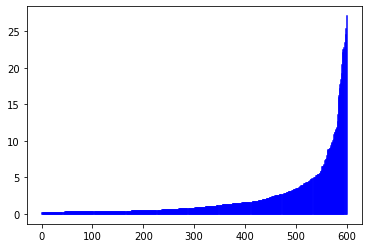

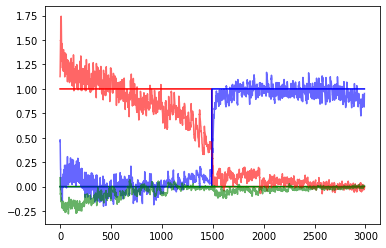

 29%|████████████████████████████████████████████▍                                                                                                              | 859/3000 [5:13:42<12:08:03, 20.40s/it]

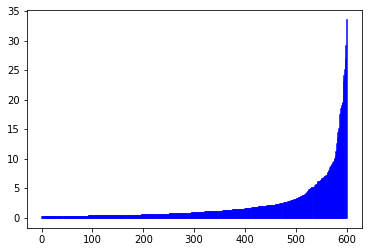

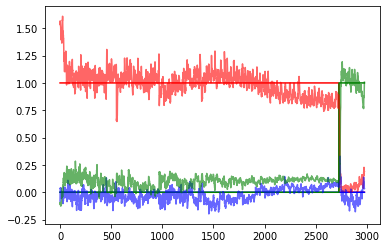

 29%|████████████████████████████████████████████▋                                                                                                              | 864/3000 [5:15:29<12:09:47, 20.50s/it]

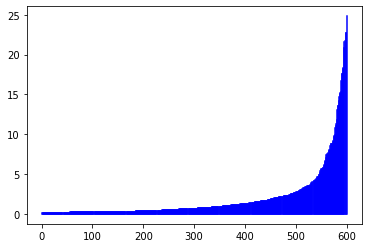

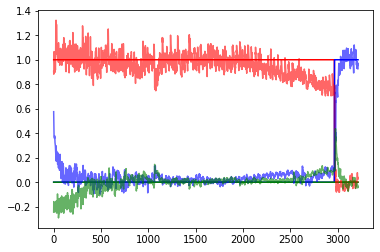

 29%|████████████████████████████████████████████▉                                                                                                              | 869/3000 [5:17:13<11:59:40, 20.26s/it]

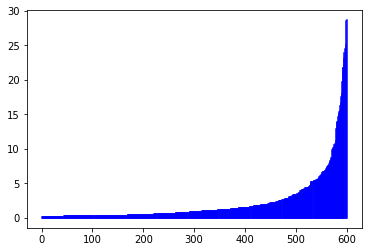

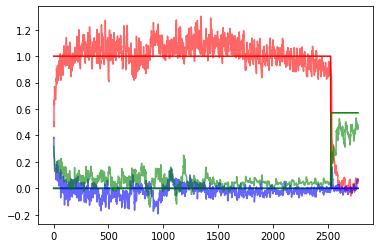

 29%|█████████████████████████████████████████████▏                                                                                                             | 874/3000 [5:18:59<12:12:07, 20.66s/it]

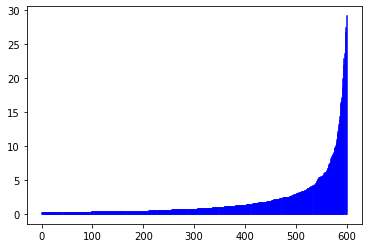

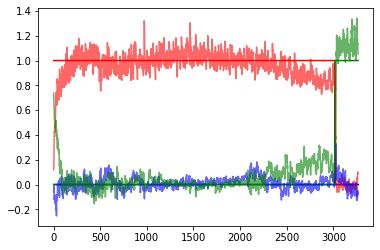

 29%|█████████████████████████████████████████████▍                                                                                                             | 879/3000 [5:20:43<11:41:53, 19.86s/it]

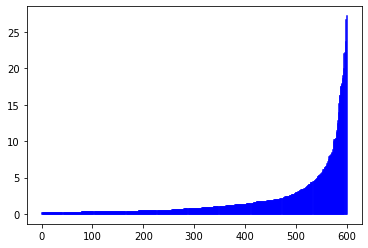

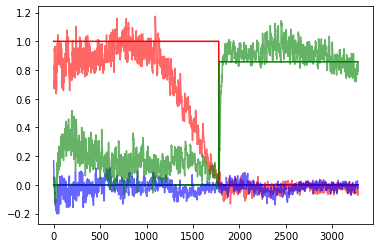

 29%|█████████████████████████████████████████████▋                                                                                                             | 884/3000 [5:22:29<12:05:49, 20.58s/it]

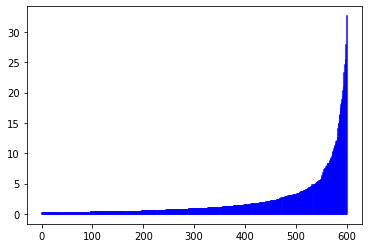

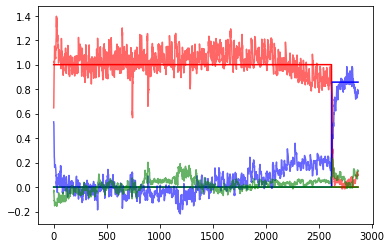

 30%|█████████████████████████████████████████████▉                                                                                                             | 889/3000 [5:24:15<12:02:50, 20.54s/it]

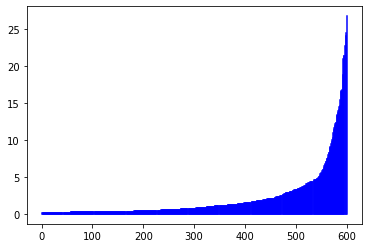

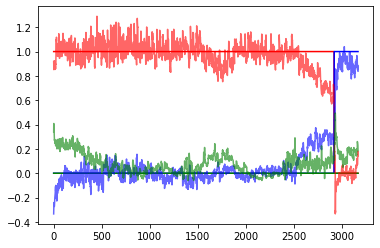

 30%|██████████████████████████████████████████████▏                                                                                                            | 894/3000 [5:26:02<12:01:12, 20.55s/it]

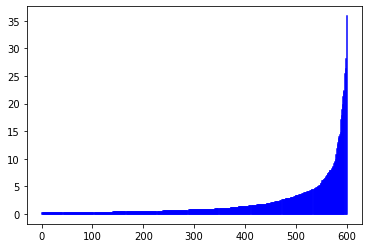

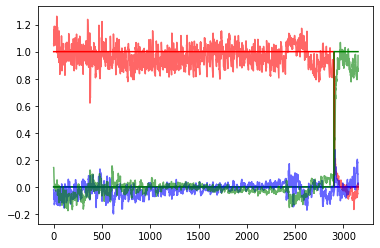

 30%|██████████████████████████████████████████████▍                                                                                                            | 899/3000 [5:27:46<11:54:29, 20.40s/it]

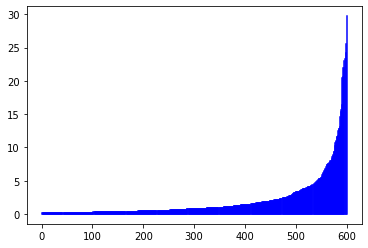

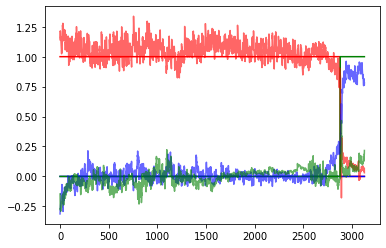

 30%|██████████████████████████████████████████████▋                                                                                                            | 904/3000 [5:30:17<13:27:58, 23.13s/it]

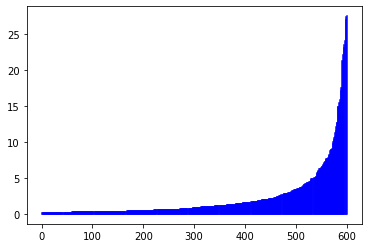

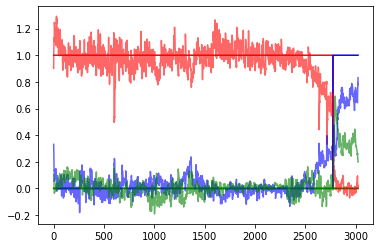

 30%|██████████████████████████████████████████████▉                                                                                                            | 909/3000 [5:32:02<11:50:00, 20.37s/it]

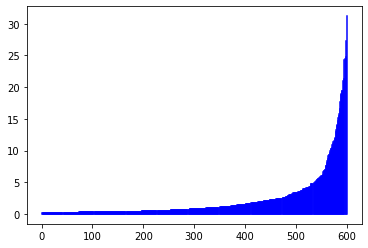

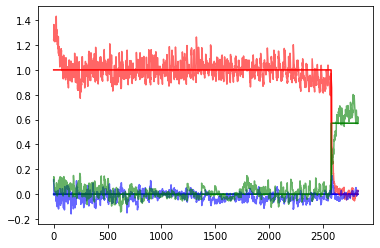

 30%|███████████████████████████████████████████████▏                                                                                                           | 914/3000 [5:33:45<11:31:25, 19.89s/it]

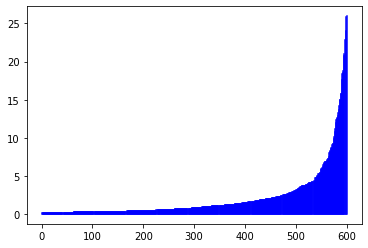

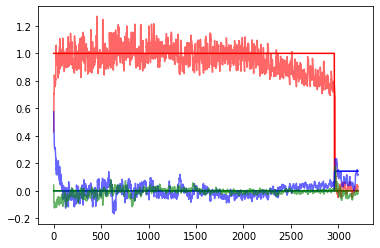

 31%|███████████████████████████████████████████████▍                                                                                                           | 919/3000 [5:35:28<11:27:19, 19.82s/it]

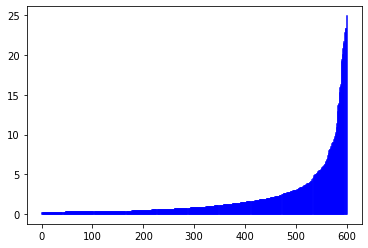

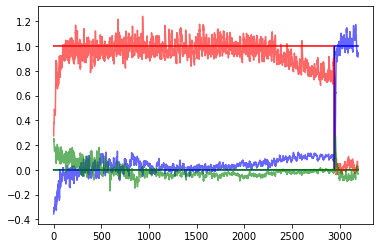

 31%|███████████████████████████████████████████████▋                                                                                                           | 924/3000 [5:37:13<11:41:38, 20.28s/it]

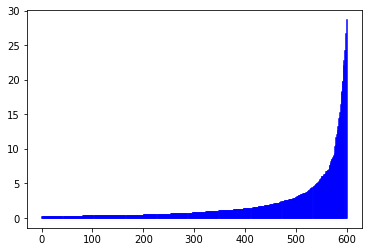

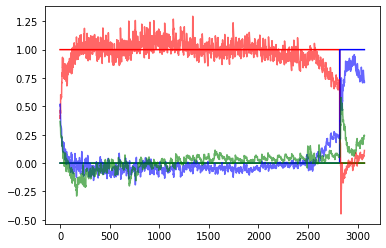

 31%|███████████████████████████████████████████████▉                                                                                                           | 929/3000 [5:38:55<11:29:22, 19.97s/it]

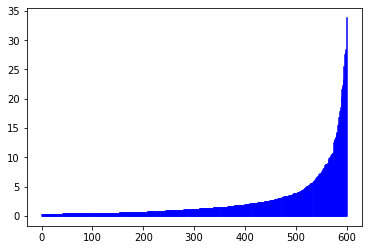

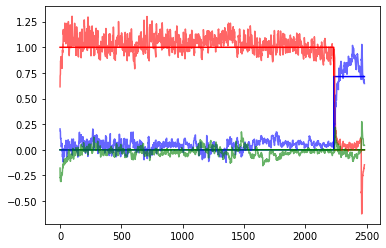

 31%|████████████████████████████████████████████████▎                                                                                                          | 934/3000 [5:40:37<11:11:44, 19.51s/it]

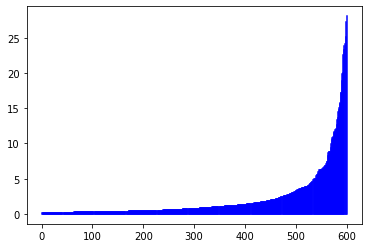

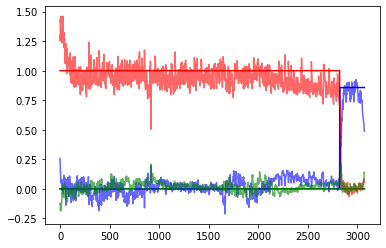

 31%|████████████████████████████████████████████████▌                                                                                                          | 939/3000 [5:42:21<11:33:39, 20.19s/it]

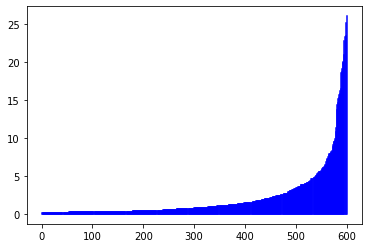

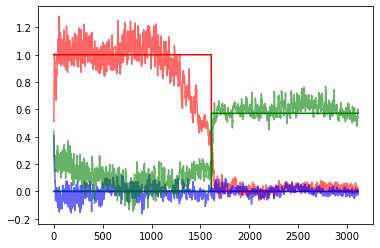

 31%|████████████████████████████████████████████████▊                                                                                                          | 944/3000 [5:44:06<11:25:15, 20.00s/it]

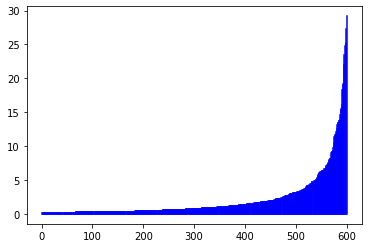

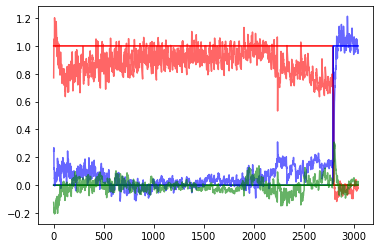

 32%|█████████████████████████████████████████████████                                                                                                          | 949/3000 [5:45:48<11:16:26, 19.79s/it]

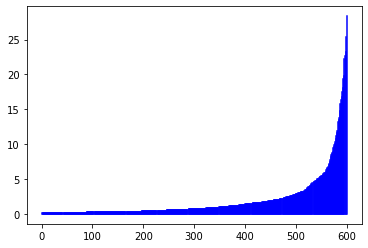

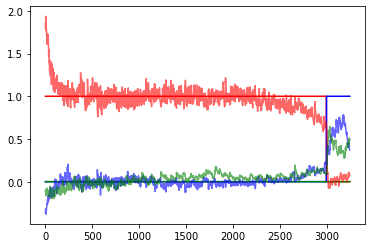

 32%|█████████████████████████████████████████████████▎                                                                                                         | 954/3000 [5:48:22<13:21:44, 23.51s/it]

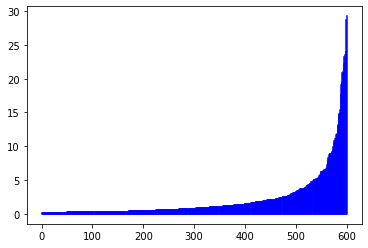

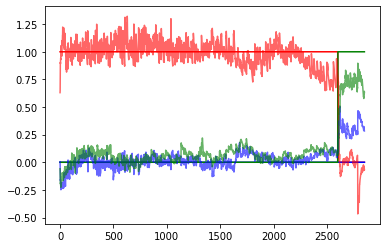

 32%|█████████████████████████████████████████████████▌                                                                                                         | 959/3000 [5:50:04<11:29:02, 20.26s/it]

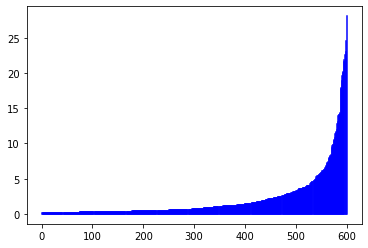

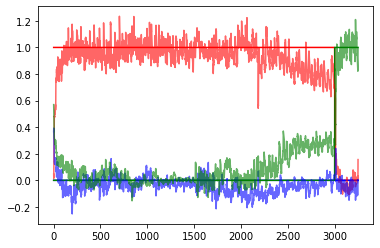

 32%|█████████████████████████████████████████████████▊                                                                                                         | 964/3000 [5:51:47<11:21:48, 20.09s/it]

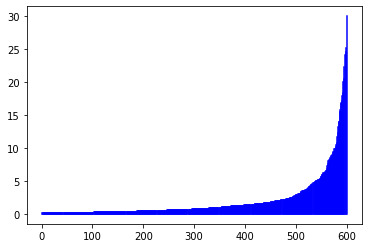

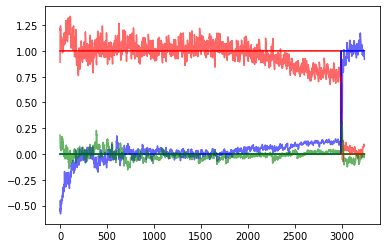

 32%|██████████████████████████████████████████████████                                                                                                         | 969/3000 [5:53:26<10:42:16, 18.97s/it]

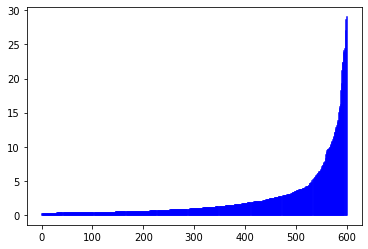

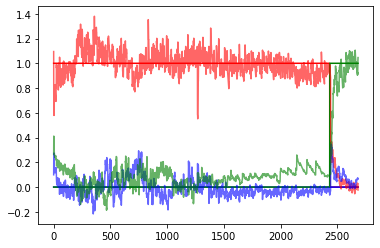

 32%|██████████████████████████████████████████████████▎                                                                                                        | 974/3000 [5:55:12<11:31:39, 20.48s/it]

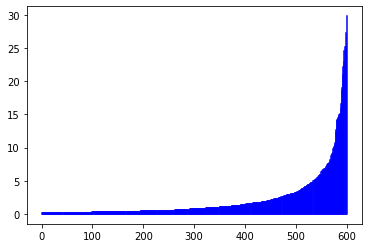

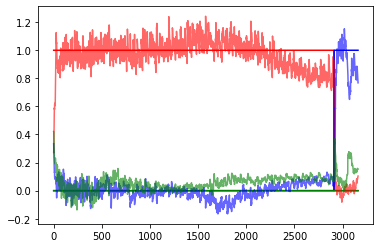

 33%|██████████████████████████████████████████████████▌                                                                                                        | 979/3000 [5:56:54<11:06:04, 19.77s/it]

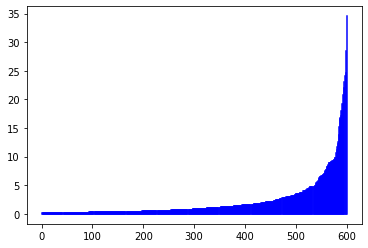

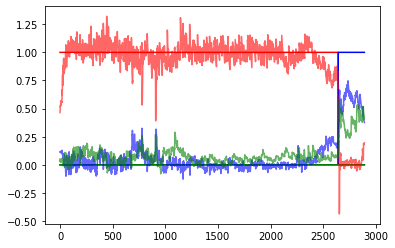

 33%|██████████████████████████████████████████████████▊                                                                                                        | 984/3000 [5:58:37<11:10:45, 19.96s/it]

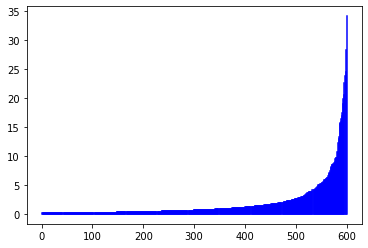

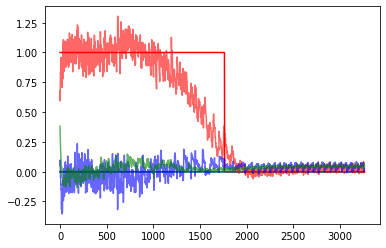

 33%|███████████████████████████████████████████████████                                                                                                        | 989/3000 [6:00:23<11:21:09, 20.32s/it]

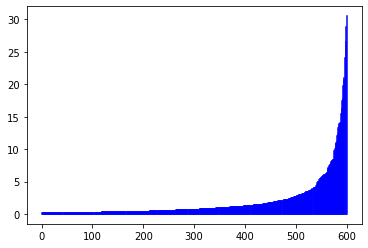

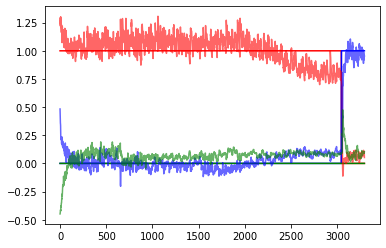

 33%|███████████████████████████████████████████████████▎                                                                                                       | 994/3000 [6:02:07<11:13:02, 20.13s/it]

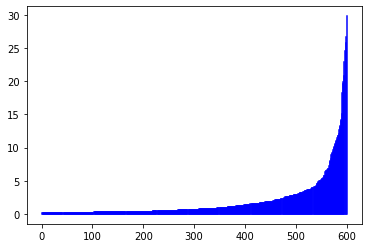

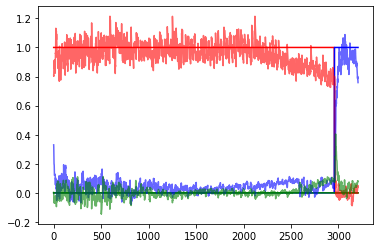

 33%|███████████████████████████████████████████████████▌                                                                                                       | 999/3000 [6:03:52<11:17:33, 20.32s/it]

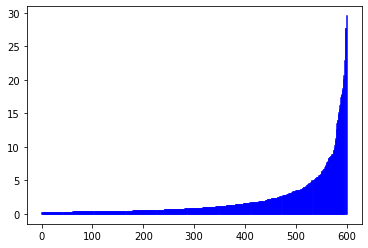

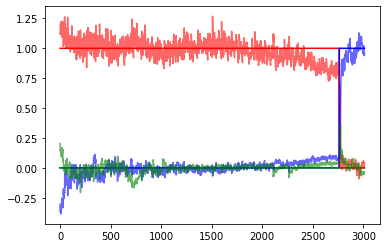

 33%|███████████████████████████████████████████████████▌                                                                                                      | 1004/3000 [6:06:22<13:06:41, 23.65s/it]

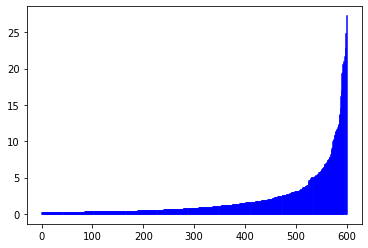

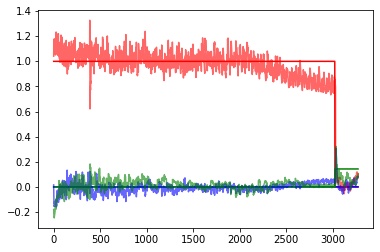

 34%|███████████████████████████████████████████████████▊                                                                                                      | 1009/3000 [6:08:06<11:26:13, 20.68s/it]

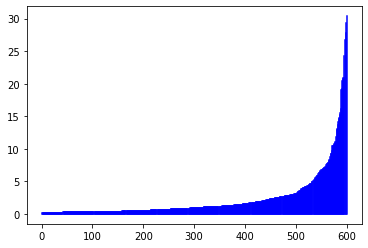

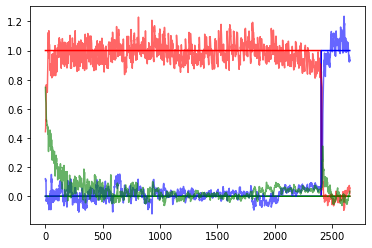

 34%|████████████████████████████████████████████████████                                                                                                      | 1014/3000 [6:09:48<10:41:43, 19.39s/it]

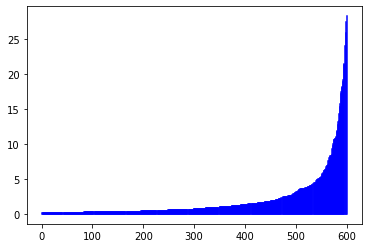

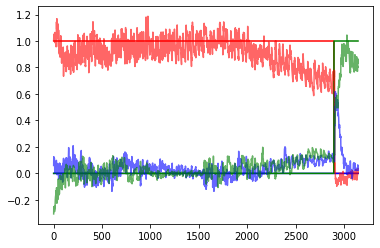

 34%|████████████████████████████████████████████████████▎                                                                                                     | 1019/3000 [6:11:33<11:08:47, 20.26s/it]

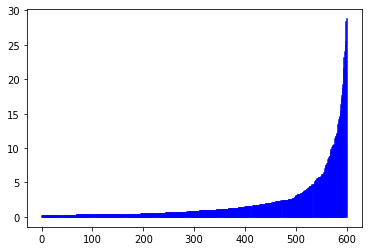

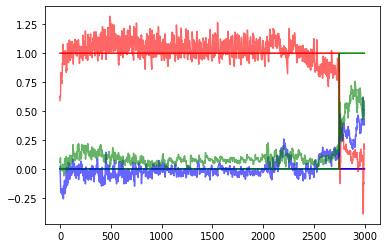

 34%|████████████████████████████████████████████████████▌                                                                                                     | 1024/3000 [6:13:19<11:10:04, 20.35s/it]

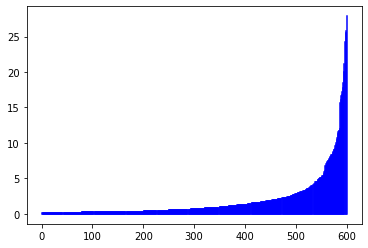

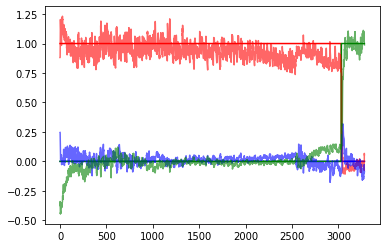

 34%|████████████████████████████████████████████████████▊                                                                                                     | 1029/3000 [6:15:04<10:49:20, 19.77s/it]

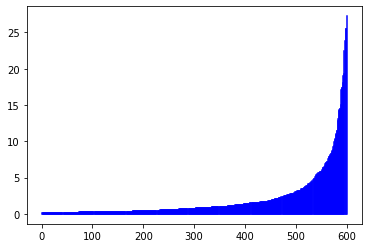

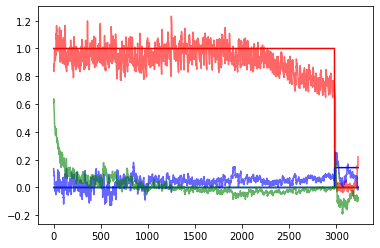

 34%|█████████████████████████████████████████████████████                                                                                                     | 1034/3000 [6:16:55<11:24:20, 20.89s/it]

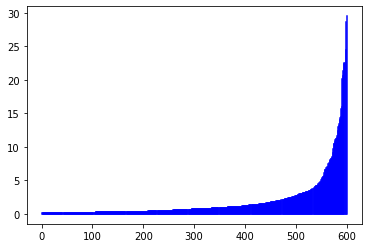

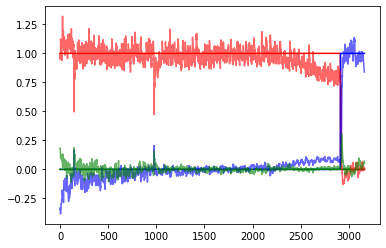

 35%|█████████████████████████████████████████████████████▎                                                                                                    | 1039/3000 [6:18:39<11:07:31, 20.42s/it]

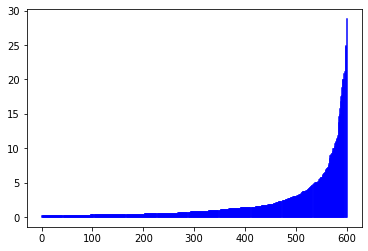

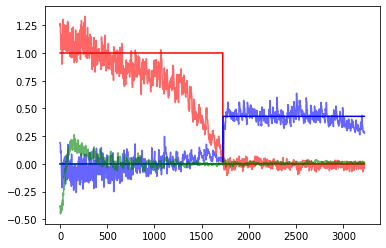

 35%|█████████████████████████████████████████████████████▌                                                                                                    | 1044/3000 [6:20:27<11:13:20, 20.65s/it]

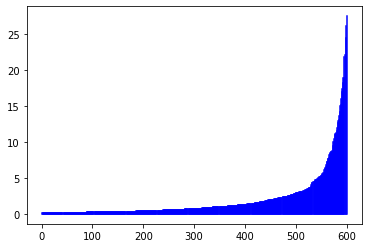

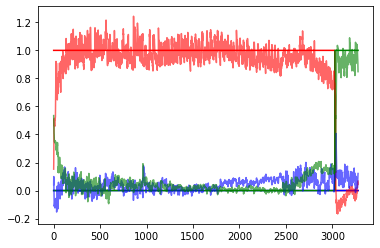

 35%|█████████████████████████████████████████████████████▊                                                                                                    | 1049/3000 [6:22:10<10:49:42, 19.98s/it]

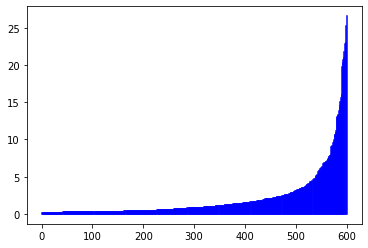

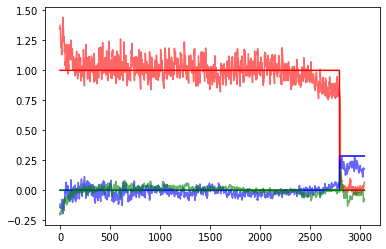

 35%|██████████████████████████████████████████████████████                                                                                                    | 1054/3000 [6:24:42<12:52:00, 23.80s/it]

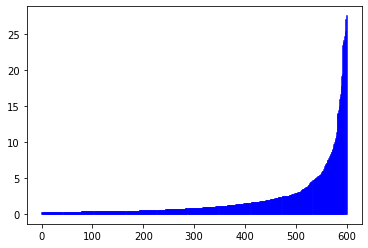

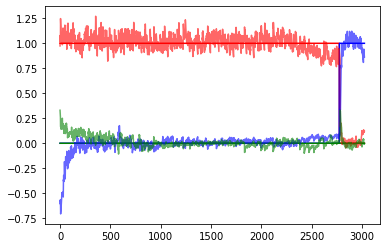

 35%|██████████████████████████████████████████████████████▎                                                                                                   | 1059/3000 [6:26:28<11:21:30, 21.07s/it]

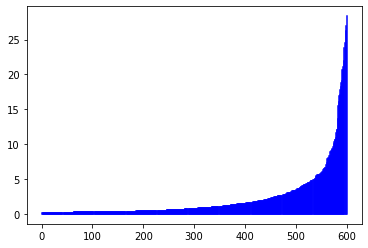

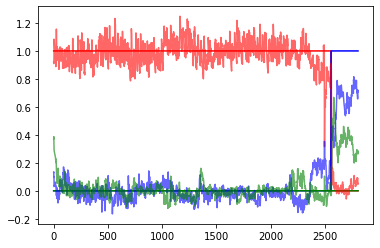

 35%|██████████████████████████████████████████████████████▌                                                                                                   | 1064/3000 [6:28:08<10:35:52, 19.71s/it]

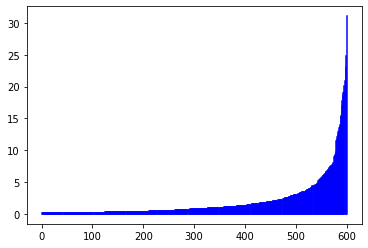

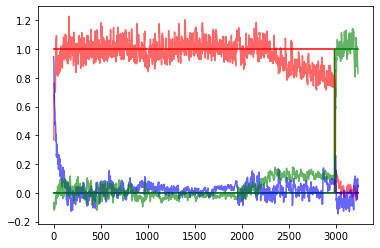

 36%|██████████████████████████████████████████████████████▉                                                                                                   | 1069/3000 [6:29:55<11:05:29, 20.68s/it]

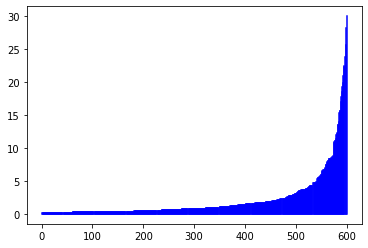

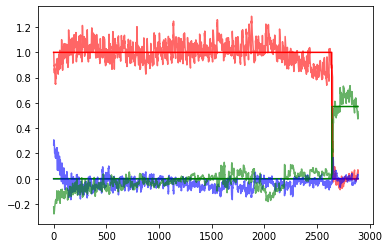

 36%|███████████████████████████████████████████████████████▏                                                                                                  | 1074/3000 [6:31:41<11:03:04, 20.66s/it]

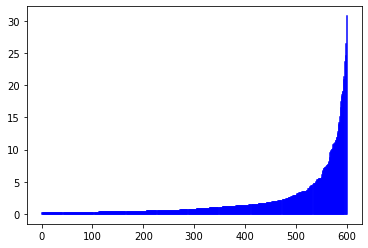

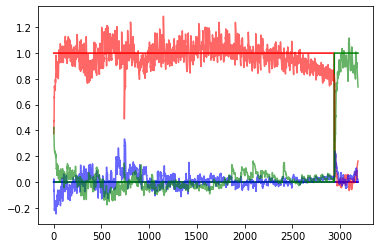

 36%|███████████████████████████████████████████████████████▍                                                                                                  | 1079/3000 [6:33:27<10:54:02, 20.43s/it]

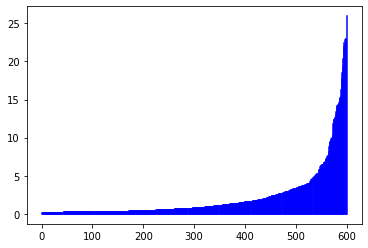

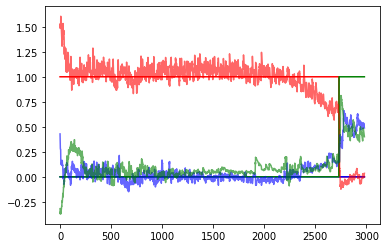

 36%|███████████████████████████████████████████████████████▋                                                                                                  | 1084/3000 [6:35:11<10:42:21, 20.12s/it]

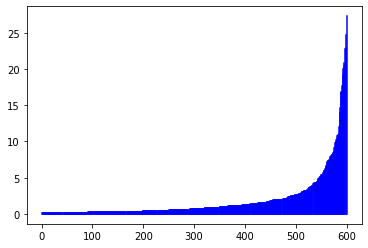

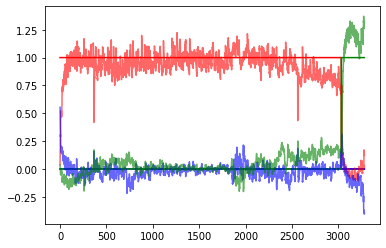

 36%|███████████████████████████████████████████████████████▉                                                                                                  | 1089/3000 [6:36:59<10:53:42, 20.52s/it]

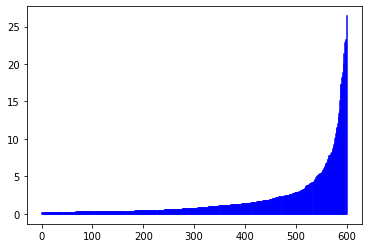

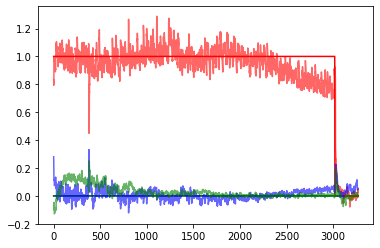

 36%|████████████████████████████████████████████████████████▏                                                                                                 | 1094/3000 [6:38:41<10:27:54, 19.77s/it]

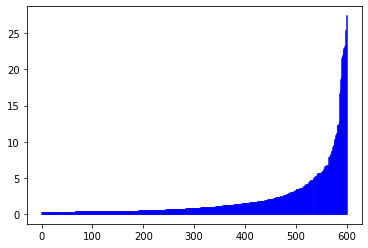

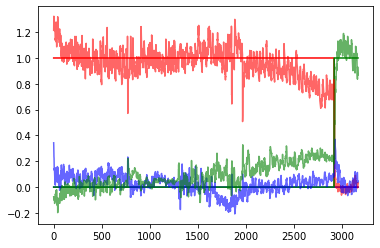

 37%|████████████████████████████████████████████████████████▍                                                                                                 | 1099/3000 [6:40:27<10:41:18, 20.24s/it]

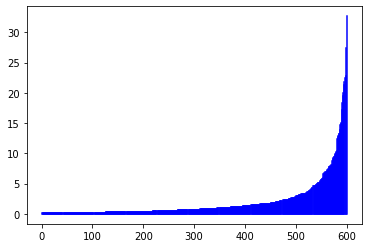

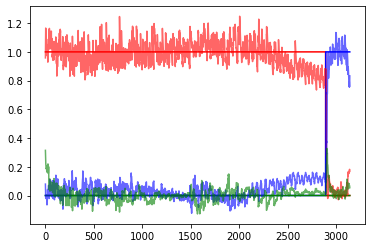

 37%|████████████████████████████████████████████████████████▋                                                                                                 | 1104/3000 [6:42:57<12:03:49, 22.91s/it]

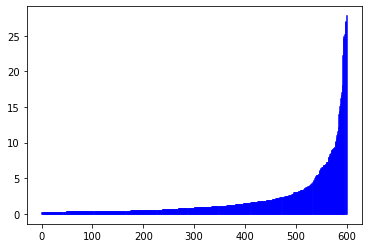

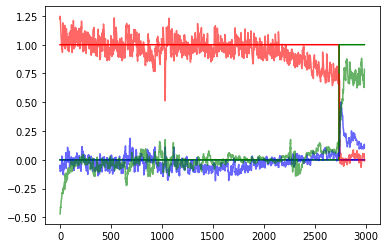

 37%|████████████████████████████████████████████████████████▉                                                                                                 | 1109/3000 [6:44:42<10:53:45, 20.74s/it]

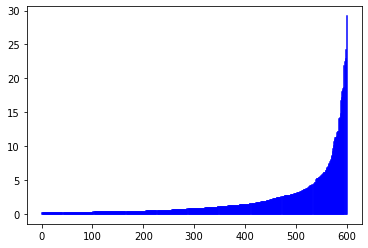

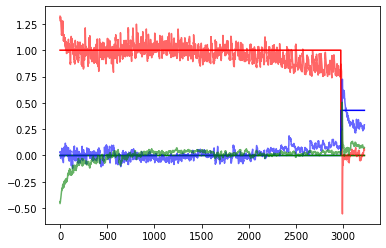

 37%|█████████████████████████████████████████████████████████▏                                                                                                | 1114/3000 [6:46:27<10:34:42, 20.19s/it]

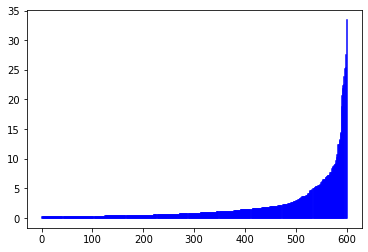

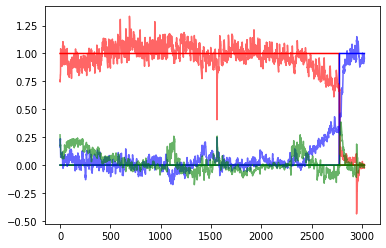

 37%|█████████████████████████████████████████████████████████▍                                                                                                | 1119/3000 [6:48:10<10:29:12, 20.07s/it]

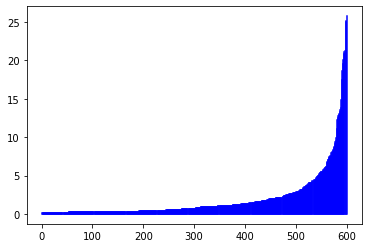

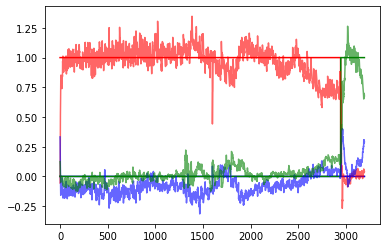

 37%|█████████████████████████████████████████████████████████▋                                                                                                | 1124/3000 [6:49:54<10:26:05, 20.02s/it]

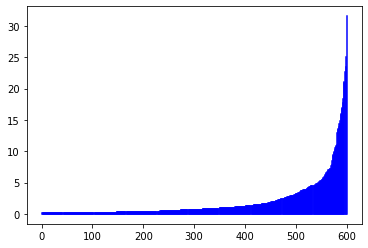

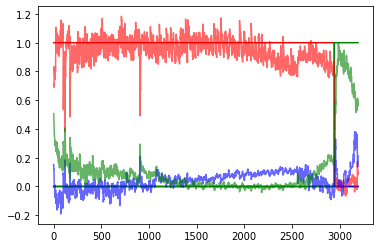

 38%|██████████████████████████████████████████████████████████▎                                                                                                | 1129/3000 [6:51:35<9:56:47, 19.14s/it]

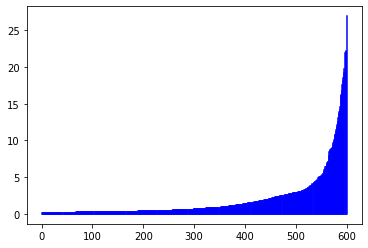

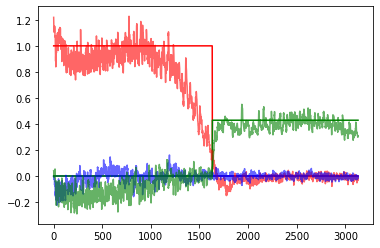

 38%|██████████████████████████████████████████████████████████▏                                                                                               | 1134/3000 [6:53:19<10:14:42, 19.77s/it]

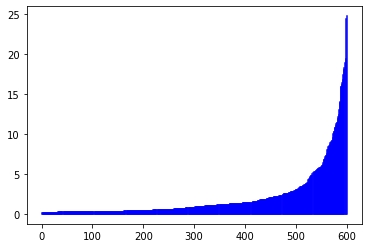

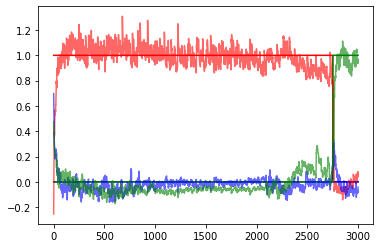

 38%|██████████████████████████████████████████████████████████▍                                                                                               | 1139/3000 [6:55:04<10:29:36, 20.30s/it]

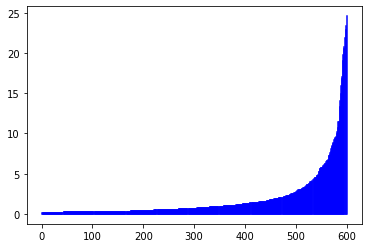

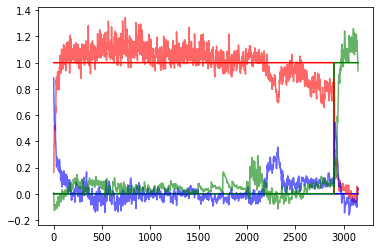

 38%|██████████████████████████████████████████████████████████▋                                                                                               | 1144/3000 [6:56:52<10:42:52, 20.78s/it]

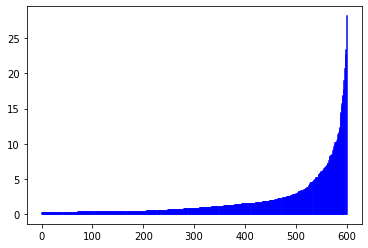

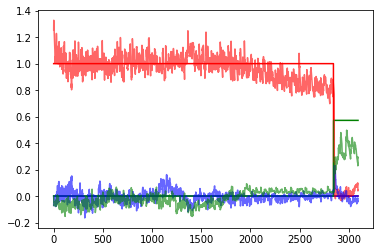

 38%|██████████████████████████████████████████████████████████▉                                                                                               | 1149/3000 [6:58:36<10:13:00, 19.87s/it]

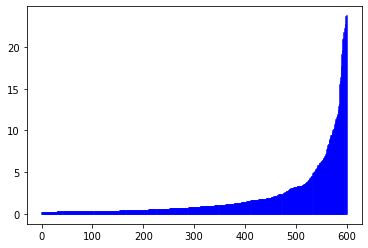

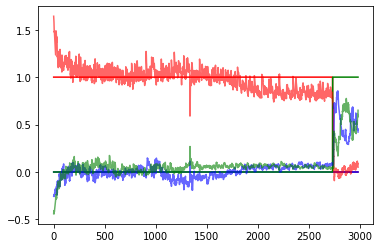

 38%|███████████████████████████████████████████████████████████▏                                                                                              | 1154/3000 [7:01:07<11:56:48, 23.30s/it]

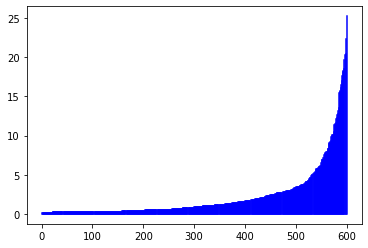

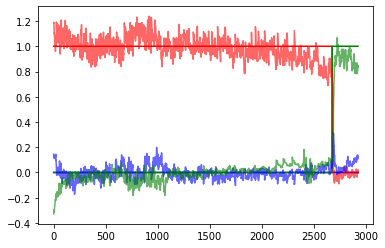

 39%|███████████████████████████████████████████████████████████▍                                                                                              | 1159/3000 [7:02:48<10:28:03, 20.47s/it]

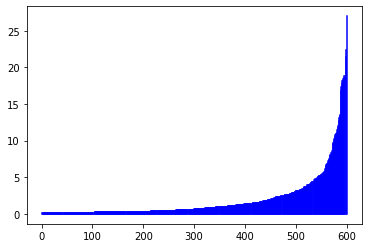

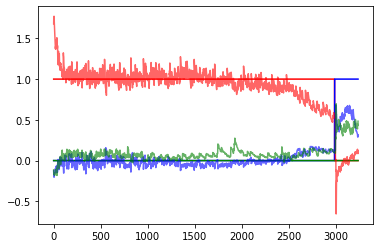

 39%|███████████████████████████████████████████████████████████▊                                                                                              | 1164/3000 [7:04:31<10:05:46, 19.80s/it]

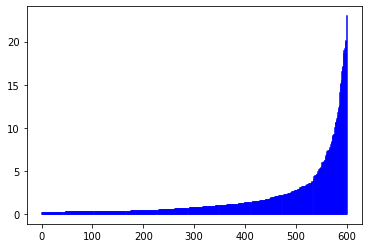

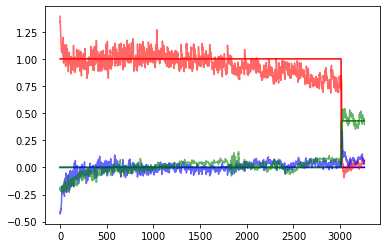

 39%|████████████████████████████████████████████████████████████                                                                                              | 1169/3000 [7:06:16<10:20:47, 20.34s/it]

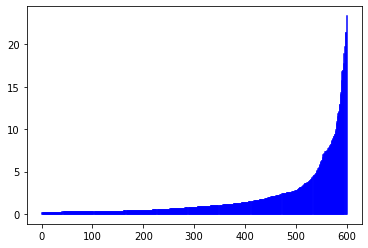

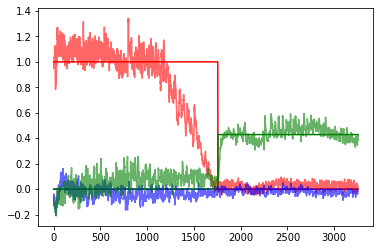

 39%|████████████████████████████████████████████████████████████▎                                                                                             | 1174/3000 [7:08:01<10:11:48, 20.10s/it]

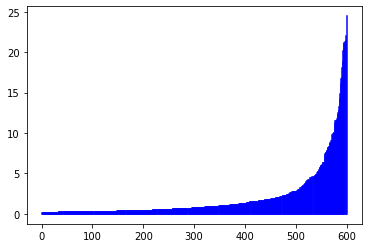

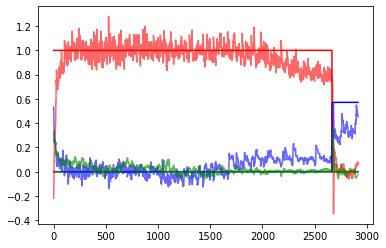

 39%|████████████████████████████████████████████████████████████▌                                                                                             | 1179/3000 [7:09:46<10:16:24, 20.31s/it]

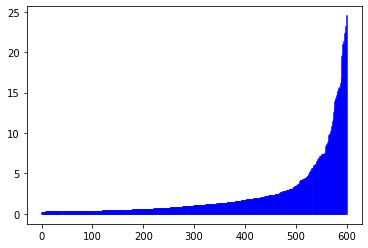

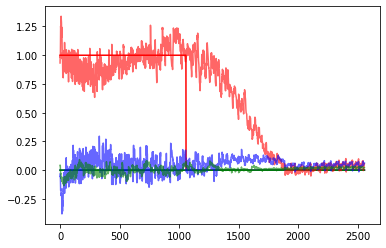

 39%|█████████████████████████████████████████████████████████████▏                                                                                             | 1184/3000 [7:11:26<9:49:17, 19.47s/it]

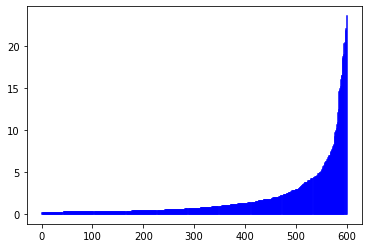

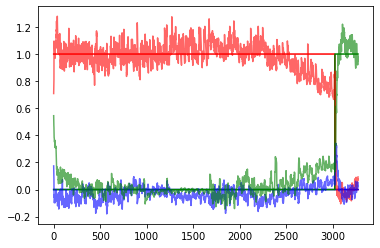

 40%|█████████████████████████████████████████████████████████████                                                                                             | 1189/3000 [7:13:12<10:05:48, 20.07s/it]

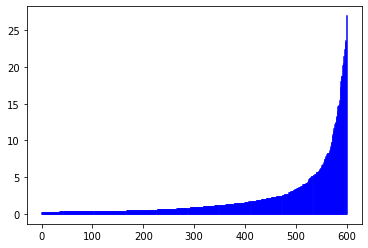

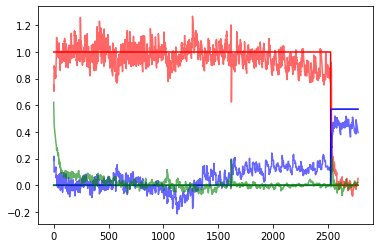

 40%|█████████████████████████████████████████████████████████████▋                                                                                             | 1194/3000 [7:14:55<9:52:57, 19.70s/it]

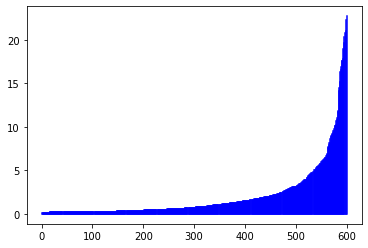

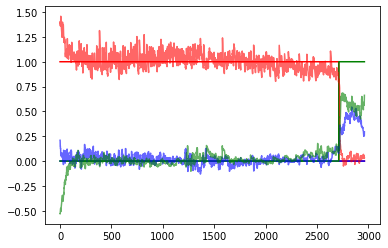

 40%|█████████████████████████████████████████████████████████████▌                                                                                            | 1199/3000 [7:16:39<10:02:44, 20.08s/it]

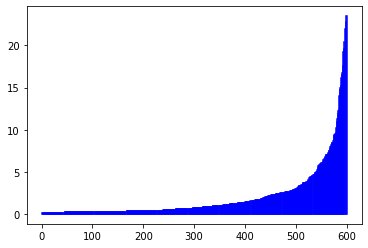

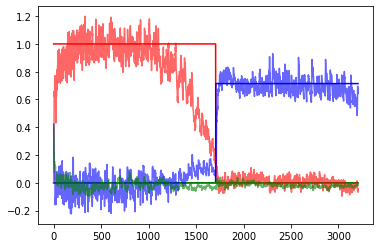

 40%|█████████████████████████████████████████████████████████████▊                                                                                            | 1204/3000 [7:19:10<11:50:27, 23.73s/it]

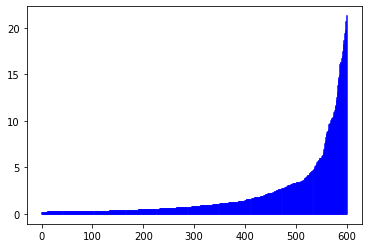

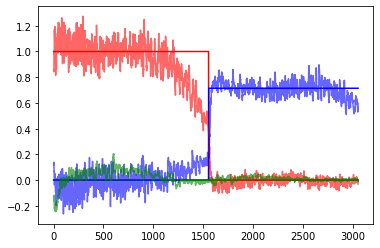

 40%|██████████████████████████████████████████████████████████████                                                                                            | 1209/3000 [7:20:51<10:00:55, 20.13s/it]

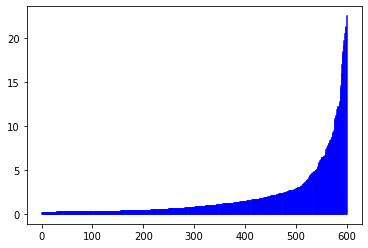

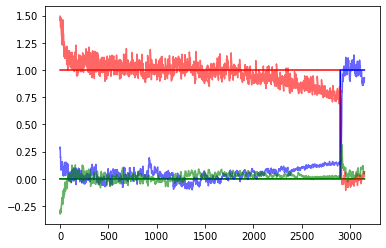

 40%|██████████████████████████████████████████████████████████████▋                                                                                            | 1214/3000 [7:22:36<9:57:58, 20.09s/it]

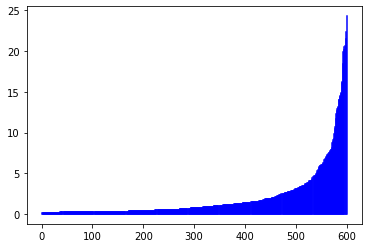

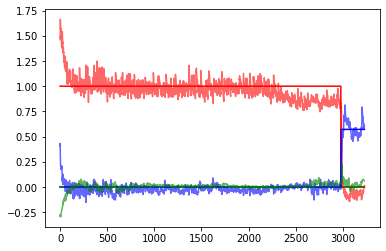

 41%|██████████████████████████████████████████████████████████████▉                                                                                            | 1219/3000 [7:24:20<9:58:33, 20.16s/it]

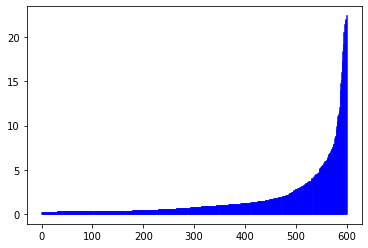

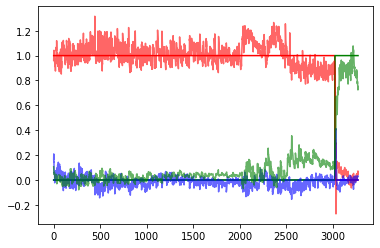

 41%|███████████████████████████████████████████████████████████████▏                                                                                           | 1224/3000 [7:26:04<9:50:13, 19.94s/it]

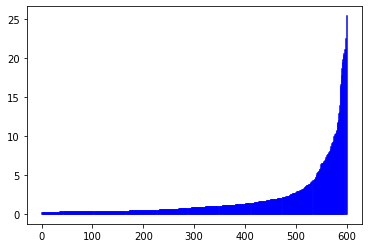

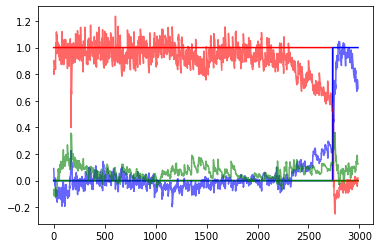

 41%|███████████████████████████████████████████████████████████████▍                                                                                           | 1229/3000 [7:27:48<9:45:10, 19.83s/it]

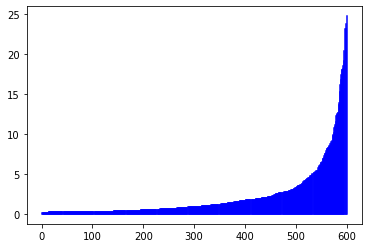

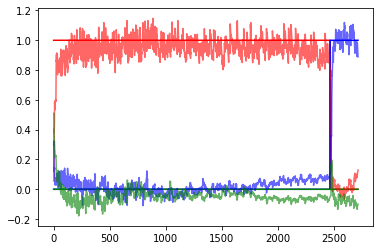

 41%|███████████████████████████████████████████████████████████████▊                                                                                           | 1234/3000 [7:29:27<9:33:40, 19.49s/it]

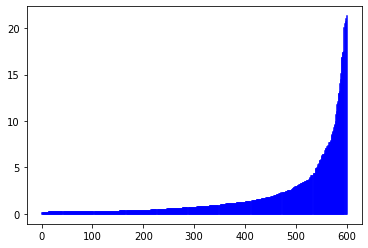

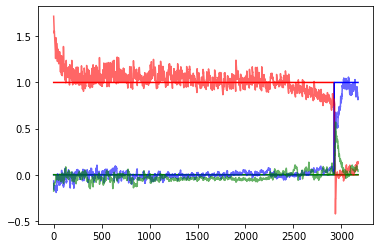

 41%|████████████████████████████████████████████████████████████████                                                                                           | 1239/3000 [7:31:14<9:57:25, 20.35s/it]

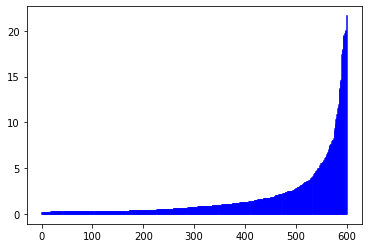

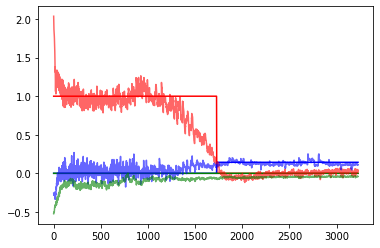

 41%|████████████████████████████████████████████████████████████████▎                                                                                          | 1244/3000 [7:32:58<9:50:17, 20.17s/it]

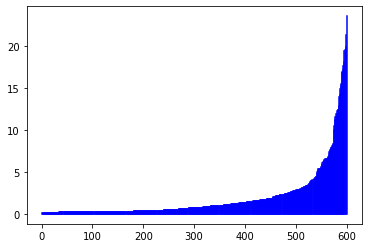

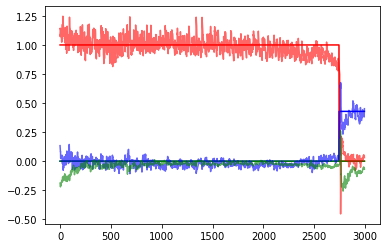

 42%|████████████████████████████████████████████████████████████████▌                                                                                          | 1249/3000 [7:34:44<9:59:09, 20.53s/it]

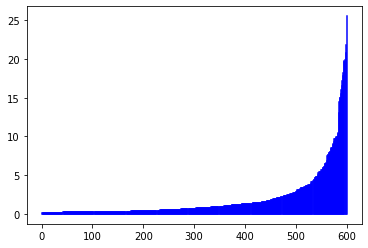

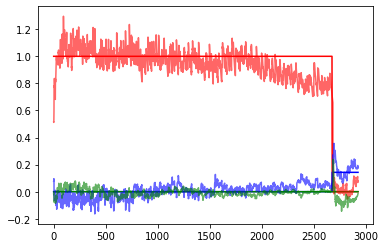

 42%|████████████████████████████████████████████████████████████████▎                                                                                         | 1254/3000 [7:37:13<11:20:12, 23.37s/it]

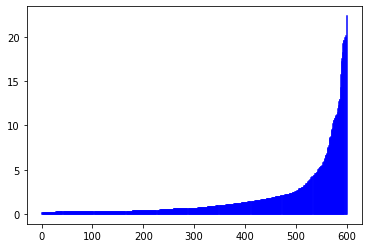

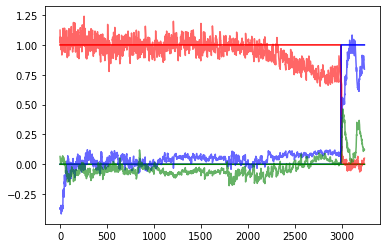

 42%|████████████████████████████████████████████████████████████████▋                                                                                         | 1259/3000 [7:38:58<10:06:38, 20.91s/it]

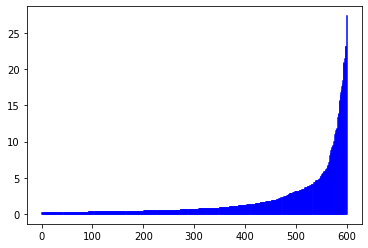

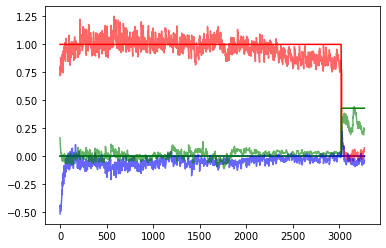

 42%|████████████████████████████████████████████████████████████████▉                                                                                         | 1264/3000 [7:40:48<10:13:12, 21.19s/it]

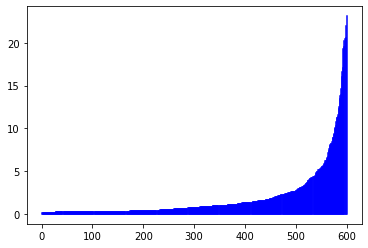

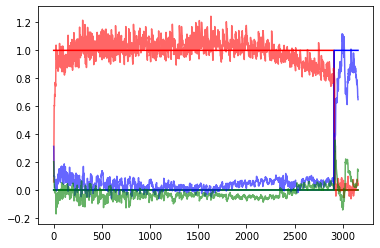

 42%|█████████████████████████████████████████████████████████████████▌                                                                                         | 1269/3000 [7:42:36<9:55:58, 20.66s/it]

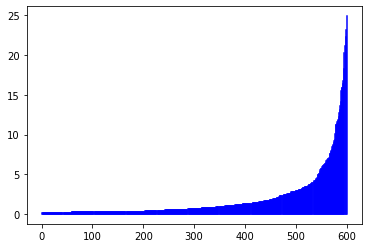

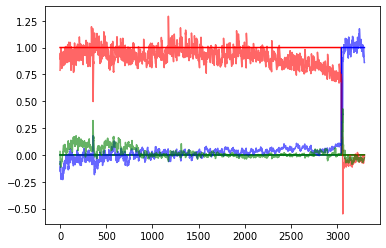

 42%|█████████████████████████████████████████████████████████████████▊                                                                                         | 1274/3000 [7:44:20<9:37:47, 20.09s/it]

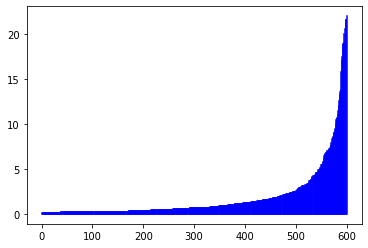

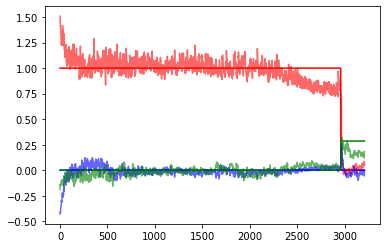

 43%|██████████████████████████████████████████████████████████████████                                                                                         | 1279/3000 [7:46:07<9:52:32, 20.66s/it]

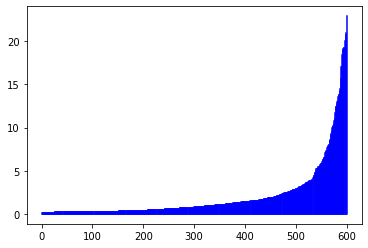

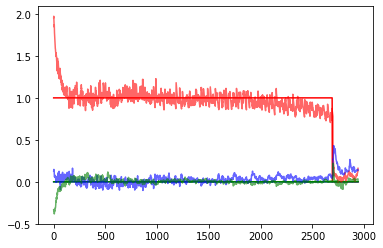

 43%|██████████████████████████████████████████████████████████████████▎                                                                                        | 1284/3000 [7:47:54<9:45:53, 20.49s/it]

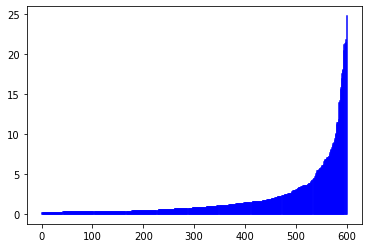

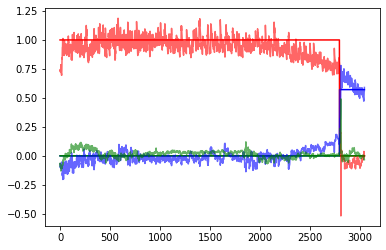

 43%|██████████████████████████████████████████████████████████████████▌                                                                                        | 1289/3000 [7:49:42<9:48:18, 20.63s/it]

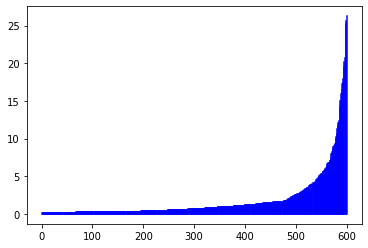

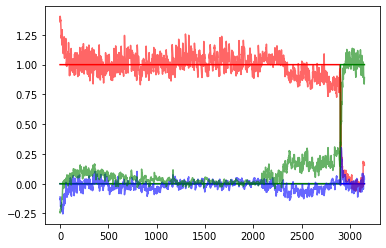

 43%|██████████████████████████████████████████████████████████████████▊                                                                                        | 1294/3000 [7:51:25<9:24:51, 19.87s/it]

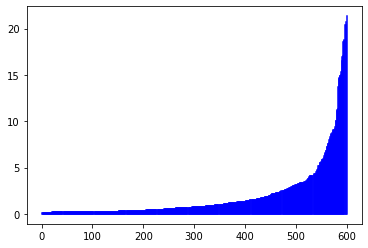

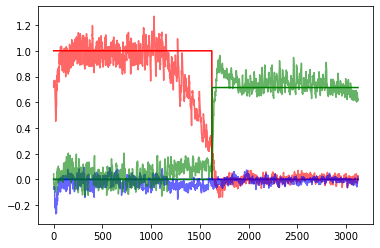

 43%|███████████████████████████████████████████████████████████████████                                                                                        | 1299/3000 [7:53:09<9:17:56, 19.68s/it]

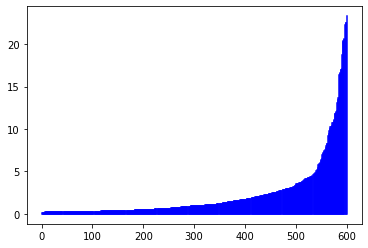

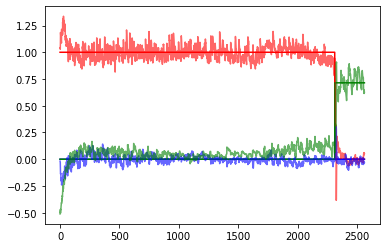

 43%|██████████████████████████████████████████████████████████████████▉                                                                                       | 1304/3000 [7:55:41<11:04:40, 23.51s/it]

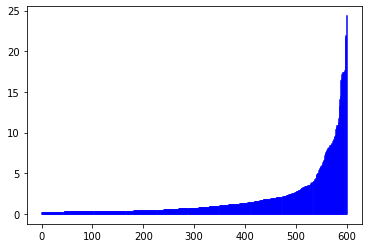

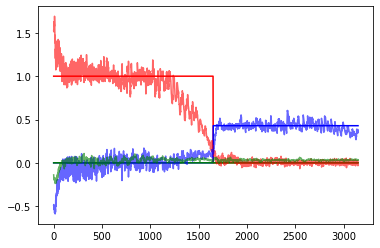

 44%|███████████████████████████████████████████████████████████████████▋                                                                                       | 1309/3000 [7:57:28<9:46:04, 20.79s/it]

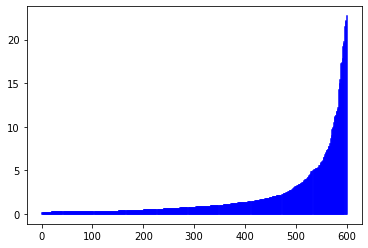

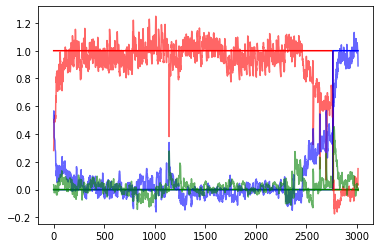

 44%|███████████████████████████████████████████████████████████████████▉                                                                                       | 1314/3000 [7:59:11<9:20:21, 19.94s/it]

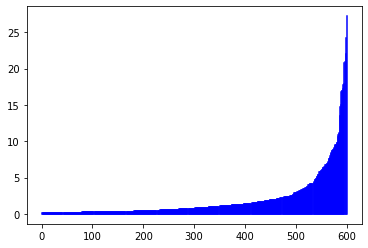

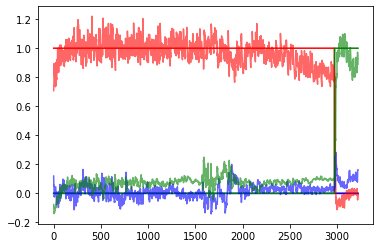

 44%|████████████████████████████████████████████████████████████████████▏                                                                                      | 1319/3000 [8:00:58<9:35:19, 20.53s/it]

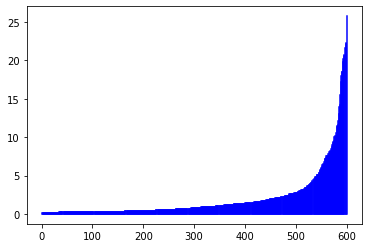

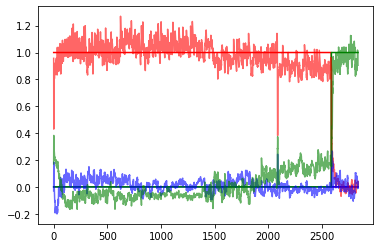

 44%|████████████████████████████████████████████████████████████████████▍                                                                                      | 1324/3000 [8:02:39<9:10:33, 19.71s/it]

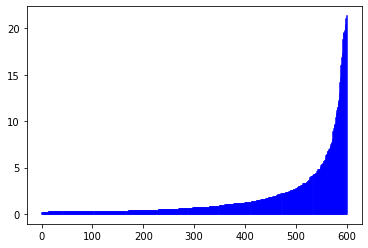

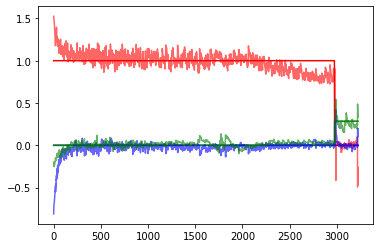

 44%|████████████████████████████████████████████████████████████████████▋                                                                                      | 1329/3000 [8:04:27<9:31:40, 20.53s/it]

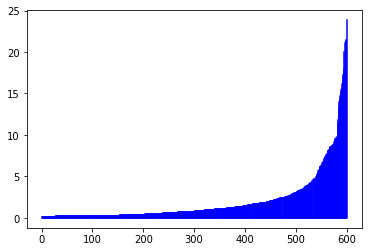

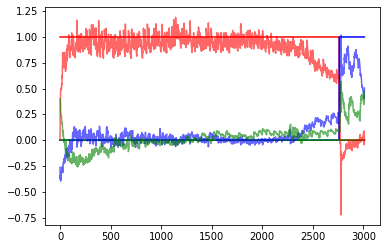

 44%|████████████████████████████████████████████████████████████████████▉                                                                                      | 1334/3000 [8:06:12<9:20:30, 20.19s/it]

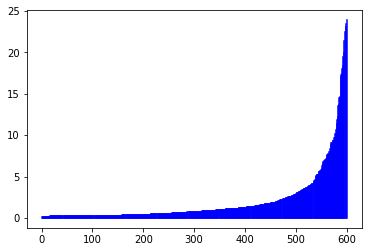

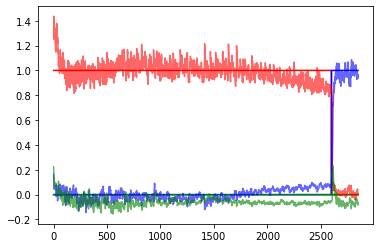

 45%|█████████████████████████████████████████████████████████████████████▏                                                                                     | 1339/3000 [8:07:55<9:11:58, 19.94s/it]

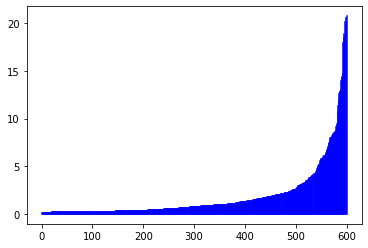

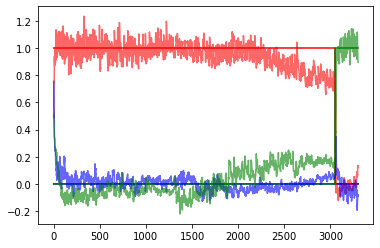

 45%|█████████████████████████████████████████████████████████████████████▍                                                                                     | 1344/3000 [8:09:38<9:04:58, 19.75s/it]

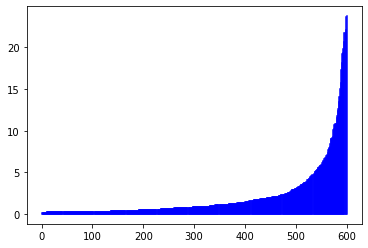

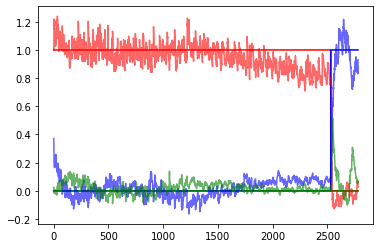

 45%|█████████████████████████████████████████████████████████████████████▋                                                                                     | 1349/3000 [8:11:24<9:18:53, 20.31s/it]

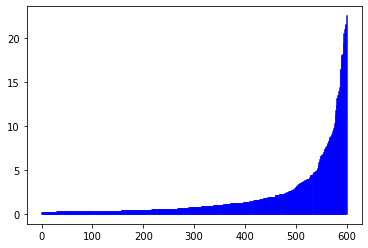

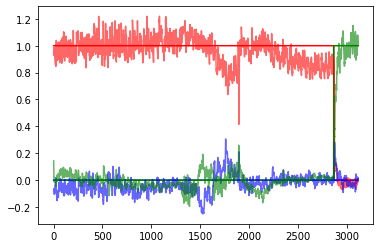

 45%|█████████████████████████████████████████████████████████████████████▌                                                                                    | 1354/3000 [8:13:55<10:35:49, 23.18s/it]

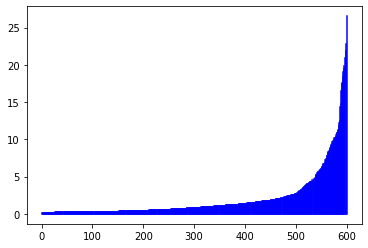

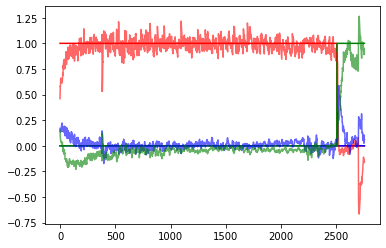

 45%|██████████████████████████████████████████████████████████████████████▏                                                                                    | 1359/3000 [8:15:38<9:16:56, 20.36s/it]

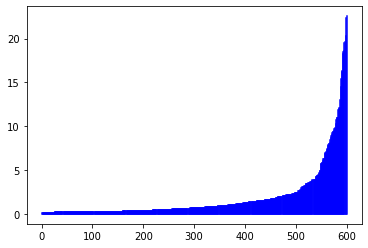

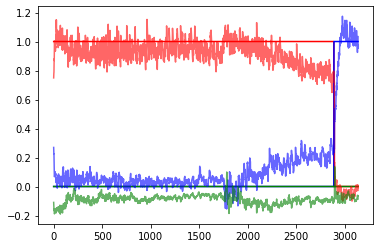

 45%|██████████████████████████████████████████████████████████████████████▍                                                                                    | 1364/3000 [8:17:22<9:13:15, 20.29s/it]

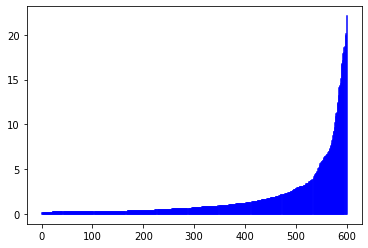

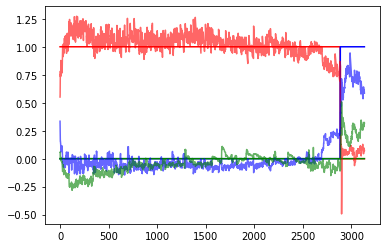

 46%|██████████████████████████████████████████████████████████████████████▋                                                                                    | 1369/3000 [8:19:04<8:55:10, 19.69s/it]

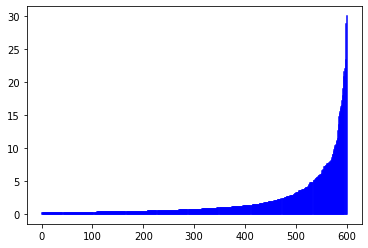

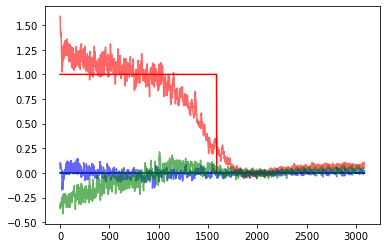

 46%|██████████████████████████████████████████████████████████████████████▉                                                                                    | 1374/3000 [8:20:47<9:01:31, 19.98s/it]

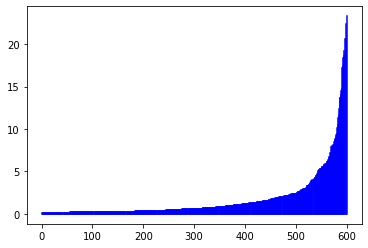

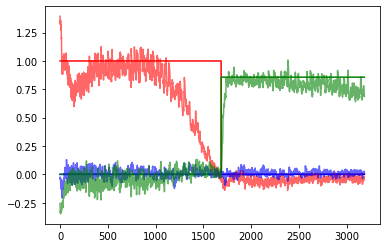

 46%|███████████████████████████████████████████████████████████████████████▏                                                                                   | 1379/3000 [8:22:26<8:40:42, 19.27s/it]

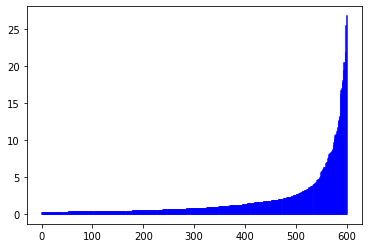

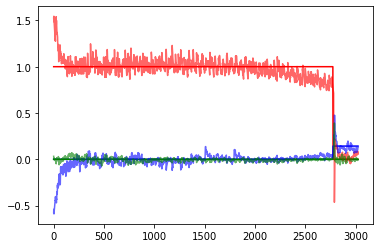

 46%|███████████████████████████████████████████████████████████████████████▌                                                                                   | 1384/3000 [8:24:12<8:58:51, 20.01s/it]

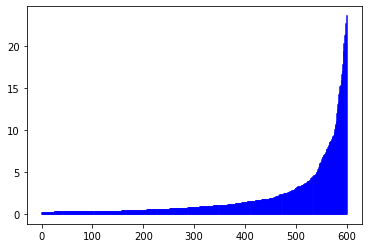

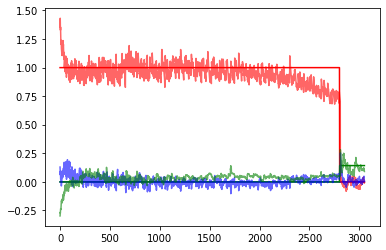

 46%|███████████████████████████████████████████████████████████████████████▊                                                                                   | 1389/3000 [8:25:58<9:10:17, 20.50s/it]

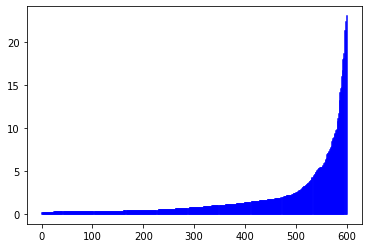

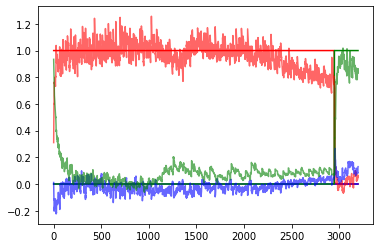

 46%|████████████████████████████████████████████████████████████████████████                                                                                   | 1394/3000 [8:27:44<9:03:01, 20.29s/it]

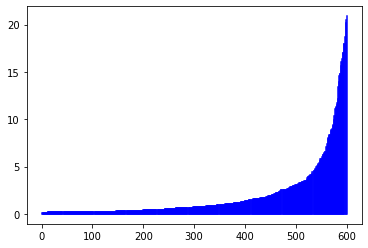

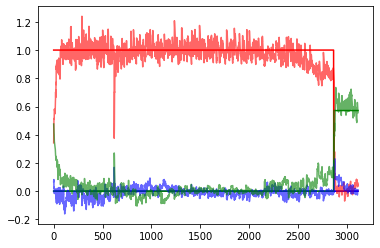

 47%|████████████████████████████████████████████████████████████████████████▎                                                                                  | 1399/3000 [8:29:27<8:46:18, 19.72s/it]

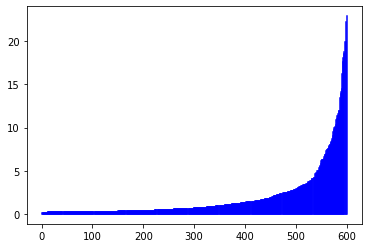

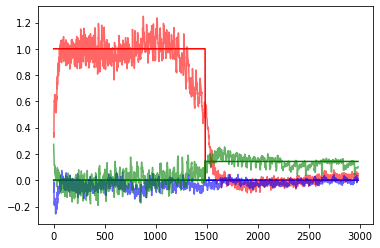

 47%|████████████████████████████████████████████████████████████████████████                                                                                  | 1404/3000 [8:32:01<10:43:35, 24.20s/it]

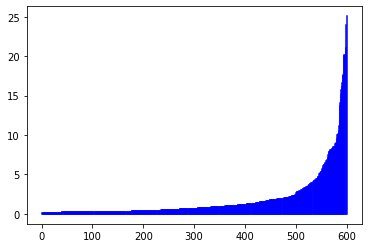

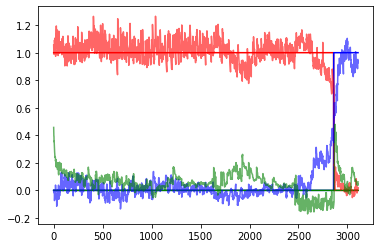

 47%|████████████████████████████████████████████████████████████████████████▊                                                                                  | 1409/3000 [8:33:50<9:36:13, 21.73s/it]

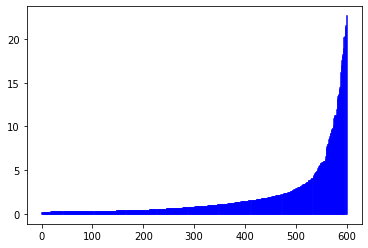

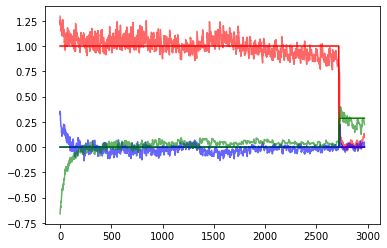

 47%|█████████████████████████████████████████████████████████████████████████                                                                                  | 1414/3000 [8:35:34<8:56:56, 20.31s/it]

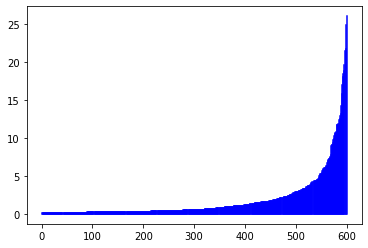

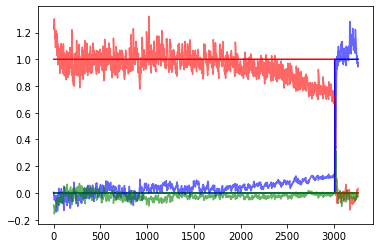

 47%|█████████████████████████████████████████████████████████████████████████▎                                                                                 | 1419/3000 [8:37:16<8:36:45, 19.61s/it]

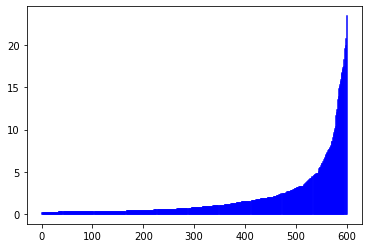

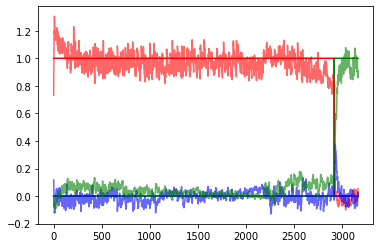

 47%|█████████████████████████████████████████████████████████████████████████▌                                                                                 | 1424/3000 [8:39:00<8:32:34, 19.51s/it]

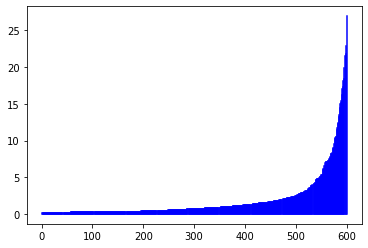

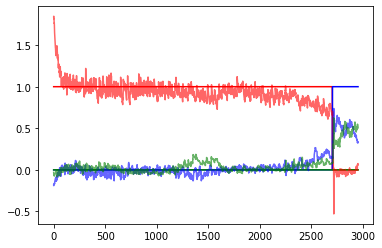

 48%|█████████████████████████████████████████████████████████████████████████▊                                                                                 | 1429/3000 [8:40:43<8:30:46, 19.51s/it]

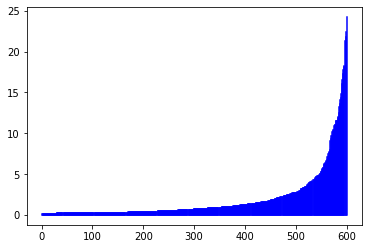

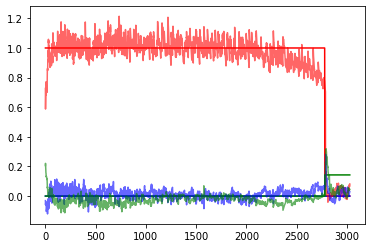

 48%|██████████████████████████████████████████████████████████████████████████                                                                                 | 1434/3000 [8:42:24<8:35:58, 19.77s/it]

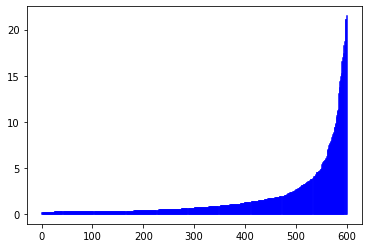

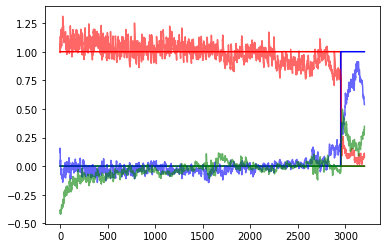

 48%|██████████████████████████████████████████████████████████████████████████▎                                                                                | 1439/3000 [8:44:07<8:35:27, 19.81s/it]

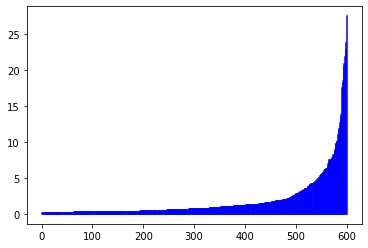

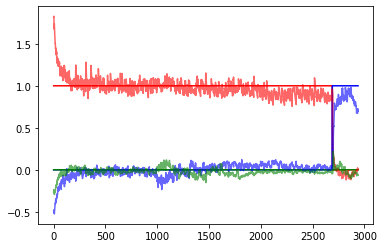

 48%|██████████████████████████████████████████████████████████████████████████▌                                                                                | 1444/3000 [8:45:52<8:45:04, 20.25s/it]

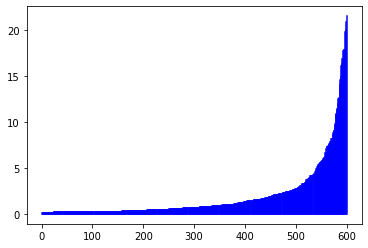

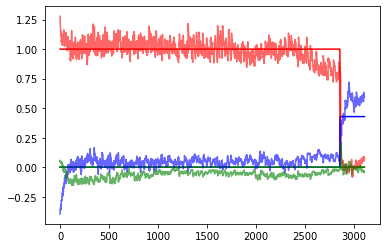

 48%|██████████████████████████████████████████████████████████████████████████▊                                                                                | 1449/3000 [8:47:40<8:52:34, 20.60s/it]

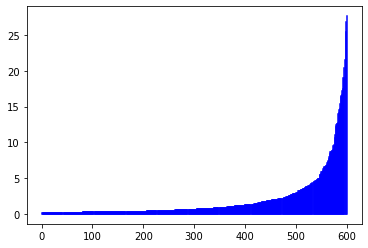

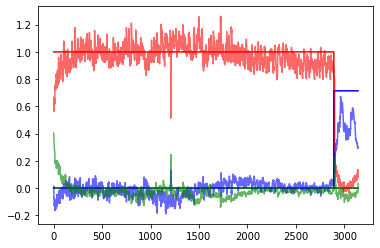

 48%|██████████████████████████████████████████████████████████████████████████▋                                                                               | 1454/3000 [8:50:13<10:15:15, 23.88s/it]

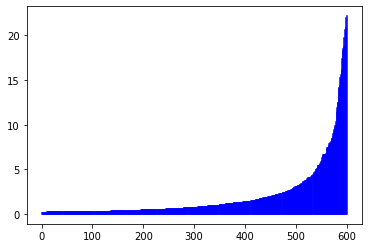

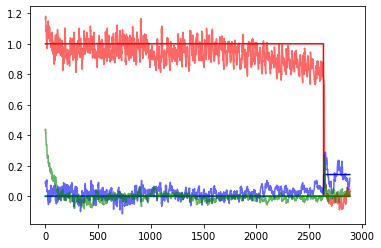

 49%|███████████████████████████████████████████████████████████████████████████▍                                                                               | 1459/3000 [8:51:56<8:51:59, 20.71s/it]

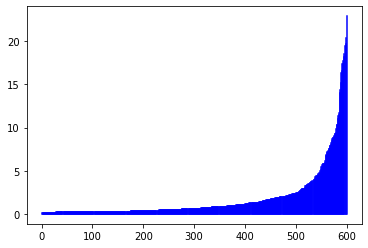

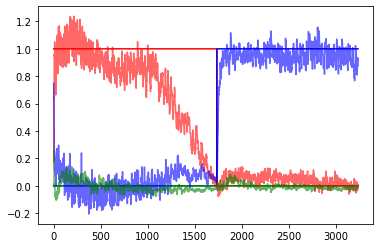

 49%|███████████████████████████████████████████████████████████████████████████▋                                                                               | 1464/3000 [8:53:40<8:33:53, 20.07s/it]

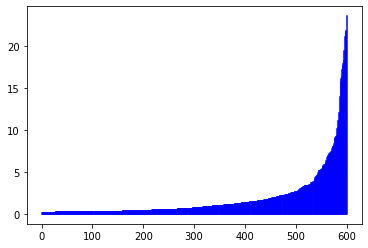

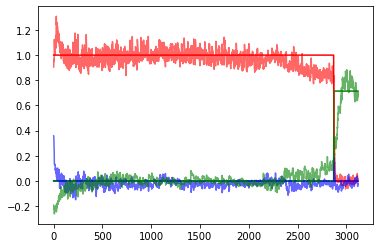

 49%|███████████████████████████████████████████████████████████████████████████▉                                                                               | 1469/3000 [8:55:28<8:52:44, 20.88s/it]

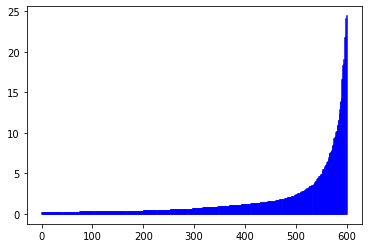

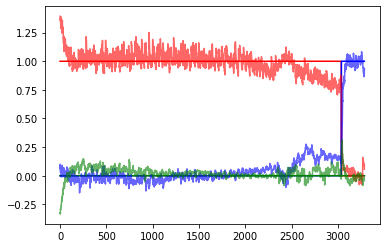

 49%|████████████████████████████████████████████████████████████████████████████▏                                                                              | 1474/3000 [8:57:13<8:40:07, 20.45s/it]

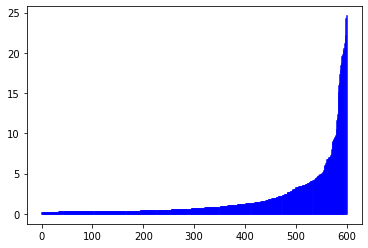

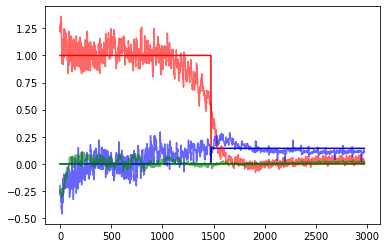

 49%|████████████████████████████████████████████████████████████████████████████▍                                                                              | 1479/3000 [8:58:57<8:21:52, 19.80s/it]

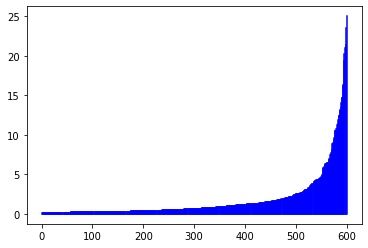

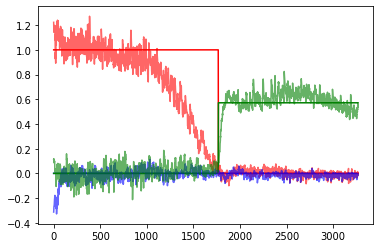

 49%|████████████████████████████████████████████████████████████████████████████▋                                                                              | 1484/3000 [9:00:42<8:33:28, 20.32s/it]

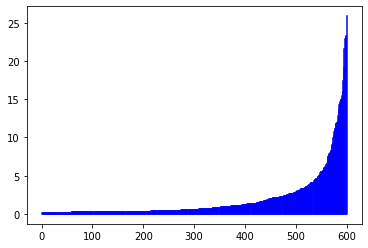

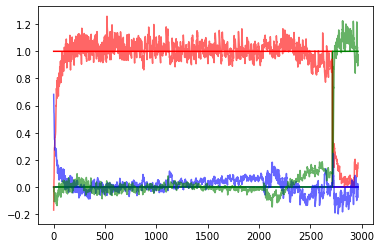

 50%|████████████████████████████████████████████████████████████████████████████▉                                                                              | 1489/3000 [9:02:22<8:14:16, 19.63s/it]

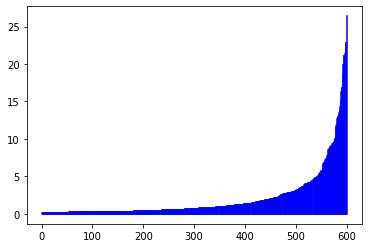

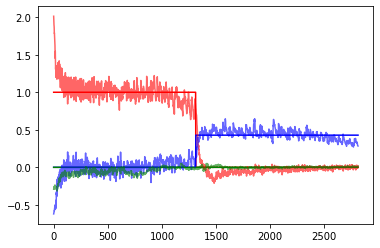

 50%|█████████████████████████████████████████████████████████████████████████████▏                                                                             | 1494/3000 [9:04:04<8:08:02, 19.44s/it]

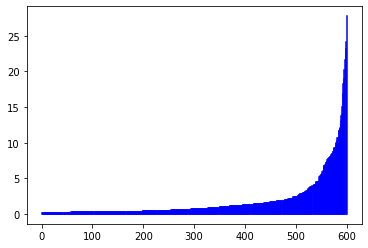

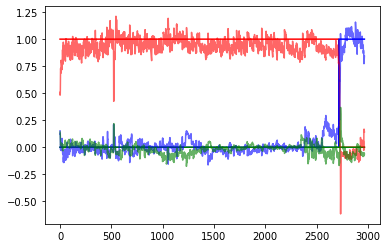

 50%|█████████████████████████████████████████████████████████████████████████████▍                                                                             | 1499/3000 [9:05:45<8:05:25, 19.40s/it]

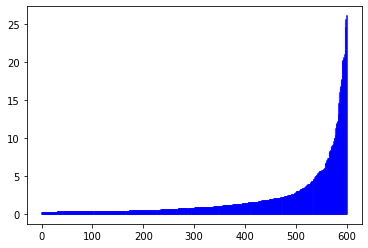

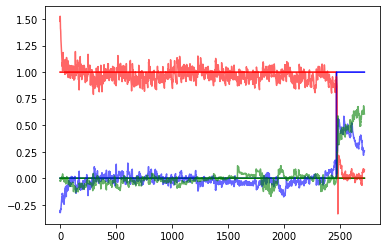

 50%|█████████████████████████████████████████████████████████████████████████████▏                                                                            | 1504/3000 [9:08:20<10:02:19, 24.16s/it]

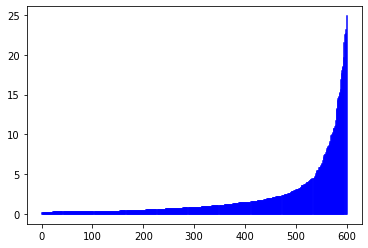

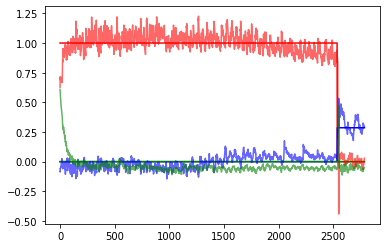

 50%|█████████████████████████████████████████████████████████████████████████████▉                                                                             | 1509/3000 [9:10:02<8:30:22, 20.54s/it]

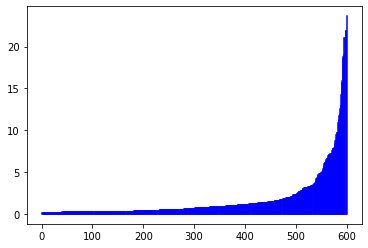

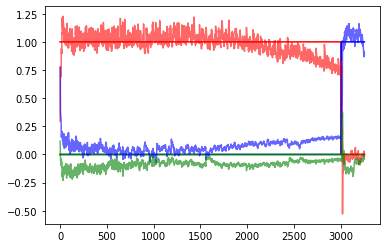

 50%|██████████████████████████████████████████████████████████████████████████████▏                                                                            | 1514/3000 [9:11:46<8:15:45, 20.02s/it]

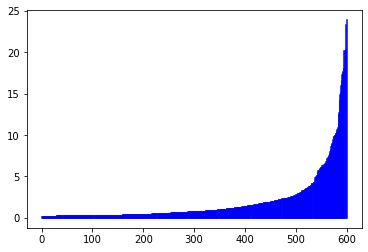

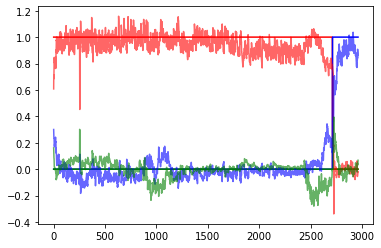

 51%|██████████████████████████████████████████████████████████████████████████████▍                                                                            | 1519/3000 [9:13:29<8:11:50, 19.93s/it]

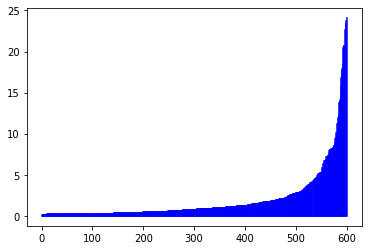

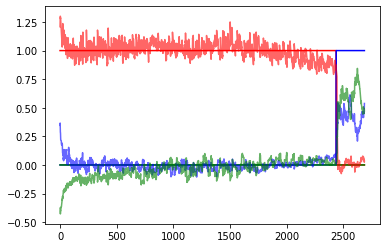

 51%|██████████████████████████████████████████████████████████████████████████████▋                                                                            | 1524/3000 [9:15:12<8:10:58, 19.96s/it]

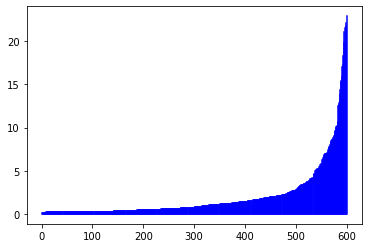

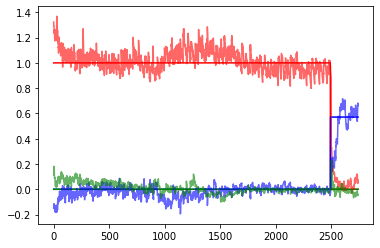

 51%|██████████████████████████████████████████████████████████████████████████████▉                                                                            | 1529/3000 [9:16:58<8:20:10, 20.40s/it]

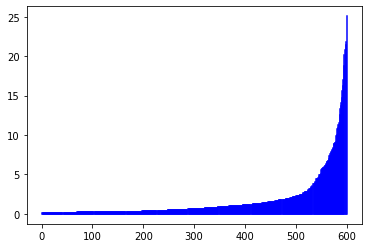

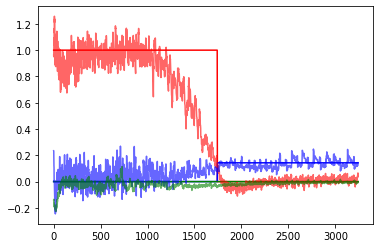

 51%|███████████████████████████████████████████████████████████████████████████████▎                                                                           | 1534/3000 [9:18:43<8:13:30, 20.20s/it]

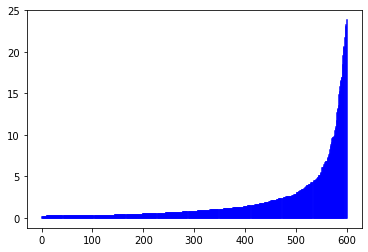

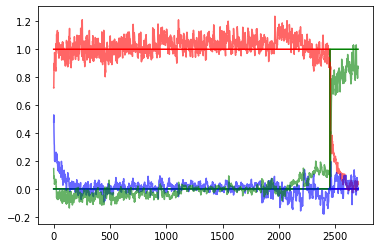

 51%|███████████████████████████████████████████████████████████████████████████████▌                                                                           | 1539/3000 [9:20:25<8:03:47, 19.87s/it]

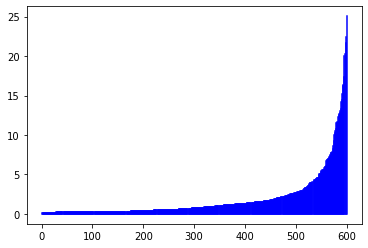

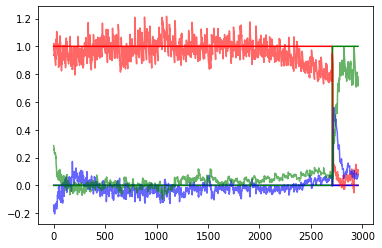

 51%|███████████████████████████████████████████████████████████████████████████████▊                                                                           | 1544/3000 [9:22:13<8:24:28, 20.79s/it]

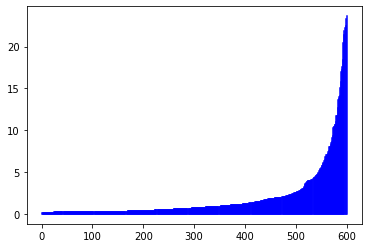

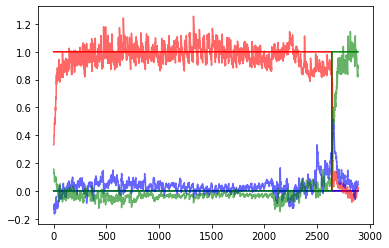

 52%|████████████████████████████████████████████████████████████████████████████████                                                                           | 1549/3000 [9:23:59<8:12:17, 20.36s/it]

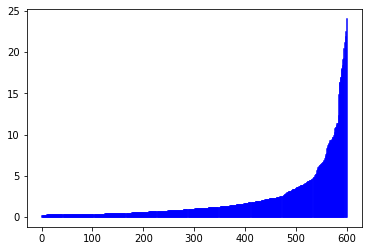

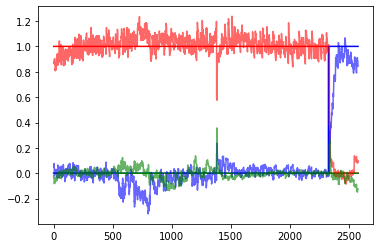

 52%|████████████████████████████████████████████████████████████████████████████████▎                                                                          | 1554/3000 [9:26:29<9:17:46, 23.14s/it]

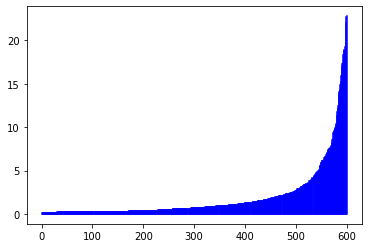

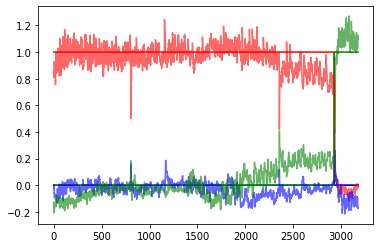

 52%|████████████████████████████████████████████████████████████████████████████████▌                                                                          | 1559/3000 [9:28:13<8:12:06, 20.49s/it]

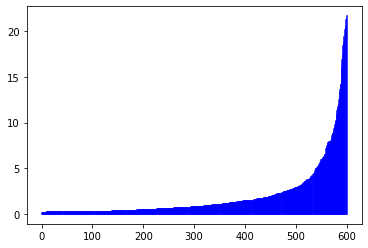

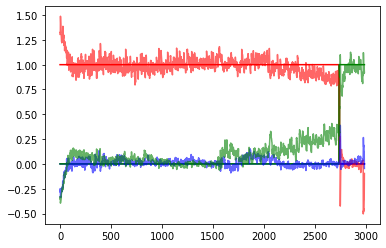

 52%|████████████████████████████████████████████████████████████████████████████████▊                                                                          | 1564/3000 [9:29:56<8:02:33, 20.16s/it]

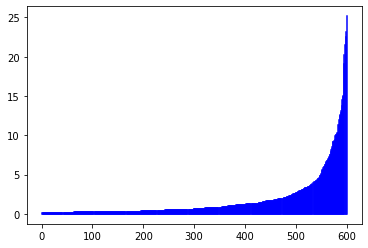

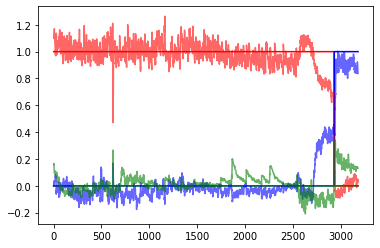

 52%|█████████████████████████████████████████████████████████████████████████████████                                                                          | 1569/3000 [9:31:41<8:09:19, 20.52s/it]

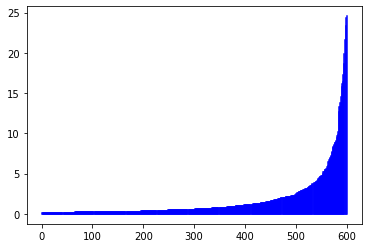

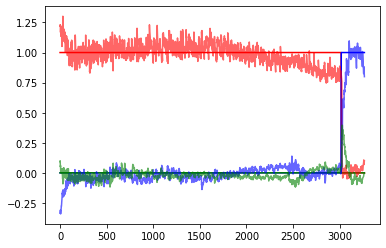

 52%|█████████████████████████████████████████████████████████████████████████████████▎                                                                         | 1574/3000 [9:33:30<8:10:36, 20.64s/it]

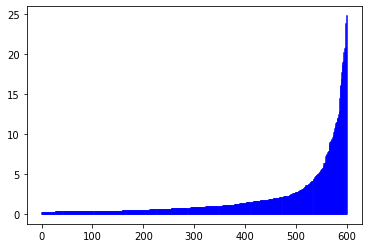

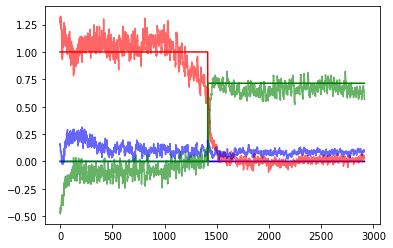

 53%|█████████████████████████████████████████████████████████████████████████████████▌                                                                         | 1579/3000 [9:35:16<8:01:21, 20.32s/it]

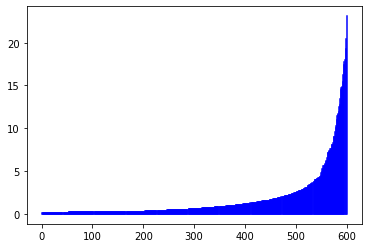

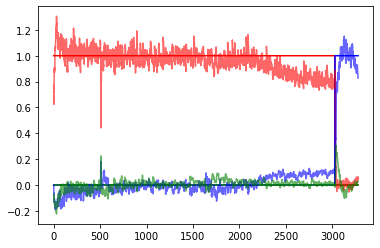

 53%|█████████████████████████████████████████████████████████████████████████████████▊                                                                         | 1584/3000 [9:37:01<7:47:33, 19.81s/it]

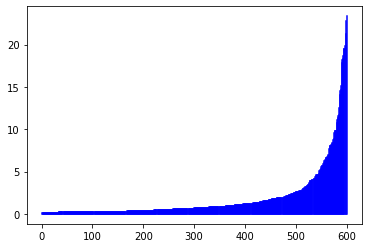

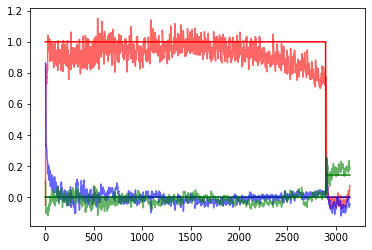

 53%|██████████████████████████████████████████████████████████████████████████████████                                                                         | 1589/3000 [9:38:48<8:00:50, 20.45s/it]

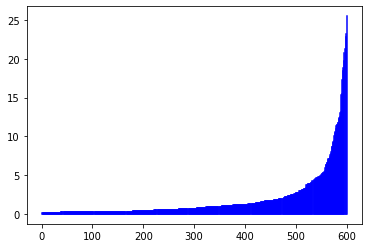

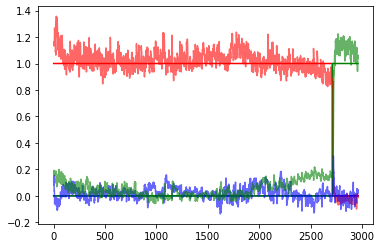

 53%|██████████████████████████████████████████████████████████████████████████████████▎                                                                        | 1594/3000 [9:40:37<8:09:21, 20.88s/it]

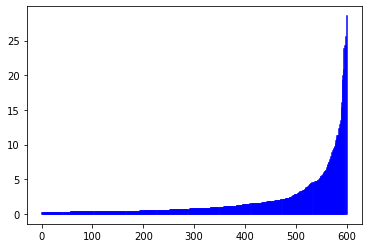

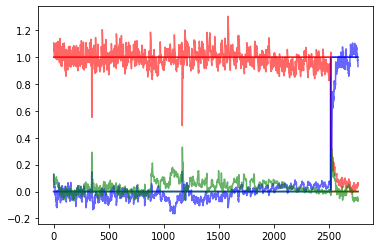

 53%|██████████████████████████████████████████████████████████████████████████████████▌                                                                        | 1599/3000 [9:42:20<7:52:21, 20.23s/it]

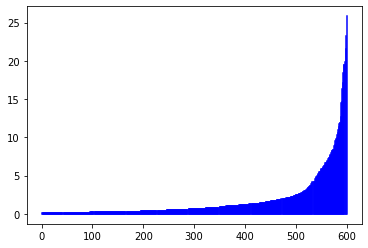

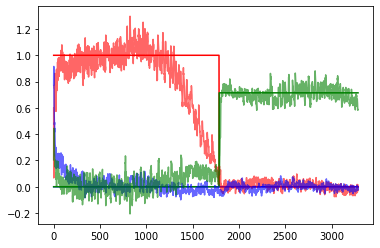

 53%|██████████████████████████████████████████████████████████████████████████████████▊                                                                        | 1604/3000 [9:44:54<9:17:11, 23.95s/it]

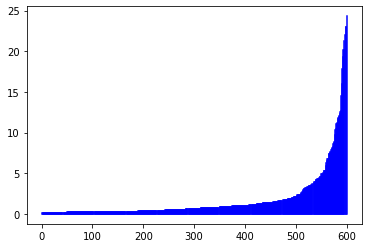

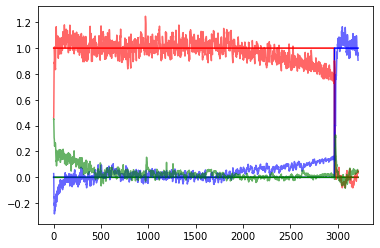

 54%|███████████████████████████████████████████████████████████████████████████████████▏                                                                       | 1609/3000 [9:46:39<8:03:43, 20.86s/it]

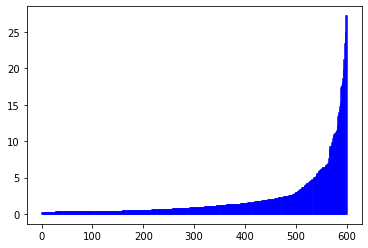

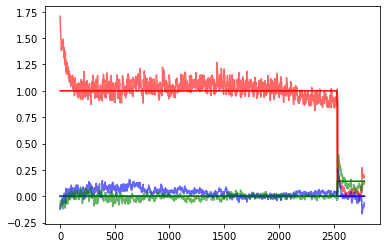

 54%|███████████████████████████████████████████████████████████████████████████████████▍                                                                       | 1614/3000 [9:48:25<7:53:00, 20.48s/it]

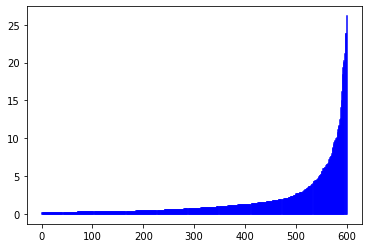

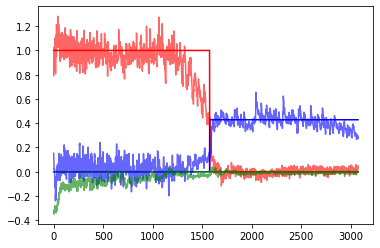

 54%|███████████████████████████████████████████████████████████████████████████████████▋                                                                       | 1619/3000 [9:50:07<7:29:43, 19.54s/it]

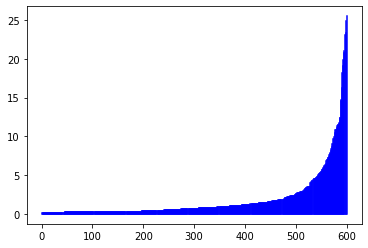

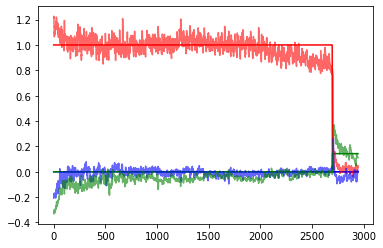

 54%|███████████████████████████████████████████████████████████████████████████████████▉                                                                       | 1624/3000 [9:51:53<7:43:19, 20.20s/it]

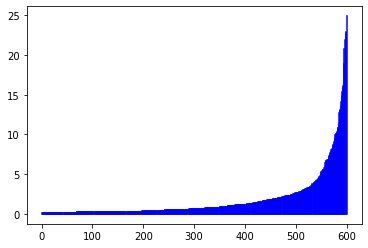

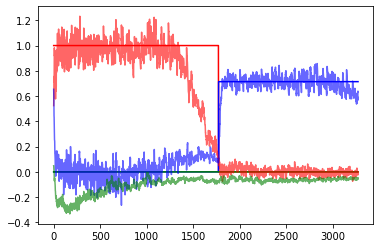

 54%|████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 1629/3000 [9:53:40<7:49:15, 20.54s/it]

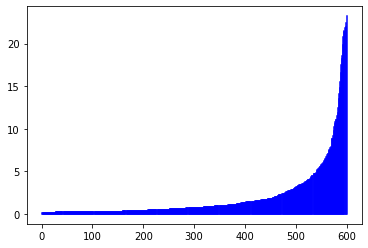

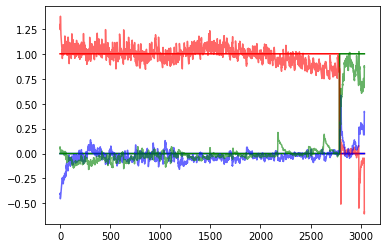

 54%|████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 1634/3000 [9:55:25<7:45:39, 20.45s/it]

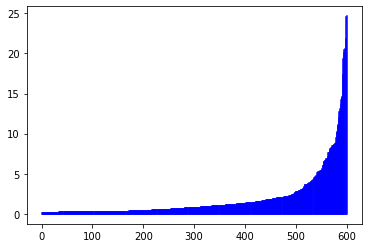

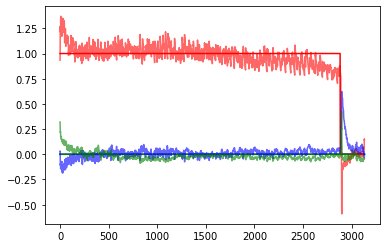

 55%|████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 1639/3000 [9:57:13<7:43:44, 20.44s/it]

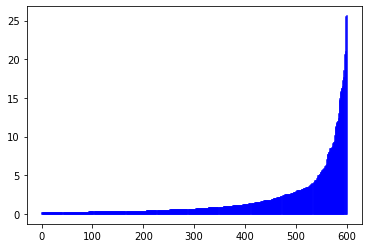

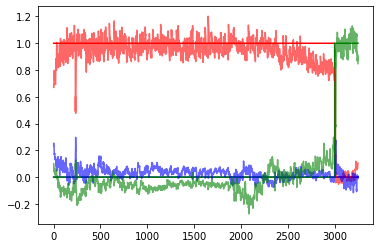

 55%|████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 1644/3000 [9:59:00<7:47:11, 20.67s/it]

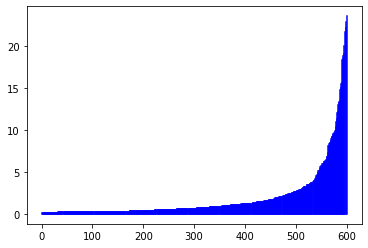

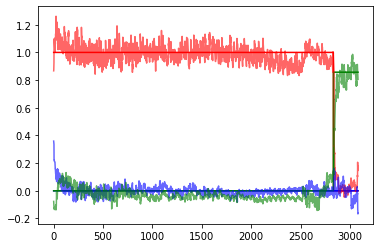

 55%|████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 1649/3000 [10:00:47<7:45:48, 20.69s/it]

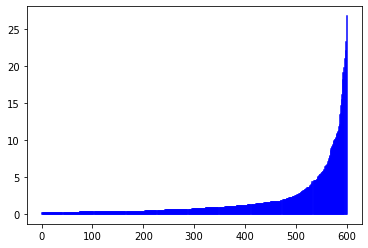

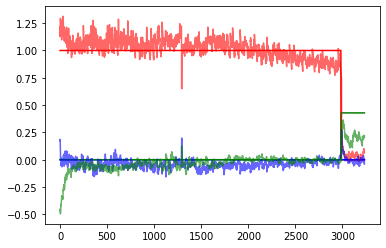

 55%|████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 1654/3000 [10:03:21<8:48:10, 23.54s/it]

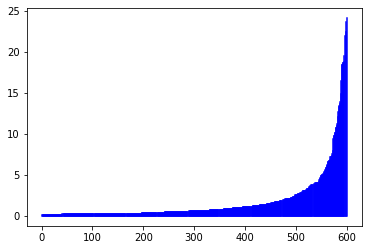

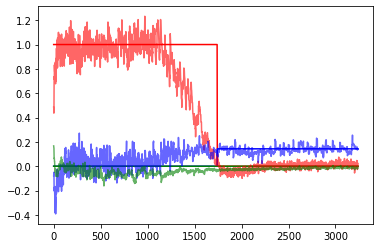

 55%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 1659/3000 [10:05:07<7:50:22, 21.05s/it]

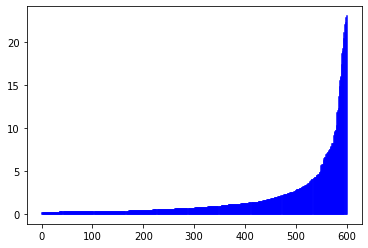

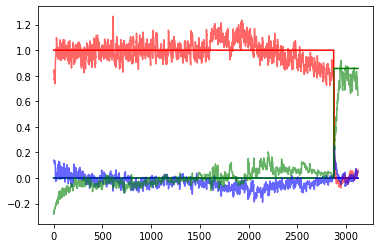

 55%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 1664/3000 [10:06:53<7:30:30, 20.23s/it]

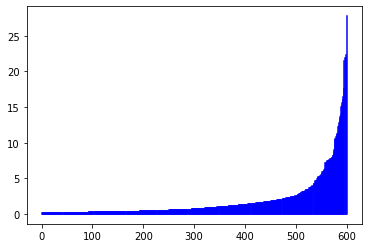

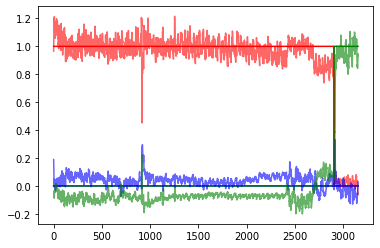

 56%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 1669/3000 [10:08:37<7:27:10, 20.16s/it]

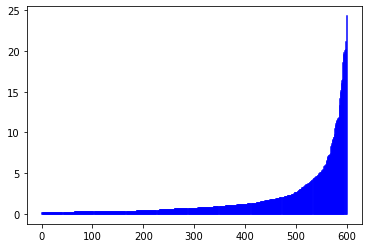

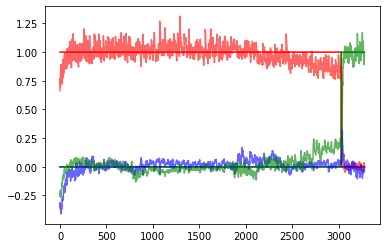

 56%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 1674/3000 [10:10:21<7:18:21, 19.84s/it]

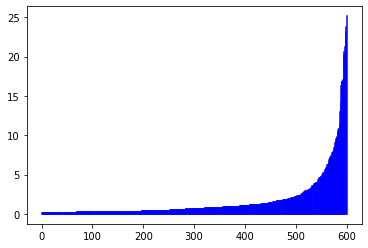

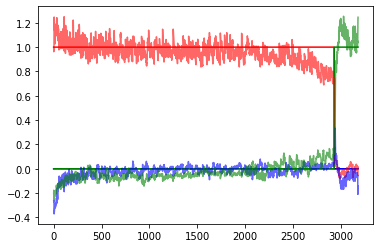

 56%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 1679/3000 [10:12:03<7:10:41, 19.56s/it]

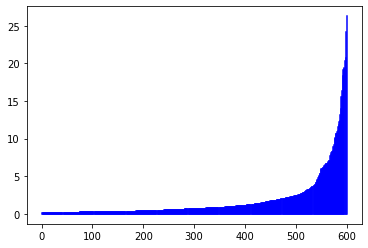

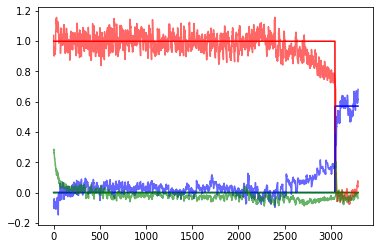

 56%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 1684/3000 [10:13:50<7:31:07, 20.57s/it]

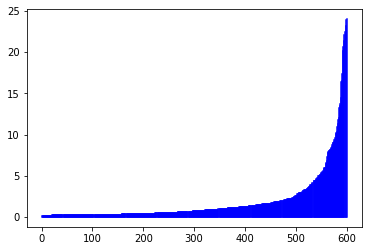

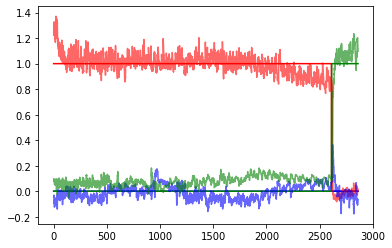

 56%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 1689/3000 [10:15:38<7:32:14, 20.70s/it]

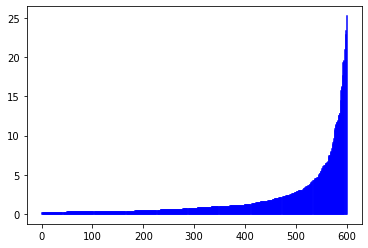

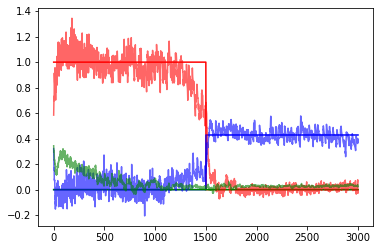

 56%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 1694/3000 [10:17:22<7:21:35, 20.29s/it]

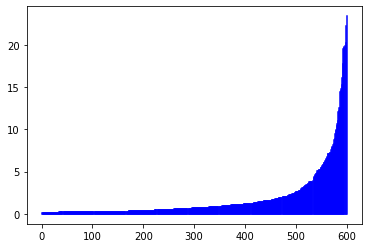

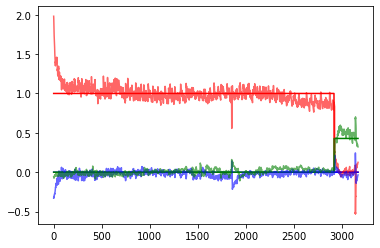

 57%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 1699/3000 [10:19:10<7:28:09, 20.67s/it]

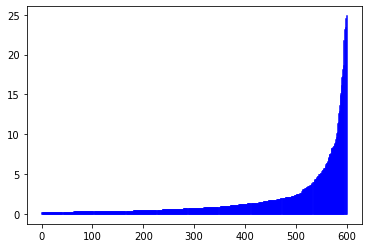

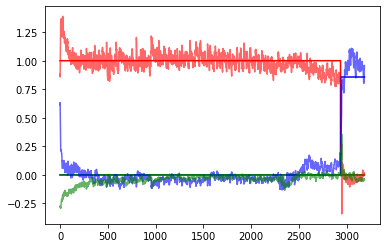

 57%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 1704/3000 [10:21:41<8:21:26, 23.21s/it]

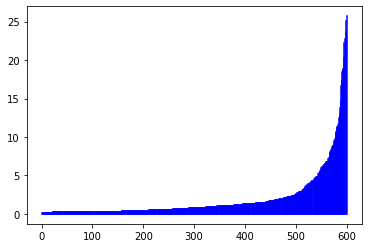

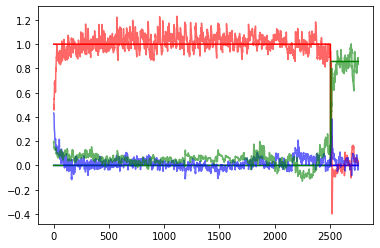

 57%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 1709/3000 [10:23:20<7:02:59, 19.66s/it]

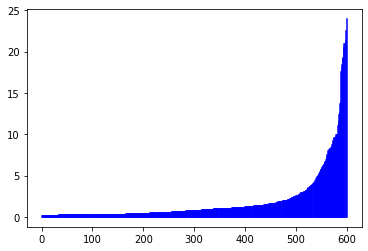

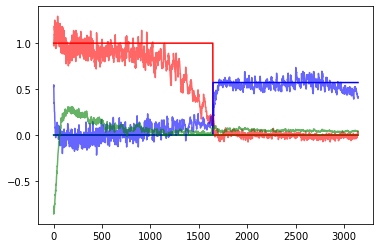

 57%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 1714/3000 [10:25:02<7:04:10, 19.79s/it]

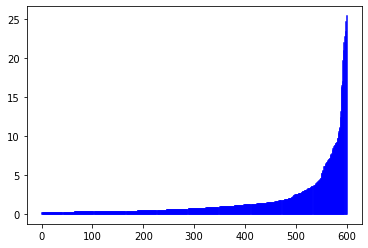

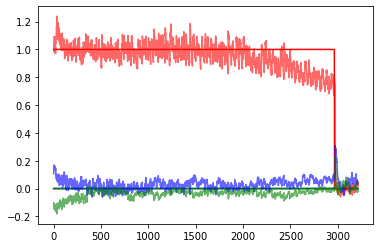

 57%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 1719/3000 [10:26:44<7:00:25, 19.69s/it]

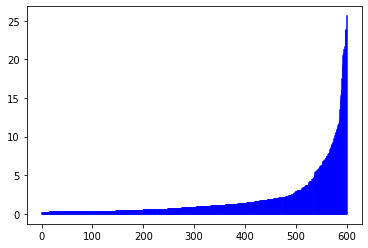

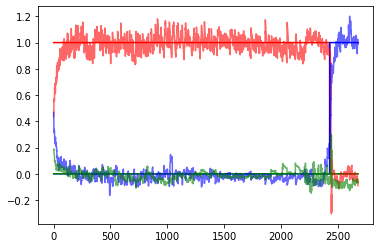

 57%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 1724/3000 [10:28:21<6:39:49, 18.80s/it]

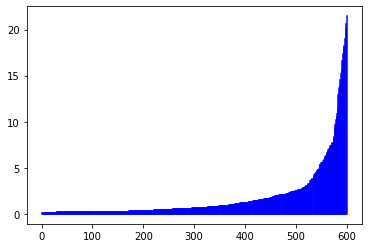

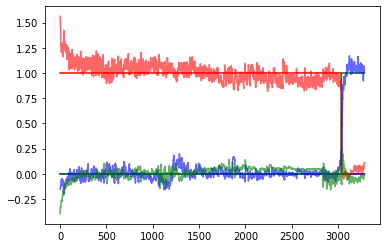

 58%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 1729/3000 [10:30:05<7:00:00, 19.83s/it]

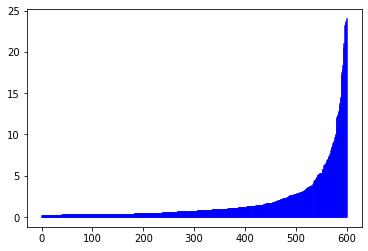

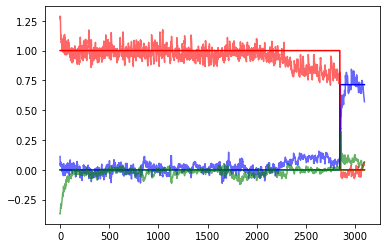

 58%|█████████████████████████████████████████████████████████████████████████████████████████                                                                 | 1734/3000 [10:31:52<7:11:52, 20.47s/it]

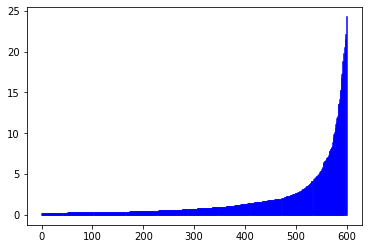

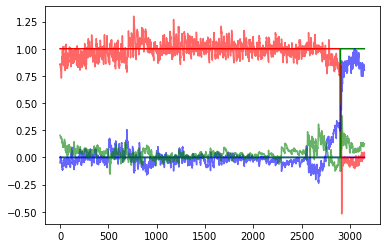

 58%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 1739/3000 [10:33:36<7:06:41, 20.30s/it]

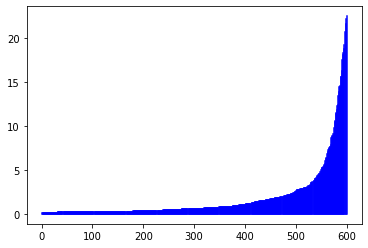

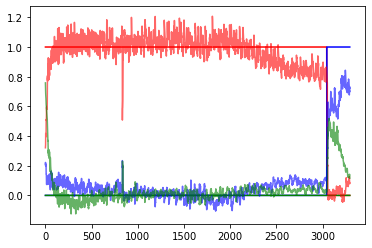

 58%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 1744/3000 [10:35:17<6:47:35, 19.47s/it]

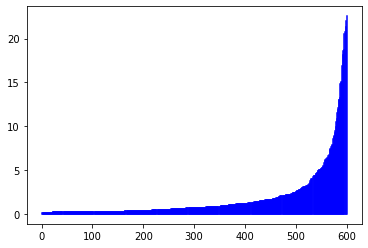

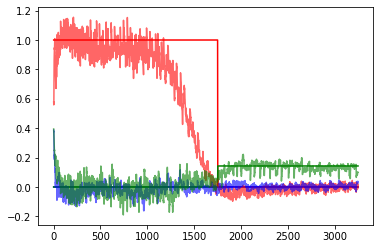

 58%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 1749/3000 [10:37:00<6:54:31, 19.88s/it]

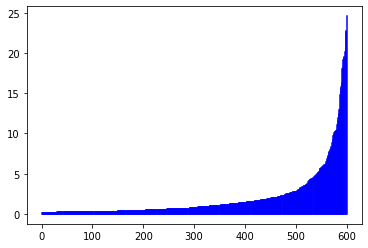

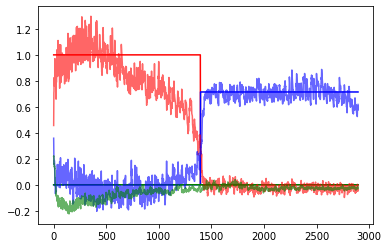

 58%|██████████████████████████████████████████████████████████████████████████████████████████                                                                | 1754/3000 [10:39:34<8:11:49, 23.68s/it]

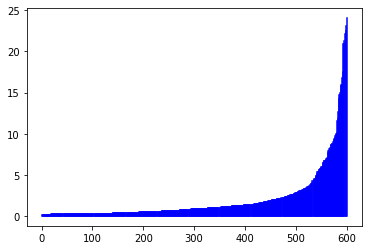

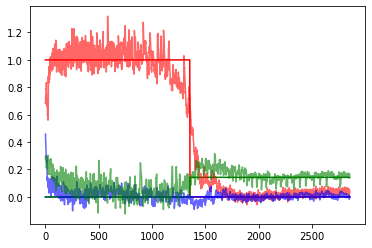

 59%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 1759/3000 [10:41:14<6:48:08, 19.73s/it]

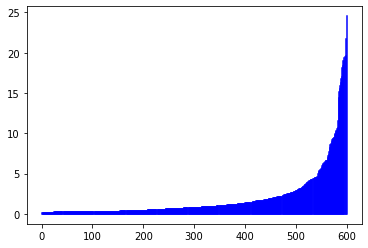

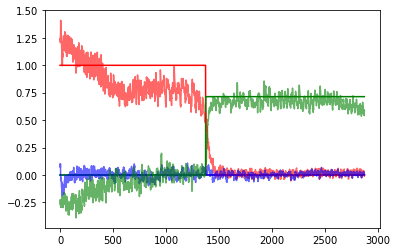

 59%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 1764/3000 [10:42:54<6:33:26, 19.10s/it]

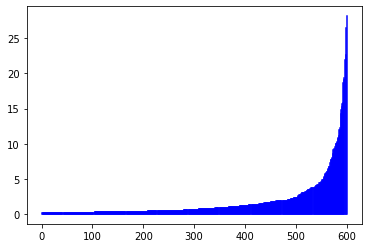

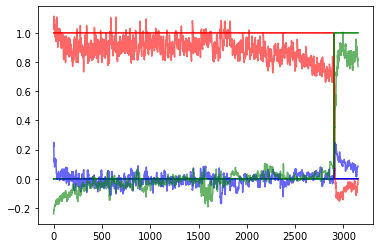

 59%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 1769/3000 [10:44:35<6:38:27, 19.42s/it]

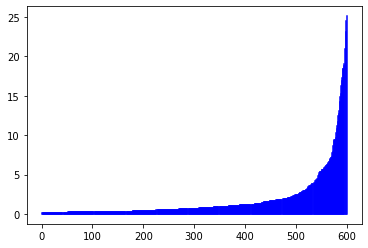

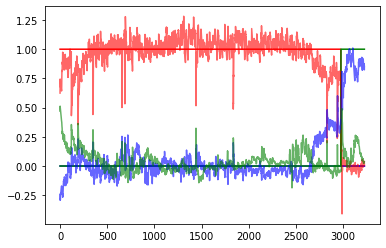

 59%|███████████████████████████████████████████████████████████████████████████████████████████                                                               | 1774/3000 [10:46:21<6:48:34, 20.00s/it]

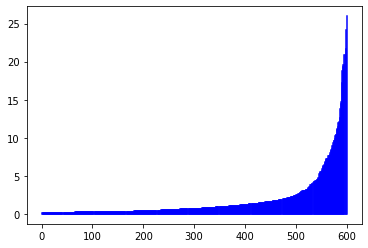

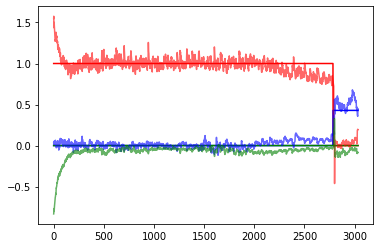

 59%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 1779/3000 [10:48:06<6:55:26, 20.42s/it]

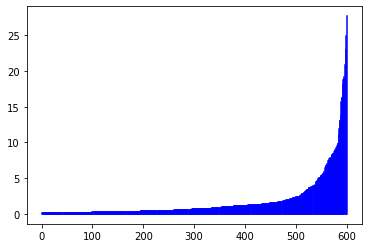

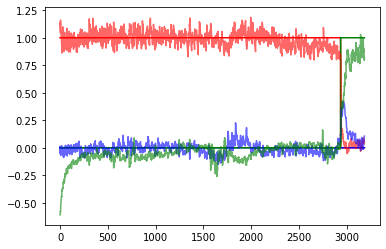

 59%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 1784/3000 [10:49:49<6:47:47, 20.12s/it]

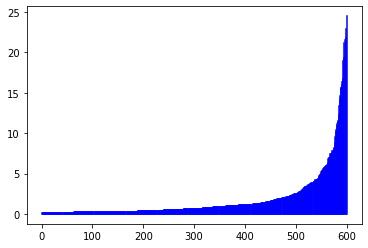

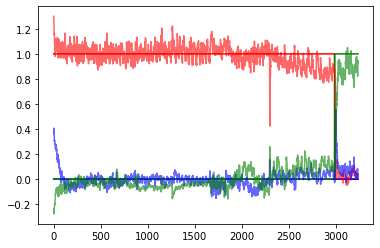

 60%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 1789/3000 [10:51:35<6:53:12, 20.47s/it]

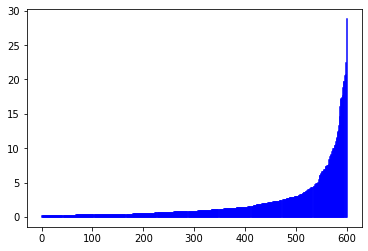

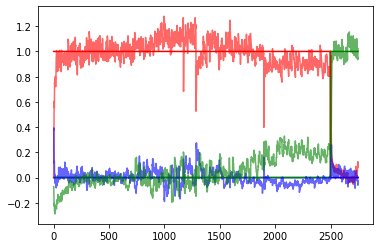

 60%|████████████████████████████████████████████████████████████████████████████████████████████                                                              | 1794/3000 [10:53:18<6:49:27, 20.37s/it]

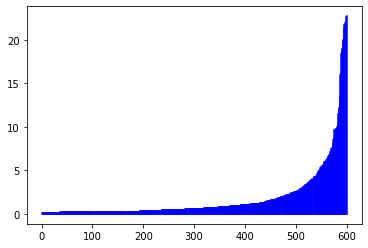

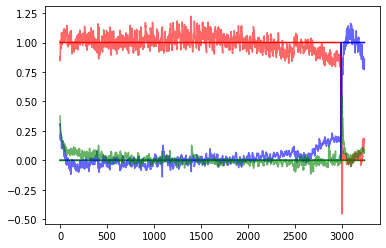

 60%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 1799/3000 [10:55:03<6:37:19, 19.85s/it]

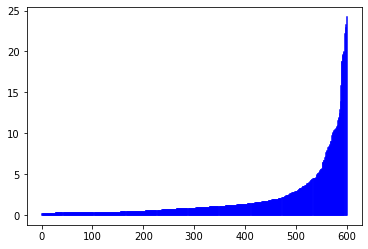

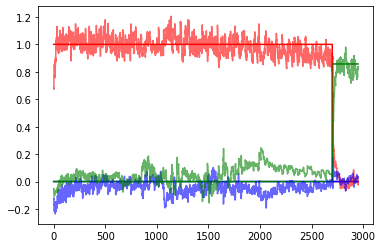

 60%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 1804/3000 [10:57:38<7:57:26, 23.95s/it]

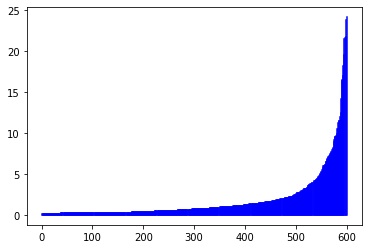

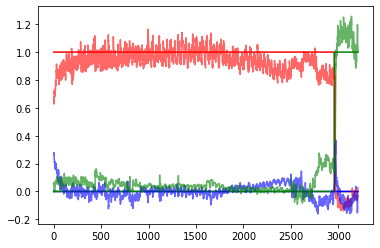

 60%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 1809/3000 [10:59:22<6:51:38, 20.74s/it]

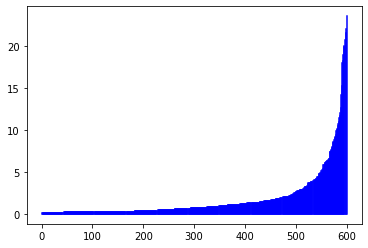

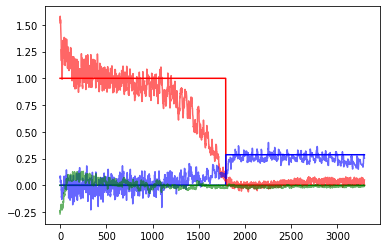

 60%|█████████████████████████████████████████████████████████████████████████████████████████████                                                             | 1814/3000 [11:01:08<6:47:14, 20.60s/it]

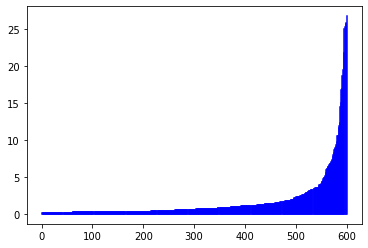

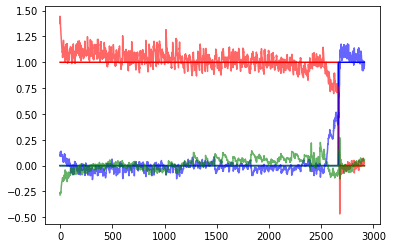

 61%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 1819/3000 [11:02:52<6:37:09, 20.18s/it]

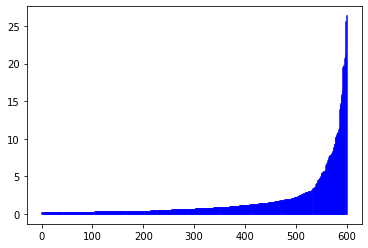

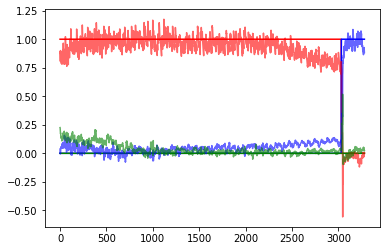

 61%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 1824/3000 [11:04:38<6:32:16, 20.01s/it]

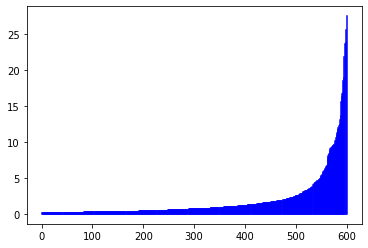

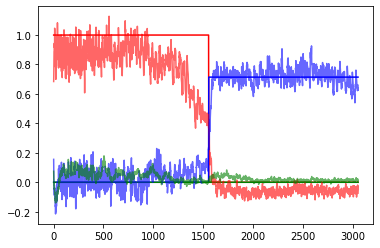

 61%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 1829/3000 [11:06:20<6:24:57, 19.72s/it]

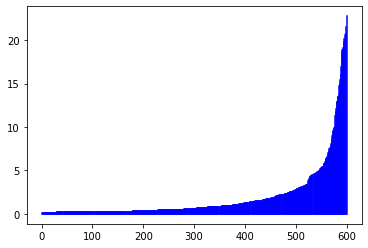

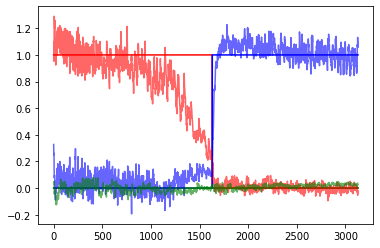

 61%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 1834/3000 [11:08:05<6:27:25, 19.94s/it]

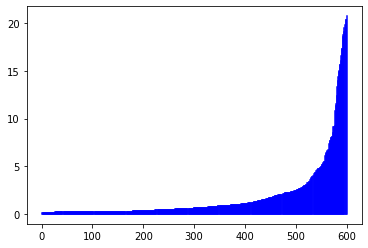

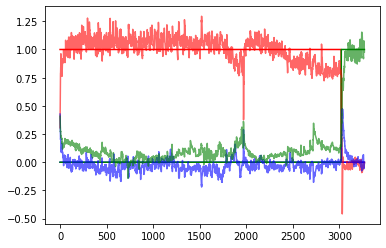

 61%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 1839/3000 [11:09:45<6:07:59, 19.02s/it]

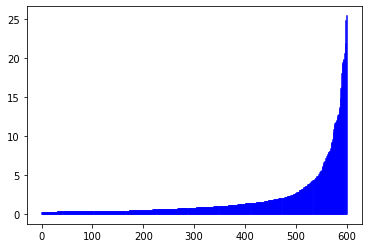

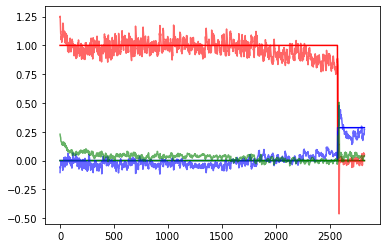

 61%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 1844/3000 [11:11:32<6:32:48, 20.39s/it]

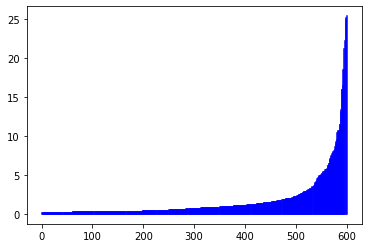

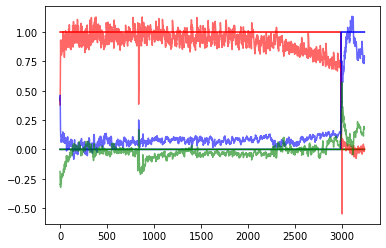

 62%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 1849/3000 [11:13:14<6:16:39, 19.63s/it]

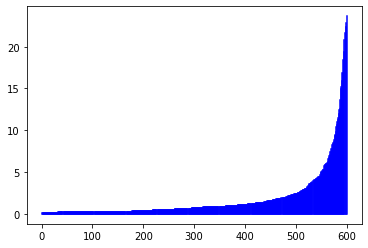

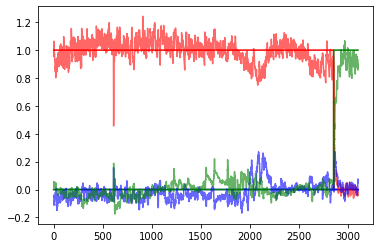

 62%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 1854/3000 [11:15:50<7:36:38, 23.91s/it]

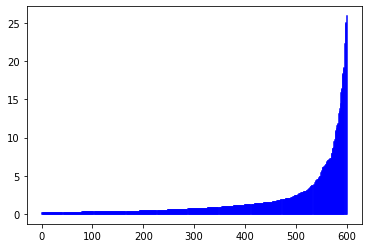

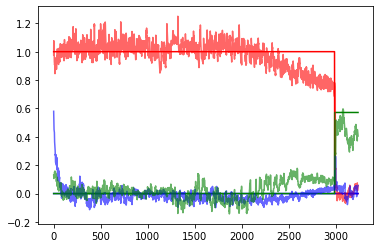

 62%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 1859/3000 [11:17:36<6:39:13, 20.99s/it]

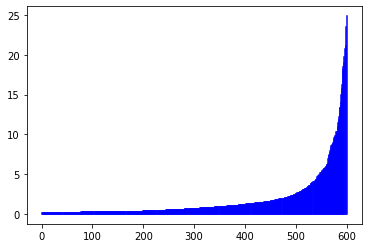

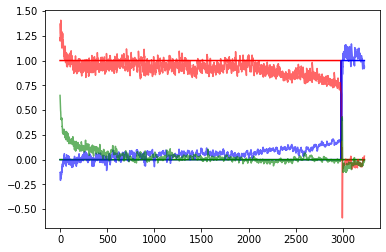

 62%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 1864/3000 [11:19:22<6:30:06, 20.60s/it]

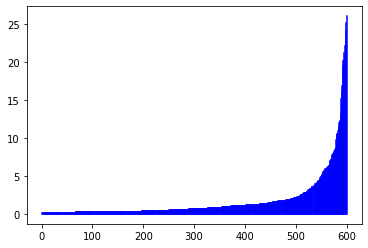

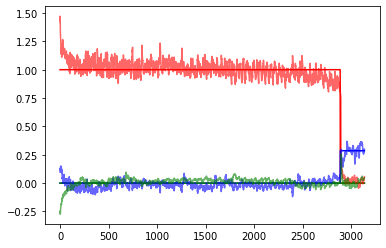

 62%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 1869/3000 [11:21:05<6:12:53, 19.78s/it]

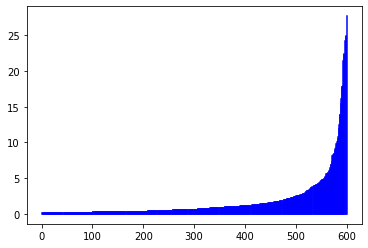

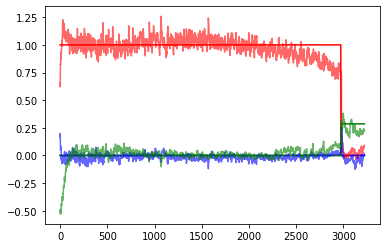

 62%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 1874/3000 [11:22:52<6:24:11, 20.47s/it]

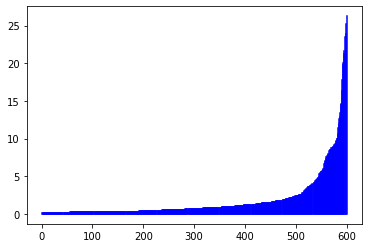

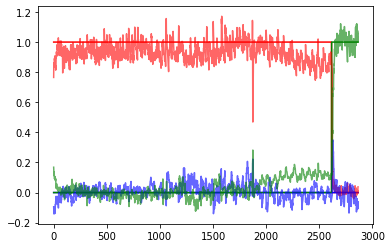

 63%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 1879/3000 [11:24:38<6:26:09, 20.67s/it]

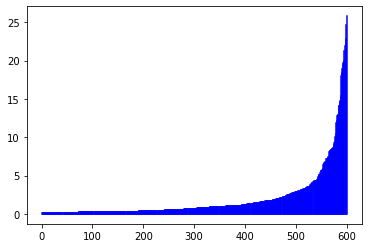

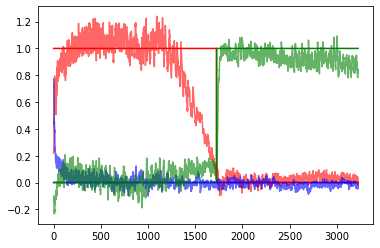

 63%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 1884/3000 [11:26:25<6:26:54, 20.80s/it]

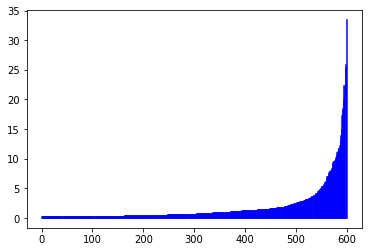

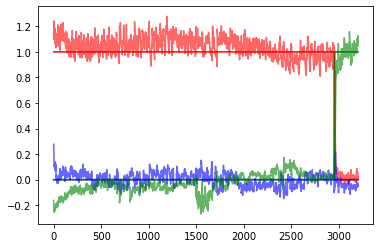

 63%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 1889/3000 [11:28:08<6:02:28, 19.58s/it]

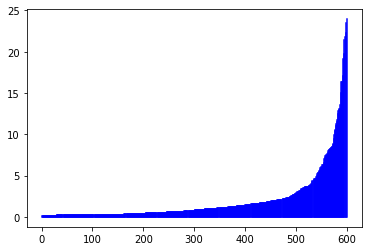

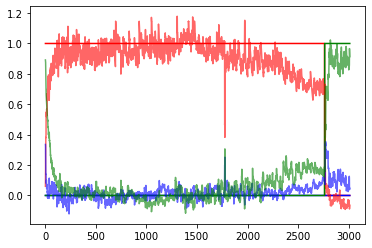

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 1894/3000 [11:29:52<6:09:32, 20.05s/it]

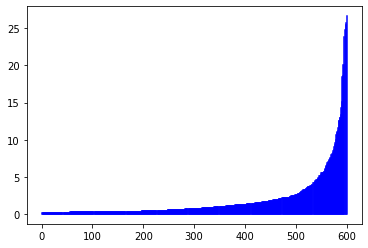

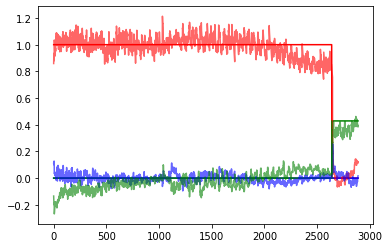

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 1899/3000 [11:31:35<6:08:38, 20.09s/it]

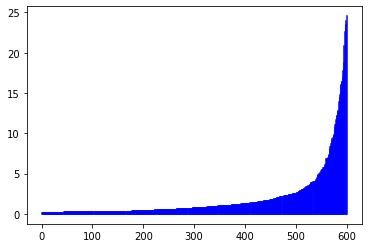

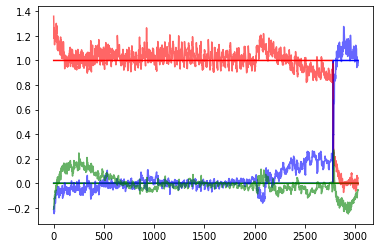

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 1904/3000 [11:34:08<7:08:31, 23.46s/it]

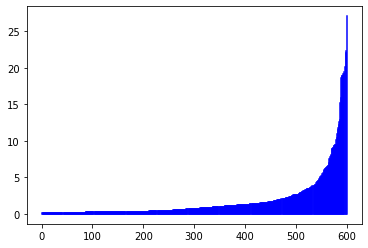

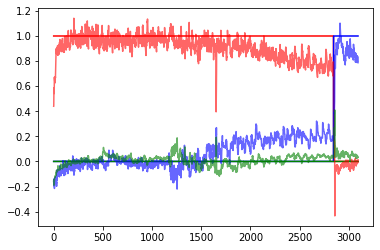

 64%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 1909/3000 [11:35:55<6:26:22, 21.25s/it]

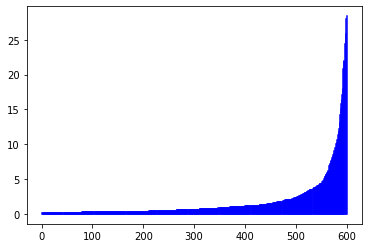

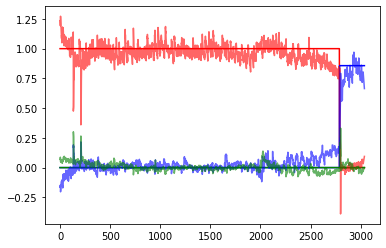

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 1914/3000 [11:37:42<6:10:23, 20.46s/it]

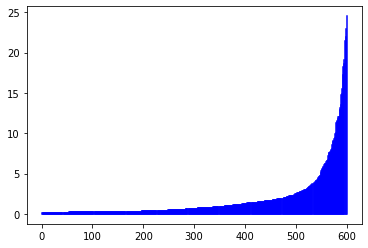

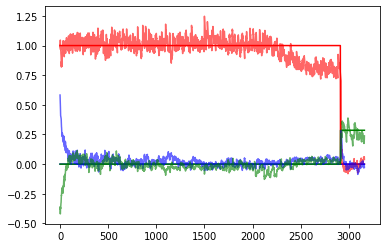

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 1919/3000 [11:39:28<6:08:46, 20.47s/it]

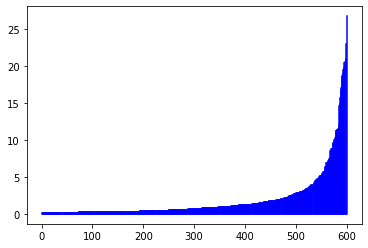

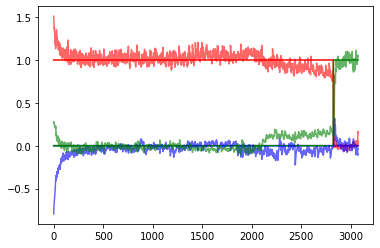

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 1924/3000 [11:41:11<5:56:56, 19.90s/it]

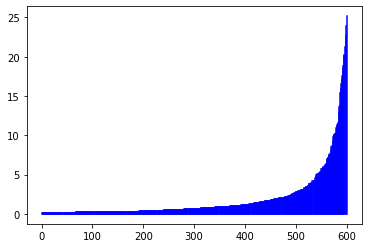

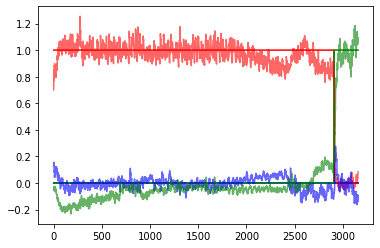

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 1929/3000 [11:42:53<5:52:15, 19.73s/it]

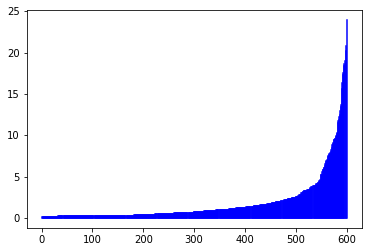

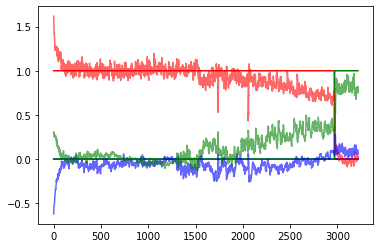

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 1934/3000 [11:44:36<5:48:12, 19.60s/it]

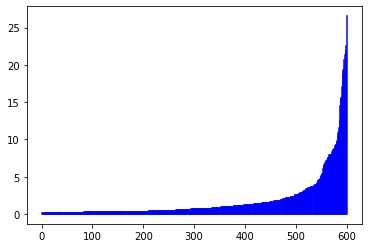

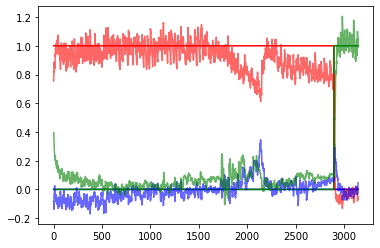

 65%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 1939/3000 [11:46:20<5:49:57, 19.79s/it]

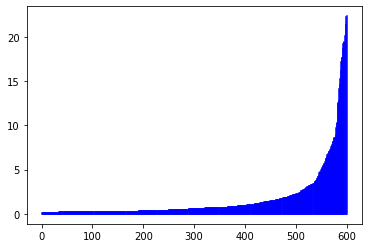

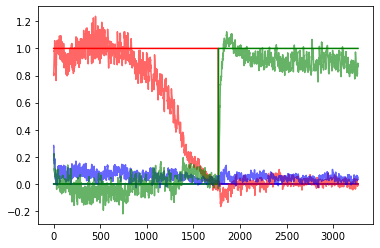

 65%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 1944/3000 [11:48:05<5:58:18, 20.36s/it]

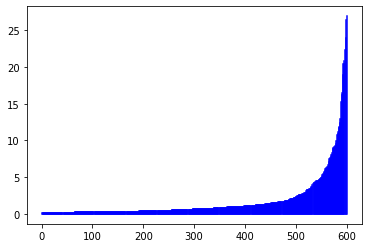

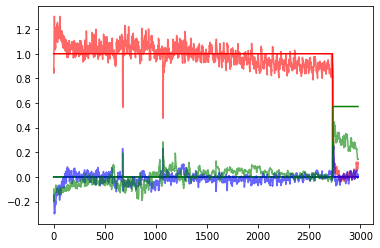

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 1949/3000 [11:49:48<5:47:50, 19.86s/it]

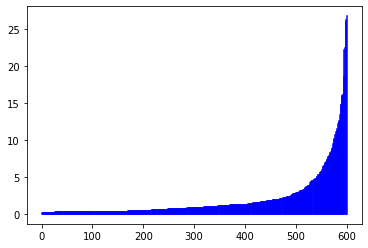

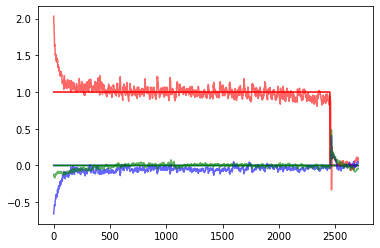

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 1954/3000 [11:52:18<6:39:11, 22.90s/it]

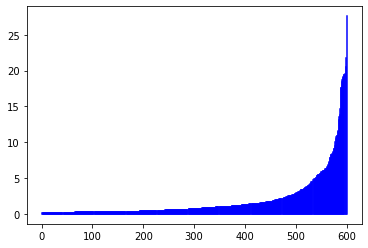

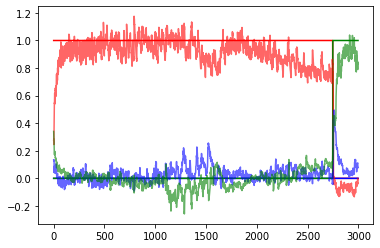

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 1959/3000 [11:54:01<5:50:57, 20.23s/it]

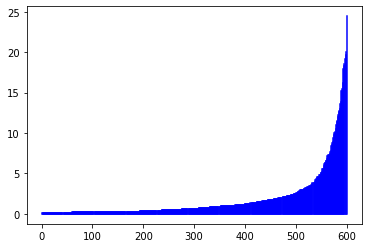

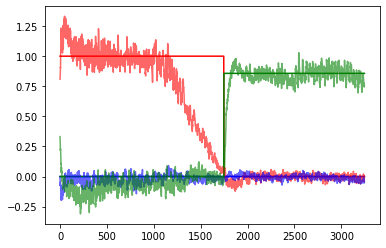

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 1964/3000 [11:55:42<5:35:00, 19.40s/it]

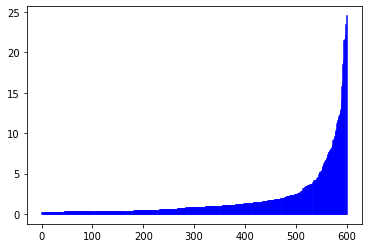

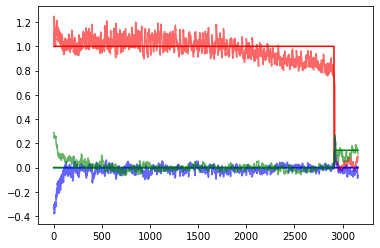

 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 1969/3000 [11:57:29<5:52:01, 20.49s/it]

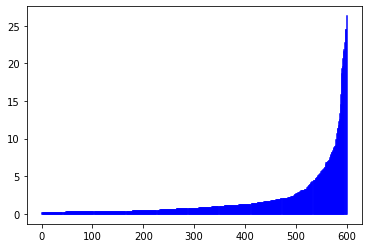

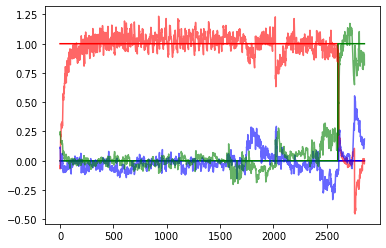

 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 1974/3000 [11:59:15<5:51:06, 20.53s/it]

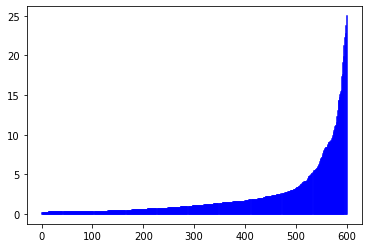

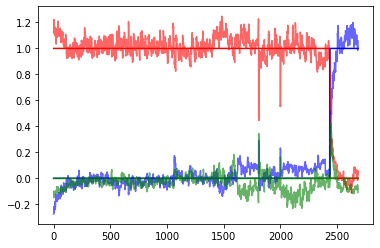

 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 1979/3000 [12:00:58<5:40:30, 20.01s/it]

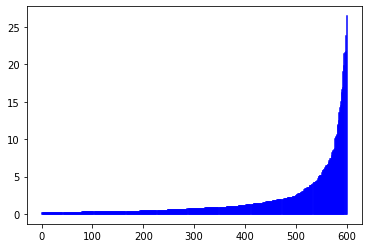

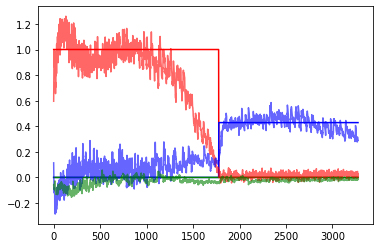

 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 1984/3000 [12:02:46<5:47:10, 20.50s/it]

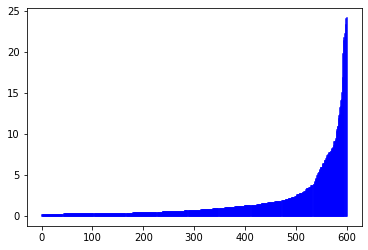

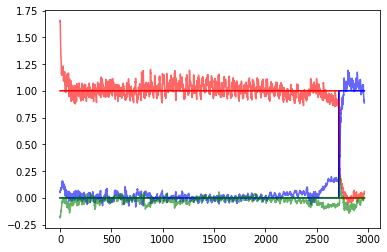

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 1989/3000 [12:04:35<5:56:27, 21.15s/it]

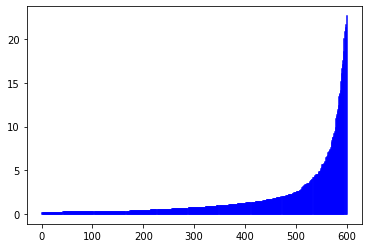

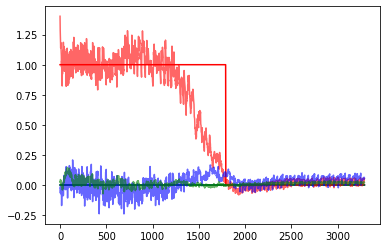

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 1994/3000 [12:06:20<5:46:07, 20.64s/it]

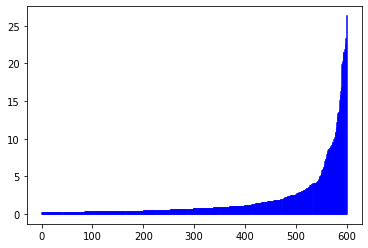

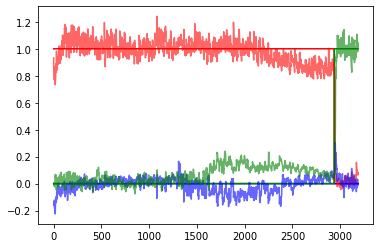

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 1999/3000 [12:08:02<5:32:45, 19.95s/it]

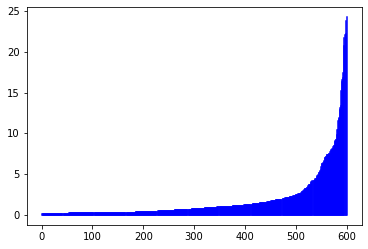

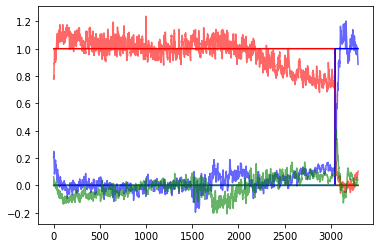

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 2004/3000 [12:10:36<6:36:13, 23.87s/it]

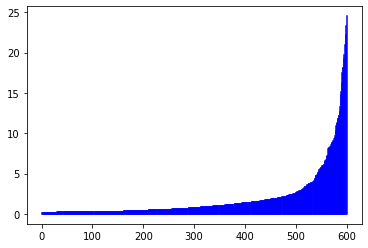

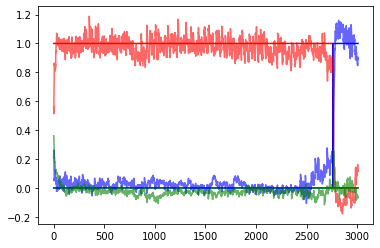

 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 2009/3000 [12:12:17<5:28:34, 19.89s/it]

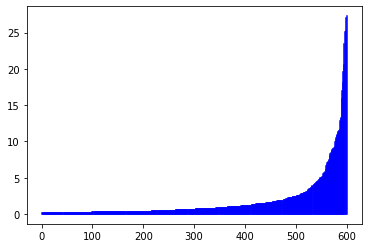

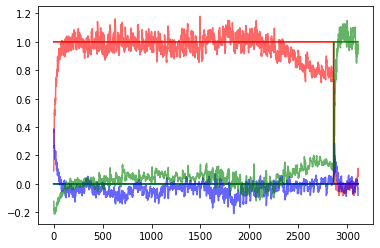

 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 2014/3000 [12:13:59<5:25:48, 19.83s/it]

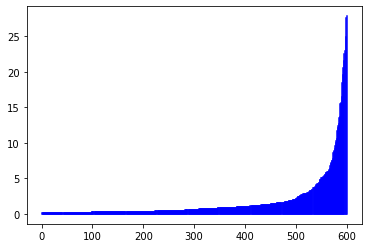

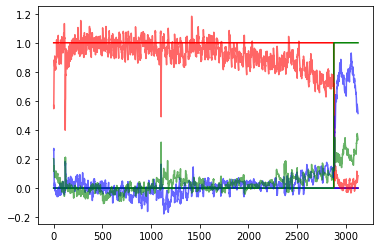

 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 2019/3000 [12:15:42<5:20:00, 19.57s/it]

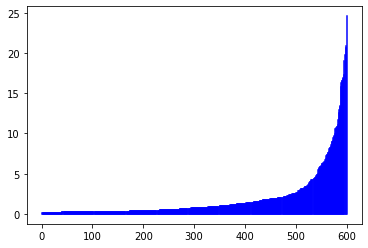

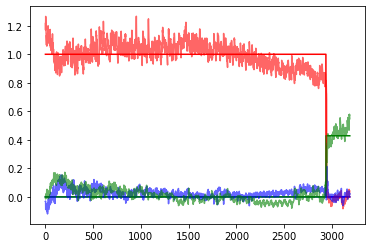

 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 2024/3000 [12:17:27<5:29:31, 20.26s/it]

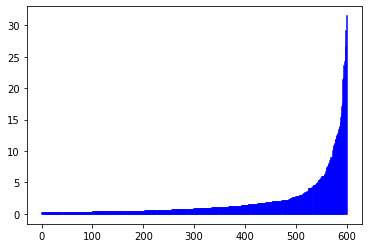

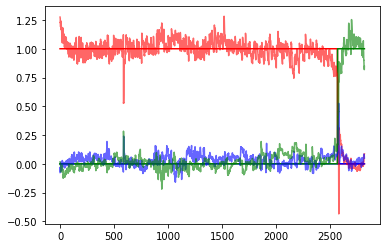

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 2029/3000 [12:19:12<5:29:31, 20.36s/it]

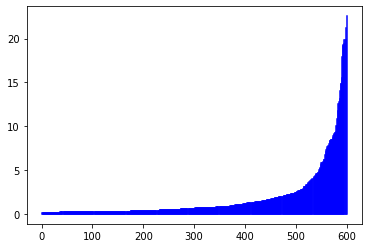

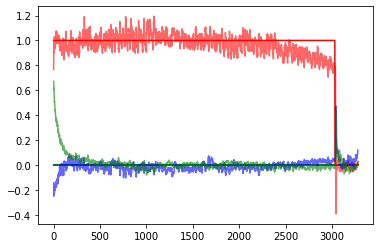

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 2034/3000 [12:20:55<5:16:15, 19.64s/it]

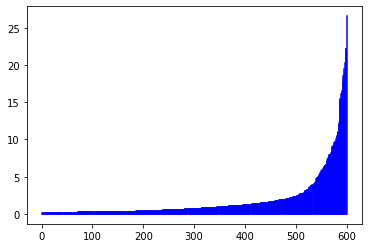

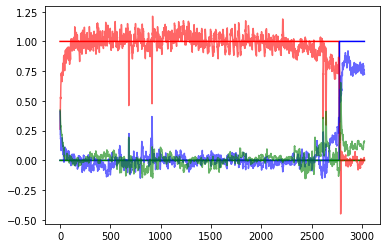

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 2039/3000 [12:22:36<5:13:10, 19.55s/it]

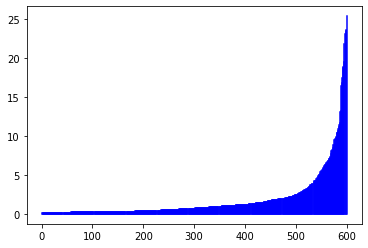

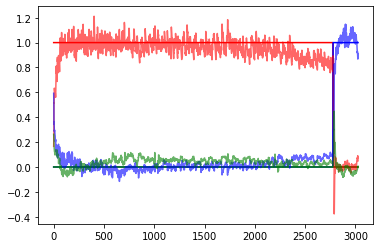

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 2044/3000 [12:24:18<5:13:44, 19.69s/it]

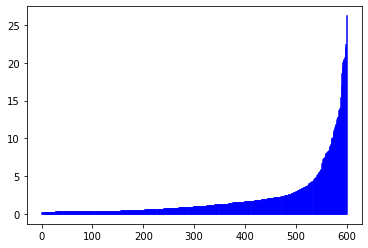

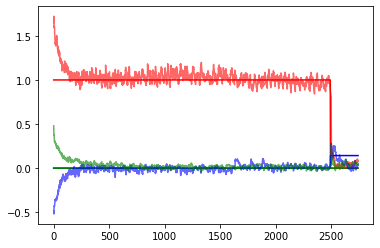

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 2049/3000 [12:26:00<5:06:38, 19.35s/it]

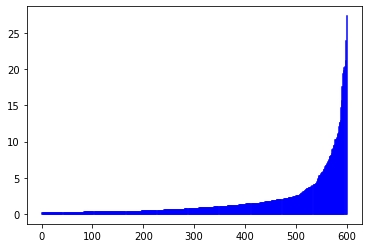

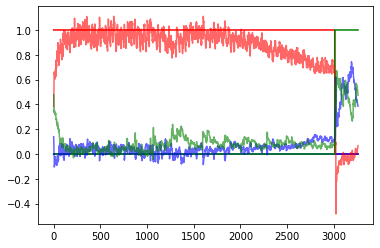

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 2054/3000 [12:28:39<6:25:33, 24.45s/it]

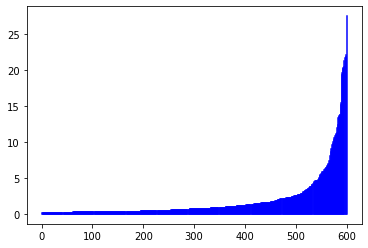

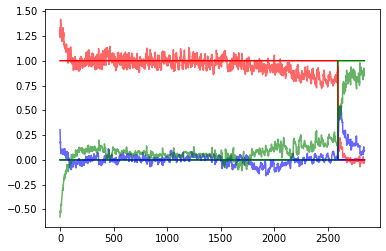

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 2059/3000 [12:30:25<5:35:35, 21.40s/it]

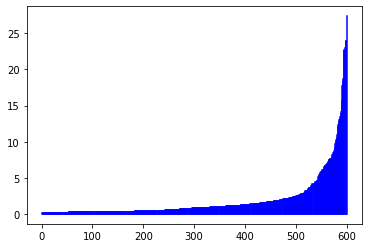

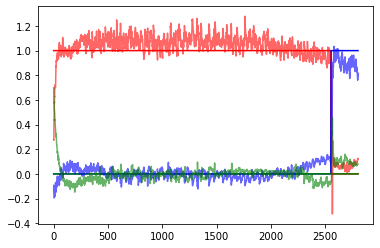

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 2064/3000 [12:32:10<5:18:14, 20.40s/it]

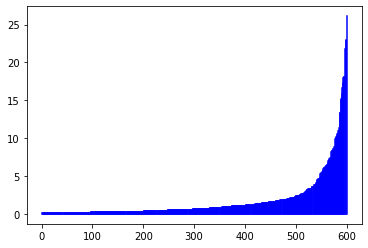

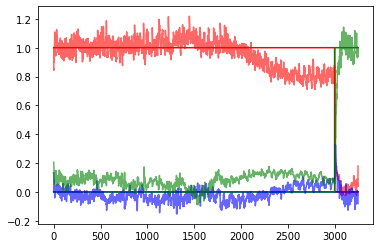

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 2069/3000 [12:33:57<5:19:10, 20.57s/it]

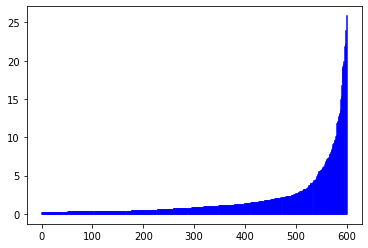

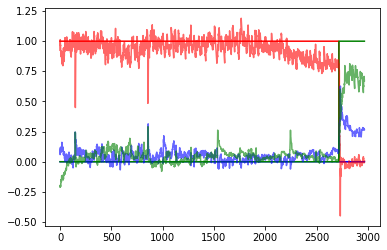

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 2074/3000 [12:35:43<5:17:05, 20.55s/it]

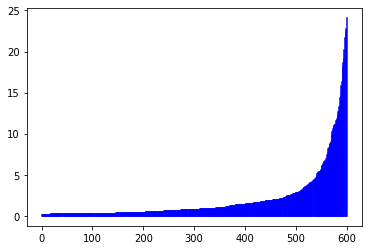

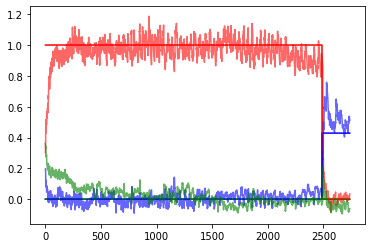

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 2079/3000 [12:37:23<5:02:32, 19.71s/it]

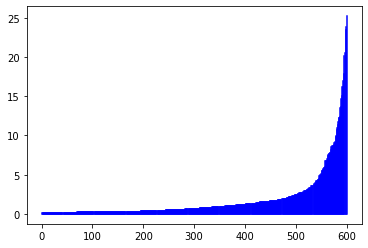

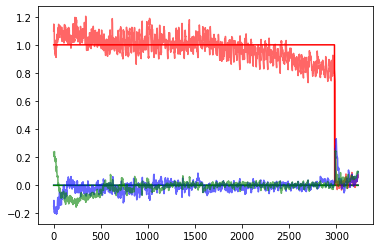

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 2084/3000 [12:39:07<5:03:20, 19.87s/it]

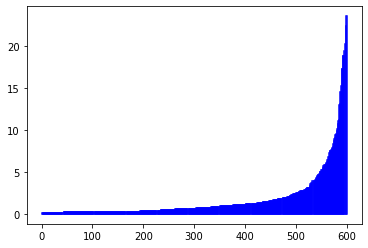

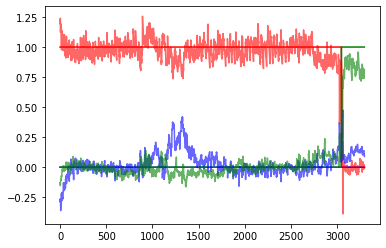

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 2089/3000 [12:40:50<5:04:53, 20.08s/it]

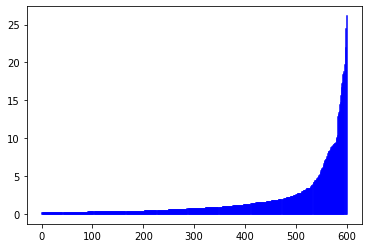

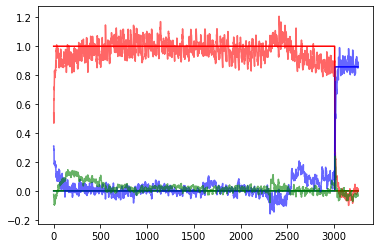

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 2094/3000 [12:42:35<5:04:27, 20.16s/it]

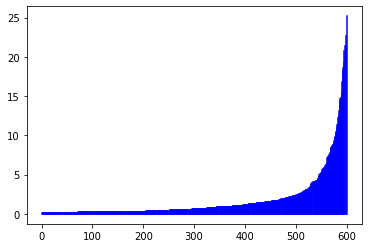

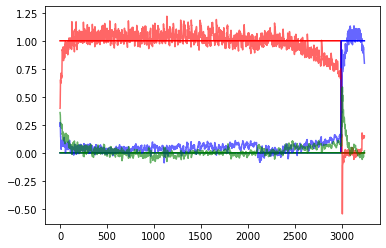

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 2099/3000 [12:44:18<4:58:10, 19.86s/it]

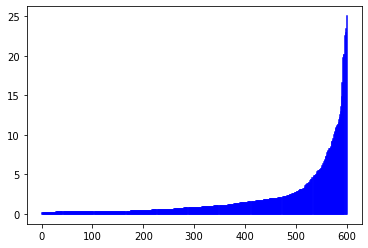

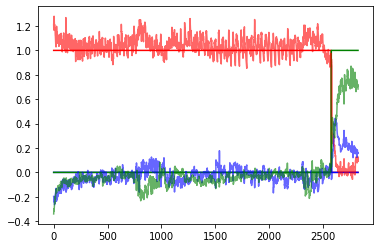

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 2104/3000 [12:46:53<6:02:16, 24.26s/it]

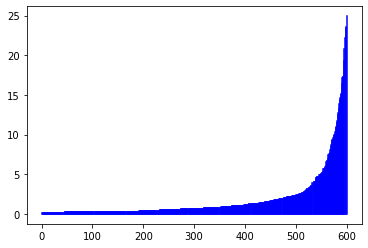

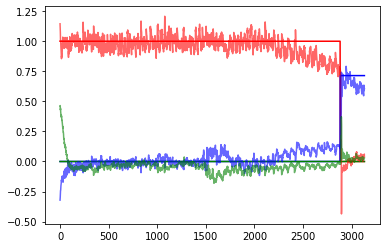

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 2109/3000 [12:48:41<5:14:36, 21.19s/it]

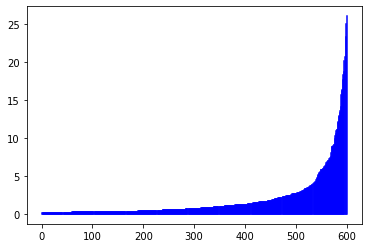

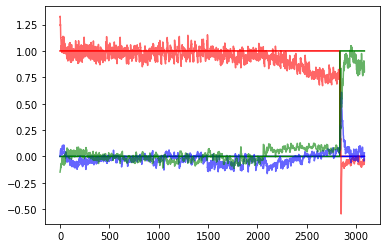

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 2114/3000 [12:50:22<4:52:28, 19.81s/it]

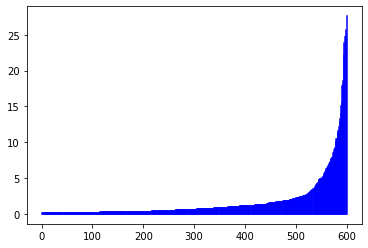

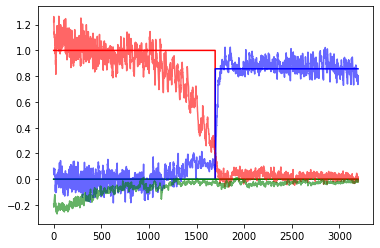

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 2119/3000 [12:52:06<4:56:03, 20.16s/it]

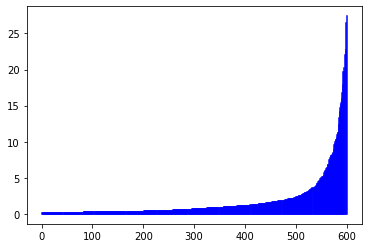

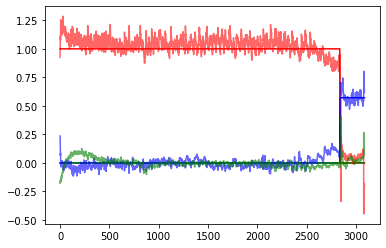

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 2124/3000 [12:53:49<4:45:08, 19.53s/it]

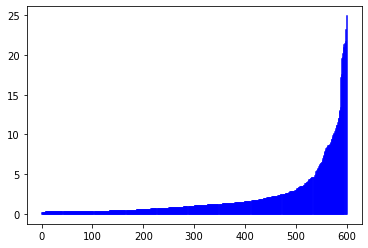

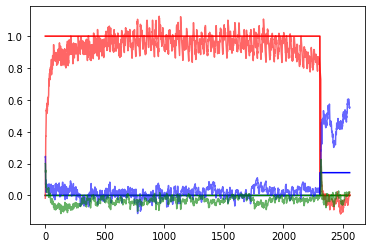

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 2129/3000 [12:55:32<4:46:59, 19.77s/it]

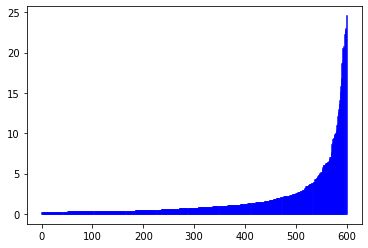

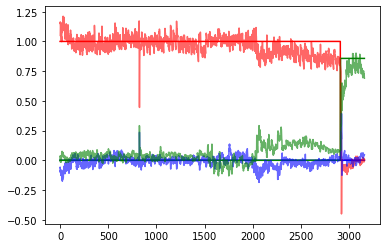

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 2134/3000 [12:57:17<4:50:25, 20.12s/it]

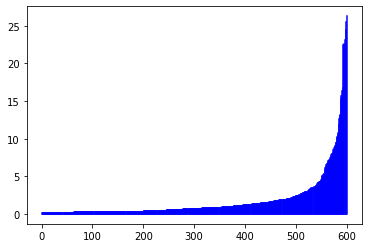

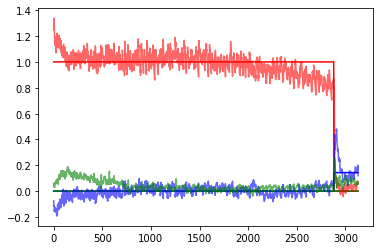

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 2139/3000 [12:59:03<4:52:57, 20.42s/it]

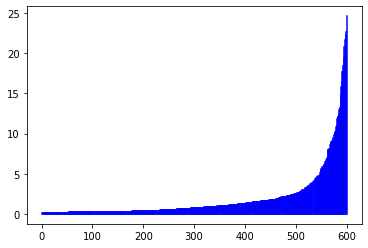

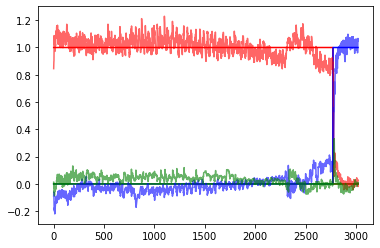

 71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 2144/3000 [13:00:48<4:49:04, 20.26s/it]

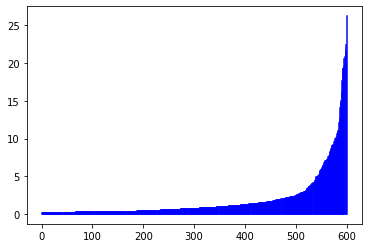

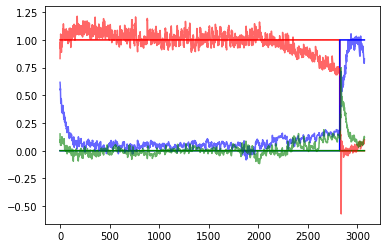

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 2149/3000 [13:02:35<4:53:22, 20.68s/it]

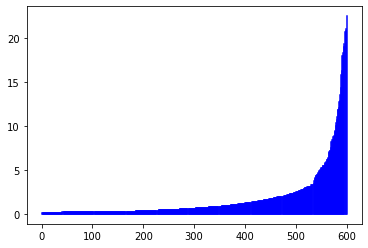

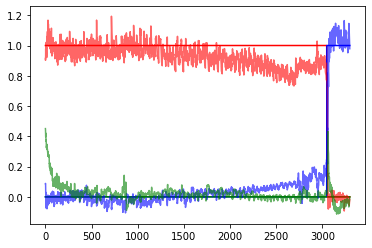

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 2154/3000 [13:05:06<5:27:54, 23.26s/it]

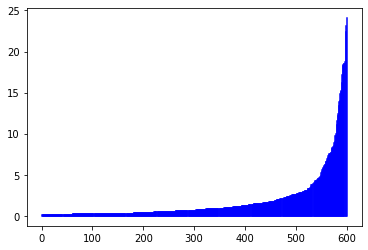

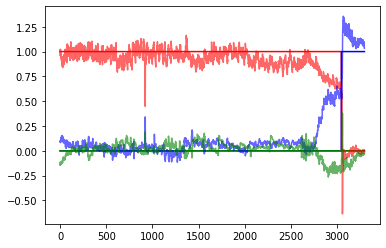

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 2159/3000 [13:06:53<5:01:29, 21.51s/it]

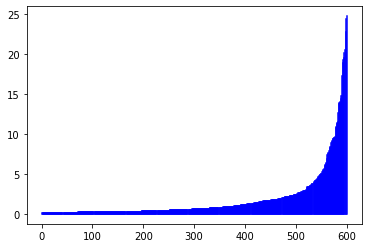

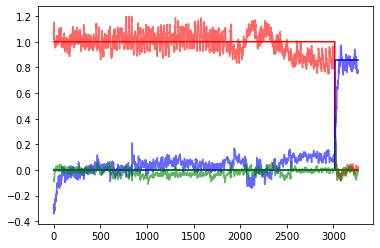

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 2164/3000 [13:08:38<4:45:48, 20.51s/it]

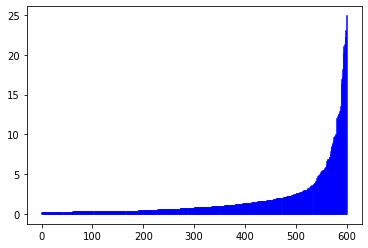

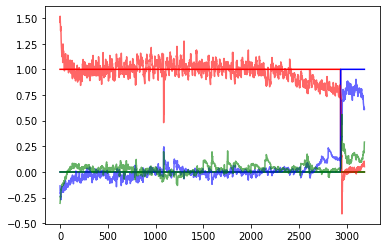

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 2169/3000 [13:10:19<4:28:02, 19.35s/it]

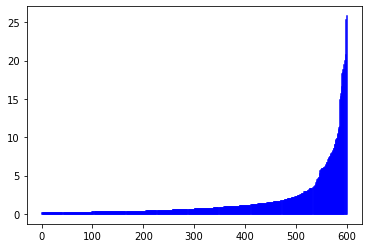

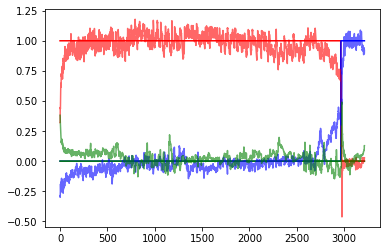

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 2174/3000 [13:12:07<4:44:07, 20.64s/it]

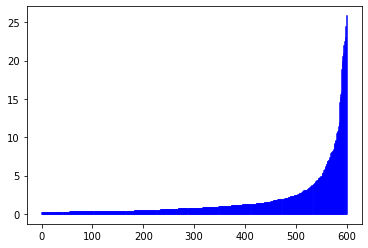

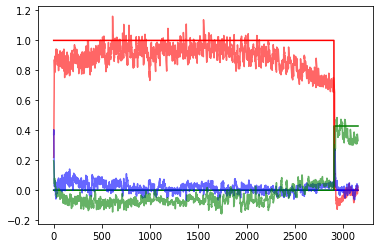

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 2179/3000 [13:13:51<4:36:24, 20.20s/it]

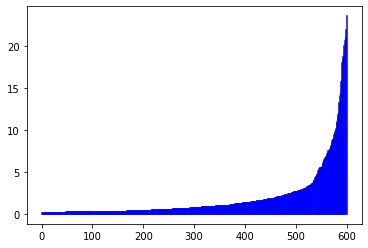

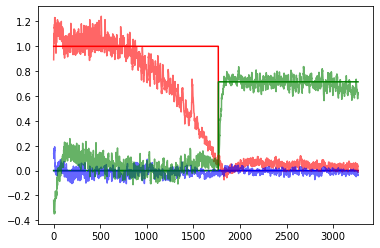

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 2184/3000 [13:15:35<4:32:32, 20.04s/it]

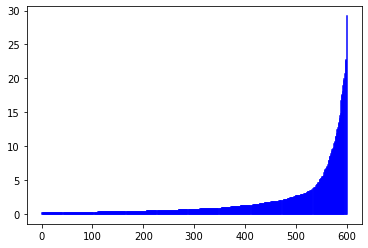

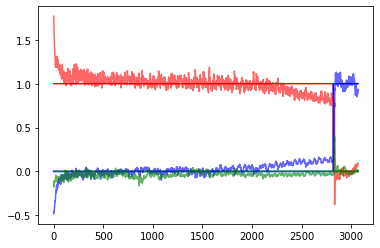

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 2189/3000 [13:17:18<4:28:24, 19.86s/it]

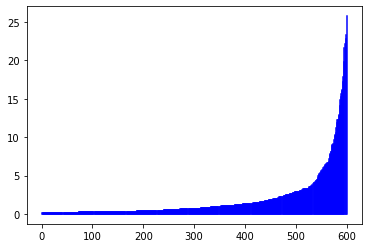

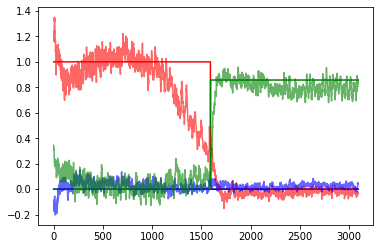

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 2194/3000 [13:19:00<4:23:06, 19.59s/it]

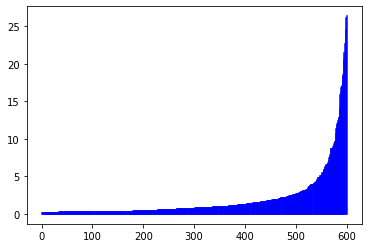

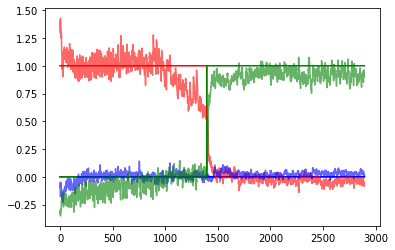

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 2199/3000 [13:20:43<4:28:37, 20.12s/it]

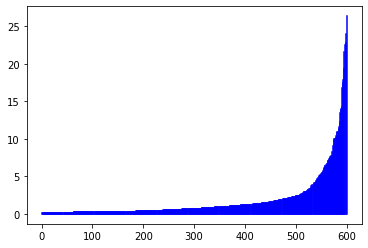

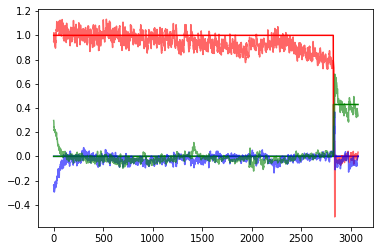

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 2204/3000 [13:23:10<5:04:21, 22.94s/it]

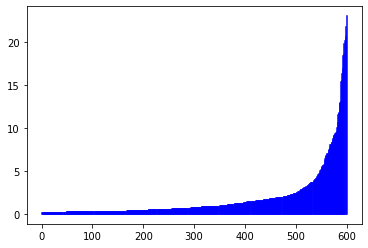

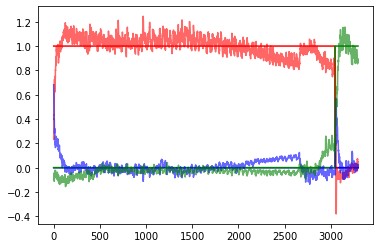

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 2209/3000 [13:24:54<4:31:11, 20.57s/it]

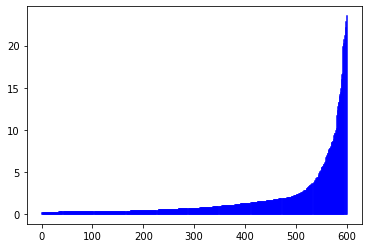

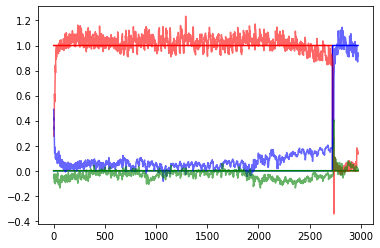

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 2214/3000 [13:26:40<4:28:58, 20.53s/it]

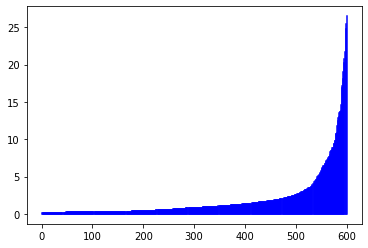

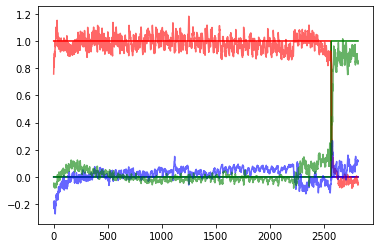

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 2219/3000 [13:28:25<4:26:08, 20.45s/it]

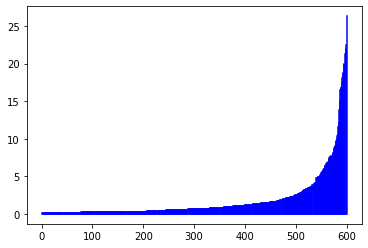

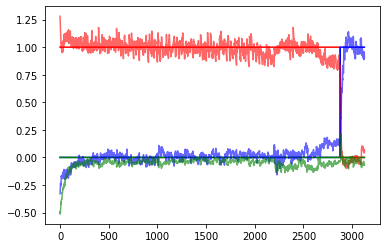

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 2224/3000 [13:30:09<4:17:57, 19.95s/it]

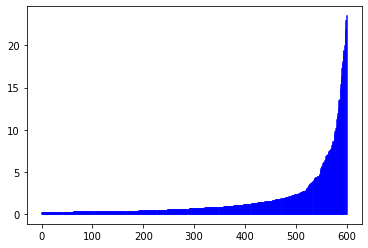

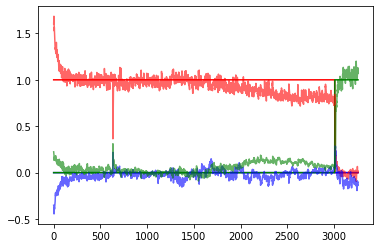

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 2229/3000 [13:31:51<4:15:17, 19.87s/it]

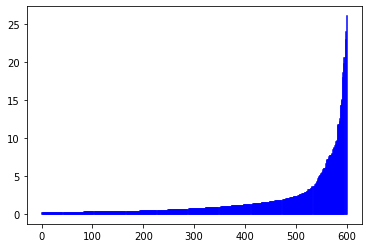

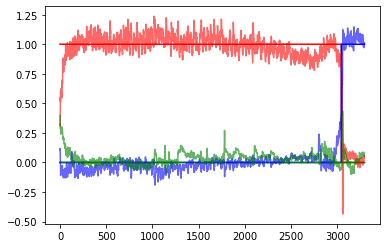

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 2234/3000 [13:33:38<4:18:36, 20.26s/it]

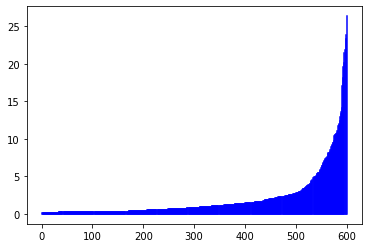

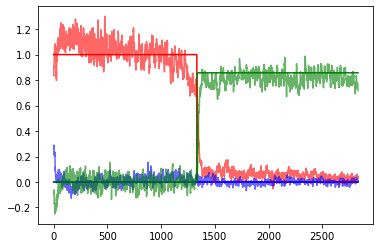

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 2239/3000 [13:35:22<4:15:59, 20.18s/it]

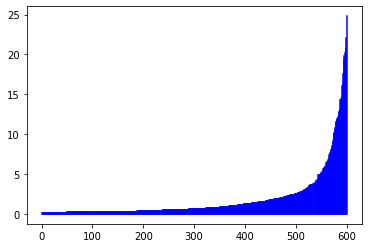

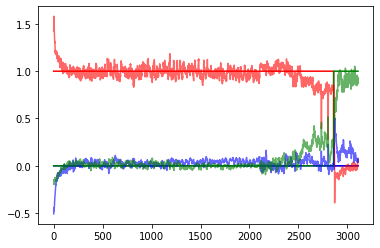

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 2244/3000 [13:37:05<4:12:34, 20.05s/it]

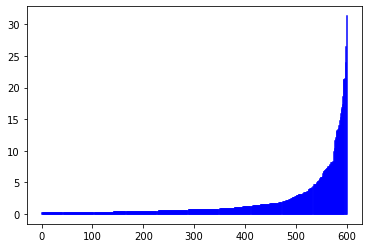

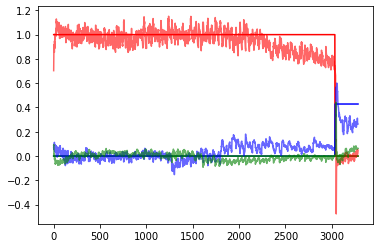

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 2249/3000 [13:38:53<4:18:07, 20.62s/it]

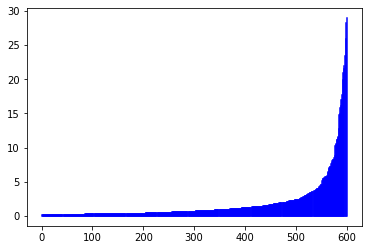

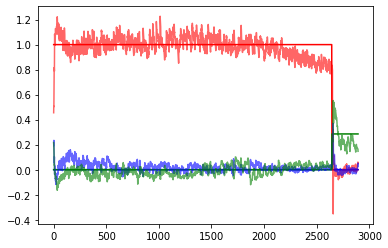

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 2254/3000 [13:41:28<4:58:11, 23.98s/it]

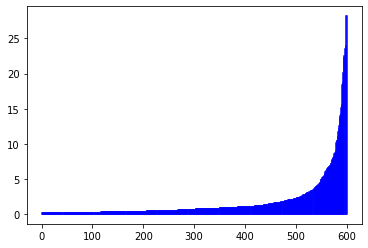

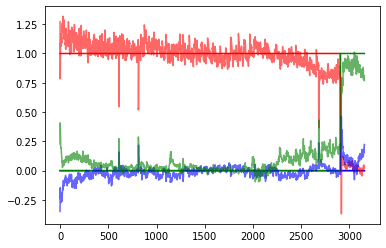

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 2259/3000 [13:43:15<4:22:58, 21.29s/it]

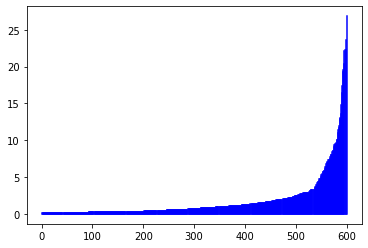

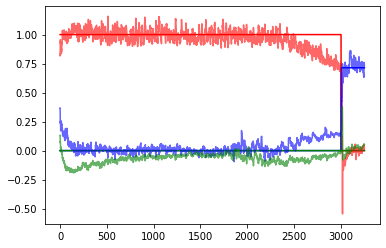

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 2264/3000 [13:44:59<4:10:23, 20.41s/it]

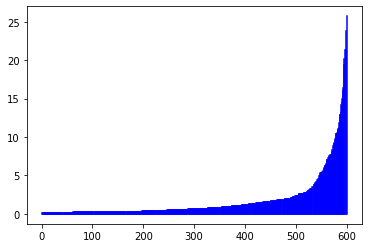

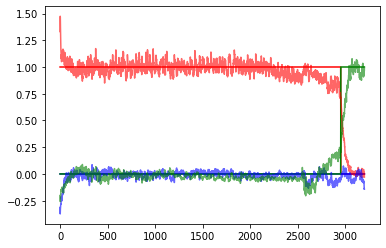

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 2269/3000 [13:46:42<4:02:26, 19.90s/it]

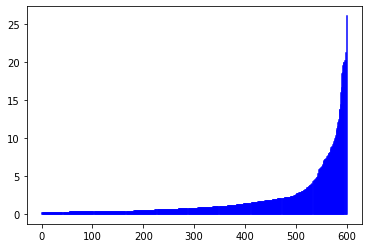

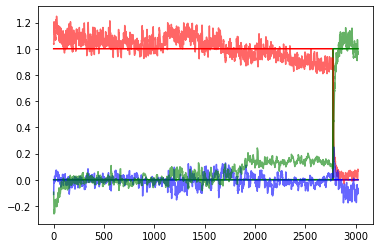

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 2274/3000 [13:48:28<4:06:17, 20.35s/it]

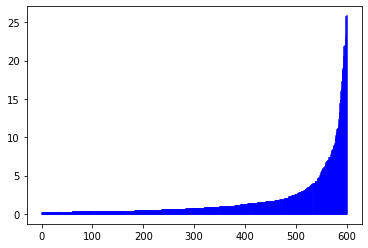

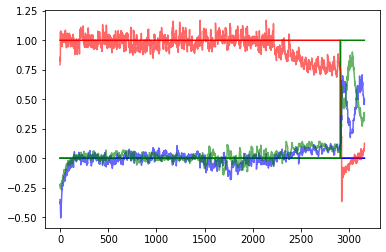

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 2279/3000 [13:50:15<4:04:51, 20.38s/it]

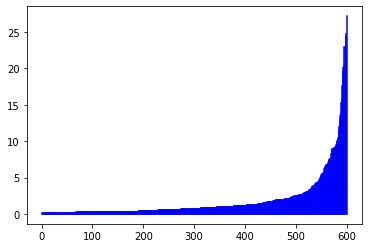

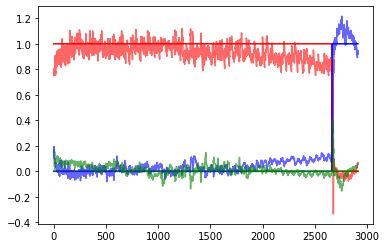

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 2284/3000 [13:52:01<4:06:32, 20.66s/it]

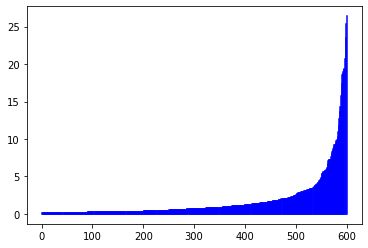

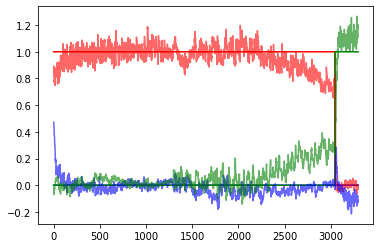

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 2289/3000 [13:53:44<3:55:00, 19.83s/it]

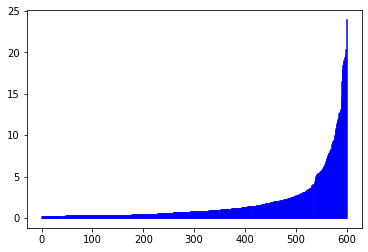

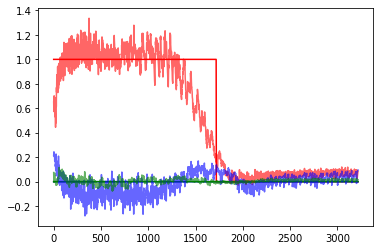

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 2294/3000 [13:55:30<3:57:56, 20.22s/it]

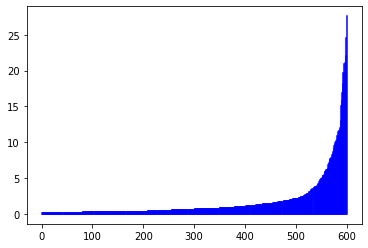

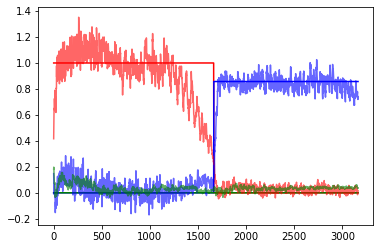

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 2299/3000 [13:57:15<3:58:02, 20.38s/it]

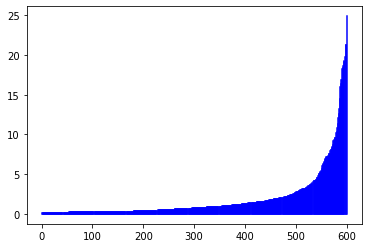

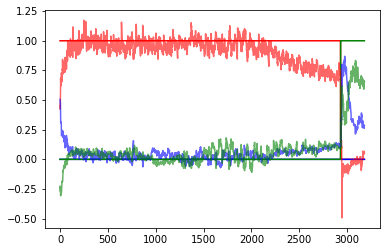

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 2304/3000 [13:59:52<4:39:39, 24.11s/it]

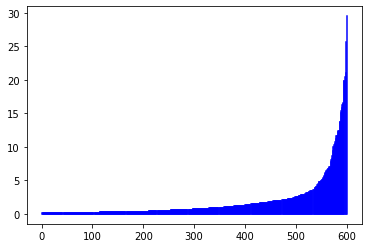

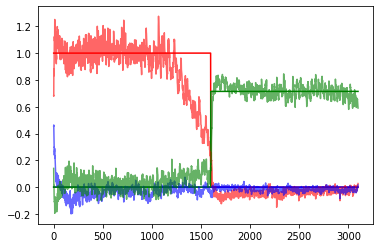

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 2309/3000 [14:01:34<3:53:23, 20.27s/it]

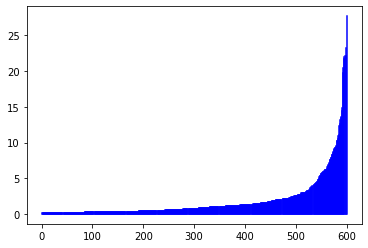

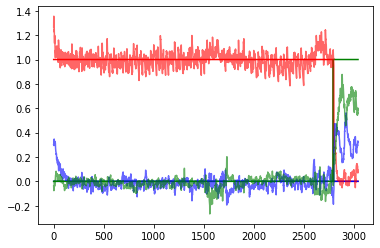

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 2314/3000 [14:03:14<3:43:10, 19.52s/it]

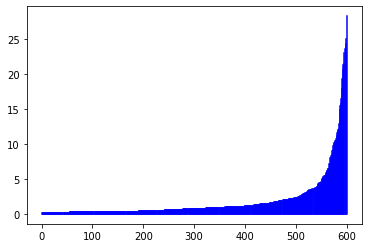

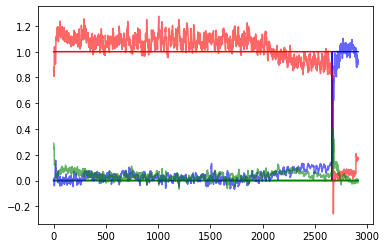

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 2319/3000 [14:04:58<3:46:29, 19.95s/it]

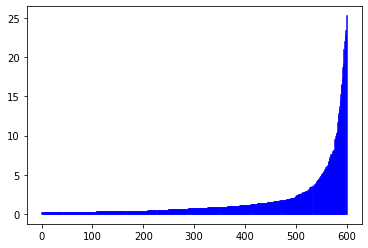

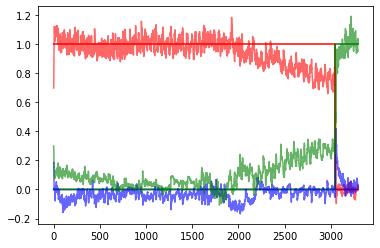

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 2324/3000 [14:06:46<3:55:01, 20.86s/it]

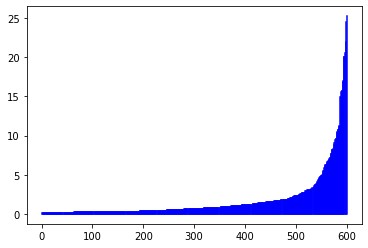

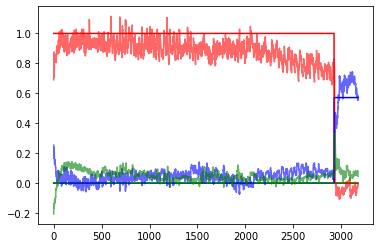

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 2329/3000 [14:08:28<3:44:06, 20.04s/it]

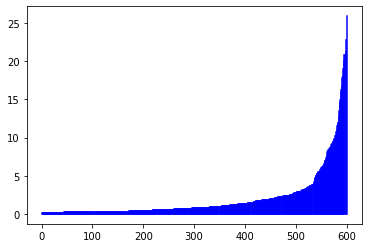

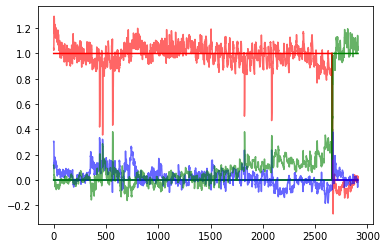

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 2334/3000 [14:10:15<3:47:10, 20.47s/it]

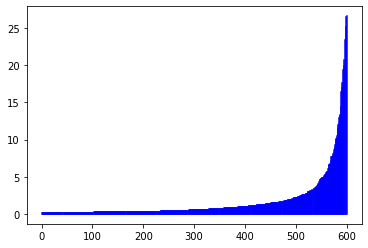

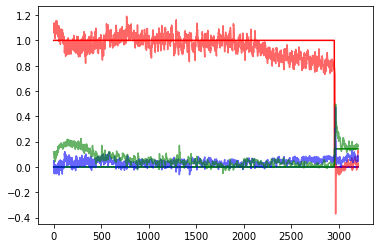

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 2339/3000 [14:11:56<3:38:07, 19.80s/it]

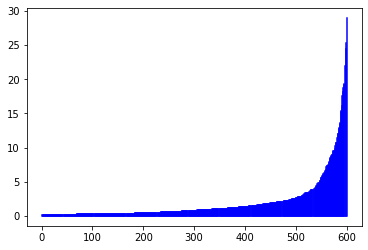

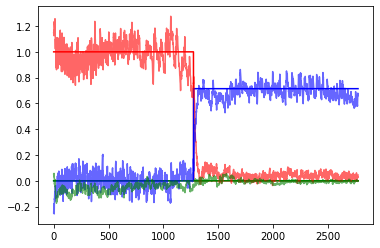

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 2344/3000 [14:13:37<3:34:18, 19.60s/it]

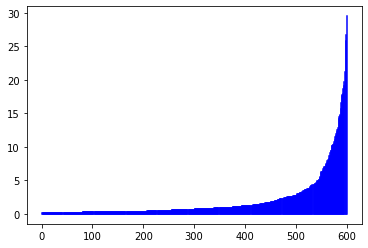

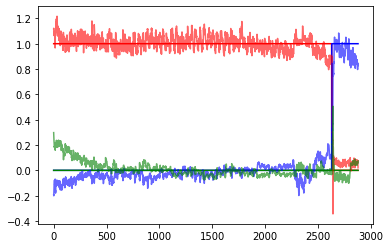

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 2349/3000 [14:15:22<3:36:33, 19.96s/it]

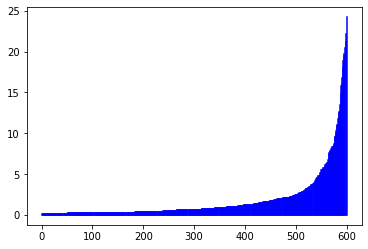

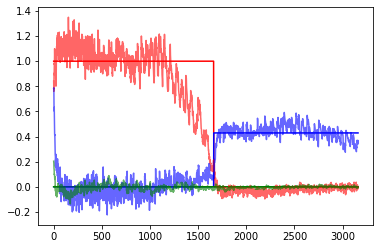

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 2354/3000 [14:17:50<4:05:40, 22.82s/it]

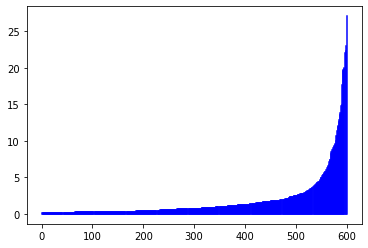

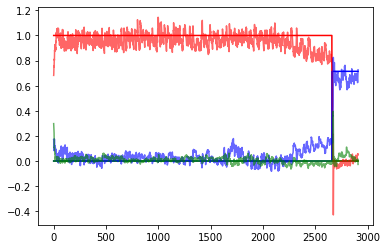

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 2359/3000 [14:19:35<3:39:26, 20.54s/it]

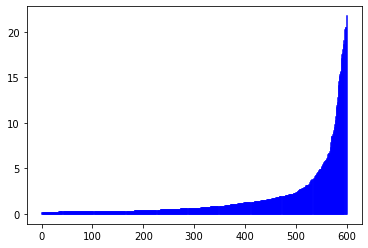

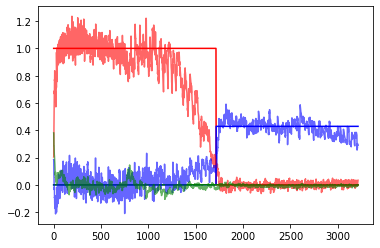

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 2364/3000 [14:21:20<3:37:03, 20.48s/it]

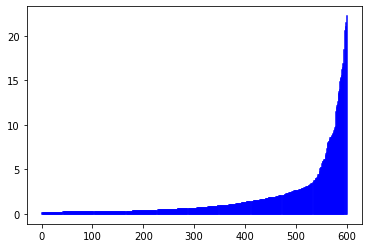

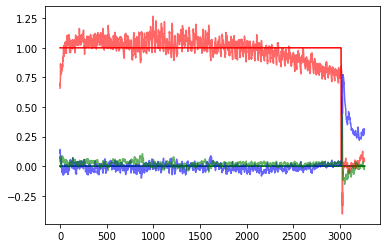

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 2369/3000 [14:23:04<3:34:06, 20.36s/it]

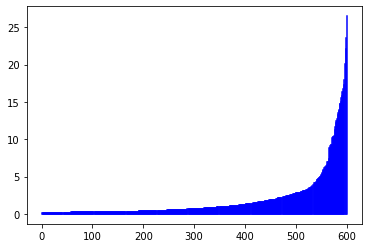

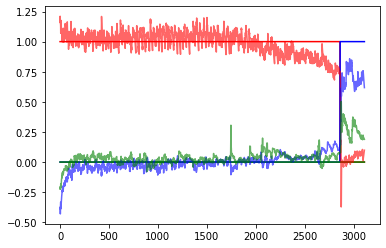

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 2374/3000 [14:24:48<3:30:09, 20.14s/it]

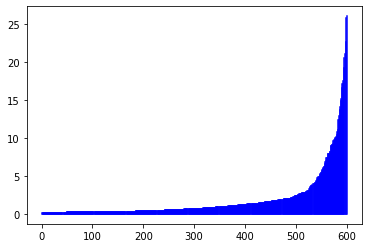

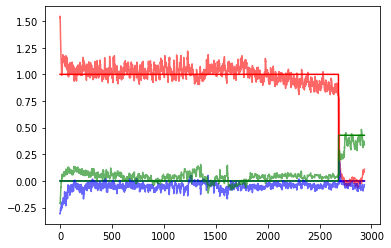

 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 2379/3000 [14:26:33<3:29:45, 20.27s/it]

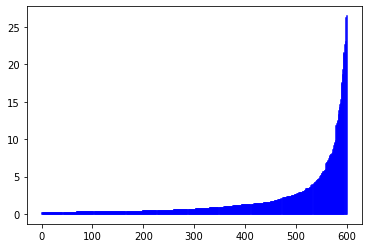

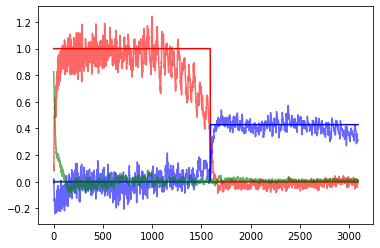

 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 2384/3000 [14:28:18<3:24:37, 19.93s/it]

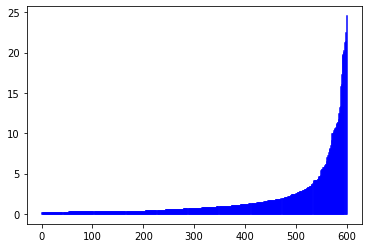

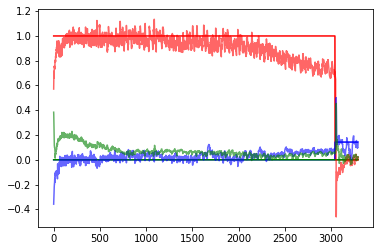

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 2389/3000 [14:30:02<3:25:37, 20.19s/it]

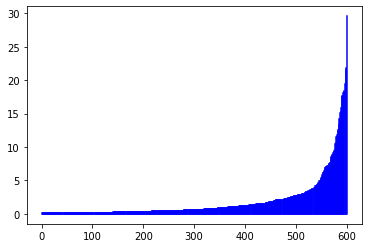

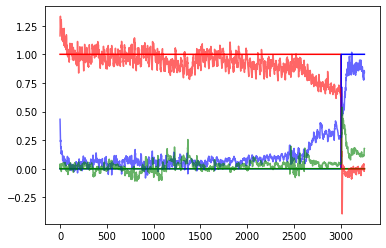

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 2394/3000 [14:31:46<3:23:14, 20.12s/it]

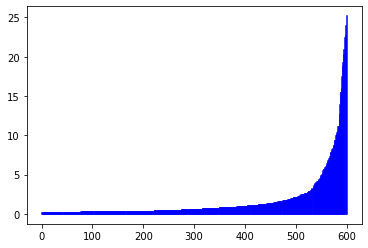

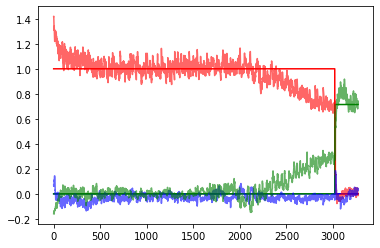

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 2399/3000 [14:33:34<3:28:50, 20.85s/it]

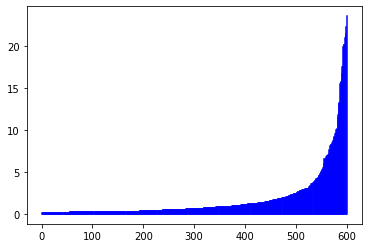

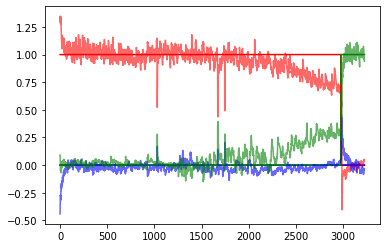

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 2404/3000 [14:36:08<3:56:05, 23.77s/it]

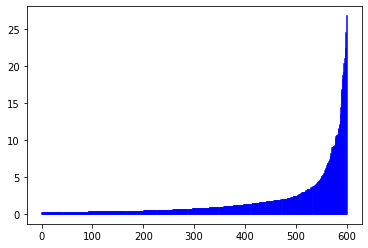

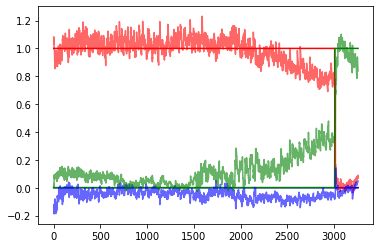

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 2409/3000 [14:38:00<3:33:16, 21.65s/it]

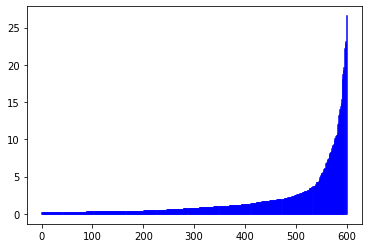

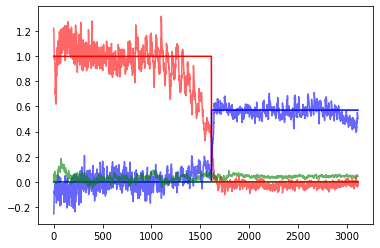

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 2414/3000 [14:39:44<3:21:35, 20.64s/it]

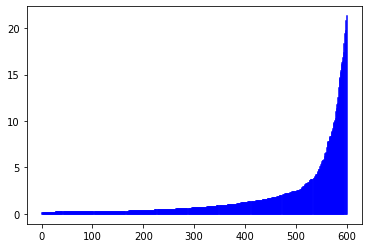

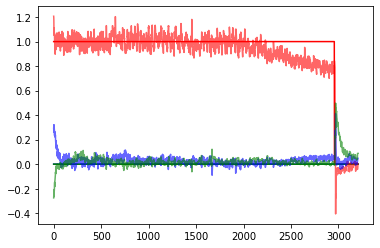

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 2419/3000 [14:41:30<3:16:27, 20.29s/it]

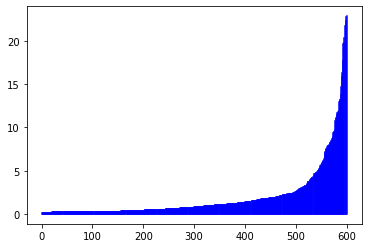

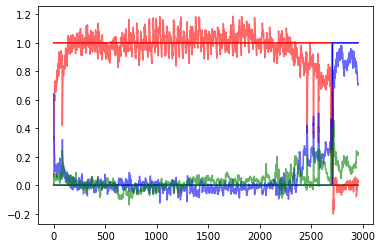

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 2424/3000 [14:43:13<3:10:46, 19.87s/it]

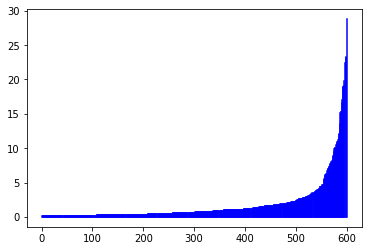

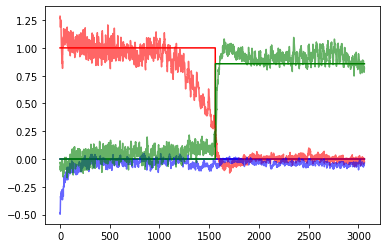

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 2429/3000 [14:44:57<3:13:48, 20.36s/it]

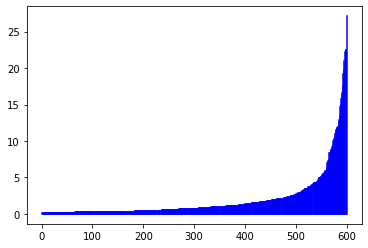

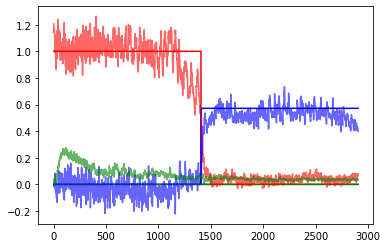

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 2434/3000 [14:46:37<3:01:38, 19.26s/it]

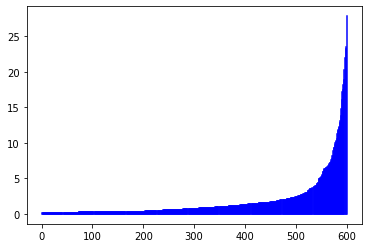

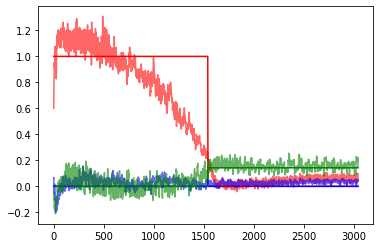

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 2439/3000 [14:48:19<3:02:36, 19.53s/it]

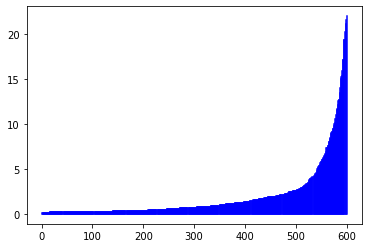

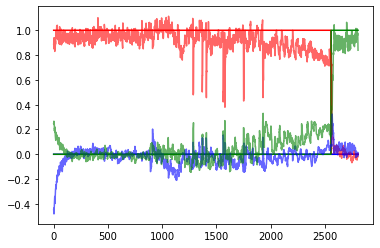

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 2444/3000 [14:50:00<3:00:51, 19.52s/it]

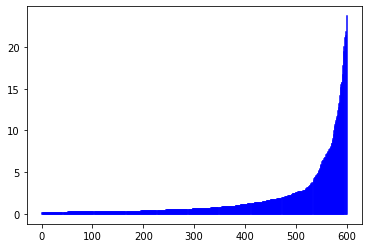

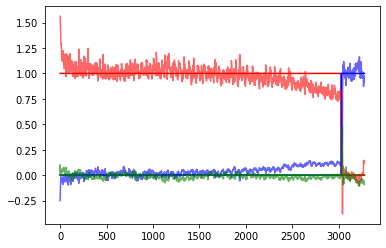

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 2449/3000 [14:51:48<3:10:15, 20.72s/it]

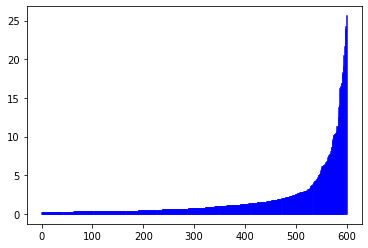

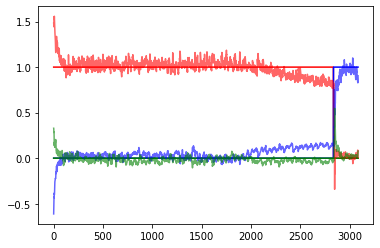

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 2454/3000 [14:54:22<3:36:57, 23.84s/it]

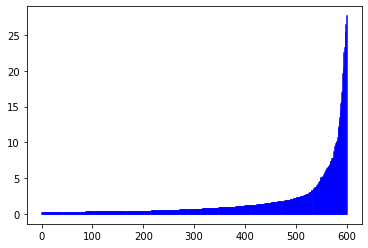

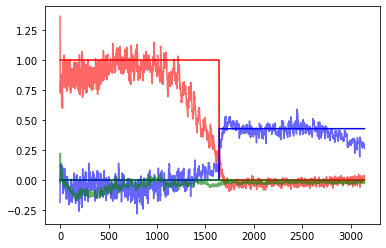

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 2459/3000 [14:56:07<3:08:37, 20.92s/it]

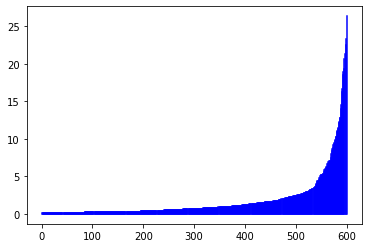

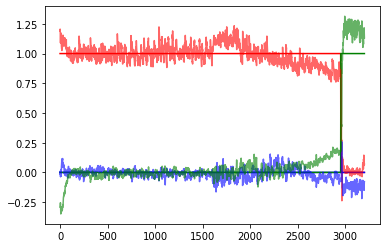

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 2464/3000 [14:57:57<3:07:38, 21.01s/it]

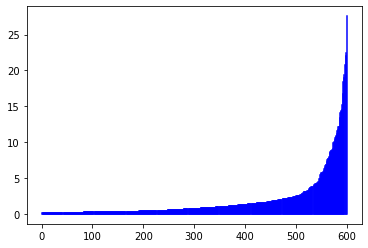

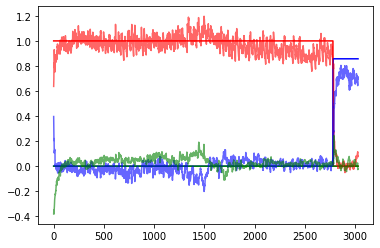

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 2469/3000 [14:59:43<3:03:13, 20.70s/it]

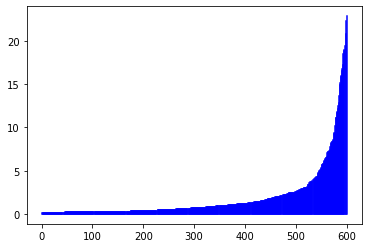

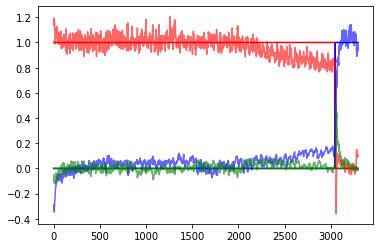

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 2474/3000 [15:01:29<3:00:34, 20.60s/it]

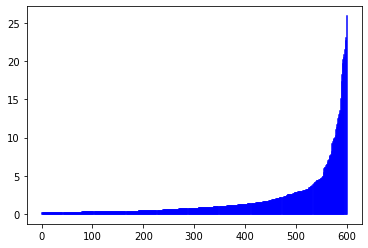

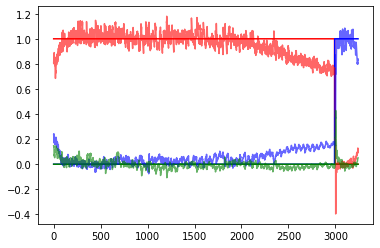

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 2479/3000 [15:03:16<2:57:41, 20.46s/it]

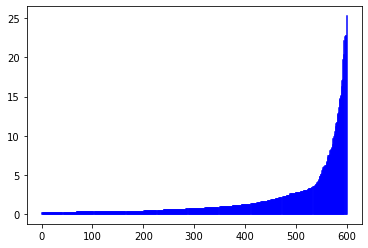

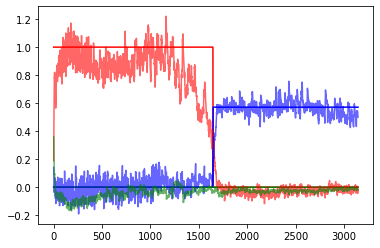

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 2484/3000 [15:05:03<2:58:26, 20.75s/it]

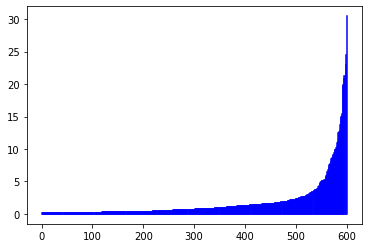

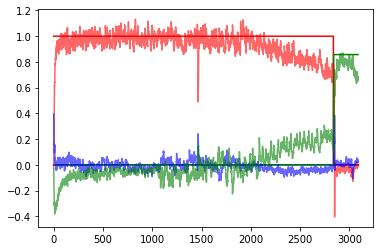

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 2489/3000 [15:06:50<2:57:13, 20.81s/it]

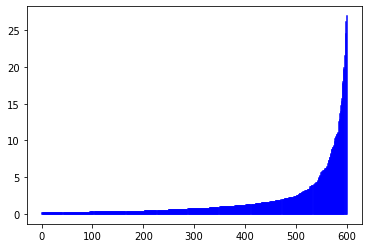

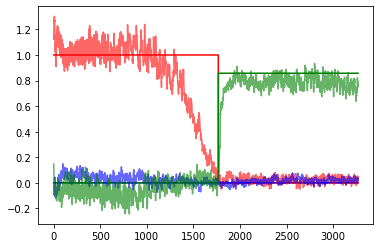

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 2494/3000 [15:08:43<3:04:50, 21.92s/it]

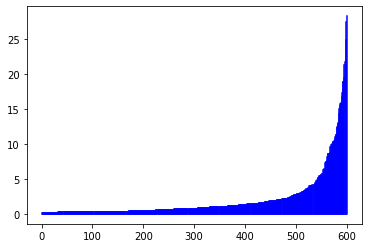

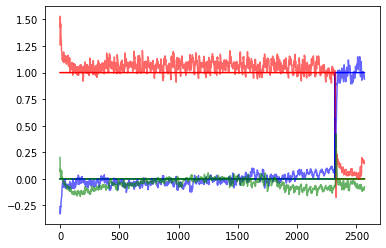

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 2499/3000 [15:10:22<2:39:51, 19.14s/it]

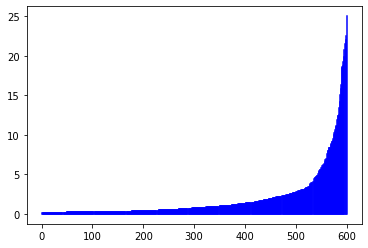

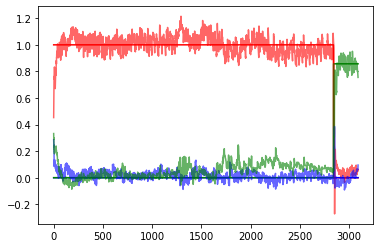

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 2504/3000 [15:12:56<3:12:59, 23.35s/it]

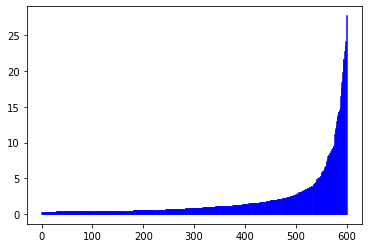

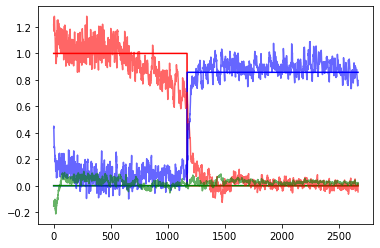

 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 2509/3000 [15:14:40<2:48:52, 20.64s/it]

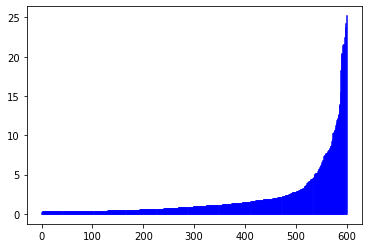

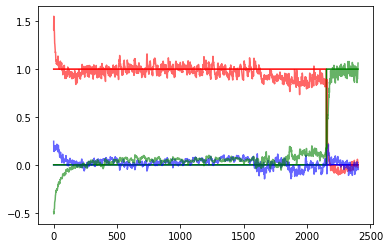

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 2514/3000 [15:16:23<2:41:54, 19.99s/it]

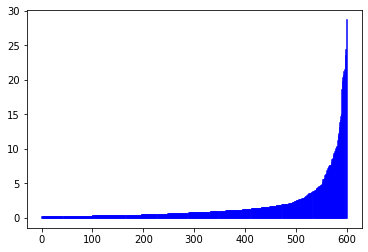

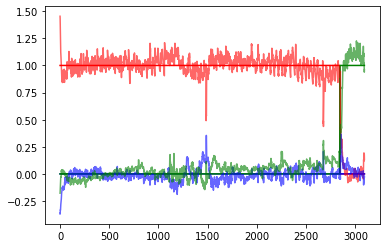

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 2519/3000 [15:18:04<2:32:47, 19.06s/it]

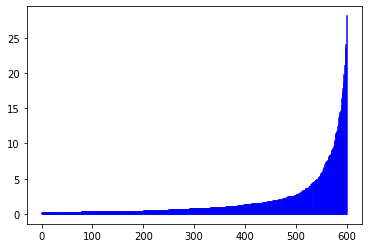

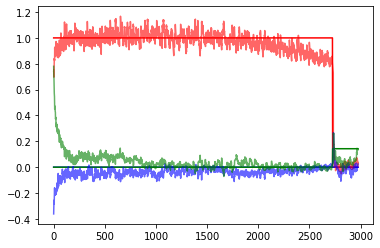

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 2524/3000 [15:19:51<2:42:07, 20.44s/it]

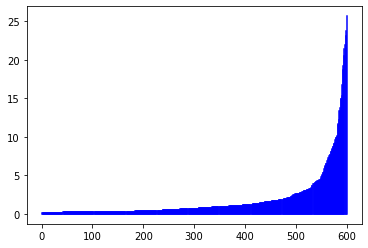

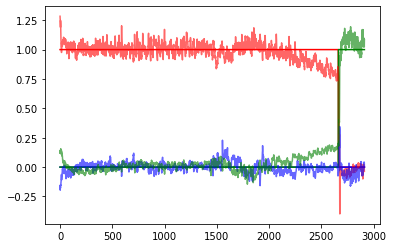

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 2529/3000 [15:21:38<2:39:46, 20.35s/it]

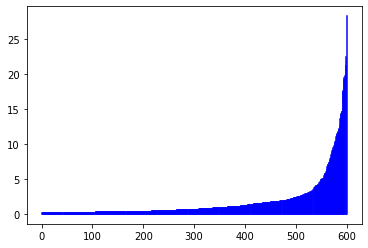

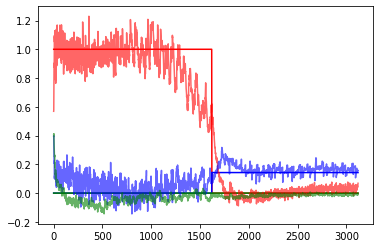

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 2534/3000 [15:23:21<2:35:43, 20.05s/it]

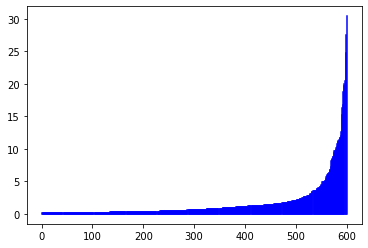

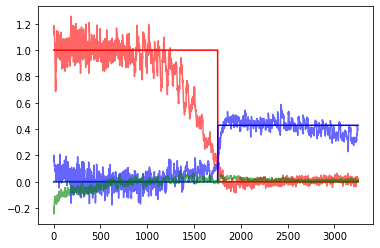

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 2539/3000 [15:25:06<2:37:10, 20.46s/it]

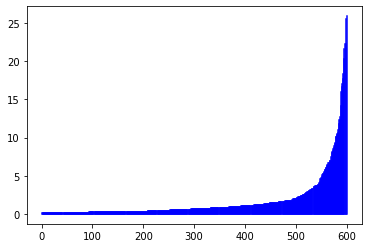

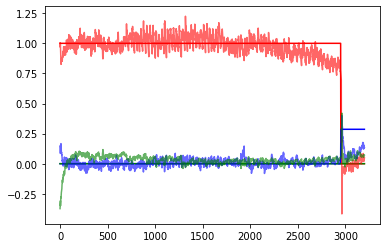

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 2544/3000 [15:26:47<2:30:37, 19.82s/it]

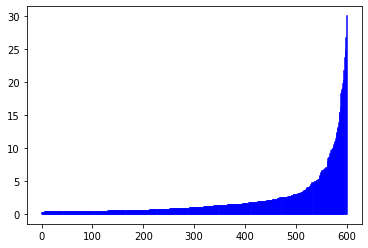

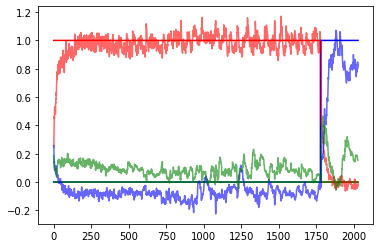

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 2549/3000 [15:28:35<2:38:05, 21.03s/it]

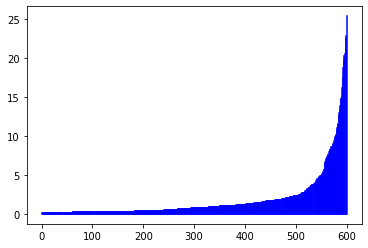

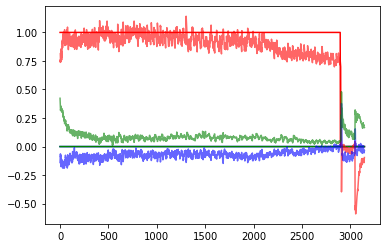

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 2554/3000 [15:31:07<2:53:50, 23.39s/it]

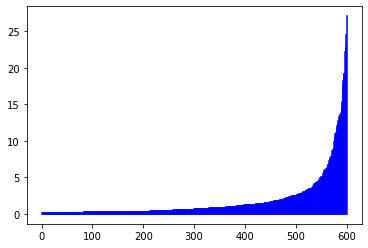

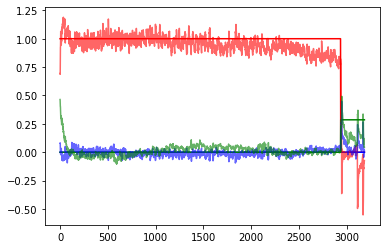

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 2559/3000 [15:32:48<2:28:19, 20.18s/it]

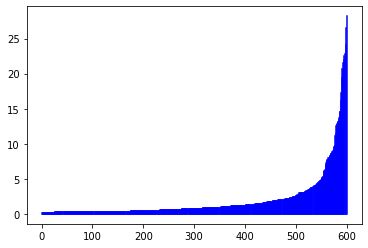

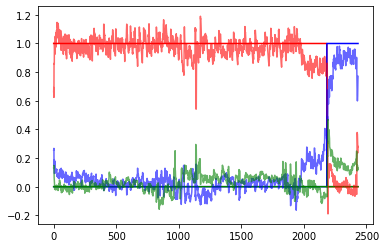

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 2564/3000 [15:34:25<2:17:46, 18.96s/it]

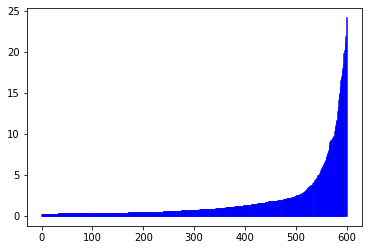

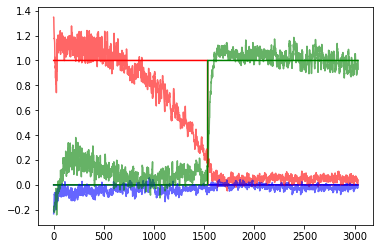

 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 2569/3000 [15:35:57<2:09:55, 18.09s/it]

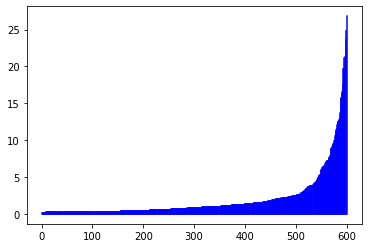

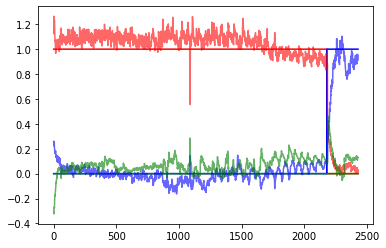

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 2574/3000 [15:37:42<2:21:59, 20.00s/it]

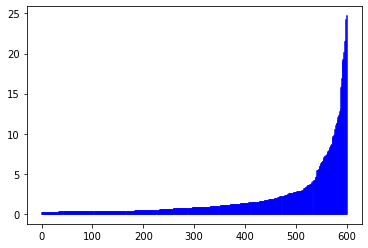

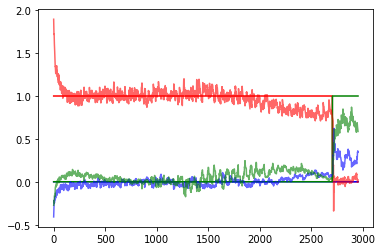

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 2579/3000 [15:39:27<2:21:02, 20.10s/it]

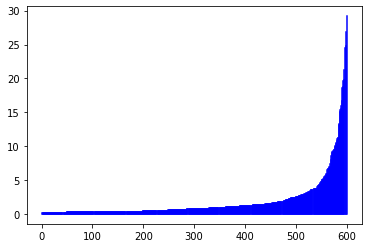

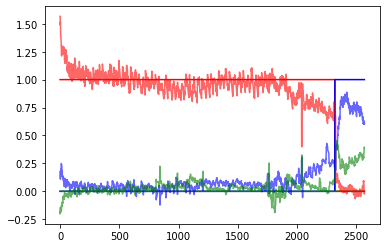

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 2584/3000 [15:41:09<2:17:54, 19.89s/it]

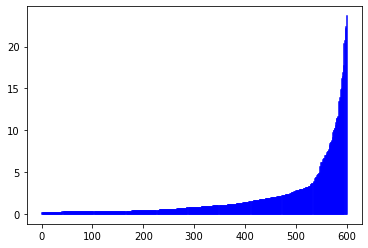

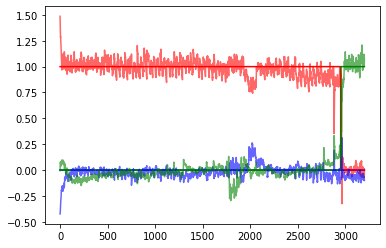

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 2589/3000 [15:42:58<2:20:25, 20.50s/it]

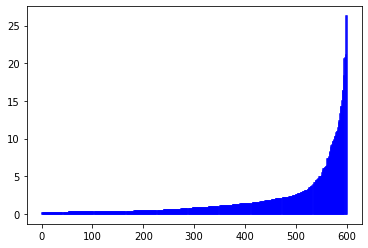

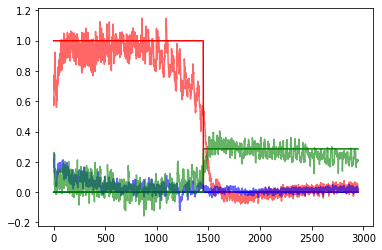

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 2594/3000 [15:44:45<2:19:24, 20.60s/it]

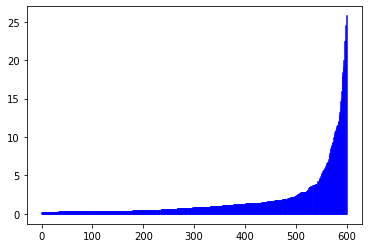

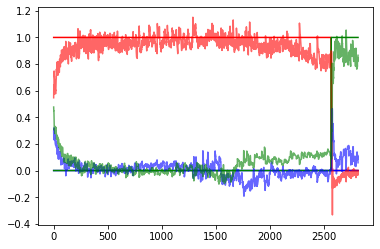

 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 2599/3000 [15:46:33<2:18:46, 20.76s/it]

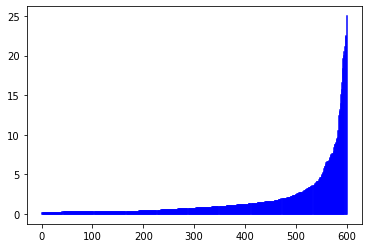

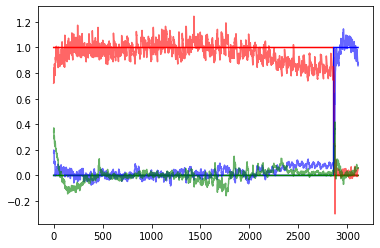

 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 2604/3000 [15:49:02<2:34:04, 23.34s/it]

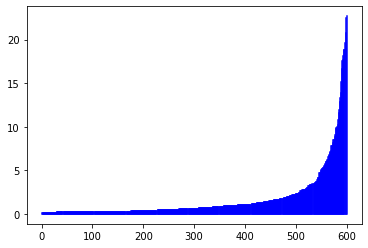

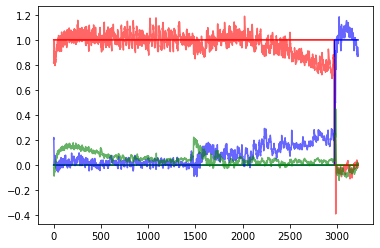

 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 2609/3000 [15:50:47<2:15:42, 20.82s/it]

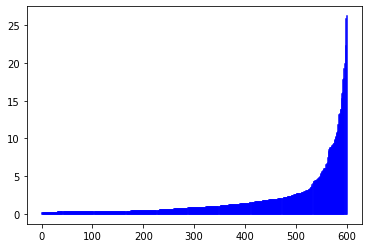

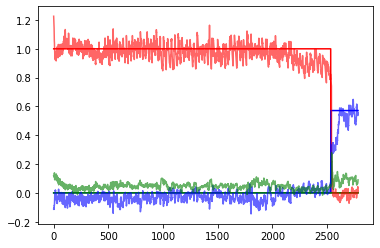

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 2614/3000 [15:52:30<2:05:23, 19.49s/it]

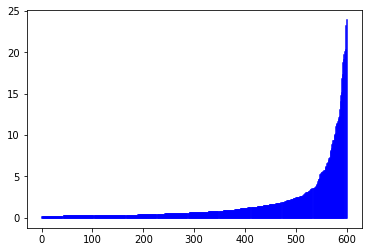

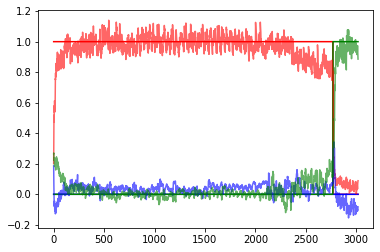

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 2619/3000 [15:54:18<2:10:27, 20.54s/it]

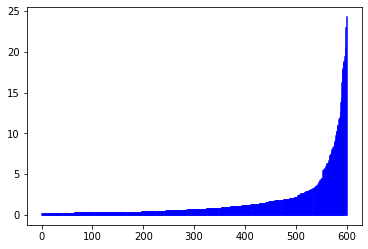

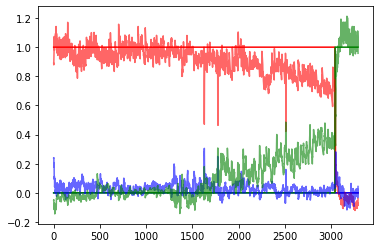

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 2624/3000 [15:56:03<2:04:47, 19.91s/it]

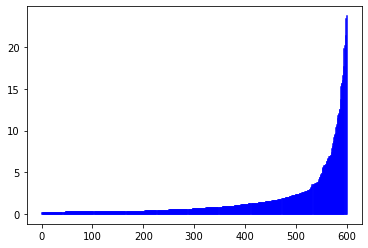

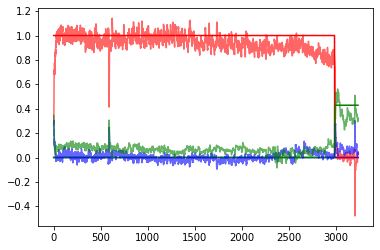

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 2629/3000 [15:57:46<2:04:38, 20.16s/it]

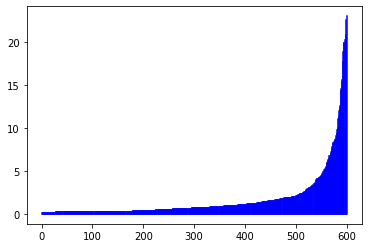

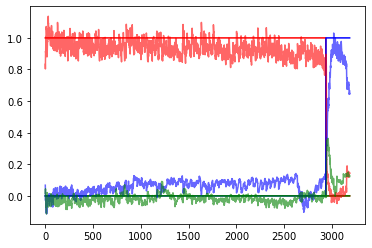

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 2634/3000 [15:59:23<1:57:03, 19.19s/it]

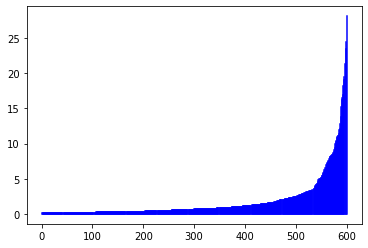

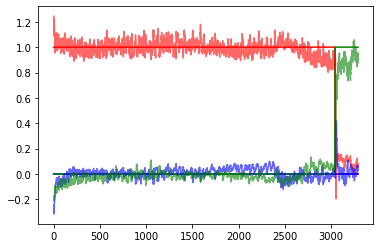

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 2639/3000 [16:01:11<2:03:42, 20.56s/it]

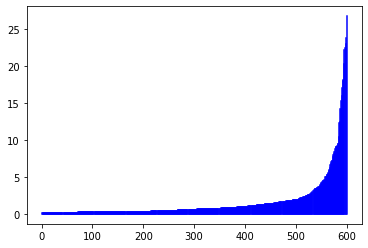

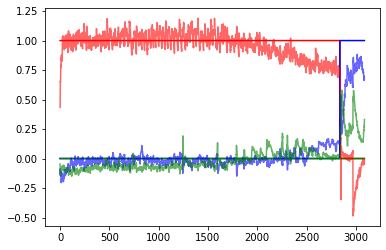

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 2644/3000 [16:02:52<1:55:57, 19.54s/it]

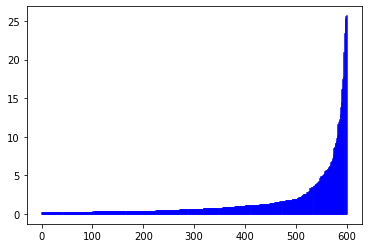

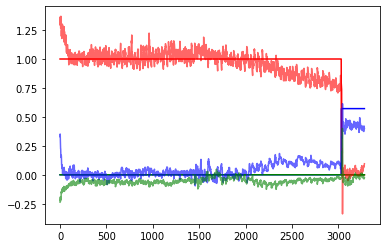

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 2649/3000 [16:04:37<1:56:32, 19.92s/it]

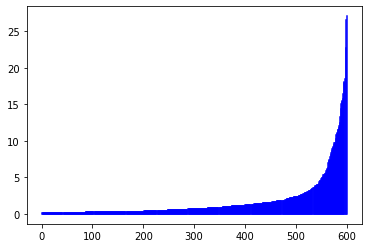

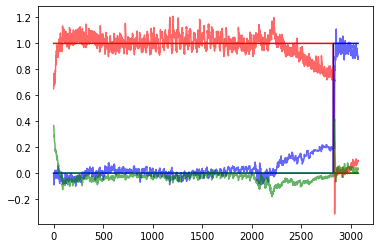

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 2654/3000 [16:07:07<2:14:51, 23.39s/it]

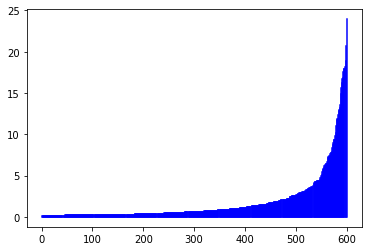

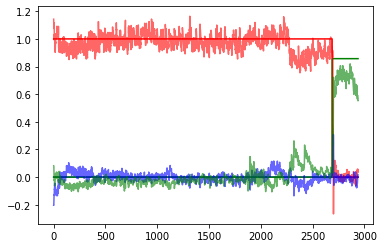

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 2659/3000 [16:08:50<1:55:31, 20.33s/it]

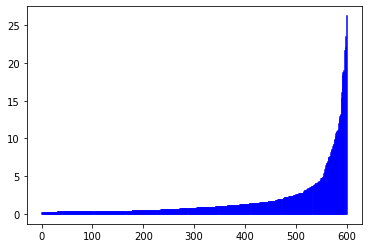

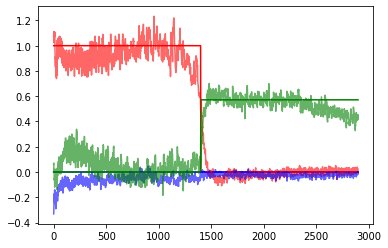

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 2664/3000 [16:10:29<1:44:13, 18.61s/it]

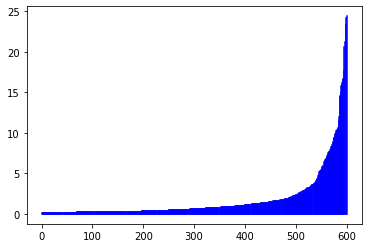

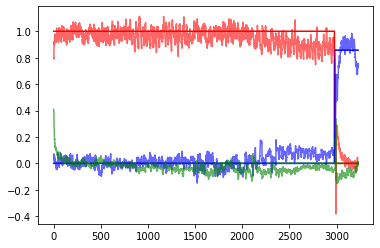

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 2669/3000 [16:12:06<1:42:44, 18.63s/it]

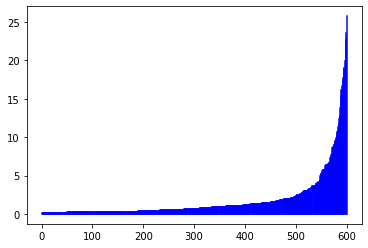

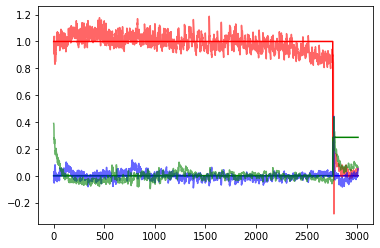

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 2674/3000 [16:13:46<1:46:51, 19.67s/it]

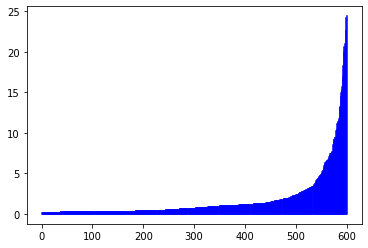

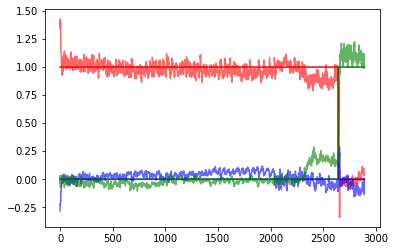

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 2679/3000 [16:15:34<1:50:32, 20.66s/it]

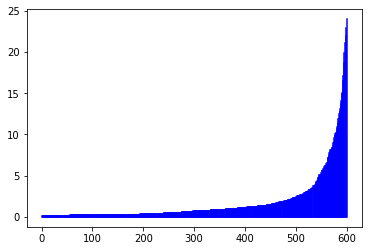

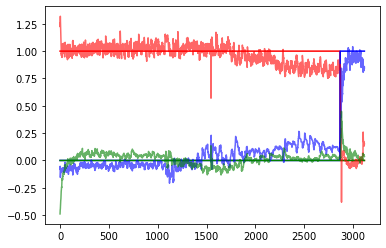

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 2684/3000 [16:17:06<1:35:46, 18.19s/it]

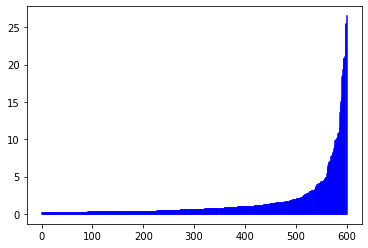

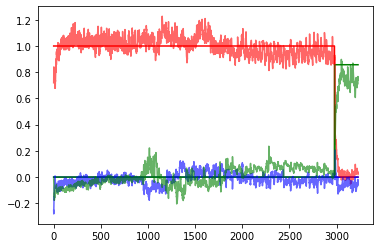

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 2689/3000 [16:18:51<1:42:06, 19.70s/it]

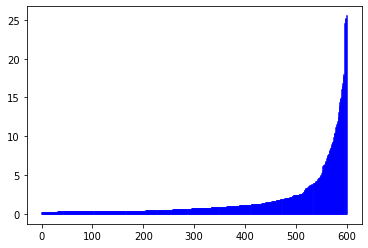

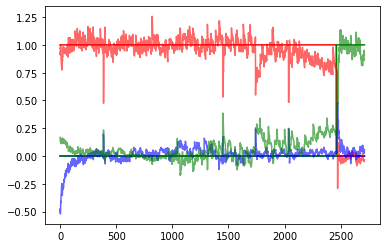

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 2694/3000 [16:20:35<1:43:38, 20.32s/it]

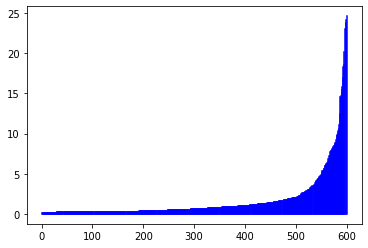

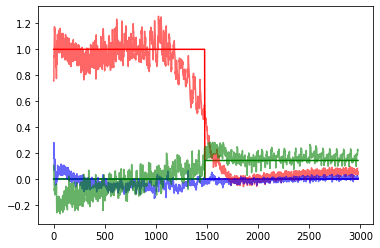

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 2699/3000 [16:22:12<1:32:38, 18.47s/it]

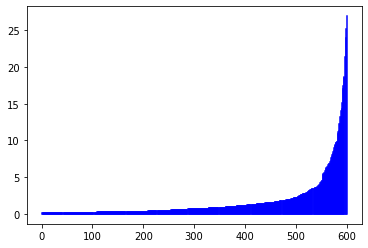

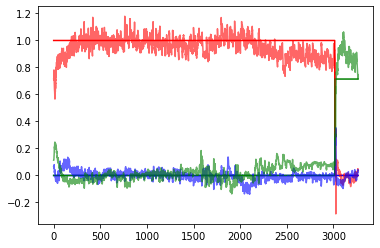

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 2704/3000 [16:24:46<1:56:32, 23.62s/it]

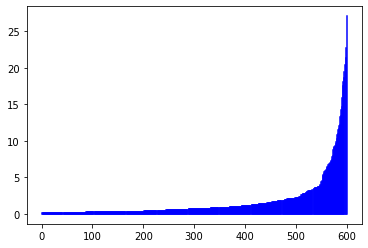

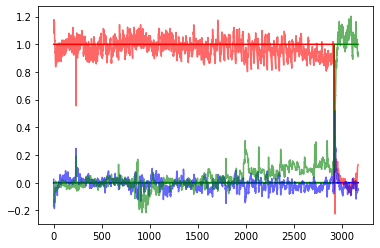

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 2709/3000 [16:26:29<1:38:09, 20.24s/it]

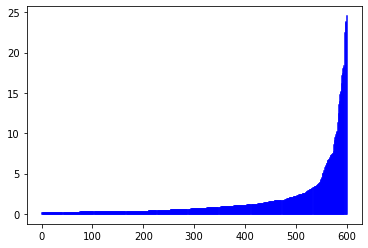

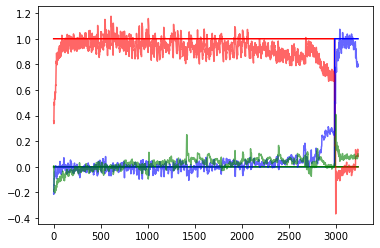

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 2714/3000 [16:28:13<1:36:20, 20.21s/it]

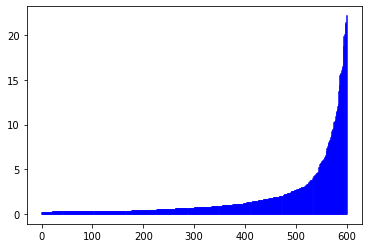

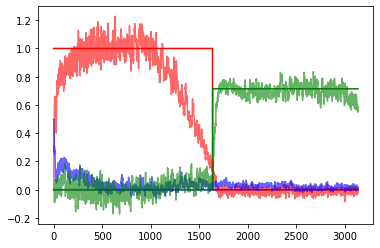

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 2719/3000 [16:29:55<1:33:12, 19.90s/it]

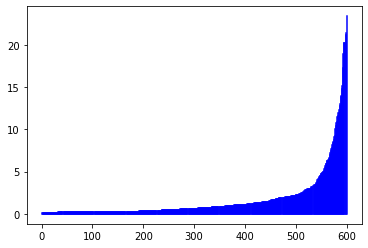

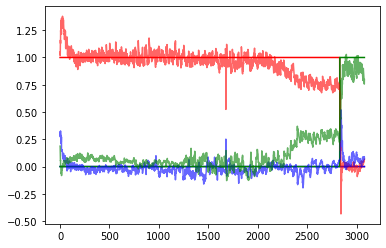

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 2724/3000 [16:31:43<1:35:27, 20.75s/it]

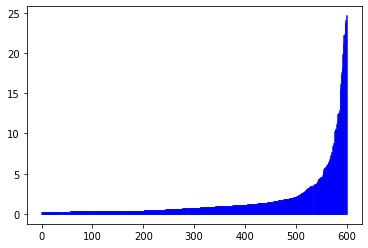

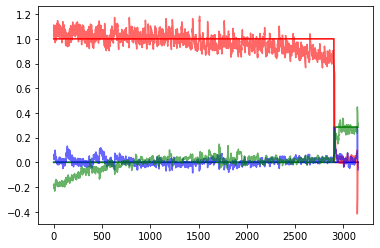

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 2729/3000 [16:33:32<1:35:09, 21.07s/it]

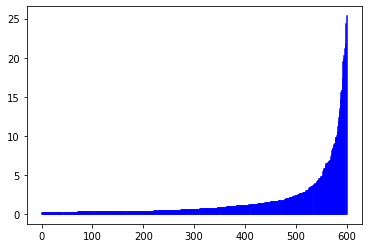

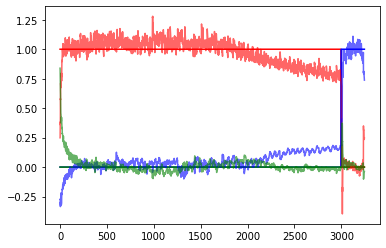

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 2734/3000 [16:35:21<1:32:31, 20.87s/it]

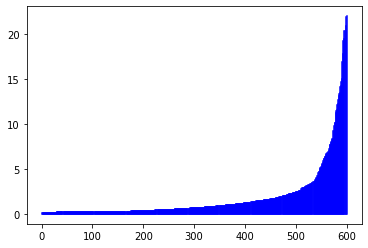

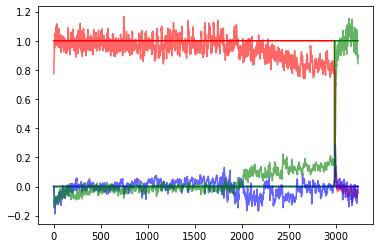

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 2739/3000 [16:36:56<1:19:08, 18.19s/it]

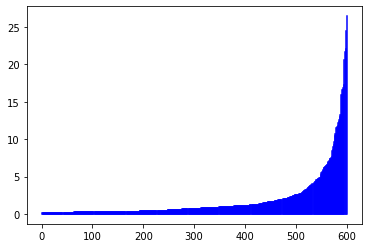

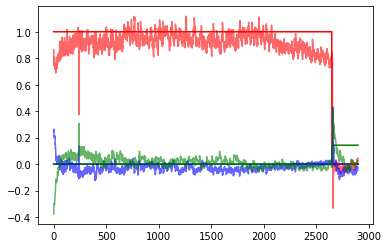

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 2744/3000 [16:38:36<1:19:14, 18.57s/it]

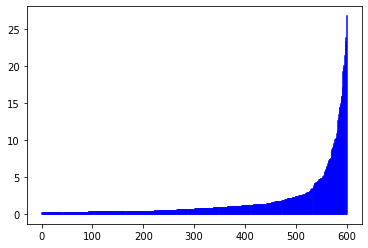

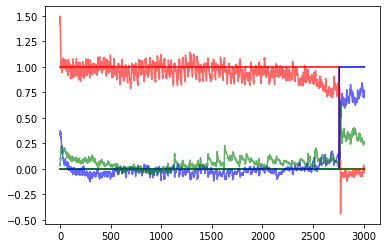

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 2749/3000 [16:40:18<1:23:21, 19.93s/it]

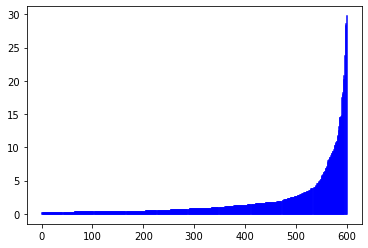

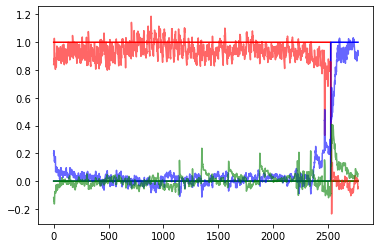

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 2754/3000 [16:42:33<1:26:16, 21.04s/it]

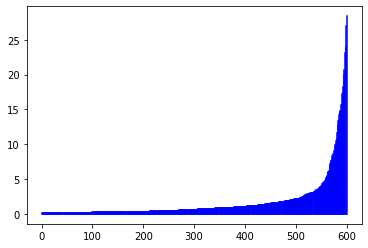

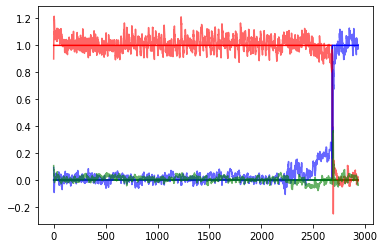

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 2759/3000 [16:44:13<1:15:48, 18.87s/it]

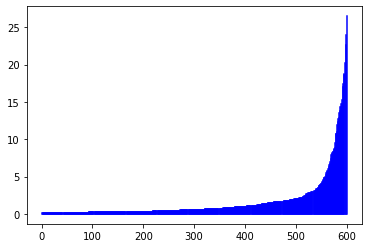

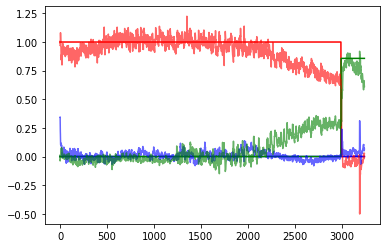

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 2764/3000 [16:45:57<1:18:18, 19.91s/it]

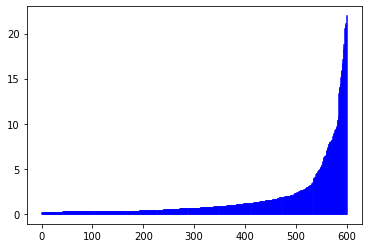

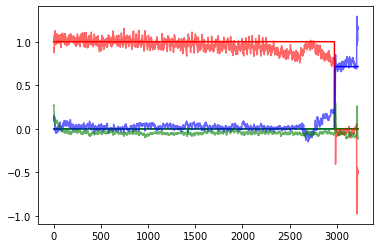

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 2769/3000 [16:47:38<1:17:04, 20.02s/it]

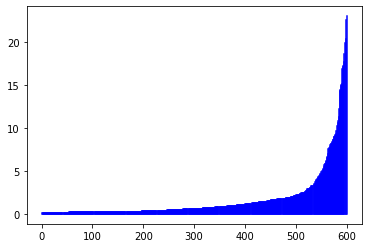

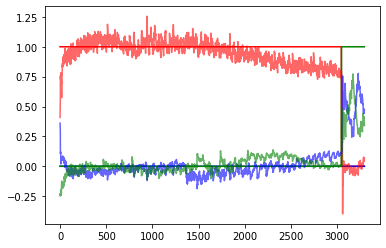

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 2774/3000 [16:49:21<1:12:45, 19.32s/it]

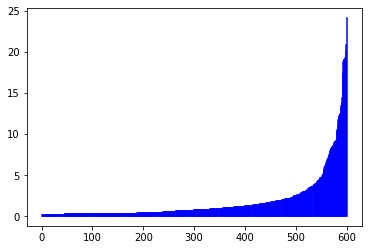

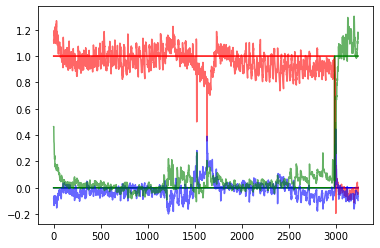

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 2779/3000 [16:51:02<1:14:21, 20.19s/it]

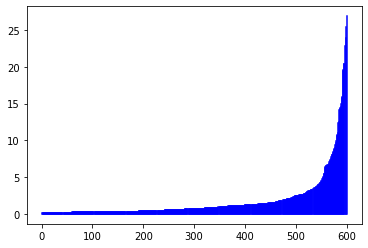

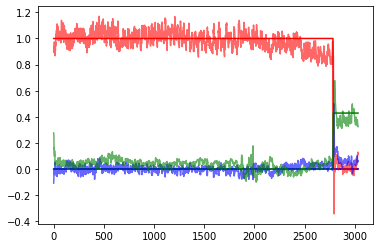

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 2784/3000 [16:52:49<1:14:24, 20.67s/it]

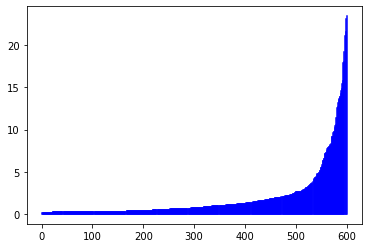

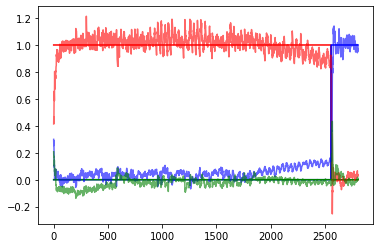

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 2789/3000 [16:54:31<1:10:01, 19.91s/it]

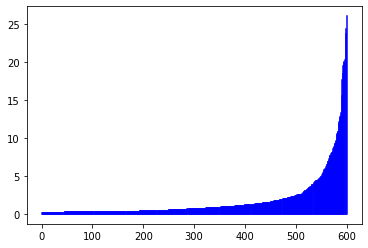

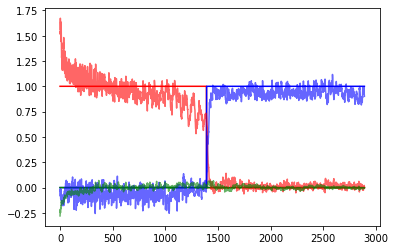

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 2794/3000 [16:56:15<1:08:35, 19.98s/it]

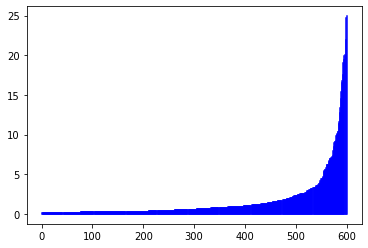

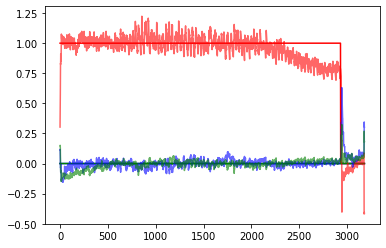

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 2799/3000 [16:57:59<1:08:19, 20.40s/it]

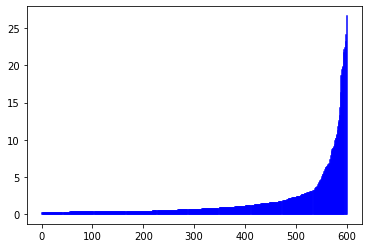

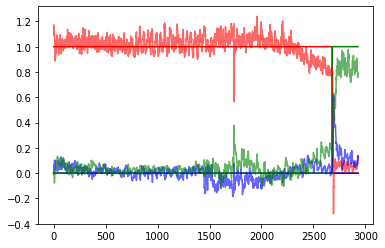

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 2804/3000 [17:00:33<1:18:16, 23.96s/it]

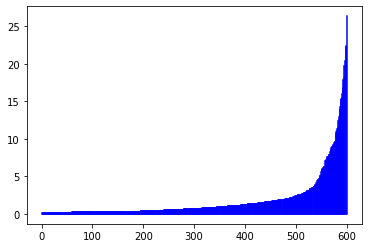

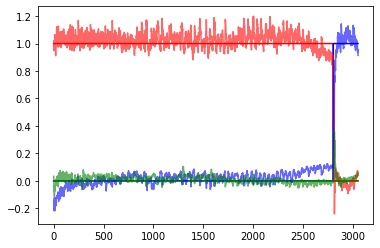

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 2809/3000 [17:02:17<1:05:53, 20.70s/it]

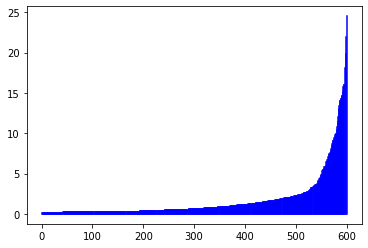

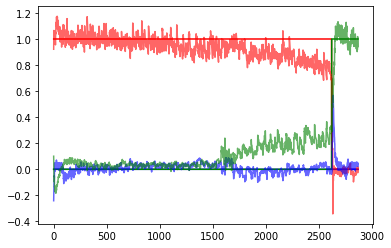

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 2814/3000 [17:03:59<1:01:39, 19.89s/it]

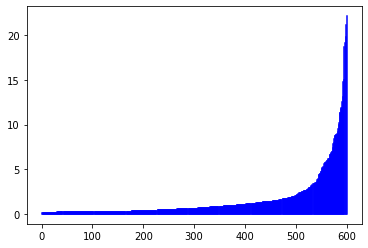

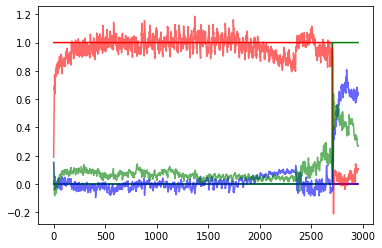

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 2819/3000 [17:05:40<55:58, 18.55s/it]

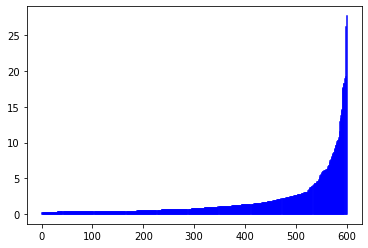

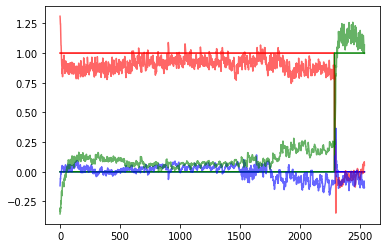

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 2824/3000 [17:07:23<59:17, 20.21s/it]

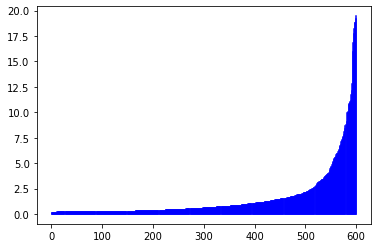

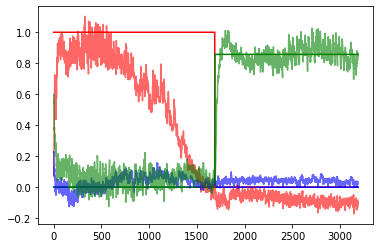

 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 2829/3000 [17:09:09<58:34, 20.55s/it]

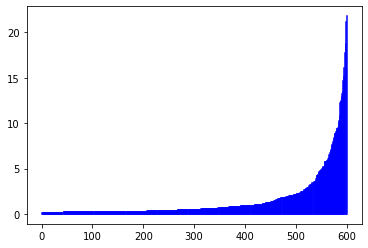

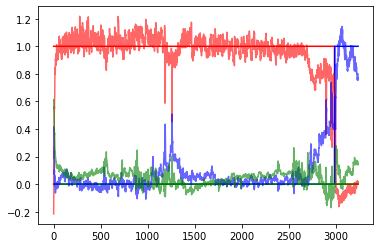

 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 2834/3000 [17:10:58<57:05, 20.64s/it]

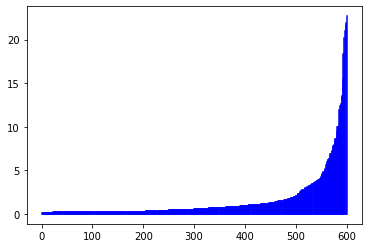

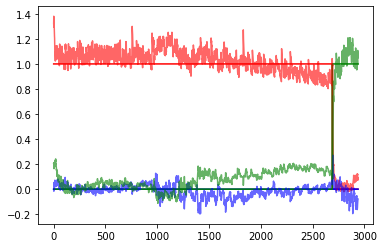

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 2839/3000 [17:12:41<53:34, 19.97s/it]

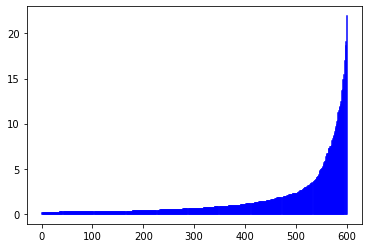

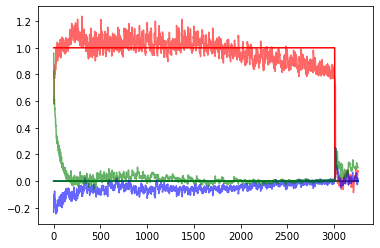

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 2844/3000 [17:14:27<53:39, 20.63s/it]

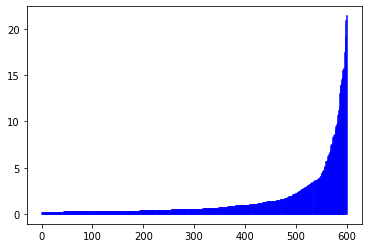

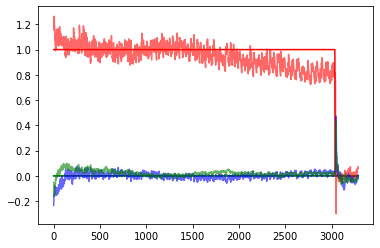

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 2849/3000 [17:16:08<48:32, 19.29s/it]

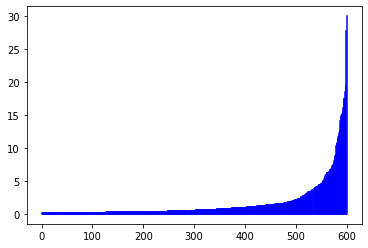

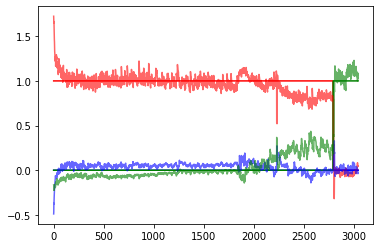

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 2854/3000 [17:18:39<58:03, 23.86s/it]

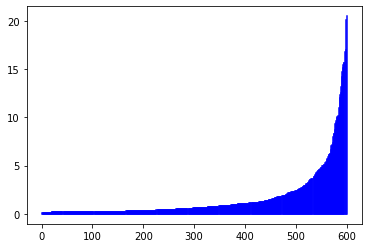

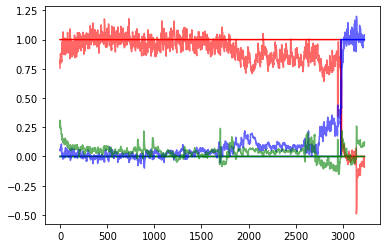

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 2859/3000 [17:20:26<49:49, 21.20s/it]

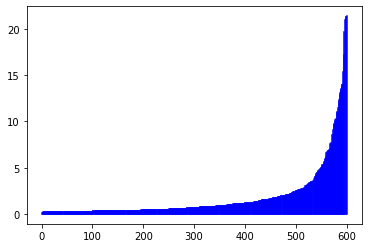

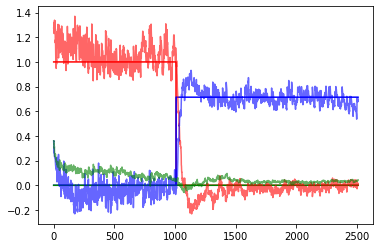

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 2864/3000 [17:22:12<46:58, 20.72s/it]

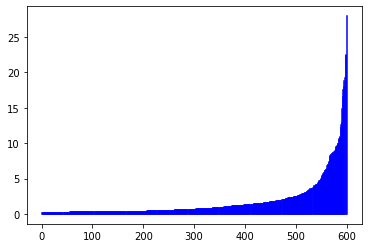

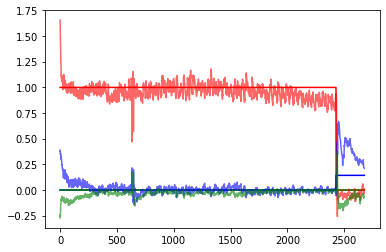

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 2869/3000 [17:23:54<43:44, 20.04s/it]

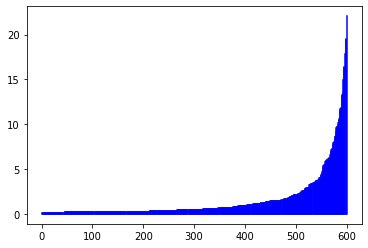

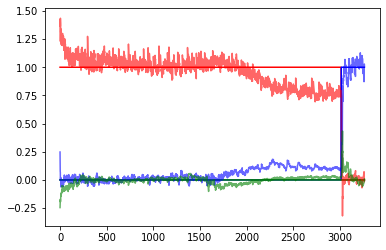

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 2874/3000 [17:25:45<44:25, 21.15s/it]

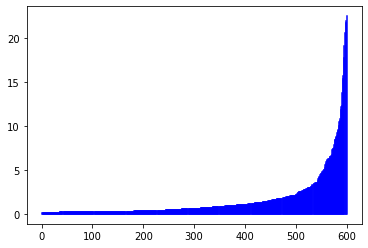

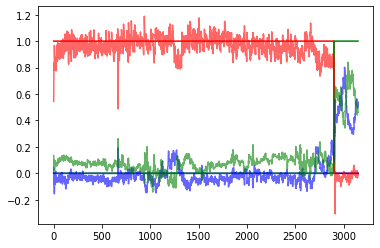

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 2879/3000 [17:27:29<40:41, 20.18s/it]

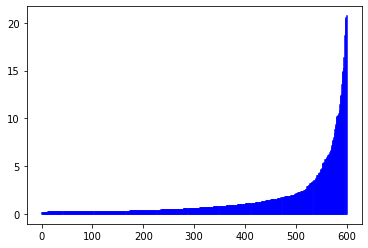

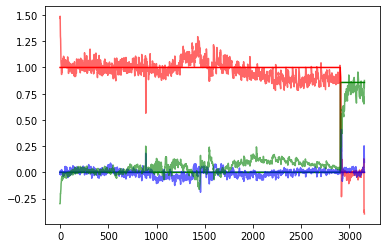

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 2884/3000 [17:29:09<37:15, 19.27s/it]

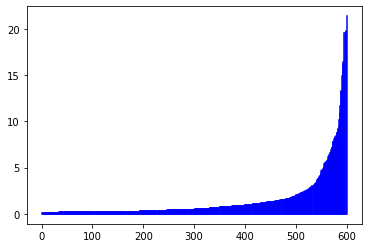

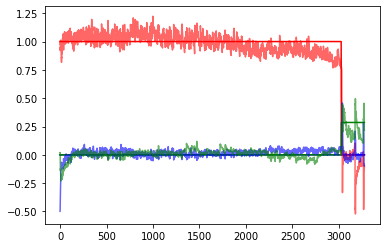

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 2889/3000 [17:30:56<37:40, 20.37s/it]

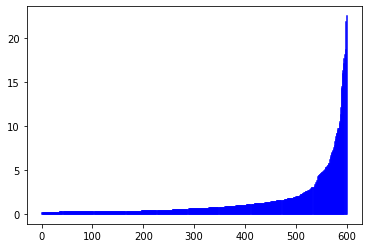

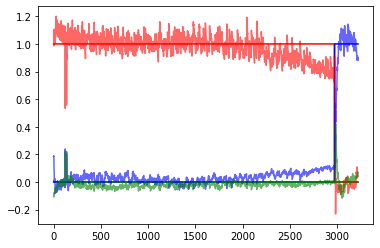

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 2894/3000 [17:32:40<35:21, 20.01s/it]

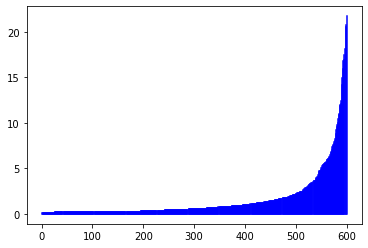

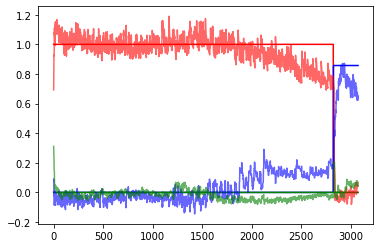

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 2899/3000 [17:34:25<34:20, 20.40s/it]

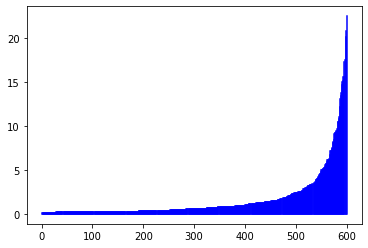

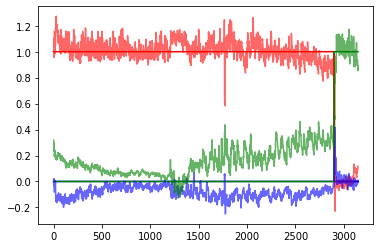

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 2904/3000 [17:36:57<38:00, 23.75s/it]

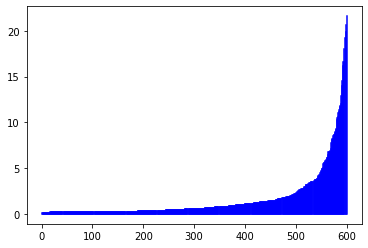

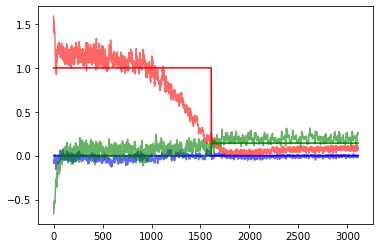

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 2909/3000 [17:38:43<31:37, 20.85s/it]

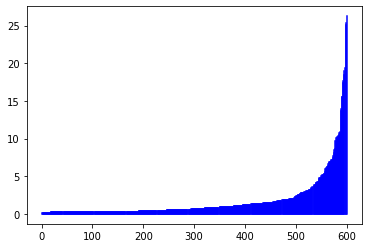

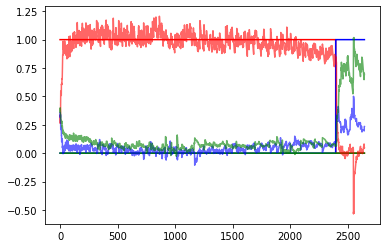

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 2914/3000 [17:40:28<28:50, 20.13s/it]

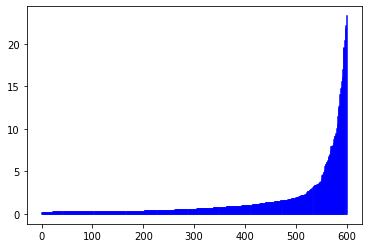

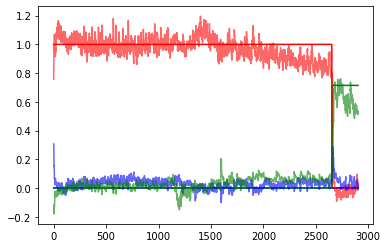

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 2919/3000 [17:42:15<28:02, 20.77s/it]

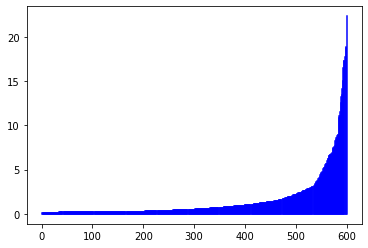

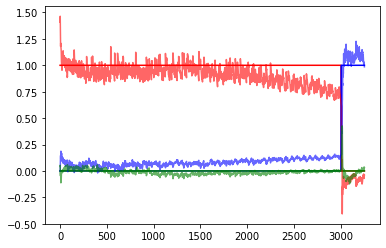

 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 2924/3000 [17:43:59<25:43, 20.30s/it]

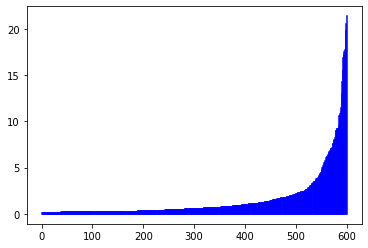

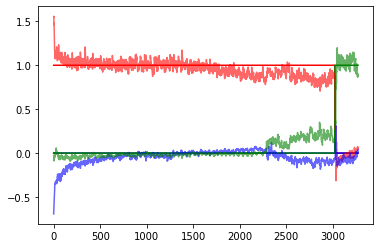

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 2929/3000 [17:45:40<23:02, 19.47s/it]

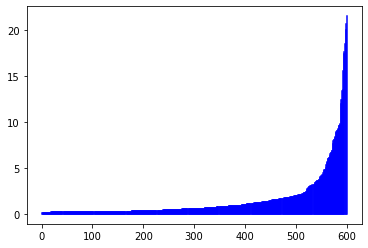

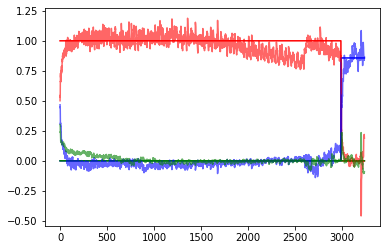

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 2934/3000 [17:47:22<21:24, 19.47s/it]

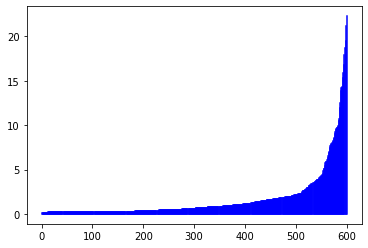

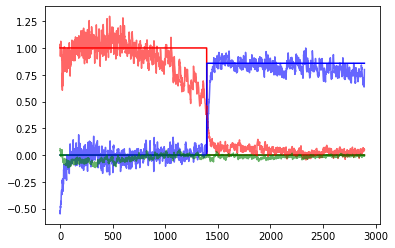

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 2939/3000 [17:49:03<19:46, 19.44s/it]

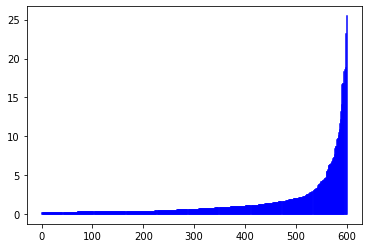

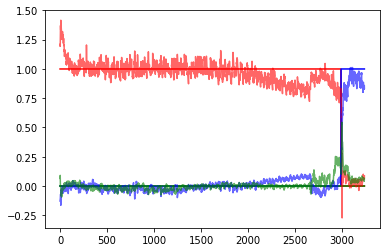

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 2944/3000 [17:50:48<18:52, 20.21s/it]

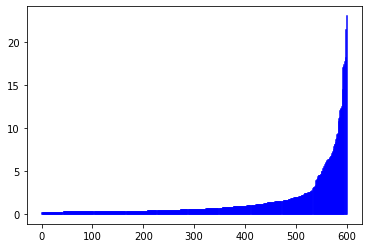

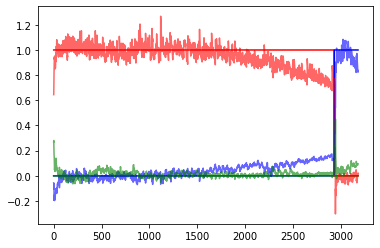

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 2949/3000 [17:52:35<17:35, 20.71s/it]

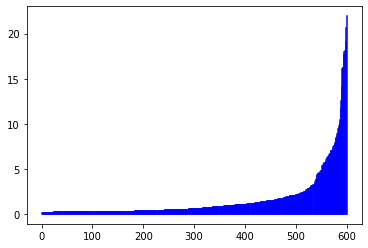

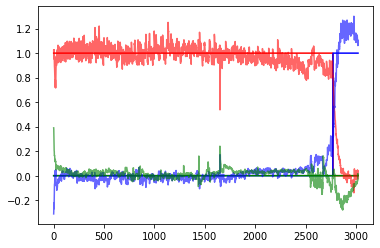

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 2954/3000 [17:55:13<18:43, 24.43s/it]

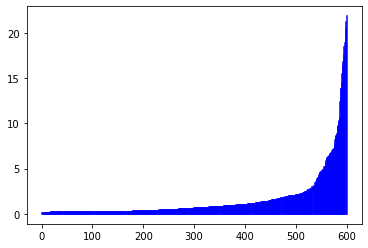

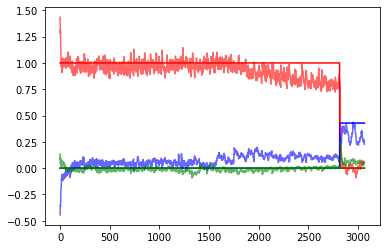

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 2959/3000 [17:56:53<13:37, 19.94s/it]

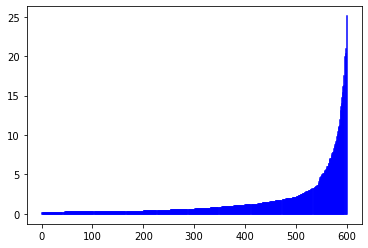

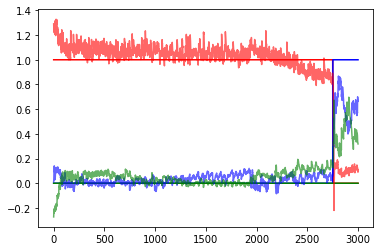

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 2964/3000 [17:58:39<12:05, 20.15s/it]

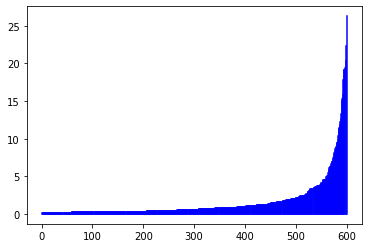

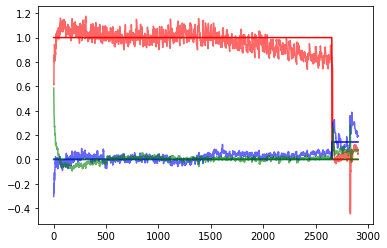

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 2969/3000 [18:00:22<10:26, 20.20s/it]

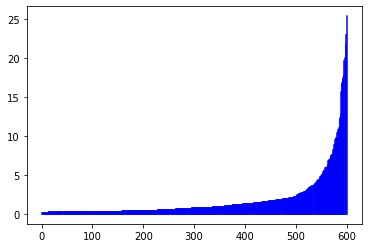

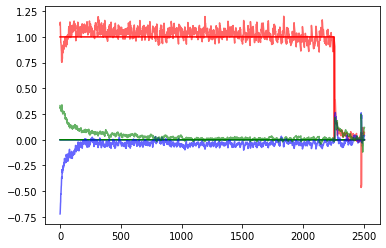

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 2974/3000 [18:02:07<08:34, 19.77s/it]

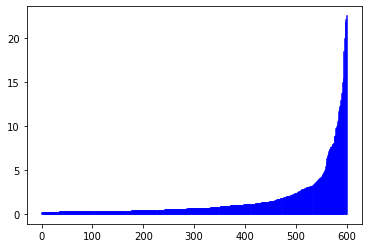

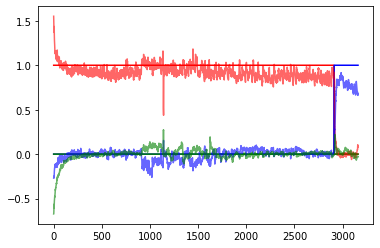

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 2979/3000 [18:03:50<07:02, 20.11s/it]

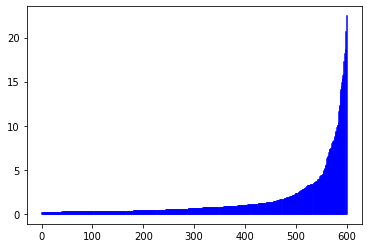

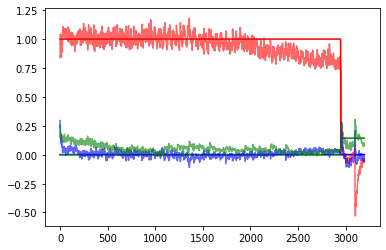

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 2984/3000 [18:05:34<05:21, 20.07s/it]

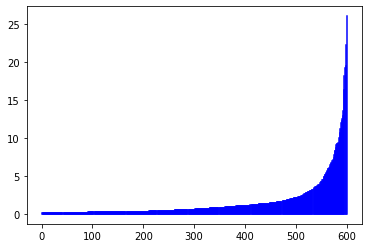

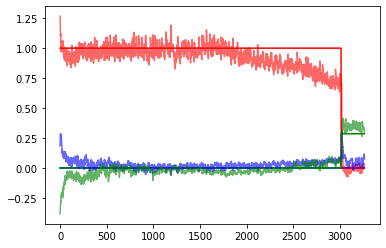

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 2989/3000 [18:07:15<03:35, 19.58s/it]

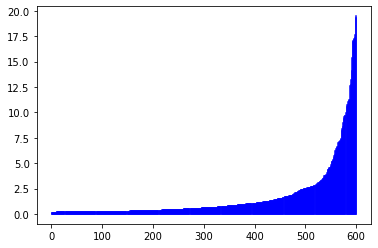

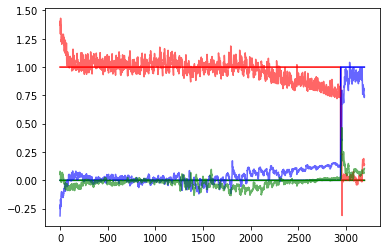

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 2994/3000 [18:09:00<02:00, 20.05s/it]

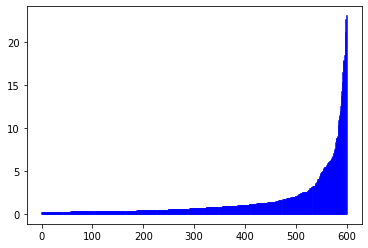

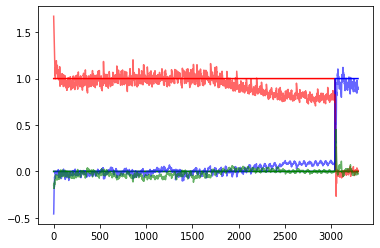

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 2999/3000 [18:10:51<00:21, 21.13s/it]

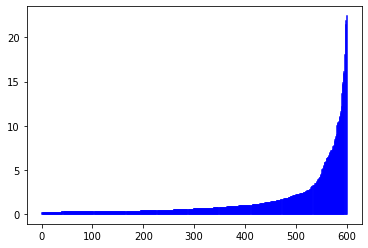

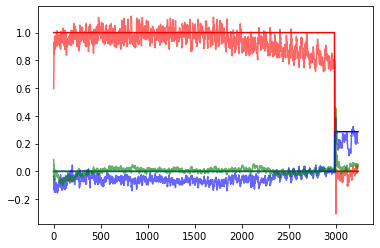

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3000/3000 [18:12:13<00:00, 21.84s/it]

Finished Training


In [14]:
from cgtasknet.instruments.instrument_accuracy_network import correct_answer
from norse.torch import LIFAdExState
name = f"weights/weights_{neuron_parameters.alpha}_N_{hidden_size}_without_square"
running_loss = 0
sigma = 0

for i in tqdm(range(number_of_epochs)):
    if i == 500:
        sigma = 0.2
    if i == 1000:
        sigma = 0.5
    inputs, target_outputs = Task.dataset(number_of_tasks)

    inputs[:, :, 1:3] += every_bath_generator(
        0, sigma, inputs.shape[0], inputs.shape[1], 2
    )
    inputs = torch.from_numpy(inputs).type(torch.float).to(device)
    target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
    loss_mask = torch.zeros_like(target_outputs)
    mask_indexes_signes = torch.where(target_outputs[:, :, 0] == 1)
    mask_indexes_zeros = torch.where(target_outputs[:, :, 0] == 0)
    loss_mask[mask_indexes_signes[0], mask_indexes_signes[1], :] = .1
    loss_mask[mask_indexes_zeros[0], mask_indexes_zeros[1], :] = 1
    optimizer.zero_grad()
    init_state = LIFAdExState(
        torch.zeros(batch_size, hidden_size).to(device),
        torch.rand(batch_size, hidden_size).to(device),
        torch.zeros(batch_size, hidden_size).to(device),
        torch.zeros(batch_size, hidden_size).to(device),
    )
    # forward + backward + optimize
    outputs, _, state = model(
        inputs,
        init_state,
    )

    loss = criterion(outputs, target_outputs, loss_mask, state)
    loss.backward()
    optimizer.step()

    # print statistics
    running_loss = loss.item()
    if i % 50 == 49:
        with open("log_multy.txt", "a") as f:
            f.write("epoch: {:d} loss: {:0.5f}\n".format(i + 1, running_loss / 10))
        running_loss = 0.0
        with torch.no_grad():
            torch.save(
                model.state_dict(),
                name + f'_{i}_',
            )
    if i % 50== 49:

        result = 0
        for j in range(10):
            try:
                del inputs
            except:
                pass
            try:
                del target_outputs
            except:
                pass
            try:
                del outputs
            except:
                pass
            torch.cuda.empty_cache()
            inputs, target_outputs = Task.dataset(1, delay_between=0)
            inputs[:, :, 1:3] += every_bath_generator(
                0, 0.01, inputs.shape[0], inputs.shape[1], 2
            )
            inputs = torch.from_numpy(inputs).type(torch.float).to(device)
            target_outputs = (
                torch.from_numpy(target_outputs).type(torch.float).to(device)
            )
            outputs = model(
                inputs,
                init_state,
            )[0]
            type_tasks = list(
                np.where(inputs[-1, :, 3:].detach().cpu().numpy() == 1)[1]
            )
            answers = can.run(
                target_outputs[50:, :, 0].cpu(),
                outputs[50:, :, 0].cpu(),
                target_outputs[50:, :, 1:].cpu(),
                outputs[50:, :, 1:].cpu(),
                type_tasks,
            )
            result += answers

        accuracy = result / batch_size / 10 * 100
        with open("accuracy_multy.txt", "a") as f:
            f.write(f"ecpoch = {i}; correct/all = {accuracy}\n")
    try:
        del inputs
    except:
        pass
    try:
        del target_outputs
    except:
        pass
    try:
        del outputs
        del states
    except:
        pass
    if i % 5 == 4:
        check_mean_fr()
    torch.cuda.empty_cache()
print("Finished Training")

In [15]:
model.save_states = True
sorted_tasks = sorted(tasks)
re_word = "Go"
choices_tasks = []
values_tasks = []
for i in range(len(sorted_tasks)):
    if re_word in sorted_tasks[i]:
        values_tasks.append(i)
    else:
        choices_tasks.append(i)
can = CorrectAnswerNetwork(choices_tasks, values_tasks, 0.15)
inputs, target_outputs = Task.dataset(1, delay_between=0)
inputs[:, :, 1:3] += every_bath_generator(0, 0.01, inputs.shape[0], inputs.shape[1], 2)
inputs = torch.from_numpy(inputs).type(torch.float).to(device)
target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
outputs, states = model(
    inputs,
    init_state,
    additional_current=additional_current_generate(
        len(inputs),
        batch_size,
        hidden_size,
    ).to(device),
)
type_tasks = list(np.where(inputs[-1, :, 3:].detach().cpu().numpy() == 1)[1])
answers = can.run(
    target_outputs[:, :, 0].cpu(),
    outputs[:, :, 0].cpu(),
    target_outputs[:, :, 1:].cpu(),
    outputs[:, :, 1:].cpu(),
    type_tasks,
)
result += answers

NameError: name 'additional_current_generate' is not defined

In [ ]:
inputs, target_outputs = Task.dataset(1, delay_between=0)
inputs = torch.from_numpy(inputs).type(torch.float).to(device)# * 0
target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
init_state = LIFAdExState(
        torch.zeros(batch_size, hidden_size).to(device),
        torch.rand(batch_size, hidden_size).to(device),
        torch.zeros(batch_size, hidden_size).to(device),
        torch.zeros(batch_size, hidden_size).to(device),
    )
outputs, states, _ = model(
    inputs,
    init_state,
        
    )
task_number = sorted_tasks.index('RomoTask1')

outputs = outputs.cpu().detach()
target_outputs = target_outputs.detach().cpu()
s = []
for i in range(len(states)):
    s.append(states[i].z)
s = torch.stack(s).detach().cpu()

plt.plot(target_outputs[:, task_number, 0].cpu())
plt.plot(outputs[:, task_number, 0].detach().cpu())
plt.show()
plt.close()
plt.plot(target_outputs[:, task_number, 1].cpu())
plt.plot(outputs[:, task_number, 1].detach().cpu())
plt.show()
plt.close()
plt.plot(target_outputs[:, task_number, 2].cpu())
plt.plot(outputs[:, task_number, 2].detach().cpu())
plt.show()
plt.close()
plt.figure(figsize=(20, 10))
plt.imshow(s[:, task_number, :].T, aspect="auto", interpolation="nearest")

In [ ]:
for_sort = torch.sort(torch.mean(torch.mean(s, axis=0), axis=0), dim=0
).indices
s_new = torch.zeros_like(s)
for i in range(hidden_size):
    s_new[:, :, i] = s[:, :, for_sort[i]]
plt.imshow(s_new[:, task_number, :].T, aspect="auto", interpolation="nearest", origin='lower',)

In [ ]:
# spike_sequence = torch.stack(spike_sequence)
freq_sequence = torch.mean(torch.mean(spike_sequence, axis=0), axis=0)

# freq_sequence = sort_elemnts_by_another (freq_sequence, freq_sequence)
print(f"{spike_sequence.shape=}")
print(f"{freq_sequence.shape=}")
for i in range(len(freq_sequence)):
    plt.plot([i + 1] * 2, [0, freq_sequence[i]], c="b")
plt.show()
plt.close()
model.save_states = False

In [ ]:
from cgtasknet.instruments.instrument_subgroups import sort_elemnts_by_another

frequency = torch.mean(torch.mean(s, axis=0), axis=0) * 1e3
frequency = sort_elemnts_by_another(freq_sequence, frequency)
for i in range(len(frequency)):
    plt.plot([i + 1] * 2, [0, frequency[i]], c="b")

In [ ]:
result

In [ ]:
list(np.where(inputs[-1, :, 3:].detach().cpu().numpy() == 1)[1])

# Тестовая функция

In [ ]:
def test_network(
        test_sigma: float, number_of_trials: int = 100, plot_data: bool = True
):
    result = 0
    for j in tqdm(range(number_of_trials)):
        try:
            del inputs
        except:
            pass
        try:
            del target_outputs
        except:
            pass
        try:
            del outputs
        except:
            pass
        torch.cuda.empty_cache()
        inputs, target_outputs = Task.dataset(1, delay_between=0)
        inputs[:, :, :3] += every_bath_generator(
            0, test_sigma, inputs.shape[0], inputs.shape[1], 3
        )
        inputs = torch.from_numpy(inputs).type(torch.float).to(device)
        target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
        outputs = model(inputs)[0]
        answers = correct_answer(
            outputs[:, :, 1:], target_outputs[:, :, 1:], target_outputs[:, :, 0]
        )
        result += torch.sum(answers).item()

    accuracy = result / batch_size / number_of_trials * 100
    if plot_data:
        plot_results(inputs, target_outputs, outputs)
    try:
        del inputs
    except:
        pass
    try:
        del target_outputs
    except:
        pass
    try:
        del outputs
    except:
        pass
    torch.cuda.empty_cache()
    return accuracy

# Тестирование
```  np.random.normal(0, 0.01, size=(inputs.shape)) ```

In [ ]:
accuracy = test_network(0.01, 1)
print(accuracy)

# Тестирование
```  np.random.normal(0, 0.05, size=(inputs.shape)) ```

In [ ]:
accuracy = test_network(0.05, 10)
print(accuracy)

# Тестирование
```  np.random.normal(0, 0.1, size=(inputs.shape)) ```

In [ ]:
accuracy = test_network(0.1)
print(accuracy)

# Тестирование
```  np.random.normal(0, 0.5, size=(inputs.shape)) ```

In [ ]:
accuracy = test_network(0.5)
print(accuracy)

In [ ]:
result = 0
for j in tqdm(range(1)):
    try:
        del inputs
    except:
        pass
    try:
        del target_outputs
    except:
        pass
    try:
        del outputs
    except:
        pass
    torch.cuda.empty_cache()
    inputs, target_outputs = Task.dataset(1, delay_between=0)
    inputs[:, :, :3] += np.random.normal(0, 0.5, size=inputs[:, :, :3].shape)
    inputs = torch.from_numpy(inputs).type(torch.float).to(device)
    target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
    outputs = model(inputs)[0]
    answers = correct_answer(
        outputs[:, :, 1:], target_outputs[:, :, 1:], target_outputs[:, :, 0]
    )
    result += torch.sum(answers).item()

accuracy = result / batch_size / 100 * 100
print(accuracy)
plot_results(inputs, target_outputs, outputs)
try:
    del inputs
except:
    pass
try:
    del target_outputs
except:
    pass
try:
    del outputs
except:
    pass
torch.cuda.empty_cache()

In [ ]:
result = 0
for j in tqdm(range(1)):
    try:
        del inputs
    except:
        pass
    try:
        del target_outputs
    except:
        pass
    try:
        del outputs
    except:
        pass
    torch.cuda.empty_cache()
    inputs, target_outputs = Task.dataset(1, delay_between=0)
    inputs[:, :, :3] += np.random.normal(0, 0.7, size=inputs[:, :, :3].shape)
    inputs = torch.from_numpy(inputs).type(torch.float).to(device)
    target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
    outputs = model(inputs)[0]
    answers = correct_answer(
        outputs[:, :, 1:], target_outputs[:, :, 1:], target_outputs[:, :, 0]
    )
    result += torch.sum(answers).item()

accuracy = result / batch_size / 100 * 100
print(accuracy)
plot_results(inputs, target_outputs, outputs)
try:
    del inputs
except:
    pass
try:
    del target_outputs
except:
    pass
try:
    del outputs
except:
    pass
torch.cuda.empty_cache()

In [ ]:
inputs = 0
outputs = 0

In [ ]:
lines = []
with open("accuracy_multy.txt", "r") as f:
    while line := f.readline():
        lines.append(float(line.split("=")[2]))

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 5))
plt.plot([*range(9, 3000, 50)], lines, ".", linestyle="--", markersize=5)
plt.ylabel(r"Accuracy%")
plt.xlabel(r"Epochs")

In [ ]:
start_sigma = 0
stop_sigma = 2
step_sigma = 0.05
sigma_array = np.arange(start_sigma, stop_sigma, step_sigma)
for test_sigma in tqdm(sigma_array):
    result = 0
    for j in range(20):
        try:
            del inputs
        except:
            pass
        try:
            del target_outputs
        except:
            pass
        try:
            del outputs
        except:
            pass
        torch.cuda.empty_cache()
        inputs, target_outputs = Task.dataset(1, delay_between=0)
        inputs[:, :, 1:3] += np.random.normal(
            0, test_sigma, size=inputs[:, :, 1:3].shape
        )
        inputs = torch.from_numpy(inputs).type(torch.float).to(device)
        target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
        outputs = model(inputs)[0]
        type_tasks = list(np.where(inputs[-1, :, 3:].detach().cpu().numpy() == 1)[1])
        answers = can.run(
            target_outputs[50:, :, 0].cpu(),
            outputs[50:, :, 0].cpu(),
            target_outputs[50:, :, 1:].cpu(),
            outputs[50:, :, 1:].cpu(),
            type_tasks,
        )
        result += answers
    accuracy = result / batch_size / 20 * 100
    with open("accuracy_vs_noise.txt", "a") as f:
        f.write(f"noise={test_sigma}:accuracy={accuracy}\n")

In [ ]:
import matplotlib.patches as patches

plt.style.use("ggplot")


def parser(line_text: str) -> tuple:
    """
    Function parses text in form:
    ```v_name_1=v1:v_name_2:v2```
    and return (v1, v2)
    :param line_text:
    :return: (v1, v2)
    """
    line_text = line_text.split(":")
    print(line_text)
    v1 = line_text[0].split("=")[1]
    v2 = line_text[1].split("=")[1]
    return float(v1), float(v2)


x, y = [], []
# with open('accuracy_vs_noise.txt', 'r') as f:
with open(
        r"accuracy_vs_noise.txt",
        "r",
) as f:
    while line := f.readline():
        t_x, t_y = parser(line)
        x.append(t_x)
        y.append(t_y)

fig, ax = plt.subplots()
ax.plot(x, y, ".", linestyle="--")
# ax.plot([.5]*2, [50, 100])
ax.set_ylabel("Accuracy,%")
ax.set_xlabel(r"$\sigma$")
ax.add_patch(
    patches.Rectangle(
        (0, 50), 0.5, 50, edgecolor="grey", facecolor="grey", alpha=0.5, fill=True
    )
)

plt.show()
plt.close()

In [ ]:
batch_size = 1
number_of_tasks = 1
romo_parameters = RomoTaskRandomModParameters(
    romo=RomoTaskParameters(
        delay=0.6,
        positive_shift_delay_time=0.0,
        trial_time=0.1,
        positive_shift_trial_time=0.2,
    ),
)
dm_parameters = DMTaskRandomModParameters(
    dm=DMTaskParameters(trial_time=0.6, positive_shift_trial_time=0.0)
)
ctx_parameters = CtxDMTaskParameters(dm=dm_parameters.dm)
go_parameters = GoTaskRandomModParameters(
    go=GoTaskParameters(
        trial_time=0.1,
        positive_shift_trial_time=0.8,
    )
)
gort_parameters = GoRtTaskRandomModParameters(
    go=GoRtTaskParameters(
        trial_time=0.1,
        positive_shift_trial_time=0.8,
    )
)
godl_parameters = GoDlTaskRandomModParameters(
    go_dl=GoDlTaskParameters(
        go=GoTaskParameters(trial_time=0.1, positive_shift_trial_time=0.2),
        delay=0.1,
        positive_shift_delay_time=1.4,
    )
)
sigma = 0.5
tasks = [
    "RomoTask1",
    "RomoTask2",
    "DMTask1",
    "DMTask2",
    "CtxDMTask1",
    "CtxDMTask2",
    "GoTask1",
    "GoTask2",
    "GoRtTask1",
    "GoRtTask2",
    "GoDlTask1",
    "GoDlTask2",
]
task_dict = {
    tasks[0]: romo_parameters,
    tasks[1]: romo_parameters,
    tasks[2]: dm_parameters,
    tasks[3]: dm_parameters,
    tasks[4]: ctx_parameters,
    tasks[5]: ctx_parameters,
    tasks[6]: go_parameters,
    tasks[7]: go_parameters,
    tasks[8]: gort_parameters,
    tasks[9]: gort_parameters,
    tasks[10]: godl_parameters,
    tasks[11]: godl_parameters,
}

tasks_sequence = [
    MultyReduceTasks(
        tasks=task_dict,
        batch_size=batch_size,
        delay_between=0,
        enable_fixation_delay=True,
        task_number=i,
    )
    for i in range(len(tasks))
]

In [ ]:
tasks_and_names = dict([*zip(sorted(tasks), tasks_sequence)])
chosed_tasks = ["CtxDMTask1", "GoTask1", "GoRtTask1", "GoDlTask1", "RomoTask1"]
chosed_tasks_dict = {}
for key, item in tasks_and_names.items():
    if key in chosed_tasks:
        chosed_tasks_dict[key] = item
print("Tasks for PCA")
print(chosed_tasks_dict)

In [ ]:
import matplotlib.pyplot as plt
from cgtasknet.instruments.instrument_accuracy_network import correct_answer
from cgtasknet.net.states import LIFAdExInitState

name = f"Train_dm_and_romo_task_reduce_lif_adex_without_refrac_random_delay_long_a_alpha_{neuron_parameters.alpha}_N_{hidden_size}"
init_state = LIFAdExInitState(batch_size, hidden_size, device=device)
data, t_outputs = tasks_and_names["DMTask1"].dataset(2, delay_between=0)
data[:, :, 1:3] += every_bath_generator(0, sigma, data.shape[0], data.shape[1], 2)
data = torch.from_numpy(data).type(torch.float).to(device)
out, states = model(data, init_state.random_state())
out = out.detach().cpu().numpy()
plt.figure()
plt.plot(t_outputs[:, 0, 0])
plt.plot(t_outputs[:, 0, 1])
plt.plot(t_outputs[:, 0, 2])

plt.figure()
plt.plot(out[:, 0, 0])
plt.plot(out[:, 0, 1])
plt.plot(out[:, 0, 2])

In [ ]:

for name, param in model.named_parameters():
    if name == 'alif.recurrent_weights':
        final_parameters = torch.clone(param.detach().cpu())


In [ ]:
eigs_final = torch.eig(final_parameters)[0]
eigs_initial = torch.eig(initial_parameters)[0]

In [ ]:
x_final = eigs_final[:, 0]
y_final = eigs_final[:, 1]

x_initial = eigs_initial[:, 0]
y_initial = eigs_initial[:, 1]

In [ ]:
plt.scatter(x_initial, y_initial)
plt.scatter(x_final, y_final)

In [ ]:
Task_test = MultyReduceTasks(
    tasks=task_dict,
    batch_size=batch_size,
    delay_between=0,
    enable_fixation_delay=True,
    mode="random",
    task_number=0
)

In [ ]:
model.save_states = True
init_state = LIFAdExState(
        torch.zeros(batch_size, hidden_size).to(device),
        torch.rand(batch_size, hidden_size).to(device),
        torch.zeros(batch_size, hidden_size).to(device),
        torch.zeros(batch_size, hidden_size).to(device),
    )
inputs, target_outputs = Task.dataset(2)#Task_test.dataset(1)

inputs = torch.from_numpy(inputs).type(torch.float).to(device)
target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
result = model(inputs, init_state,)
#del inputs, init_state
torch.cuda.empty_cache()
states = result[-1]
spikes = []
for state in states:
    spikes.append(state.detach().cpu())
    
s = torch.stack(spikes)
freq_sequence_new = torch.sort(
    torch.mean(torch.mean(s, axis=0), axis=0), dim=0
).values
for i in range(len(freq_sequence_new)):
    plt.plot([i + 1] * 2, [0, freq_sequence_new[i] * 1e3], c="b")

In [ ]:
freq_sequence_new[105] * 1e3

In [ ]:
last_fix = torch.where(inputs[:, :, 0] == 1)[0][-1].item()
s = torch.stack(spikes)[:last_fix, ...]
freq_sequence_new = torch.sort(
    torch.mean(torch.mean(s, axis=0), axis=0), dim=0
).values
for i in range(len(freq_sequence_new)):
    plt.plot([i + 1] * 2, [0, freq_sequence_new[i] * 1e3], c="b")

In [ ]:
index=10
plt.plot(target_outputs[:, index, 0].detach().cpu(), c='r')
plt.plot(target_outputs[:, index, 1].detach().cpu(), c='b')
plt.plot(target_outputs[:, index, 2].detach().cpu(), c='g')

plt.plot(result[0][:, index, 0].detach().cpu(), c='r', alpha=.6
        )
plt.plot(result[0][:, index, 1].detach().cpu(), c='b', alpha=.6
        )
plt.plot(result[0][:, index, 2].detach().cpu(), c='g', alpha=.6
        )


plt.plot(inputs[:, index, 0].detach().cpu() + 1.5)

plt.plot(inputs[:, index, 1].detach().cpu() + 1.5)
plt.plot(inputs[:, index, 2].detach().cpu() + 1.5)
plt.yticks([])

In [ ]:
plt.plot(torch.sort(torch.mean(final_parameters, axis=1)).values)
plt.plot(torch.sort(torch.mean(initial_parameters, axis=1)).values)

In [ ]:
torch.mean(final_parameters, axis=1).shape

In [ ]:
torch.sort(torch.mean(final_parameters, axis=1))

In [ ]:
torch.mean(torch.zeros((10, 20)), axis=1).shape

In [ ]:
plt.plot(torch.sort(torch.mean(initial_parameters, axis=1)).values)
plt.plot(torch.sort(torch.mean(final_parameters, axis=1)).values)

In [ ]:
plt.plot(torch.sort(torch.mean(initial_parameters, axis=1)).values)